# 3D Quasidynamic earthquake cycle modelling. First steps: a square fault in a full space.

I've been working to get functioning 3D quasidynamic earthquake cycle simulation set up for the last month. It's been an interesting puzzle working through some of the bugs and misunderstandings that have cropped up and I just figured I'd share the story.

During this process, I've read through a lot of the literature on quasidynamic rupture modeling. I've also read a bit about fully dynamic modeling, because it has many of the same complexities when simulating through multiple earthquake cycles! But, the two main sources that I returned to again and again are:

* Lapusta and Liu, *Three-dimensional boundary integral modeling of spontaneous earthquake sequences and aseismic slip*, 2009.
* Erickson and Dunham, *An efficient numerical method for earthquake cycles in heterogeneous media: Alternating sub-basin and surface-rupturing events on faults crossing a sedimentary basin*, 2014.

The Lapusta and Liu paper goes into substantial and directly useful detail on their implementation. As a complement, the Erickson and Dunham paper is nice because it's focused on a finite difference formulation that is in the time and space domain rather than the Fourier domain setting of the Lapusta and Liu paper. My boundary element method (BEM) implementation is also a time and space domain implementation. 

For an intro to the type of problems I'm solving here, checking out [my post on doing a similar 1D "spring-block-slider" model](http://tbenthompson.com/post/block_slider/). The difference is that, here, I'm modeling a fault surface in 3D domain, rather than a point contact in a 1D domain. That adds a lot more complexity to the implementation and . Primarily, doing this in 3D requires an "elastic solver", that will take the current total slip on the fault surface, any other non-fault boundary conditions, and return the traction on the fault surface. As I mentioned in the 1D post, at a high level, the problem is a simple feedback where I loop:

```
while not done:
    slip += velocity * dt
    traction = elastic_solver(slip)
    velocity = rate_state_solver(traction)
```

However, instead of the simple forward Euler method, I'm using a Runge-Kutta (4,5) method to automatically use the largest accurate time step.

# Slip vs Slip-deficit

This is a critical distinction. When calculating the traction on the fault surface, what we care about is the relative motion of the fault with respect to its surroundings. 

# Failure to impose continuity between adjacent elements.

If there is a discontinuity in slip between two adjacent elements, a stress singularity arises at the boundary between those elements. Infinite stress then passes through the friction law, and fundamentally, results in infinite slip. That's no good. So, imposing slip continuity is essential to having reasonable behavior. And it makes fundamental physical sense too. It's unlikely that large voids are forming deep in the Earth.

This is not a problem for most other quasidynamic earthquake modeling software. If you are using the Fourier domain formulation, you get slip continuity for free by virtue of each Fourier component being continuous in space and thus the sum of those components also being continuous. On the other hand, most Okada-dislocation based approaches (e.g. [QDyn](https://github.com/ydluo/qdyn)) evaluate the stress at the centers of elements. Thus, although the model has stress singularities, the stress is never evaluated in a singular region and the problem is partially avoided. On the other hand, I'm curious how the existence of those singularities affects the final results. In general, I believe the linear (or higher order) slip interpolation that I am using on element is better for this set of problems because it allows continuity.

# Inability to trigger ruptures. 

If I initialize the model with zero slip and a initial steady state parameter, and have $a-b < 0$ everywhere, I initially expected that the model would produce ruptures. Surprisingly, that did not happen. The slip rate evolved 



In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt
import tectosaur.mesh.mesh_gen

from scipy.integrate import RK45
from scipy.optimize import fsolve
from qd_helpers import *

Define the material, frictional, mesh and boundary condition parameters.

The parameters in `tectosaur_cfg` determine how the integration and evaluating of the integral equations are done. I'll get into the details of Tectosaur some time in the future. For the moment, just trust that Tectosaur does actually solve linear elastic boundary value problems. It's been around the block and has been tested thoroughly, especially for the type of dislocation problems I'm solving here.

In [2]:
n_fault = 20
L = 10 * 1000 # 10 km
W = 10 * 1000 # 10 km
m = tectosaur.mesh.mesh_gen.make_rect(n_fault, n_fault, [
    [-L, 0, W], [-L, 0, -W],
    [L, 0, -W], [L, 0, W]
])
qdm = QDMeshData(m)

qd_cfg = dict(
    # Material properties
    sm = 3e10,          # Shear modulus (Pa)
    pr = 0.25,          # Poisson ratio 
    density = 2700,     # rock density (kg/m^3)

    # Frictional properties
    Dc = 0.08,         # state evolution length scale (m)
    f0 = 0.6,           # baseline coefficient of friction
    V0 = 1e-6,          # when V = V0, f = f0, V is (m/s)

    # Boundary conditions
    plate_rate = 1e-9,  # (m/s), equivalent to ~31.5 mm/yr
    
    # This is only necessary because this is a full space model and there's no concept of depth or gravity
    additional_normal_stress = 50e6, 
    
    tectosaur_cfg = dict(
        quad_mass_order = 4,       
        quad_vertadj_order = 8,
        quad_far_order = 3,
        quad_near_order = 5,
        quad_near_threshold = 2.5,
        float_type = np.float32,
        use_fmm = False,
        fmm_order = 150,
        fmm_mac = 3.0,
        pts_per_cell = 450,
        log_level = logging.INFO
    )
)
plate_boundary_width = 1 * 1000
qd_cfg['driving_rate'] = qd_cfg['plate_rate'] * qd_cfg['sm'] / plate_boundary_width
qd_cfg['cs'] = np.sqrt(qd_cfg['sm'] / qd_cfg['density'])# Shear wave speed (m/s)
qd_cfg['eta'] = qd_cfg['sm'] / (2 * qd_cfg['cs'])       # The radiation damping coefficient (kg / (m^2 * s))

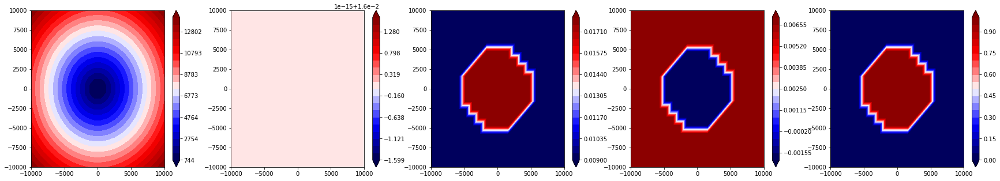

In [3]:
dof_pts = m[0][m[1]].reshape((-1,3))
distance_from_center = np.linalg.norm(dof_pts, axis = 1)

def gen_peaks(n_peaks, amplitude, width):
    n_peaks = 150
    centers = (np.random.rand(n_peaks, 2) - 0.5) * 2 * L * 0.8
    As = (np.random.rand(n_peaks) - 0.5) * 0.007
    width = 1000
    r2 = (dof_pts[:,0][:,np.newaxis] - centers[:,0]) ** 2 + (dof_pts[:,2][:,np.newaxis] - centers[:,1]) ** 2
    -r2 / (width ** 2)
    Q = np.sum(As * np.exp(-r2 / (width ** 2)), axis = 1)
    plot_fields(qdm.m, Q)
    return Q

lin_dist = L / 2
lin_slope = 0.02 / L
b = np.where(distance_from_center < lin_dist, 0.018, 0.009)#-1 * (lin_dist - distance_from_center) * lin_slope + 0.014)
a = np.ones_like(b) * 0.016
# a += gen_peaks(75, 0.003, 2000)
# b += gen_peaks(75, 0.007, 2000)
qd_cfg['a'] = a
qd_cfg['b'] = b
all_fields = np.vstack((distance_from_center, qd_cfg['a'], qd_cfg['b'], qd_cfg['a'] - qd_cfg['b'], qd_cfg['a'] - qd_cfg['b'] < 0)).T
plot_fields(qdm.m, all_fields)

Check that the "process zone" and $k_{crit}$ are good. See section 6 in Erickson et al 2014

In [4]:
mesh_L = min(L, W) / n_fault
Lb = qd_cfg['sm'] * qd_cfg['Dc'] / (qd_cfg['additional_normal_stress'] * qd_cfg['b'])
hstar = (np.pi * qd_cfg['sm'] * qd_cfg['Dc']) / (qd_cfg['additional_normal_stress'] * (qd_cfg['b'] - qd_cfg['a']))
# all_fields = np.vstack((Lb, hstar, np.ones_like(hstar) * mesh_L)).T
# plot_fields(qdm.m, all_fields)
np.min(np.abs(hstar)), np.min(Lb), mesh_L

(21542.349624615719, 2666.666666666667, 500.0)

Setup the (slip -> traction) operator

Set up initial conditions. The edges of the fault should move at the plate rate and the interior should be moving at 1/1000th the plate rate. Then, solve for the corresponding steady state.

In [5]:
# def steady_state(V_mag):
#     # This could just be analytically solved, but why not just do it numerically...
#     def f(state):
#         return aging_law(qd_cfg, V_mag, state)
#     return fsolve(f, 0.0, maxfev = 10000)
initial_state = 0.8 * np.ones(qdm.m.tris.shape[0] * 3)

In [6]:
initial_state

array([ 0.8,  0.8,  0.8, ...,  0.8,  0.8,  0.8])

In [7]:
def separate_slip_state(y):
    n_total_dofs = y.shape[0]
    n_slip_dofs = n_total_dofs // 4 * 3
    return y[:n_slip_dofs], y[n_slip_dofs:]

def rate_state_solve(qdm, qd_cfg, traction, state):
    V = np.empty_like(qdm.slip100)
    qd_newton.rate_state_solver(
        qdm.tri_normals, traction, state, V,
        qd_cfg['a'], qd_cfg['eta'], qd_cfg['V0'],
        qd_cfg['additional_normal_stress'],
        1e-12, 50
    )
    return V

# State evolution law -- aging law.
def aging_law(qd_cfg, V, state):
    return (qd_cfg['b'] * qd_cfg['V0'] / qd_cfg['Dc']) * (
        np.exp((qd_cfg['f0'] - state) / qd_cfg['b']) - (V / qd_cfg['V0'])
    )

def state_evolution(qd_cfg, V, state):
    V_mag = np.linalg.norm(V.reshape(-1,3), axis = 1)
    return aging_law(qd_cfg, V_mag, state)

def solve_for_full_state(qdm, qd_cfg, slip_to_traction, t, y):
    tm = Timer()
    slip, state = separate_slip_state(y)
    tm.report('sep')

    traction = -slip_to_traction(slip)
    traction += qdm.slip100 * qd_cfg['driving_rate'] * t
    
    tm.report('slip_to_traction')
    V = rate_state_solve(qdm, qd_cfg, traction, state)
    tm.report('rate_state_solve')
    dstatedt = state_evolution(qd_cfg, V, state)
    tm.report('state_evolution')
    return slip, state, traction, V, dstatedt

def make_qd_derivs(qdm, qd_cfg, slip_to_traction):
    def qd_derivs(t, y):
        slip, state, traction, V, dstatedt = solve_for_full_state(
            qdm, qd_cfg, slip_to_traction, t, y
        )
        #print('Vmax', np.max(V.reshape((-1,3)), axis = 0))
        #TODO: CHECK THE DIMENSIONS ON V AND dstatedt
        return np.concatenate((V, dstatedt))
    return qd_derivs

def plot_setting(t, y, qdm, qd_cfg, slip_to_traction):
    slip, state, traction, V, dstatedt = solve_for_full_state(
        qdm, qd_cfg, slip_to_traction, t, y
    )
    #print('slip')
    #plot_signs(slip)
    #plot_fields(np.log10(np.abs(slip) + 1e-40))
    #print('deficit')
    #plot_signs(slip_deficit)
    #plot_fields(np.log10(np.abs(slip_deficit) + 1e-40))
    print('V')
    #plot_signs(V)
    plot_fields(qdm.m, np.log10(np.abs(V) + 1e-40))
    print('traction')
    plot_fields(qdm.m, traction)
    print('state')
    plot_fields(qdm.m, state)

In [8]:
import os
os.environ['CUDA_DEVICE'] = '0'

In [9]:
slip_to_traction = get_slip_to_traction(qdm, qd_cfg)
derivs = make_qd_derivs(qdm, qd_cfg, slip_to_traction)

[3244:INFO:tectosaur.util.cuda]
    Initialized CUDA on gpu: 0


In [10]:
initial_conditions = np.concatenate((np.zeros(qdm.m.n_dofs()), initial_state))
integrator = RK45(derivs, 0, initial_conditions, 1e20, atol = 1e-5, rtol = 1e-5)

0 3.1688087814e-12
V


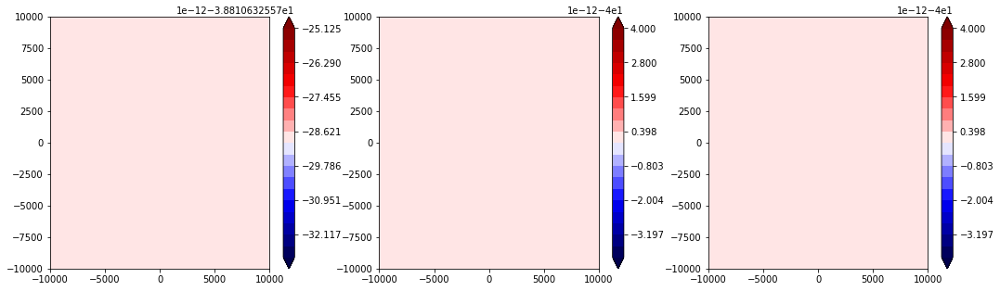

traction


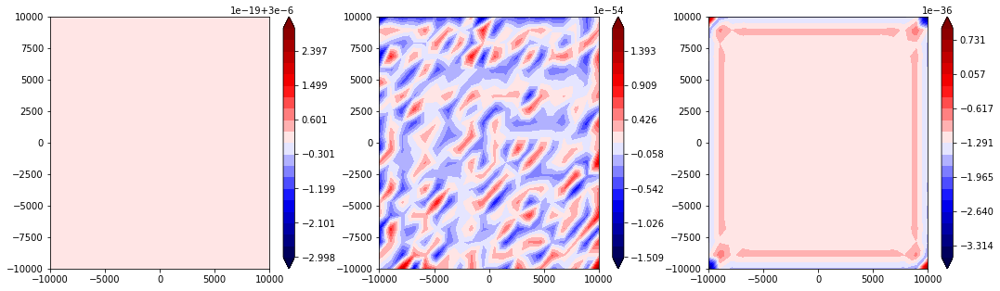

state


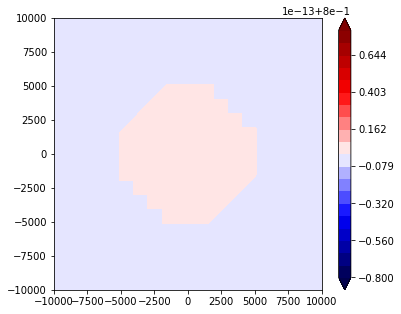

1 3.48568965954e-11
2 3.51737774736e-10
3 3.52054655614e-09
4 3.52086343702e-08
5 3.5208951251e-07
6 3.52089829391e-06
7 3.52089861079e-05
8 0.000352089864248
9 0.00352089864565
10 0.0352089864597
V


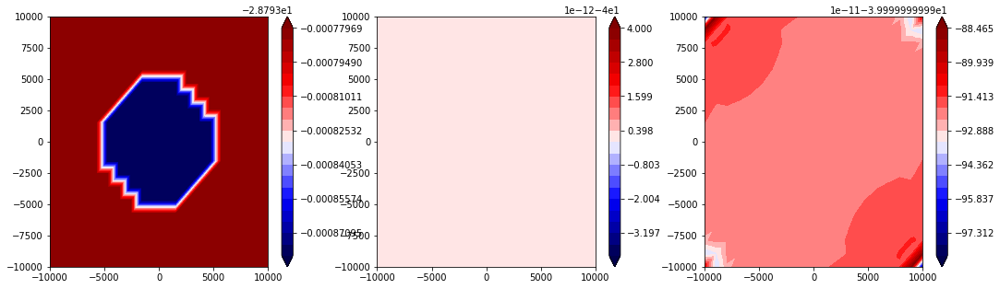

traction


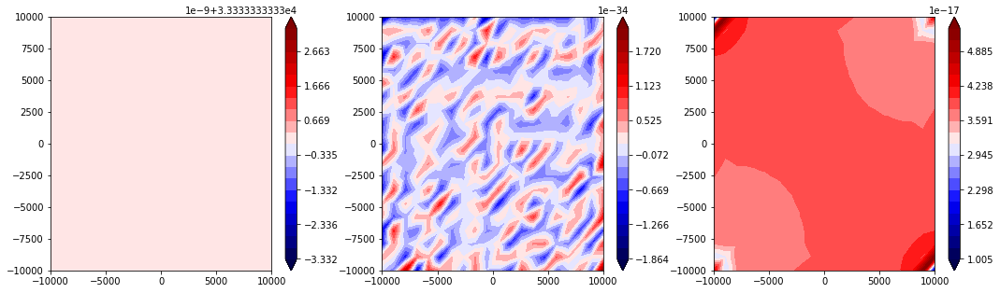

state


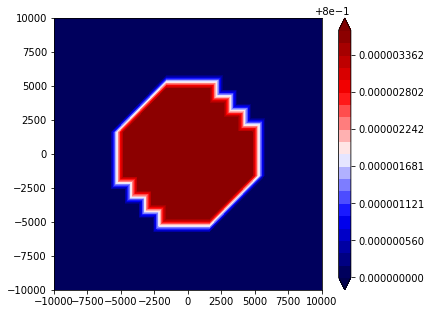

11 0.3520898646
12 3.520898646
13 11.7692359052


/home/tthompson/tools/pyenv/versions/miniconda3-4.3.11/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: overflow encountered in exp
/home/tthompson/tools/pyenv/versions/miniconda3-4.3.11/lib/python3.6/site-packages/scipy/integrate/_ivp/rk.py:141: RuntimeWarning: invalid value encountered in true_divide
  error_norm = norm(error / scale)


14 28.2659104235
15 31.3890756746
16 32.8952398398
17 34.1978826771
18 35.0628509228
19 35.5615207636
20 35.93287585
V


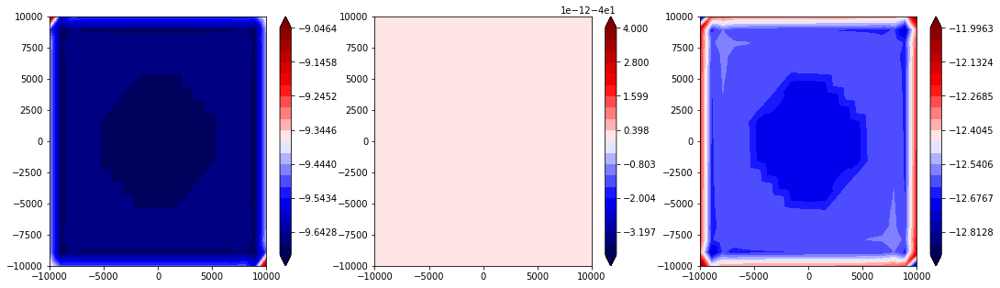

traction


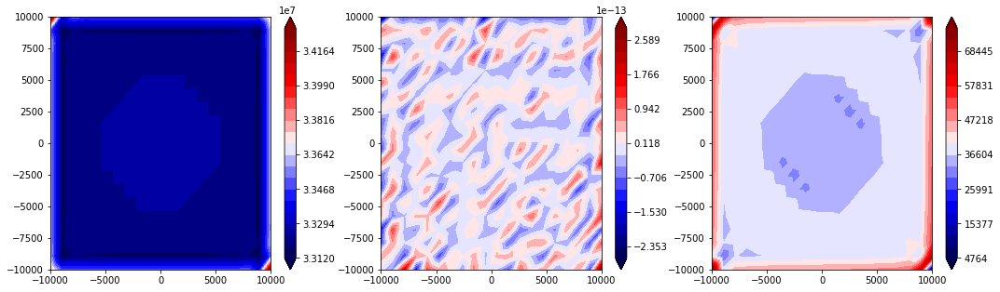

state


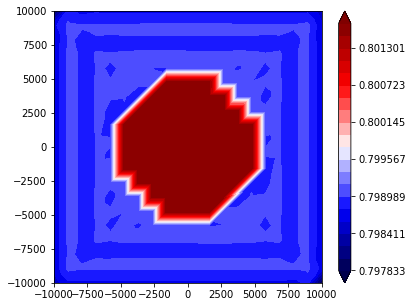

21 36.2541429427
22 36.5514624006
23 36.8105554505
24 36.9647324504
25 37.0485712867
26 37.094454254
27 37.1201758211
28 37.1348154542
29 37.1432329068
30 37.1480820626
V


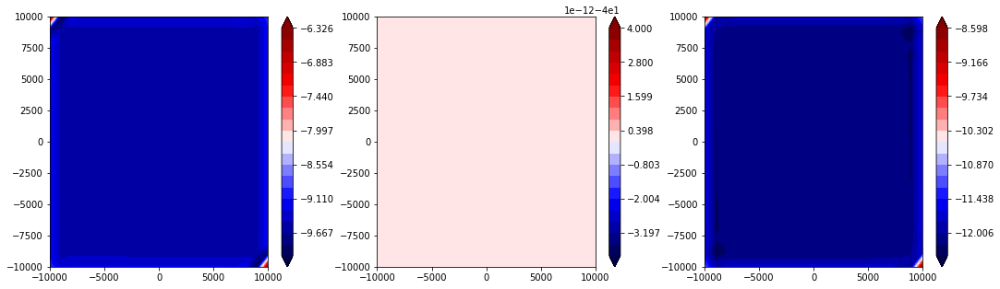

traction


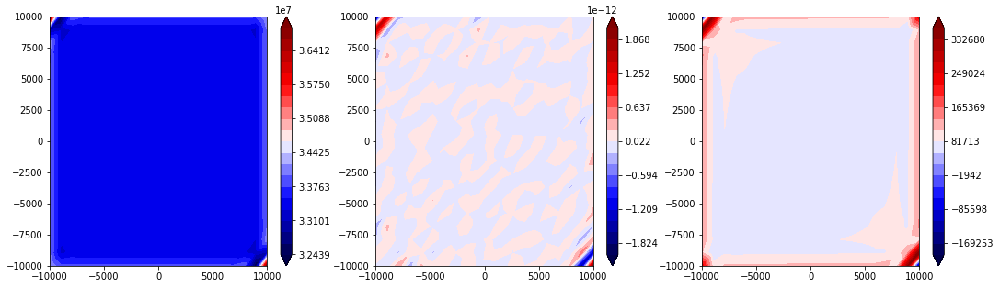

state


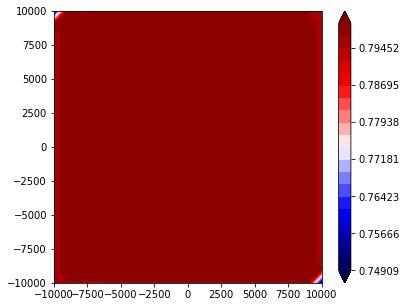

31 37.150869452
32 37.1524630588
33 37.1533712255
34 37.1538868916
35 37.1541734118
36 37.1543318103
37 37.1544187269
38 37.1544658778
39 37.1544909427
40 37.1545038084
V


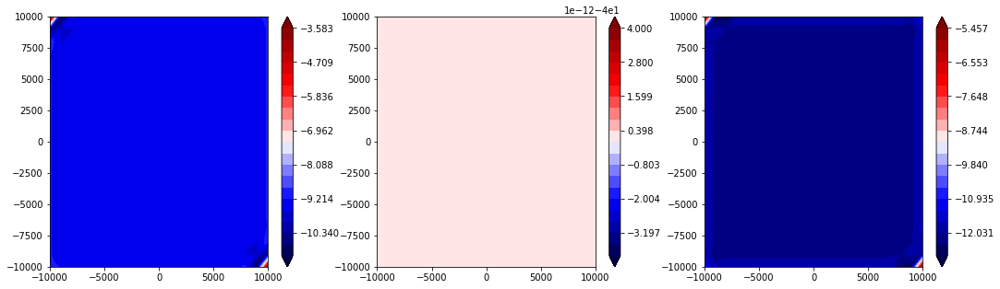

traction


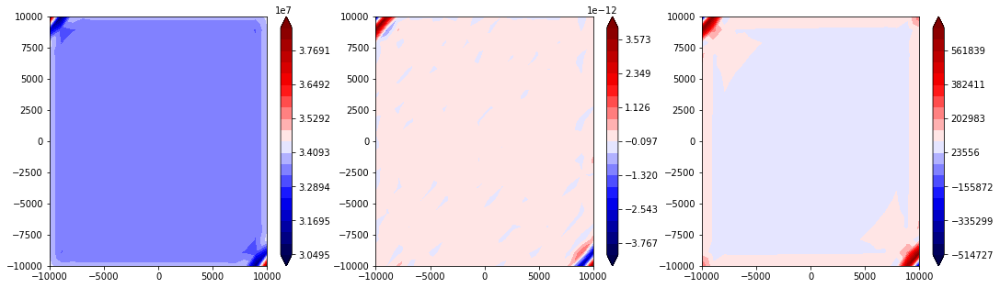

state


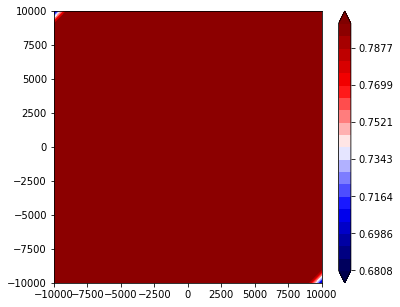

41 37.1545101201
42 37.1545130986
43 37.1545144639
44 37.1545150766
45 37.1545153489
46 37.1545154713
47 37.1545155293
48 37.1545155597
49 37.154515578
50 37.1545155906
V


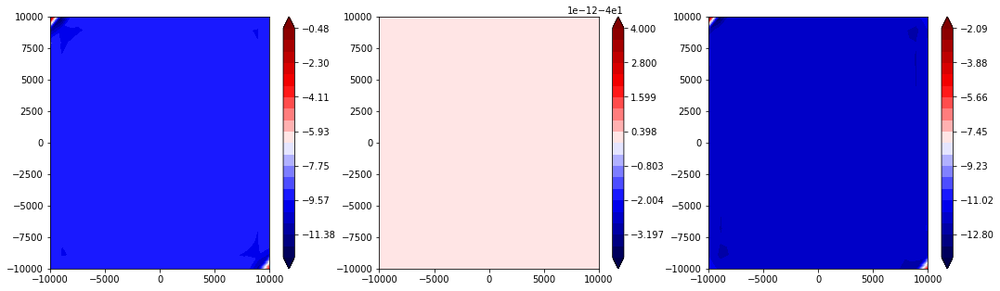

traction


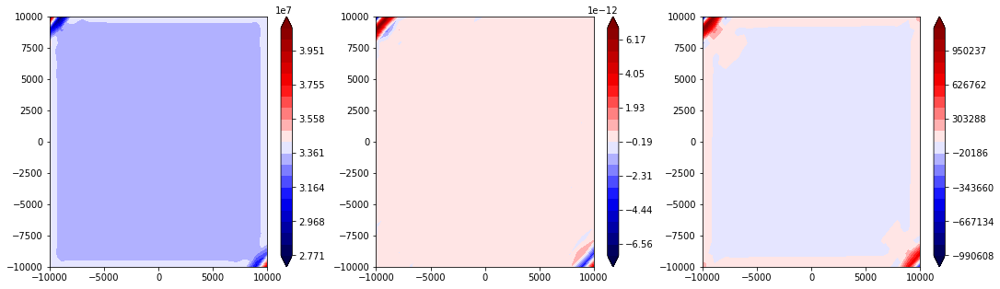

state


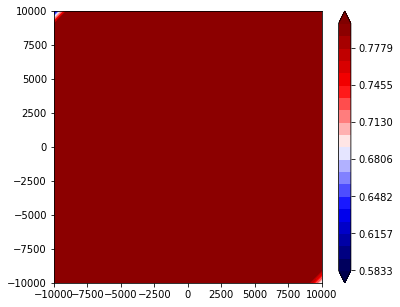

51 37.1545156002
52 37.154515608
53 37.1545156147
54 37.1545156207
55 37.1545156237
56 37.1545156276
57 37.1545156296
58 37.1545156308
59 37.1545156318
60 37.1545156329
V


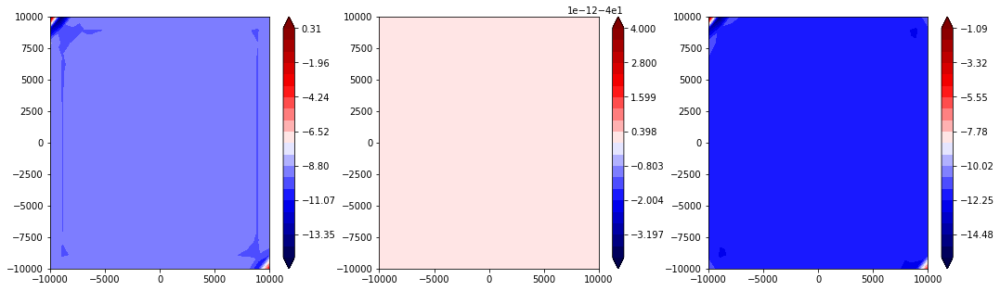

traction


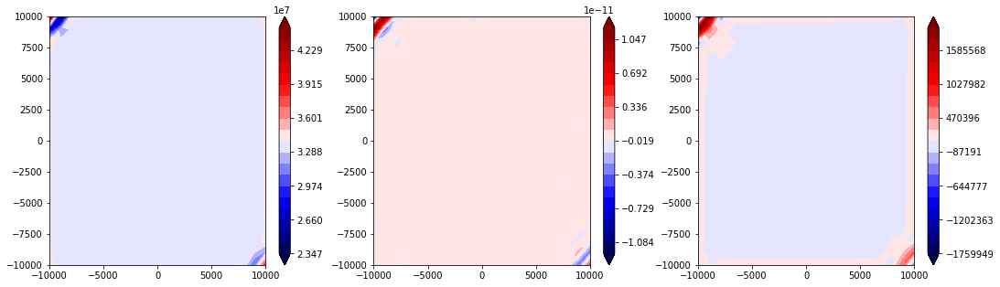

state


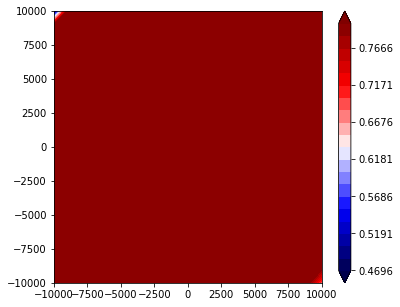

61 37.1545156352
62 37.1545156411
63 37.1545156423
64 37.1545156435
65 37.1545156458
66 37.1545156503
67 37.1545156512
68 37.1545156529
69 37.1545156567
70 37.1545156575
V


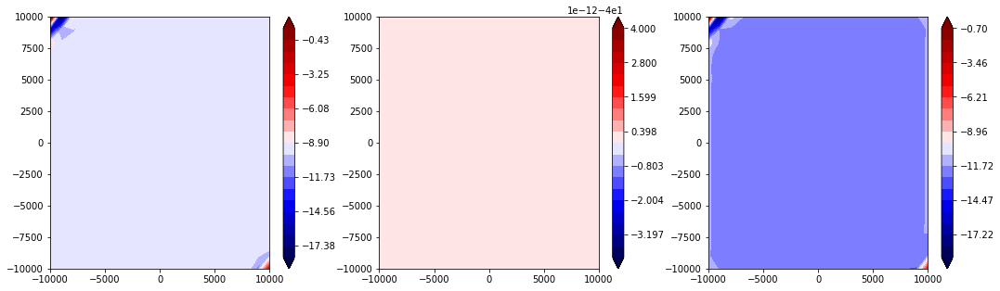

traction


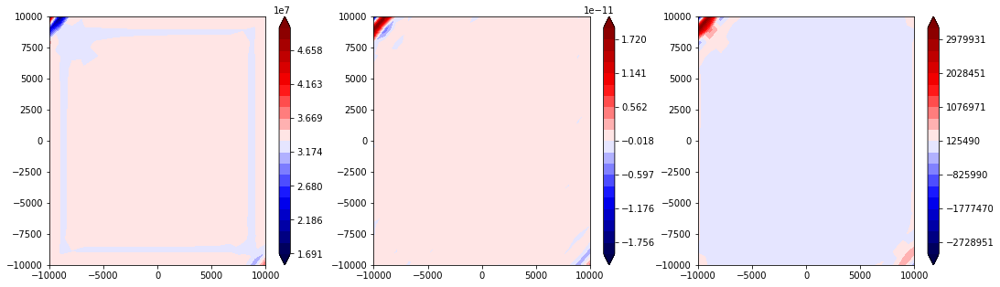

state


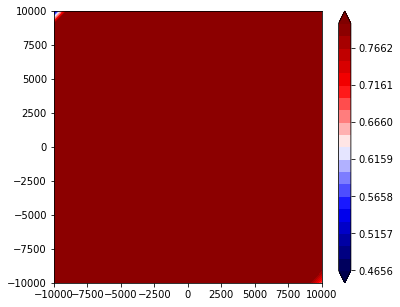

71 37.1545156586
72 37.1545156613
73 37.1545156623
74 37.1545156649
75 37.1545156656
76 37.1545156676
77 37.15451567
78 37.1545156707
79 37.1545156725
80 37.1545156746
V


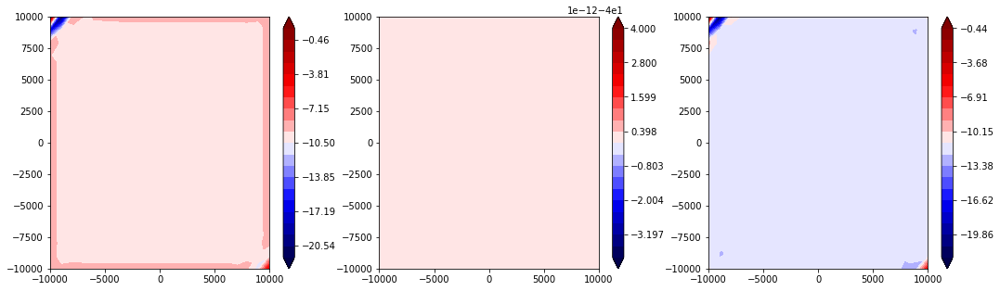

traction


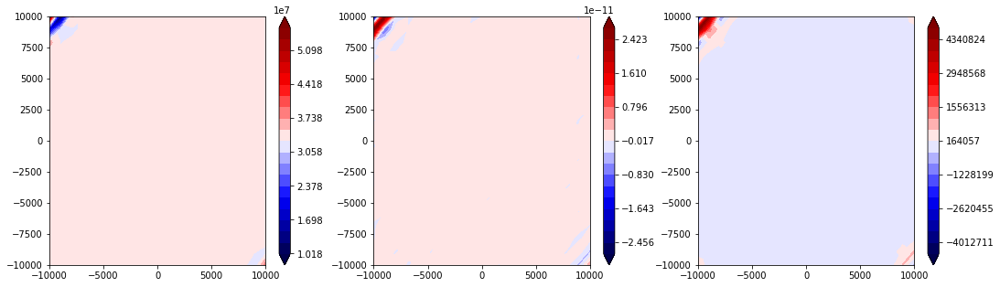

state


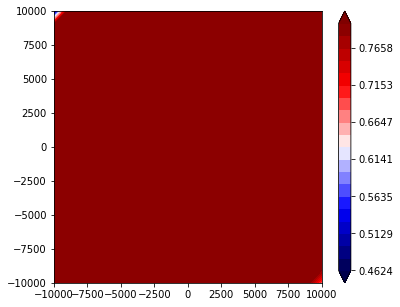

81 37.1545156756
82 37.1545156784
83 37.154515679
84 37.1545156801
85 37.1545156823
86 37.1545156828
87 37.1545156839
88 37.154515686
89 37.1545156865
90 37.1545156875
V


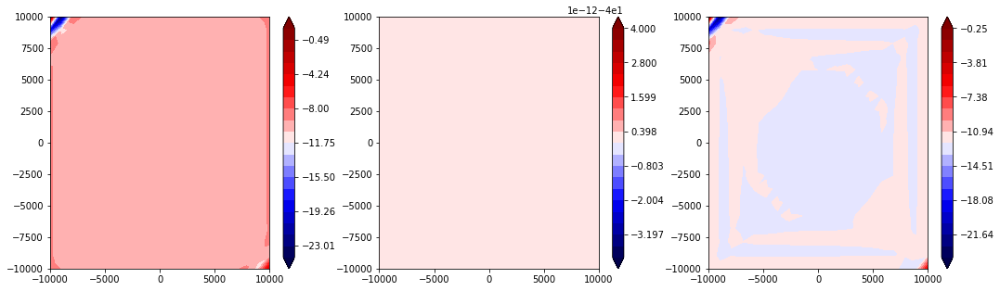

traction


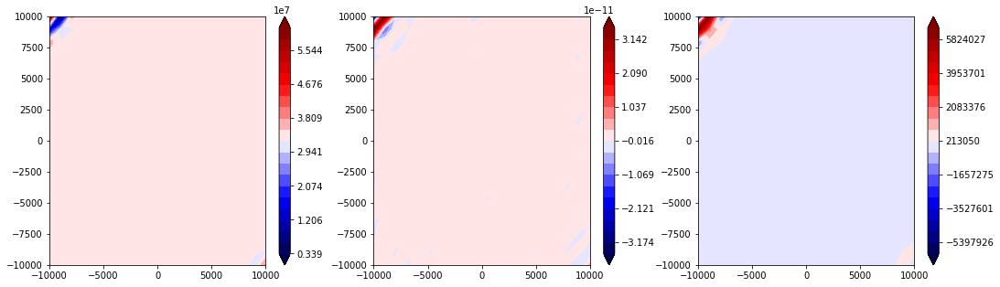

state


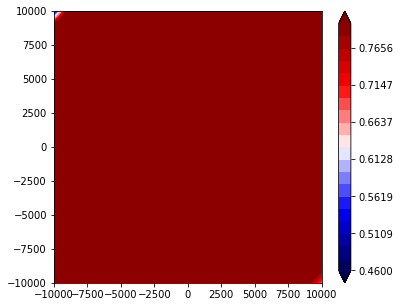

91 37.1545156895
92 37.1545156899
93 37.154515691
94 37.1545156928
95 37.1545156932
96 37.154515694
97 37.1545156957
98 37.1545156961
99 37.154515697
100 37.1545156987
V


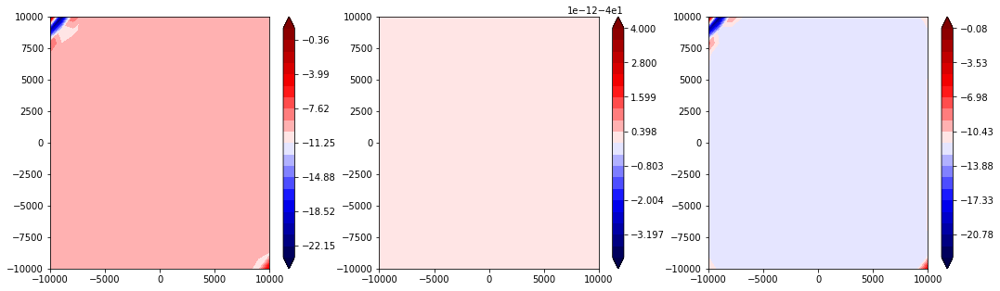

traction


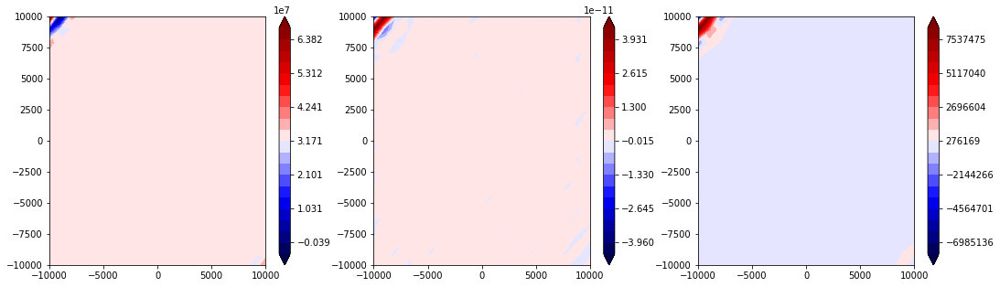

state


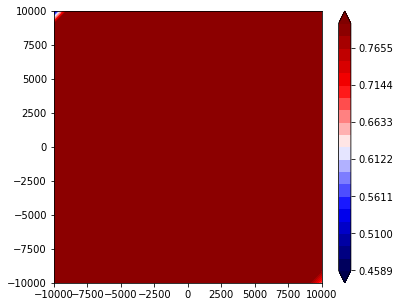

101 37.154515699
102 37.1545156997
103 37.1545157012
104 37.1545157015
105 37.1545157024
106 37.1545157038
107 37.1545157041
108 37.1545157049
109 37.1545157063
110 37.1545157066
V


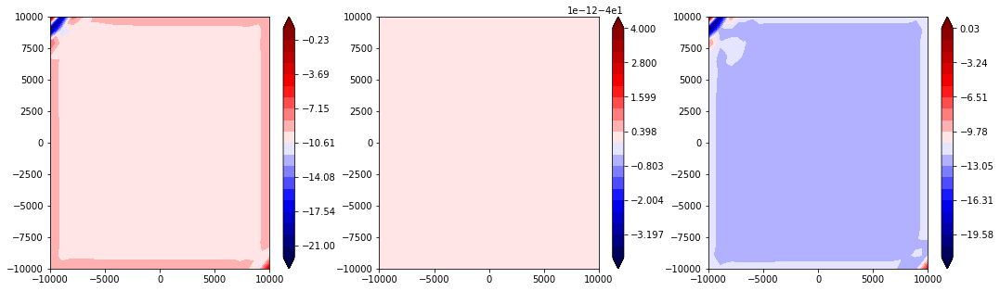

traction


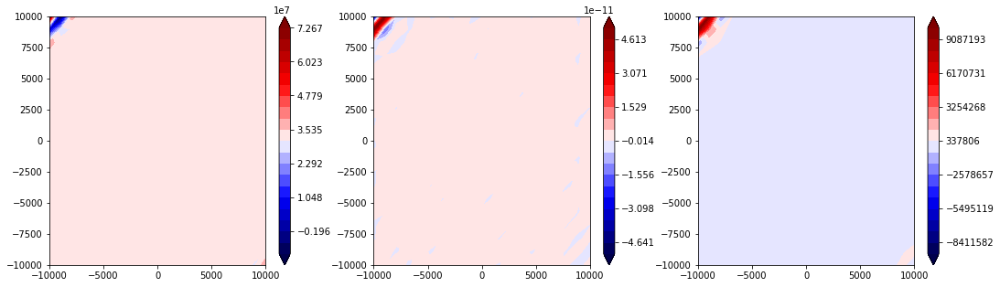

state


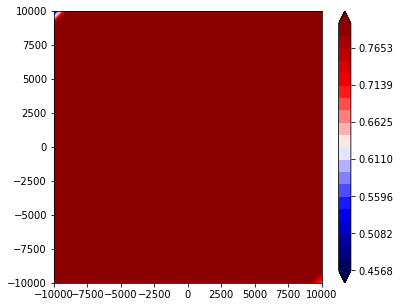

111 37.1545157073
112 37.1545157087
113 37.1545157089
114 37.1545157095
115 37.1545157108
116 37.1545157111
117 37.1545157118
118 37.154515713
119 37.1545157132
120 37.1545157138
V


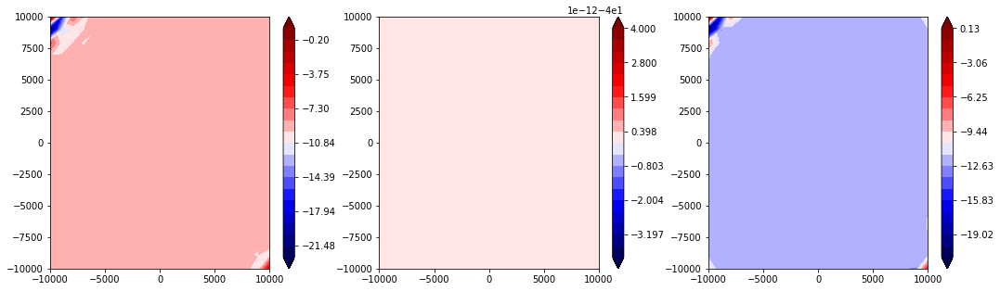

traction


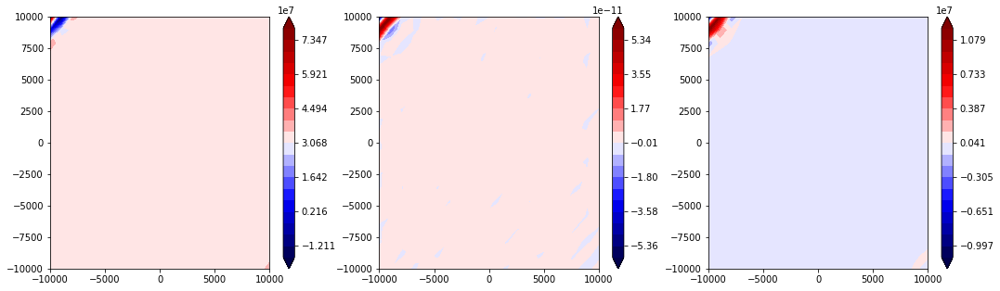

state


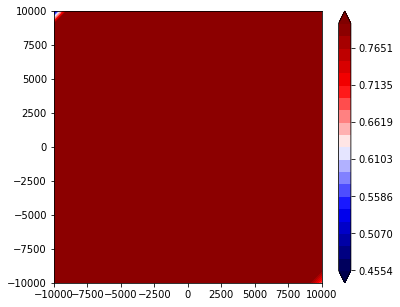

121 37.1545157149
122 37.1545157151
123 37.1545157157
124 37.1545157168
125 37.1545157171
126 37.1545157177
127 37.1545157188
128 37.154515719
129 37.1545157194
130 37.1545157203
V


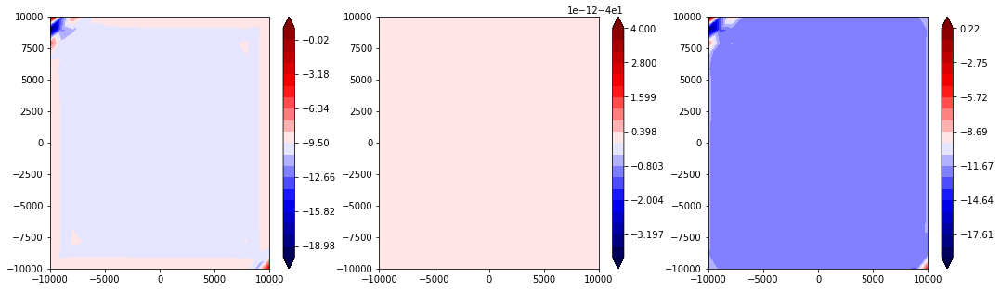

traction


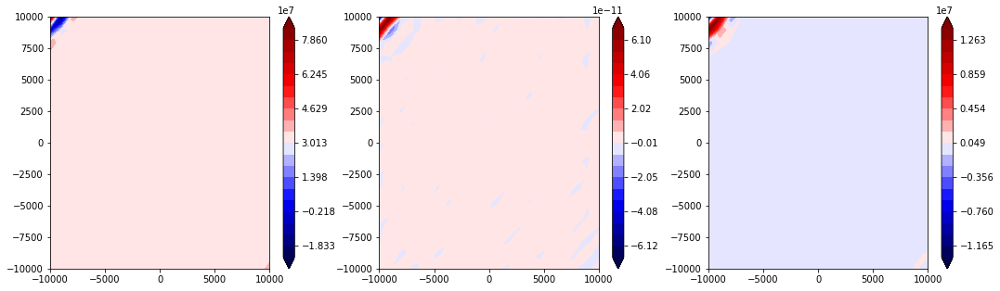

state


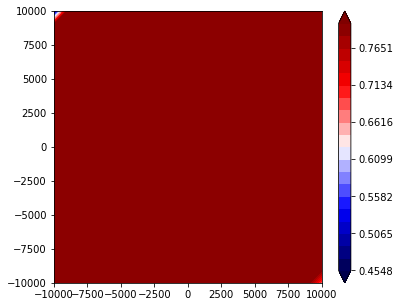

131 37.1545157205
132 37.154515721
133 37.154515722
134 37.1545157222
135 37.1545157228
136 37.1545157238
137 37.154515724
138 37.1545157243
139 37.1545157249
140 37.1545157256
V


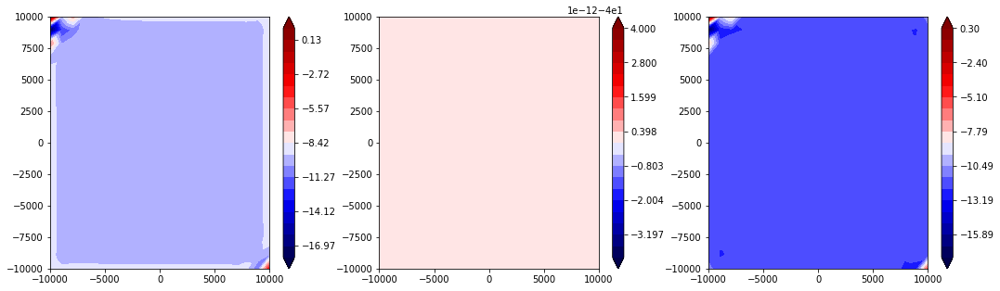

traction


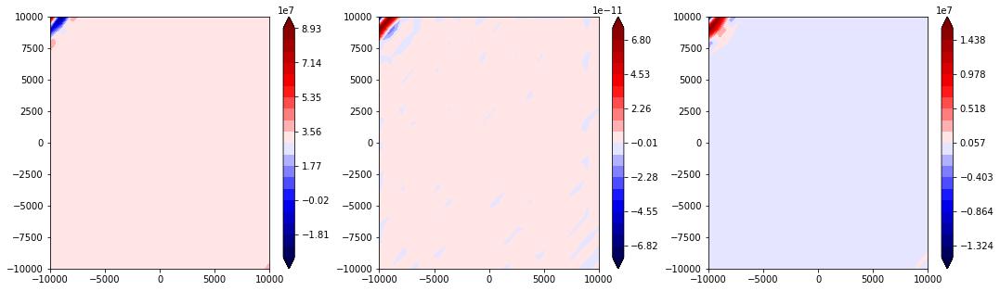

state


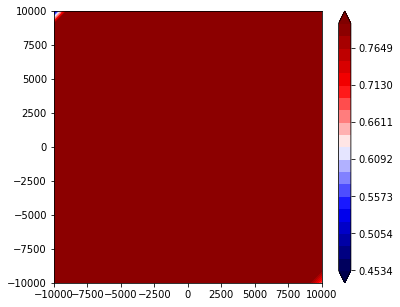

141 37.1545157261
142 37.154515727
143 37.1545157272
144 37.1545157276
145 37.1545157285
146 37.1545157287
147 37.1545157293
148 37.1545157301
149 37.1545157303
150 37.1545157305
V


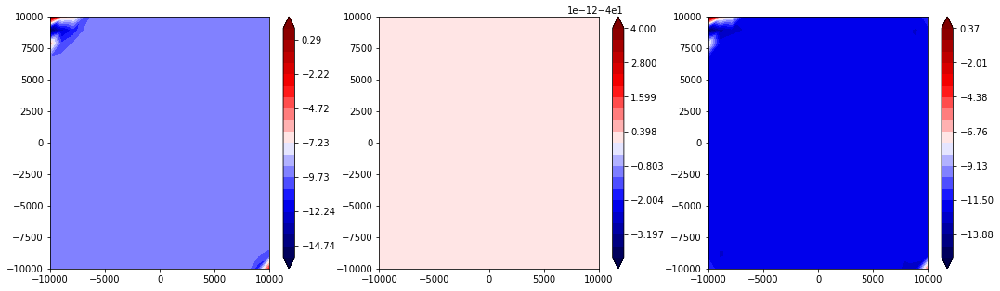

traction


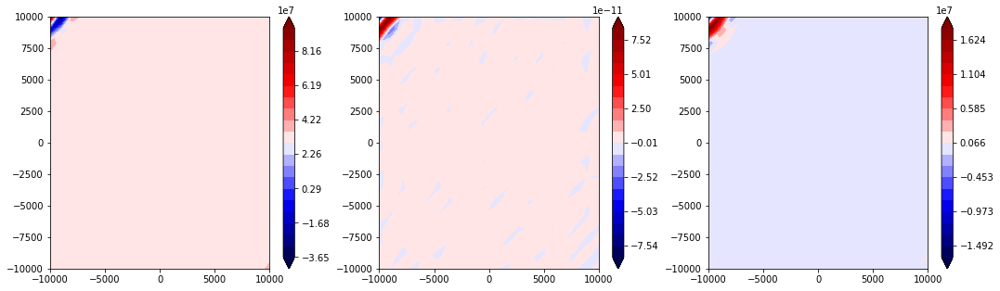

state


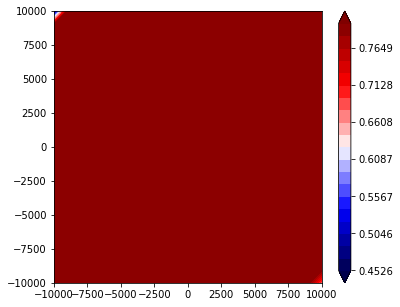

151 37.154515731
152 37.1545157318
153 37.154515732
154 37.1545157322
155 37.154515733
156 37.1545157332
157 37.1545157333
158 37.1545157336
159 37.1545157344
160 37.1545157345
V


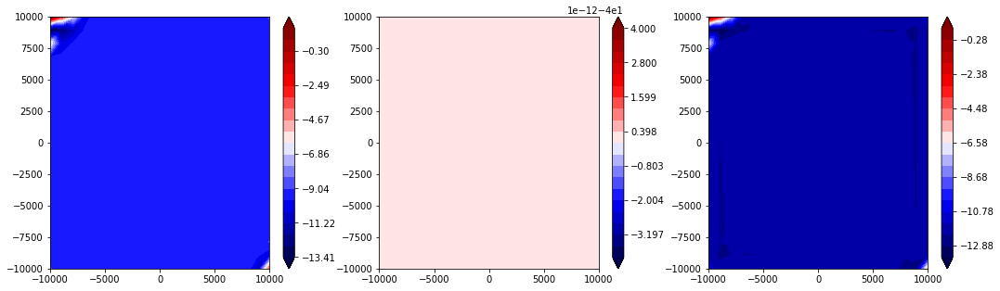

traction


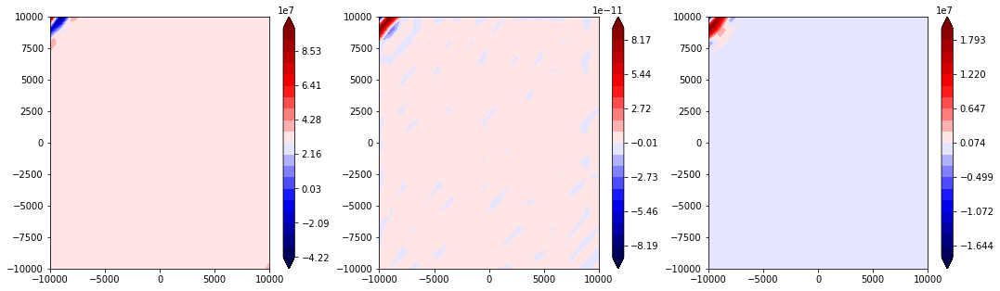

state


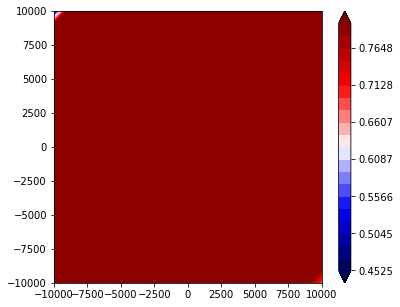

161 37.1545157346
162 37.1545157349
163 37.1545157357
164 37.1545157358
165 37.1545157359
166 37.1545157362
167 37.1545157369
168 37.1545157371
169 37.1545157373
170 37.1545157377
V


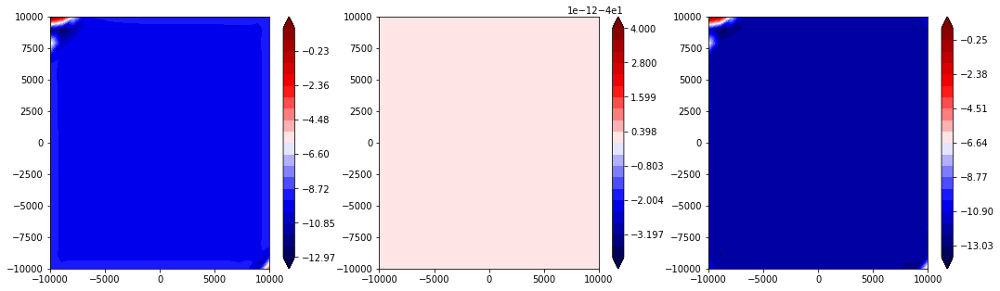

traction


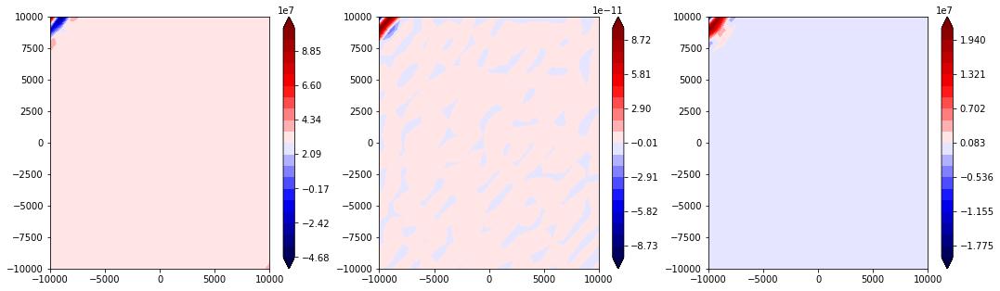

state


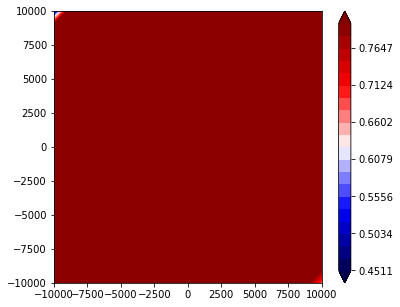

171 37.1545157384
172 37.1545157385
173 37.1545157389
174 37.1545157396
175 37.1545157397
176 37.1545157402
177 37.1545157409
178 37.154515741
179 37.1545157412
180 37.1545157417
V


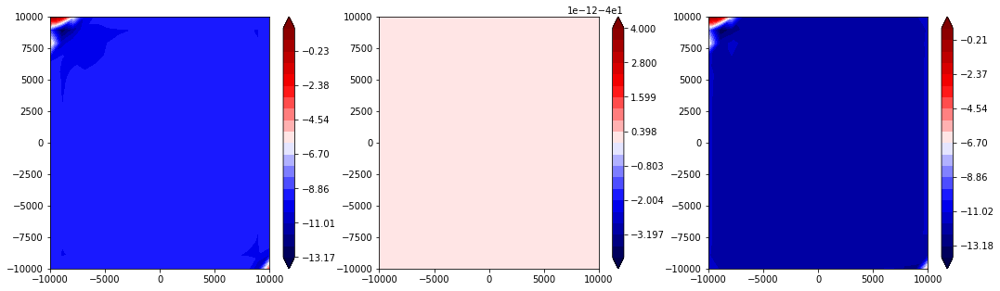

traction


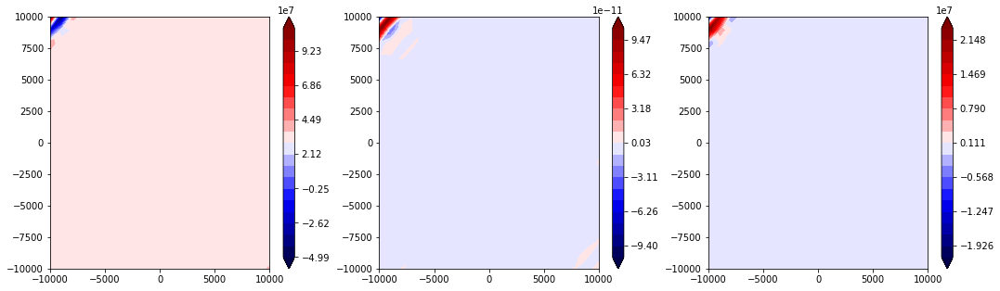

state


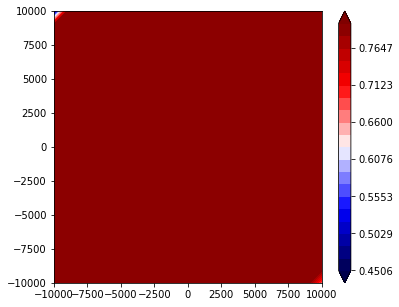

181 37.1545157422
182 37.1545157425
183 37.1545157432
184 37.1545157433
185 37.1545157437
186 37.1545157444
187 37.1545157445
188 37.1545157448
189 37.1545157455
190 37.1545157456
V


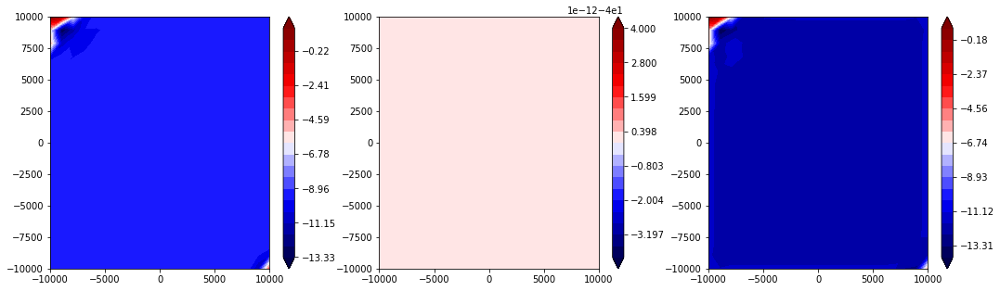

traction


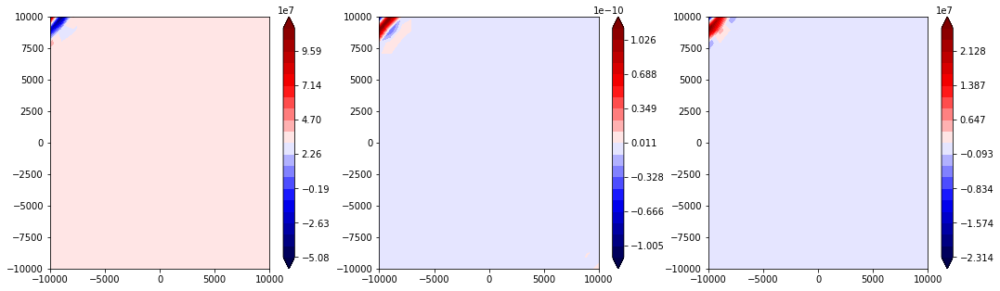

state


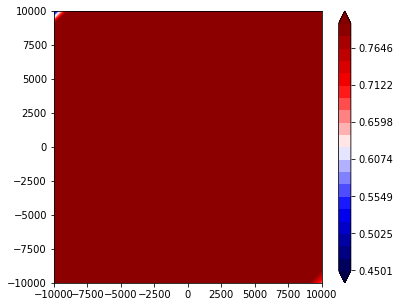

191 37.154515746
192 37.1545157466
193 37.1545157467
194 37.154515747
195 37.1545157476
196 37.1545157478
197 37.1545157482
198 37.1545157488
199 37.1545157489
200 37.154515749
V


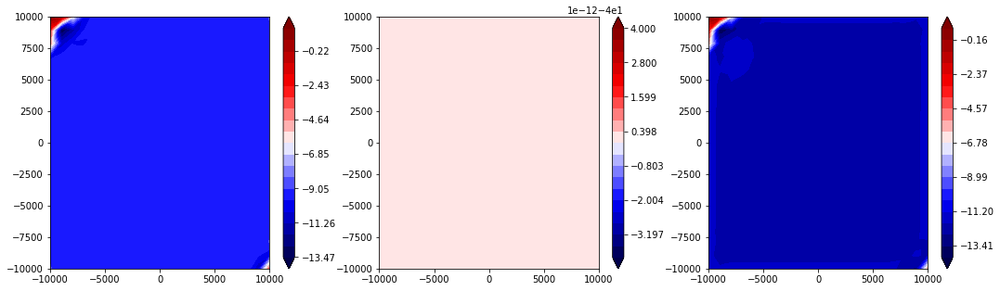

traction


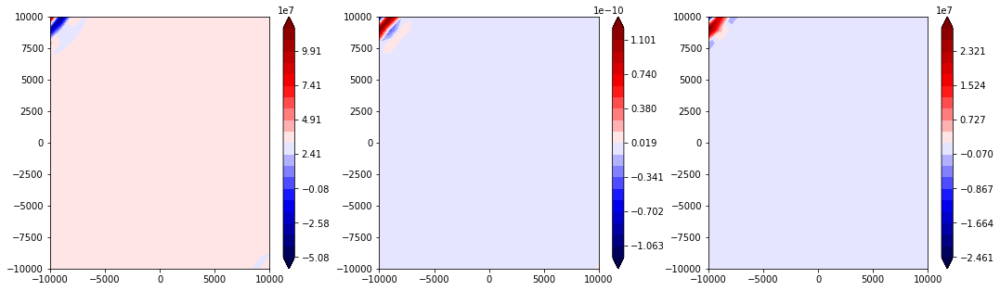

state


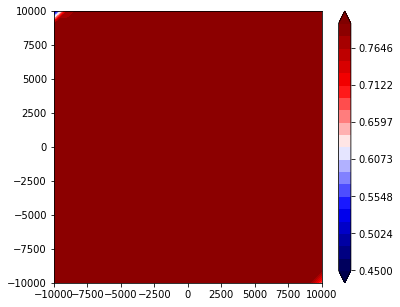

201 37.1545157492
202 37.1545157497
203 37.1545157499
204 37.1545157502
205 37.1545157508
206 37.1545157509
207 37.1545157513
208 37.1545157519
209 37.154515752
210 37.1545157522
V


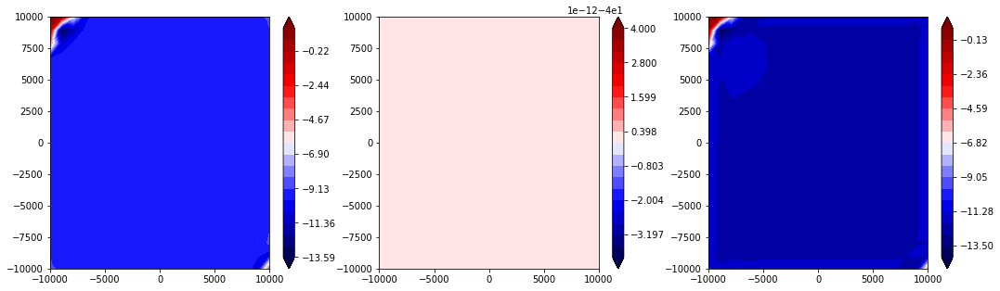

traction


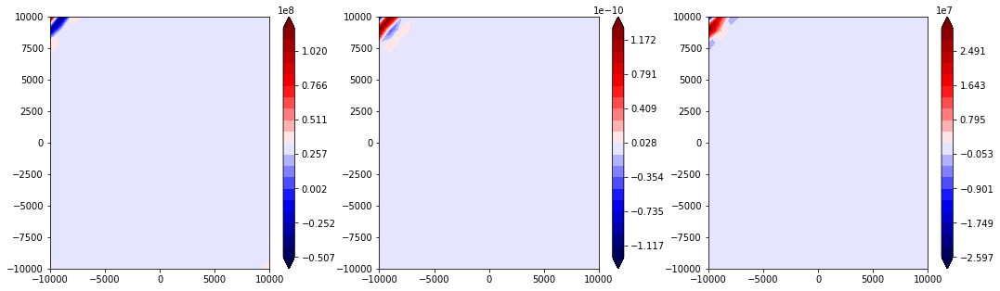

state


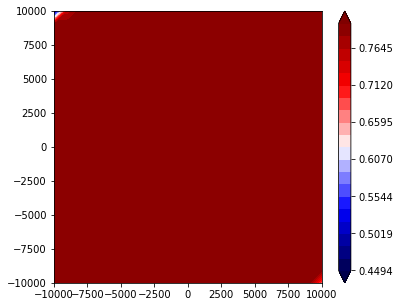

211 37.1545157525
212 37.1545157531
213 37.1545157532
214 37.1545157534
215 37.1545157539
216 37.154515754
217 37.1545157542
218 37.1545157548
219 37.1545157549
220 37.1545157553
V


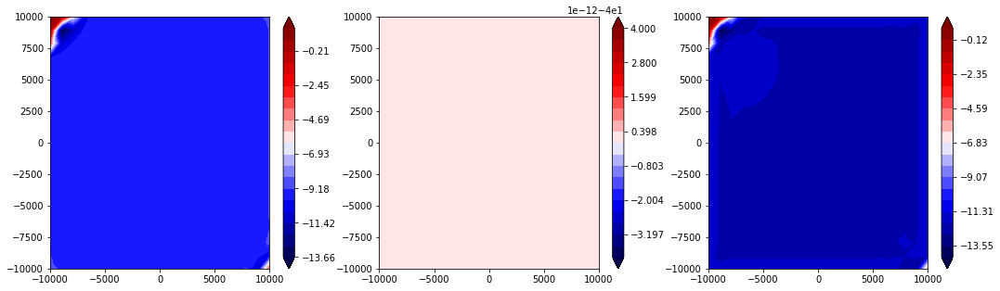

traction


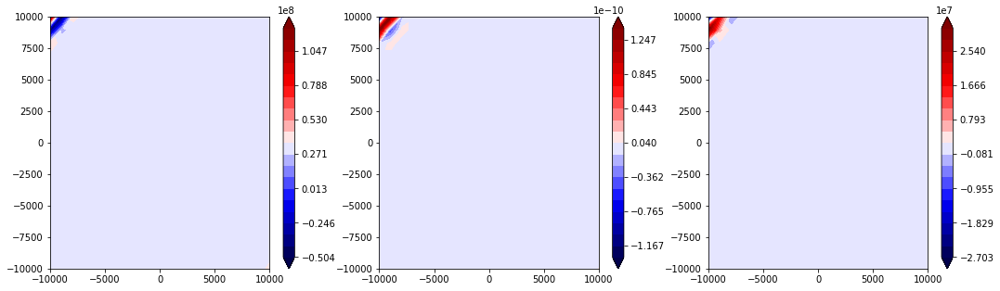

state


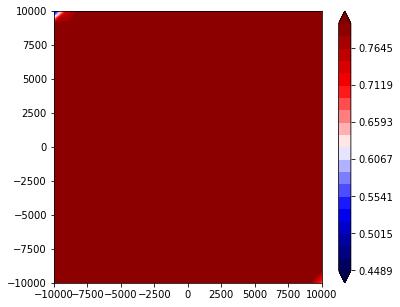

221 37.1545157559
222 37.154515756
223 37.1545157561
224 37.1545157565
225 37.154515757
226 37.1545157571
227 37.1545157572
228 37.1545157576
229 37.1545157581
230 37.1545157582
V


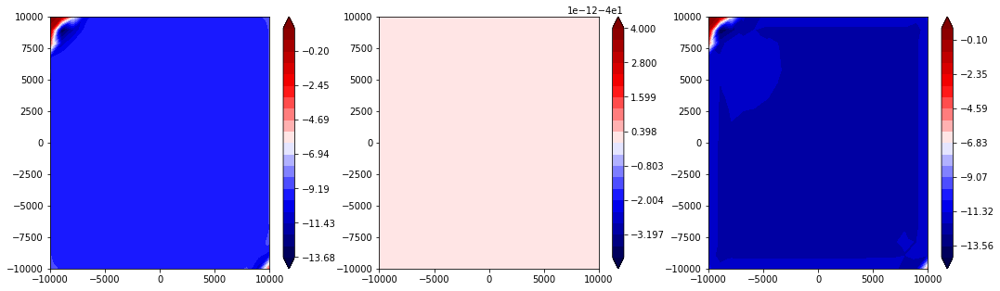

traction


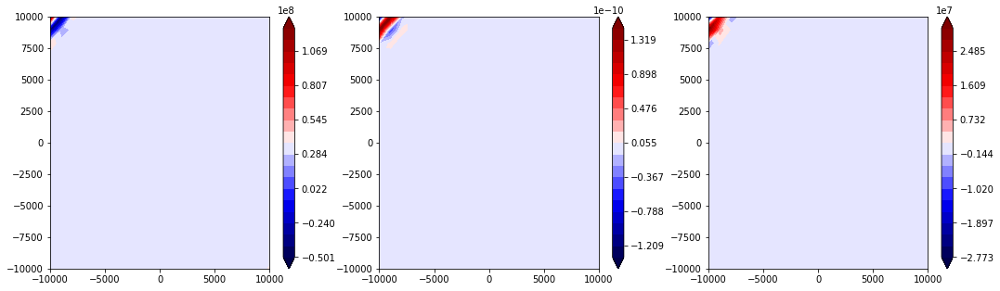

state


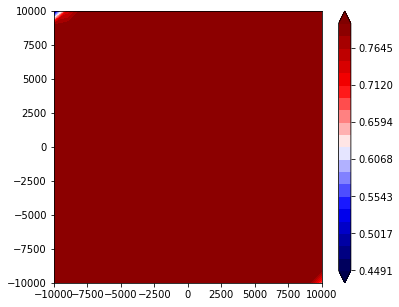

231 37.1545157584
232 37.1545157588
233 37.1545157591
234 37.1545157596
235 37.1545157597
236 37.1545157601
237 37.1545157605
238 37.1545157607
239 37.1545157609
240 37.1545157615
V


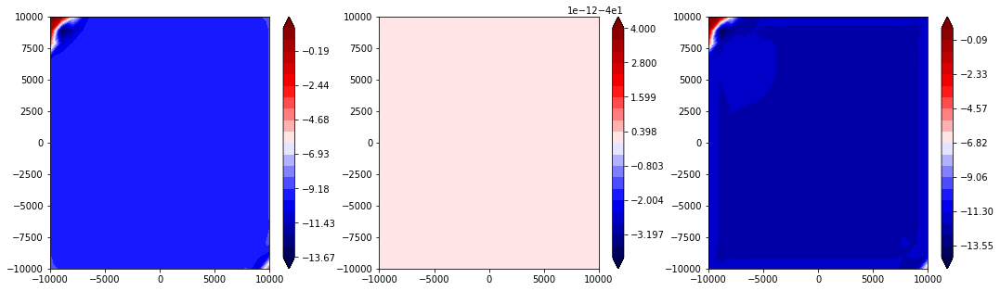

traction


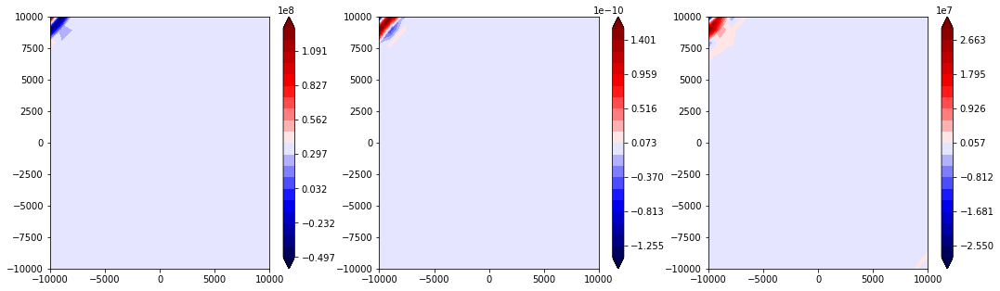

state


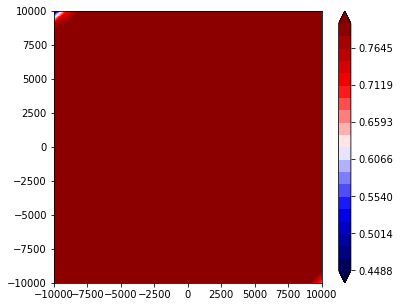

241 37.1545157616
242 37.1545157619
243 37.1545157625
244 37.1545157626
245 37.1545157627
246 37.1545157628
247 37.1545157634
248 37.1545157635
249 37.1545157636
250 37.1545157637
V


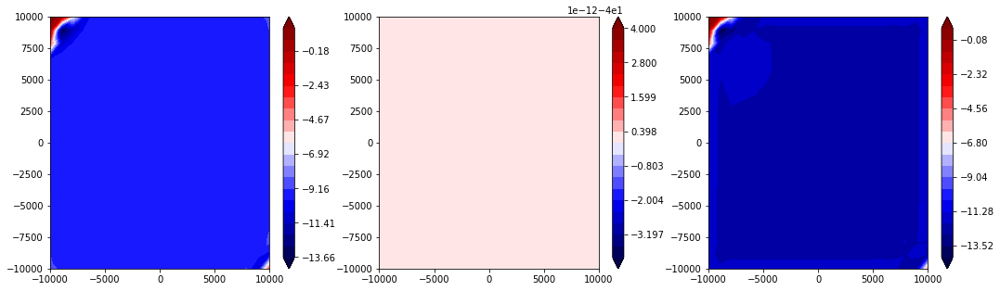

traction


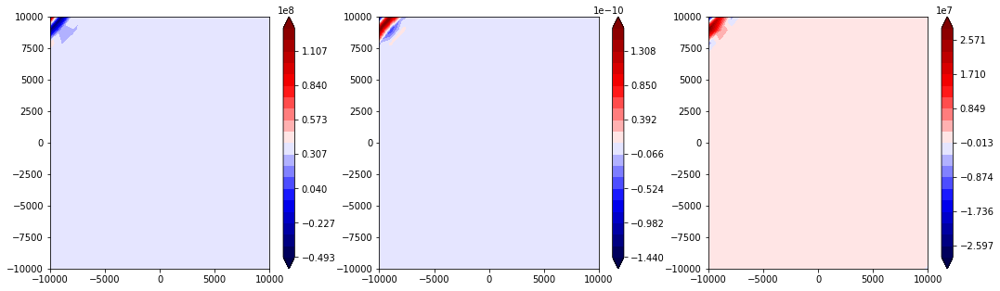

state


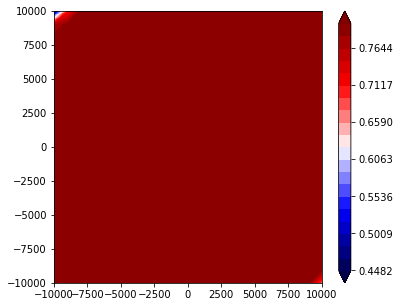

251 37.1545157643
252 37.1545157644
253 37.1545157645
254 37.1545157649
255 37.1545157652
256 37.1545157657
257 37.1545157658
258 37.154515766
259 37.1545157665
260 37.1545157666
V


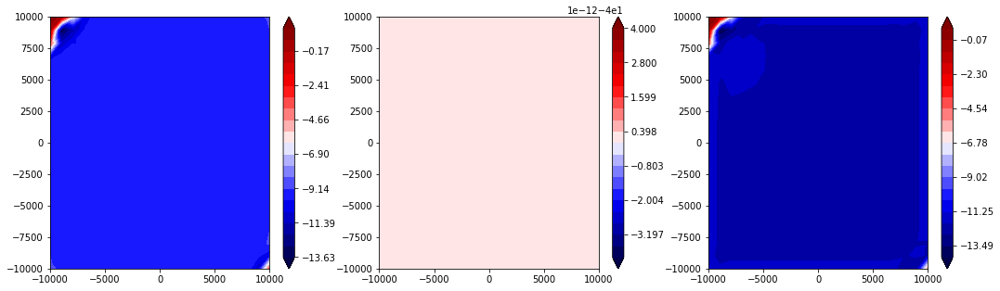

traction


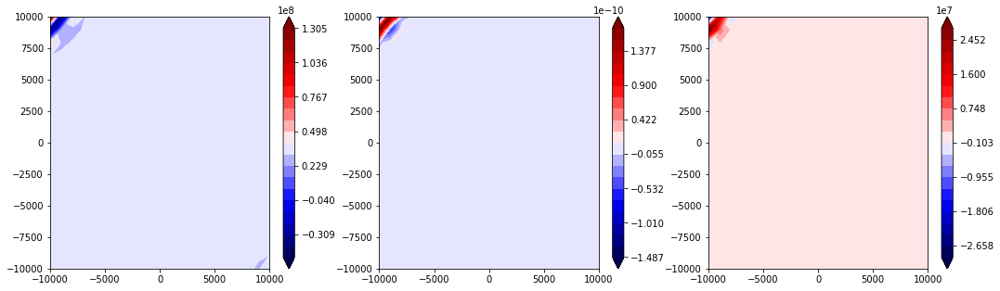

state


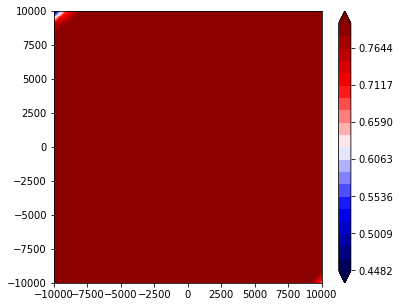

261 37.1545157669
262 37.1545157674
263 37.1545157675
264 37.1545157678
265 37.1545157683
266 37.1545157684
267 37.1545157686
268 37.154515769
269 37.1545157692
270 37.1545157697
V


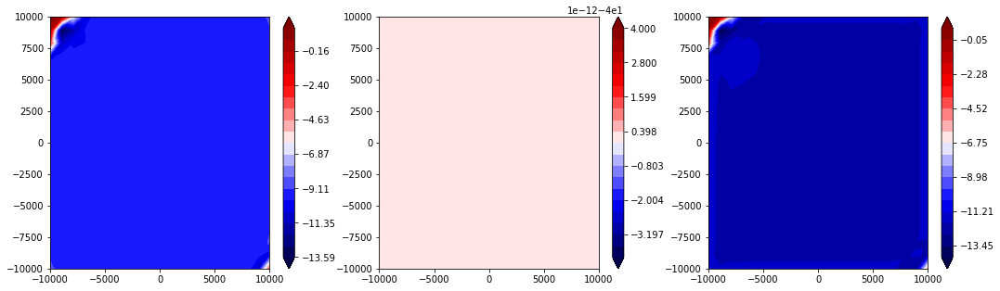

traction


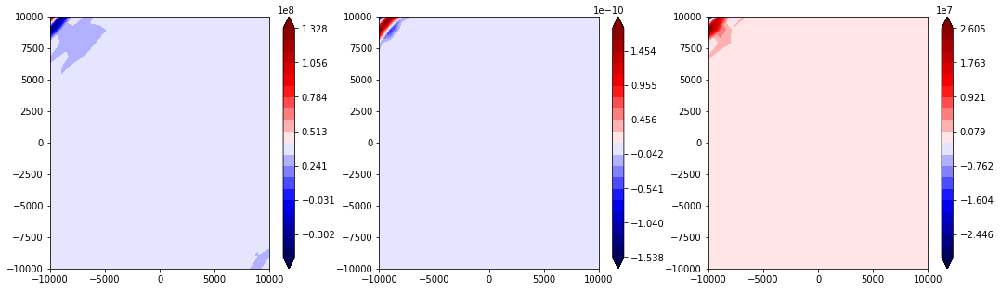

state


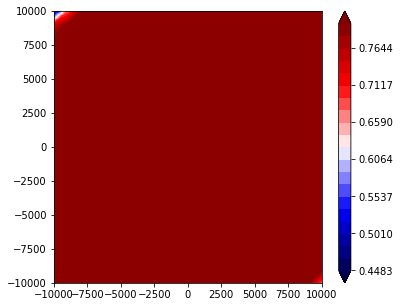

271 37.1545157698
272 37.1545157701
273 37.1545157706
274 37.1545157707
275 37.154515771
276 37.1545157715
277 37.1545157716
278 37.1545157719
279 37.1545157723
280 37.1545157724
V


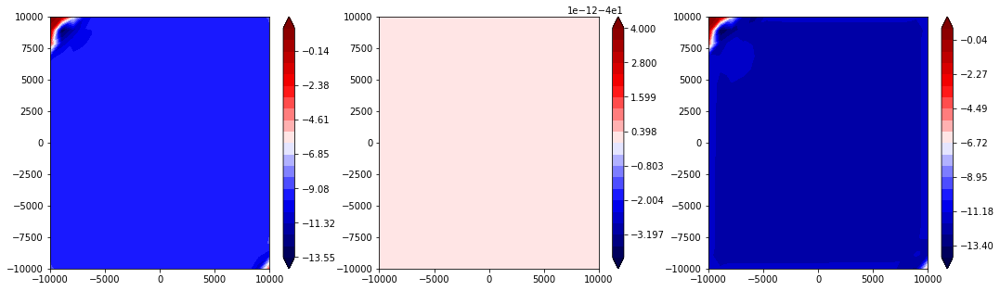

traction


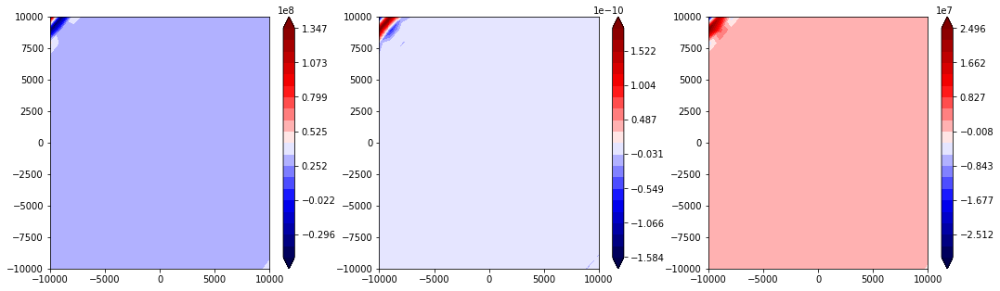

state


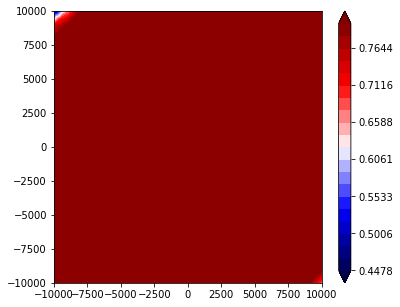

281 37.1545157727
282 37.1545157732
283 37.1545157733
284 37.1545157736
285 37.1545157741
286 37.1545157742
287 37.1545157743
288 37.1545157746
289 37.154515775
290 37.1545157751
V


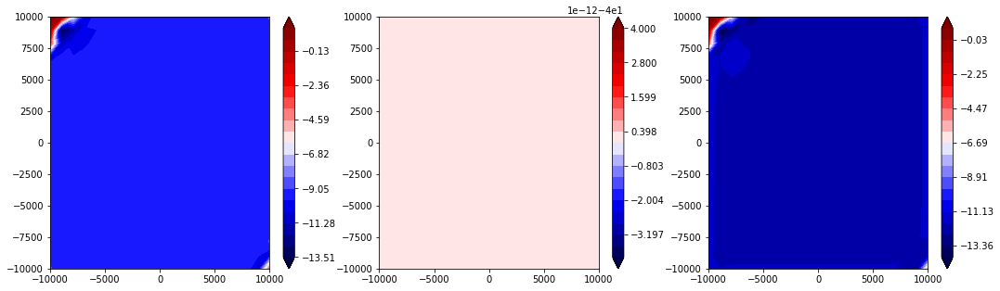

traction


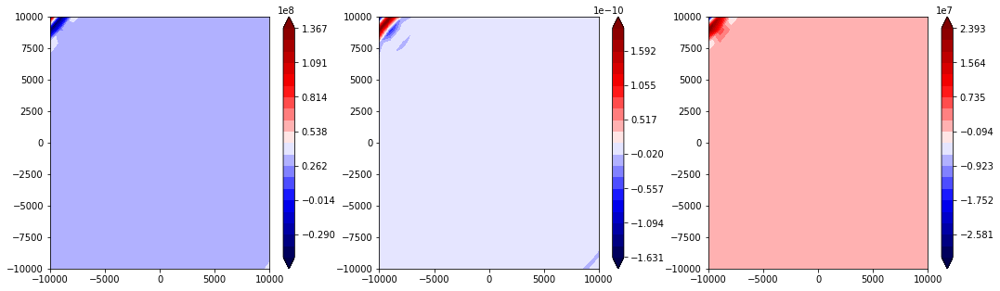

state


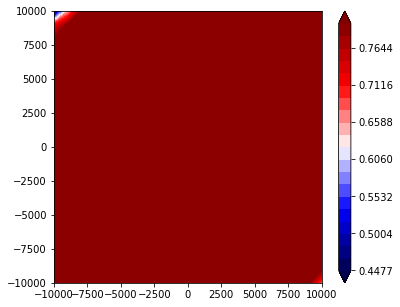

291 37.1545157753
292 37.1545157758
293 37.1545157759
294 37.1545157762
295 37.1545157767
296 37.1545157768
297 37.1545157769
298 37.1545157771
299 37.1545157775
300 37.1545157776
V


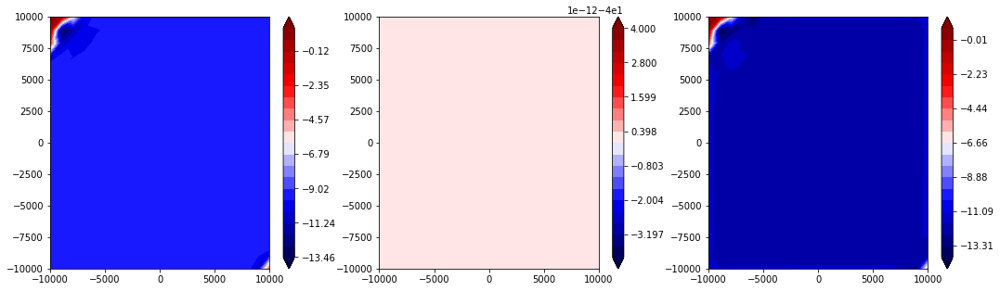

traction


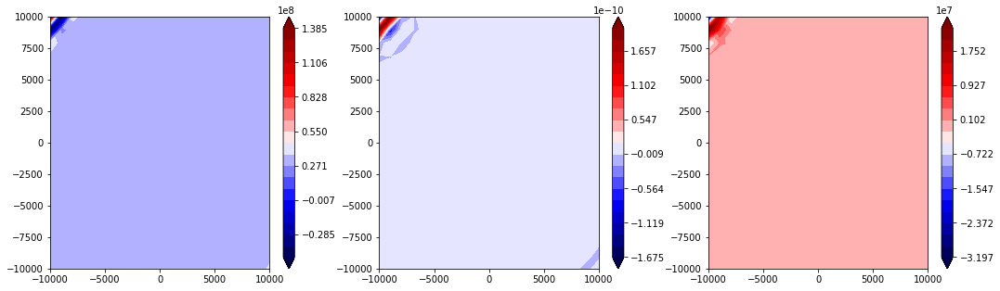

state


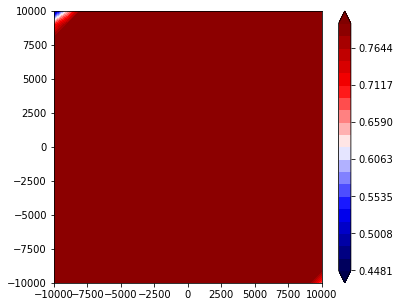

301 37.1545157777
302 37.1545157779
303 37.1545157783
304 37.1545157784
305 37.1545157785
306 37.1545157786
307 37.1545157791
308 37.1545157792
309 37.1545157793
310 37.1545157796
V


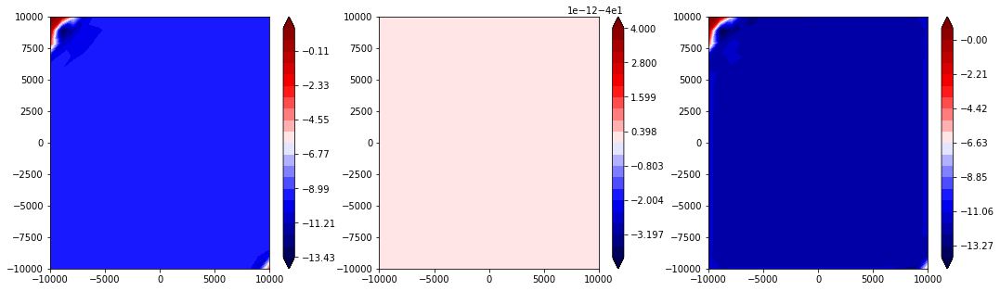

traction


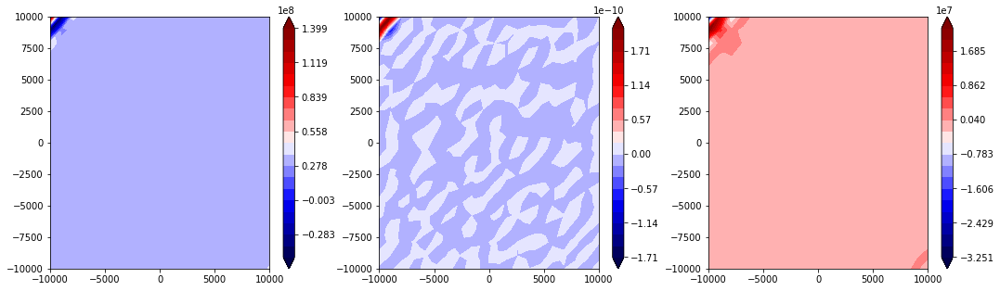

state


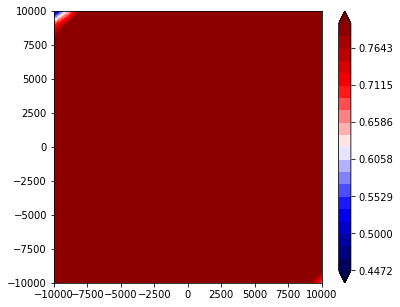

311 37.1545157801
312 37.1545157801
313 37.1545157803
314 37.1545157806
315 37.1545157809
316 37.1545157811
317 37.1545157816
318 37.1545157817
319 37.154515782
320 37.1545157824
V


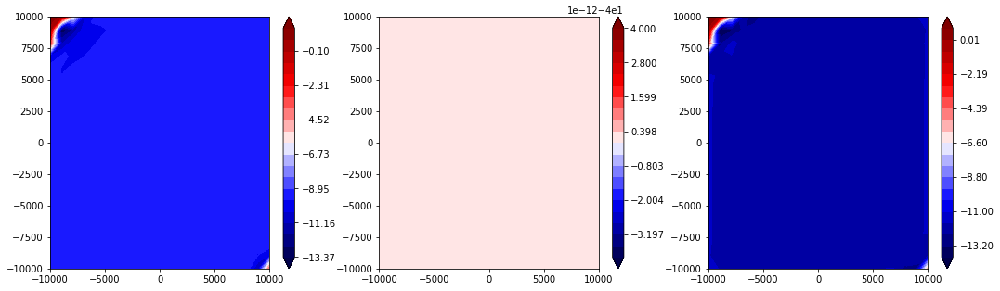

traction


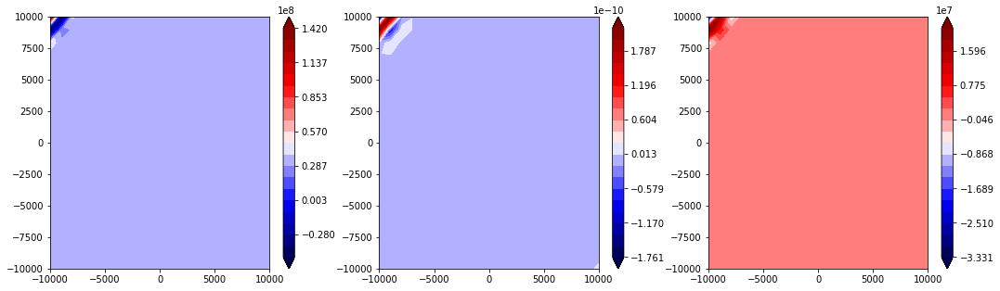

state


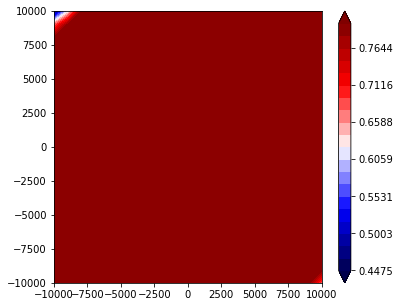

321 37.1545157825
322 37.1545157827
323 37.1545157832
324 37.1545157833
325 37.1545157836
326 37.154515784
327 37.1545157841
328 37.1545157843
329 37.1545157848
330 37.1545157849
V


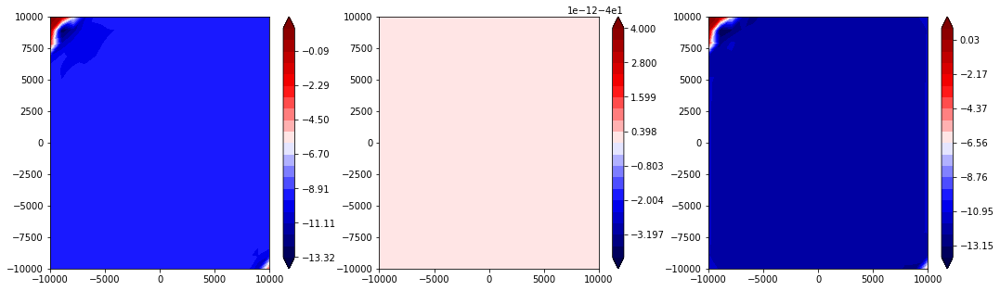

traction


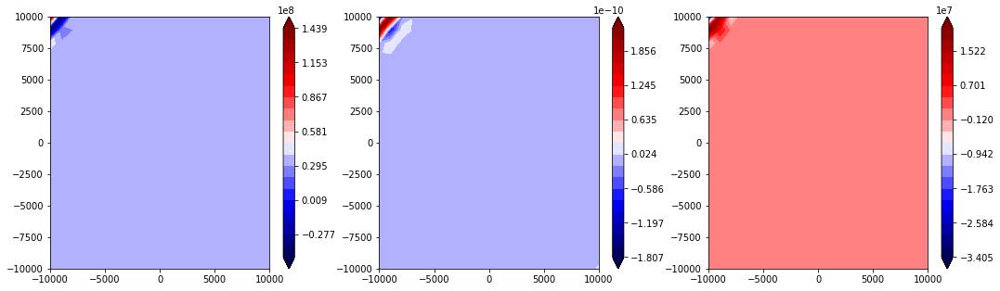

state


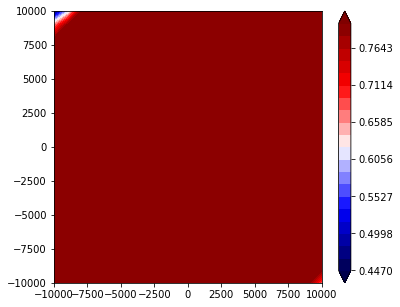

331 37.1545157851
332 37.1545157856
333 37.1545157857
334 37.1545157858
335 37.1545157863
336 37.1545157864
337 37.1545157866
338 37.154515787
339 37.1545157871
340 37.1545157874
V


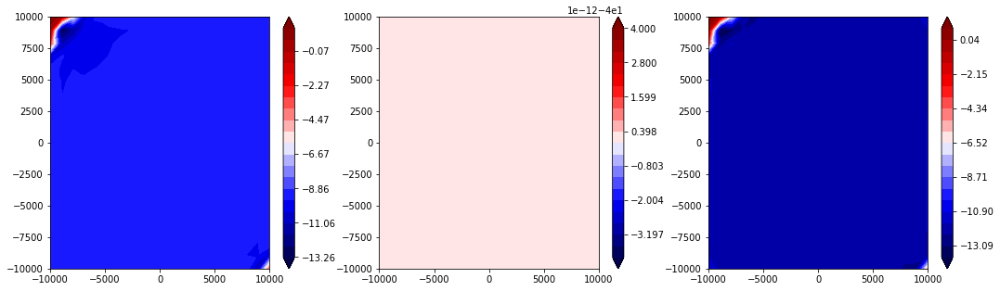

traction


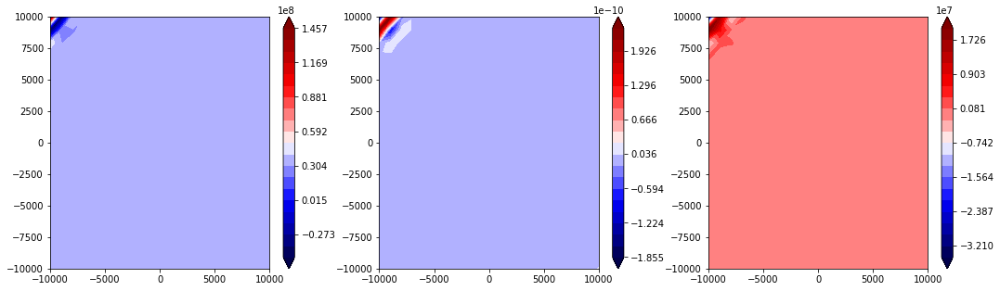

state


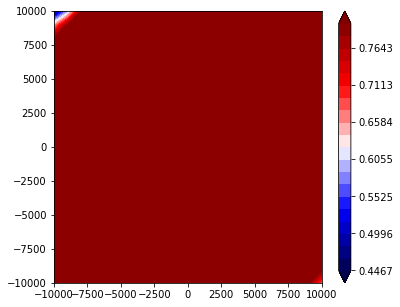

341 37.1545157878
342 37.1545157879
343 37.1545157881
344 37.1545157885
345 37.1545157886
346 37.1545157888
347 37.1545157892
348 37.1545157893
349 37.1545157896
350 37.15451579
V


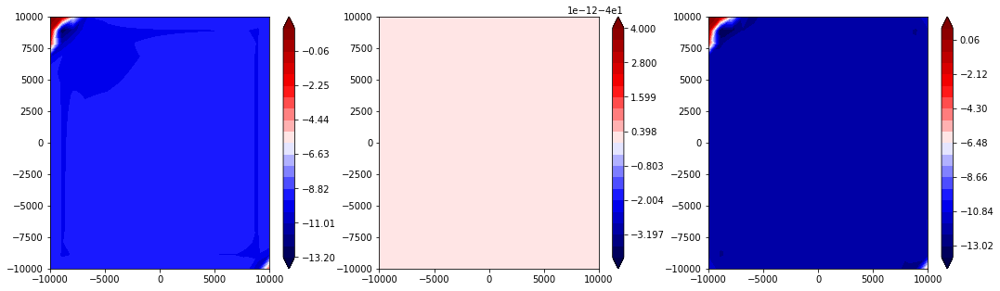

traction


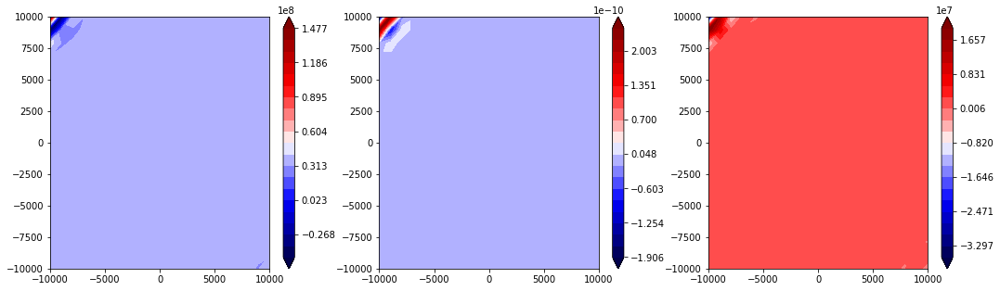

state


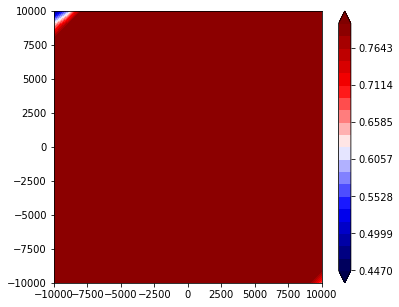

351 37.1545157901
352 37.1545157903
353 37.1545157907
354 37.1545157908
355 37.1545157911
356 37.1545157915
357 37.1545157916
358 37.1545157918
359 37.1545157922
360 37.1545157923
V


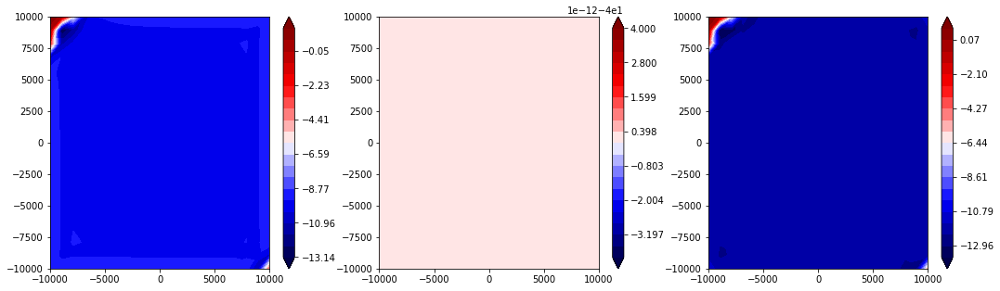

traction


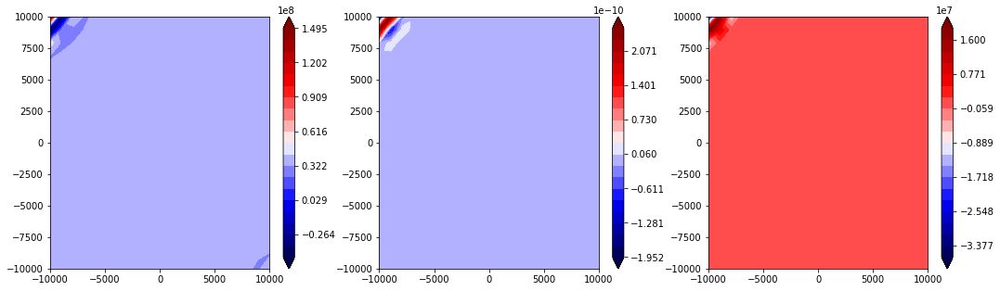

state


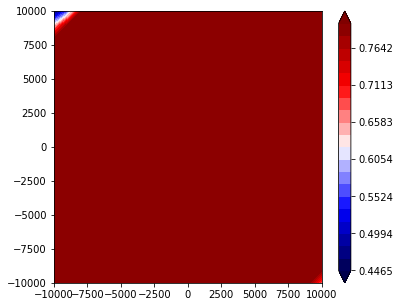

361 37.1545157926
362 37.154515793
363 37.1545157931
364 37.1545157932
365 37.1545157935
366 37.1545157938
367 37.1545157942
368 37.1545157943
369 37.1545157945
370 37.1545157949
V


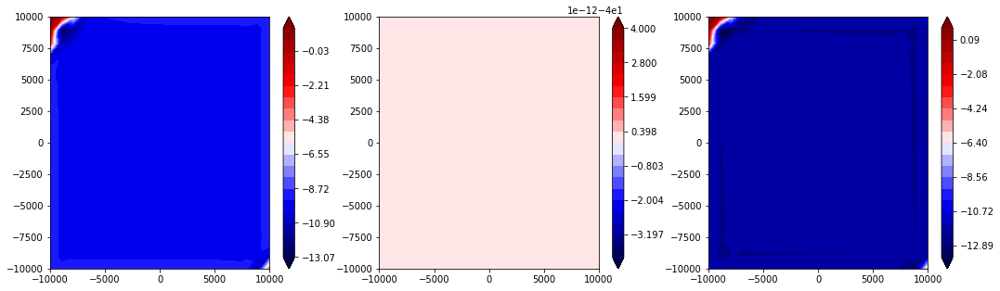

traction


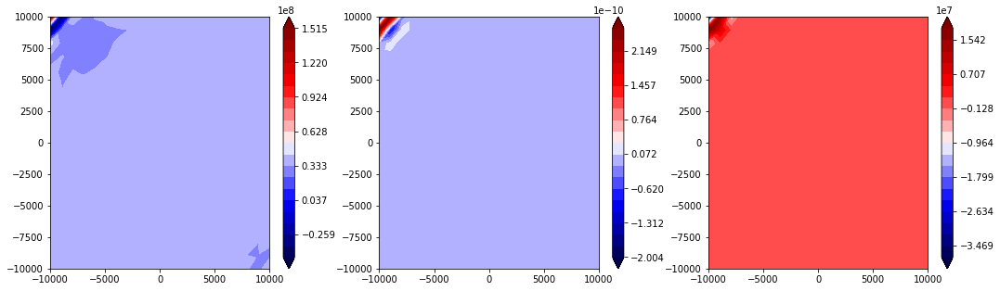

state


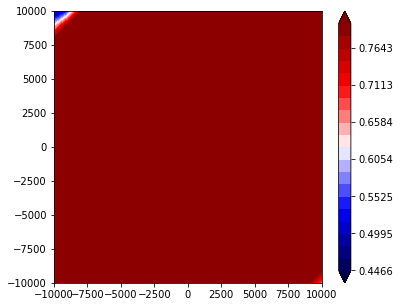

371 37.154515795
372 37.1545157953
373 37.1545157957
374 37.1545157958
375 37.1545157959
376 37.1545157961
377 37.1545157965
378 37.1545157966
379 37.1545157967
380 37.154515797
V


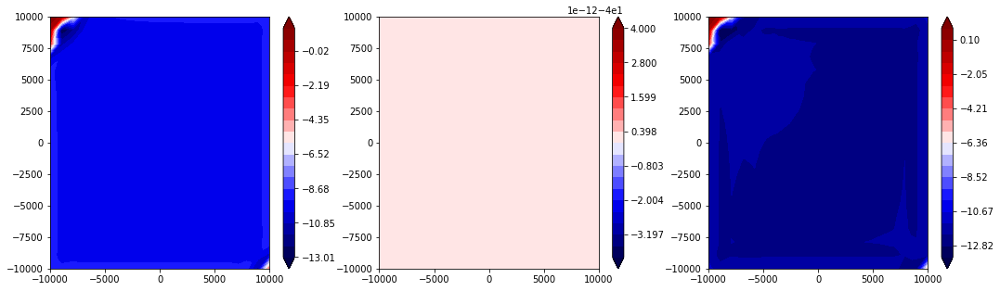

traction


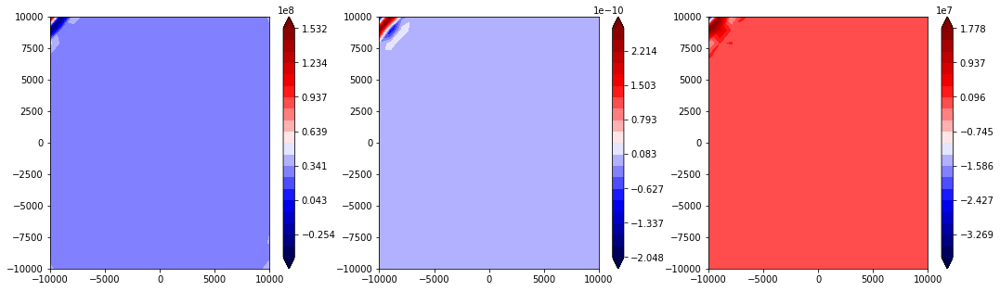

state


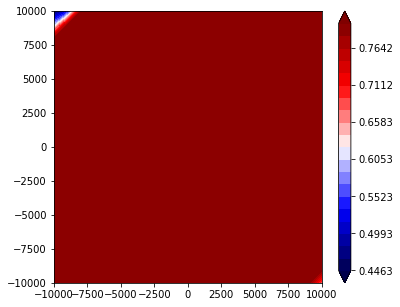

381 37.1545157972
382 37.1545157976
383 37.1545157977
384 37.154515798
385 37.1545157984
386 37.1545157984
387 37.1545157986
388 37.1545157989
389 37.154515799
390 37.1545157992
V


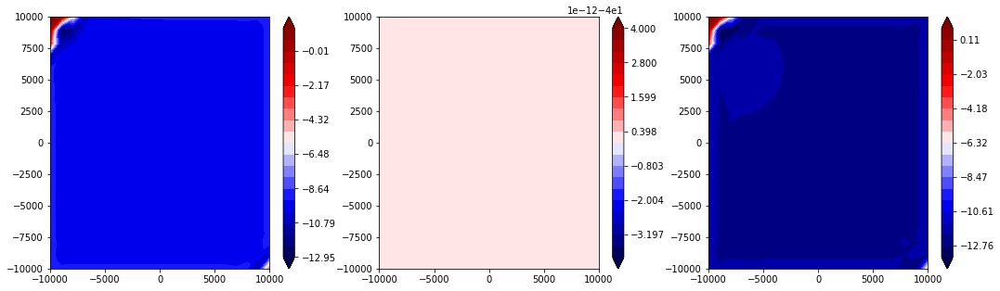

traction


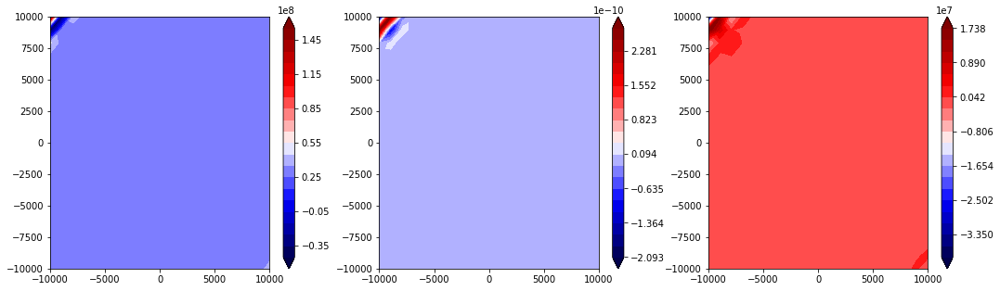

state


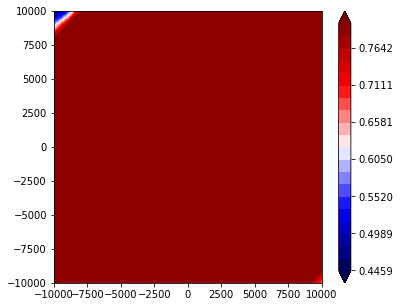

391 37.1545157996
392 37.1545157997
393 37.1545158
394 37.1545158003
395 37.1545158004
396 37.1545158006
397 37.154515801
398 37.1545158011
399 37.1545158013
400 37.1545158017
V


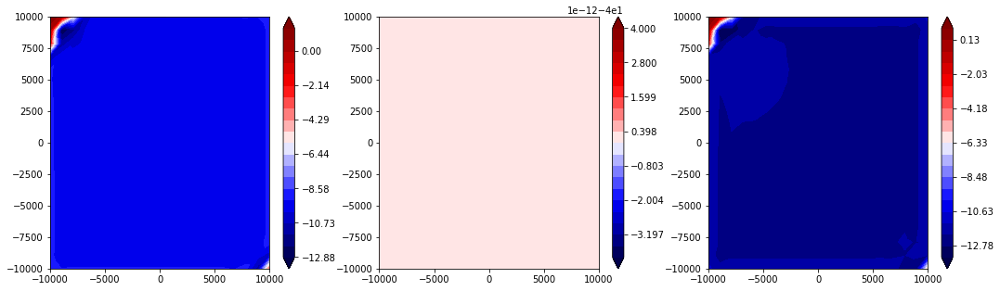

traction


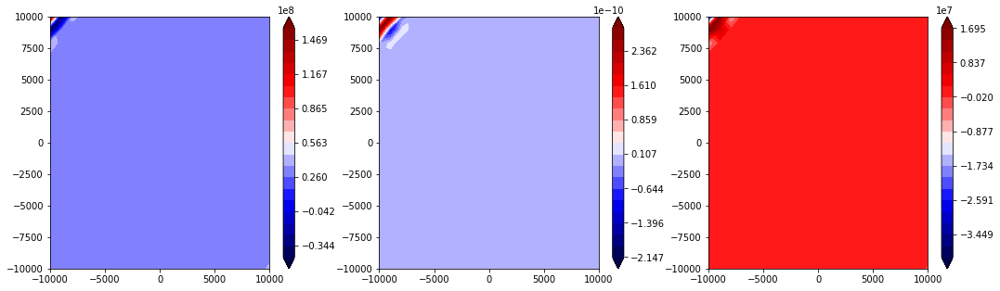

state


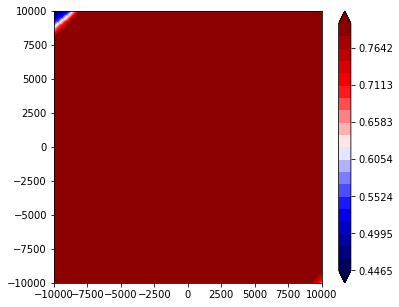

401 37.1545158018
402 37.154515802
403 37.1545158024
404 37.1545158025
405 37.1545158027
406 37.1545158031
407 37.1545158032
408 37.1545158033
409 37.1545158037
410 37.1545158038
V


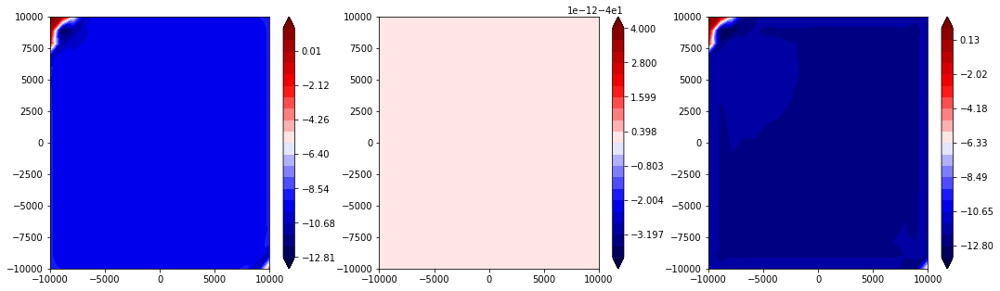

traction


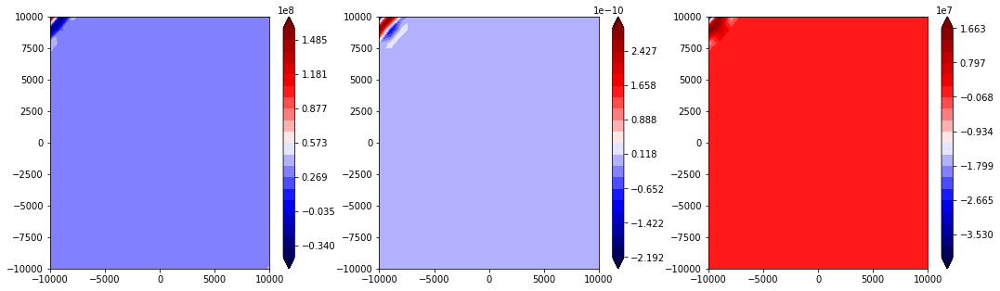

state


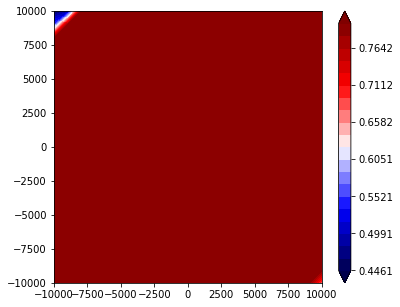

411 37.1545158039
412 37.1545158042
413 37.1545158043
414 37.1545158047
415 37.1545158047
416 37.1545158049
417 37.1545158053
418 37.1545158054
419 37.1545158057
420 37.154515806
V


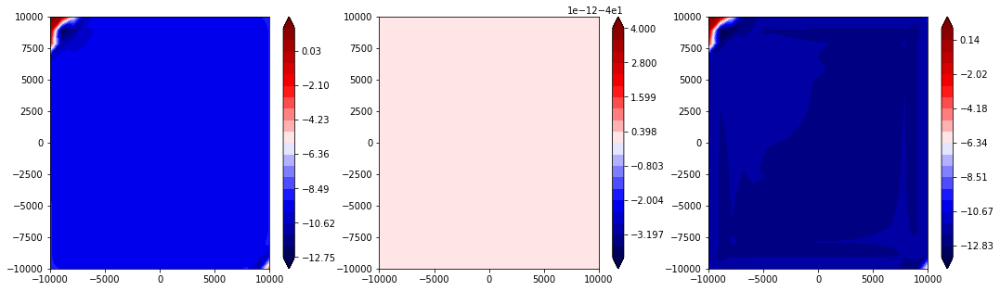

traction


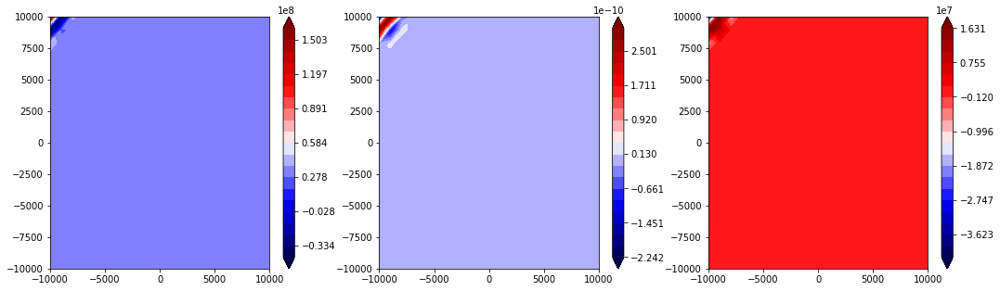

state


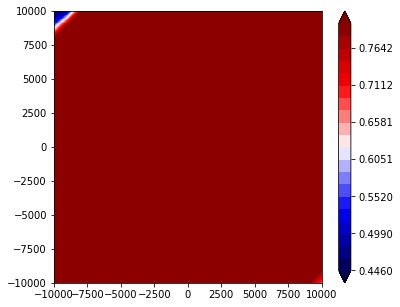

421 37.1545158061
422 37.1545158063
423 37.1545158067
424 37.1545158068
425 37.154515807
426 37.1545158074
427 37.1545158075
428 37.1545158075
429 37.1545158077
430 37.1545158081
V


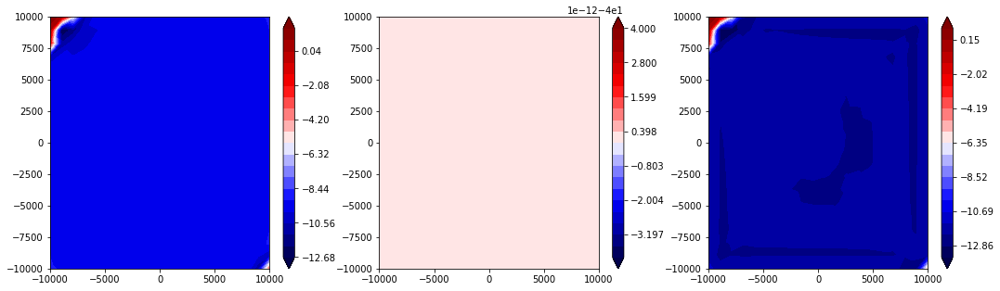

traction


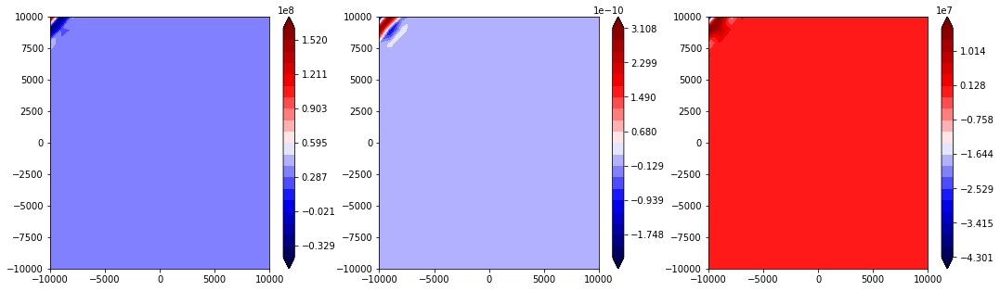

state


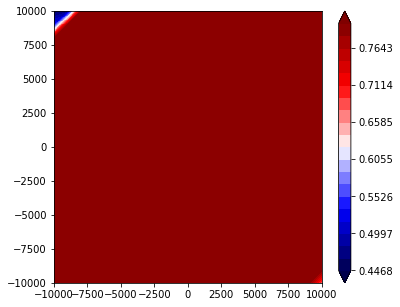

431 37.1545158081
432 37.1545158082
433 37.1545158085
434 37.1545158088
435 37.1545158089
436 37.1545158093
437 37.1545158094
438 37.1545158095
439 37.1545158097
440 37.15451581
V


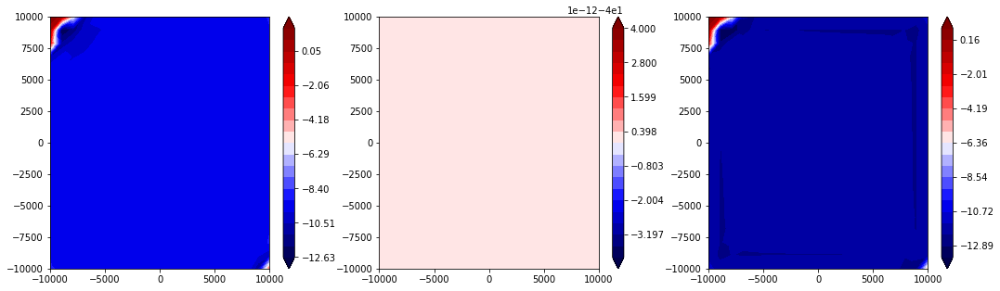

traction


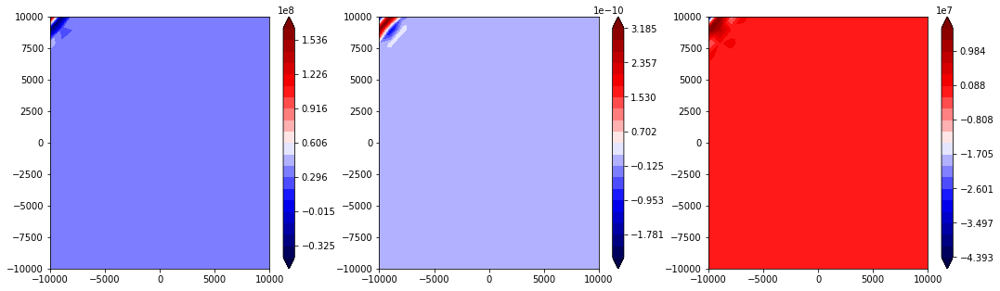

state


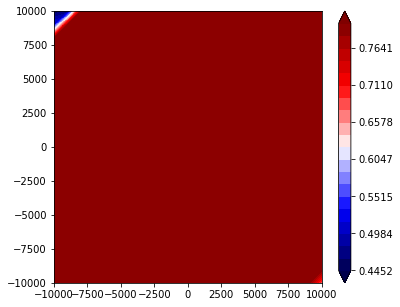

441 37.1545158103
442 37.1545158104
443 37.1545158106
444 37.154515811
445 37.154515811
446 37.1545158113
447 37.1545158116
448 37.1545158117
449 37.1545158119
450 37.1545158122
V


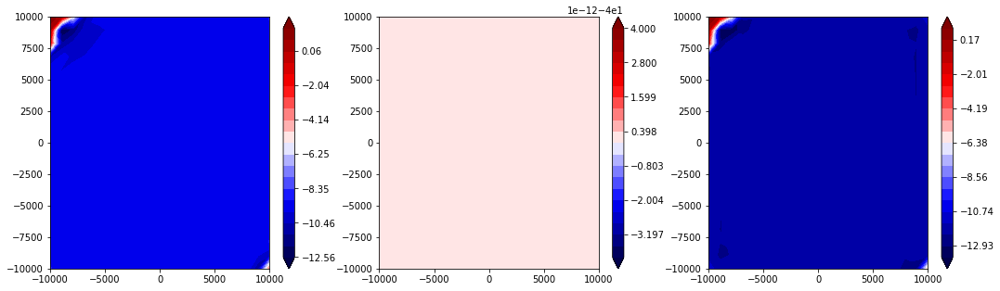

traction


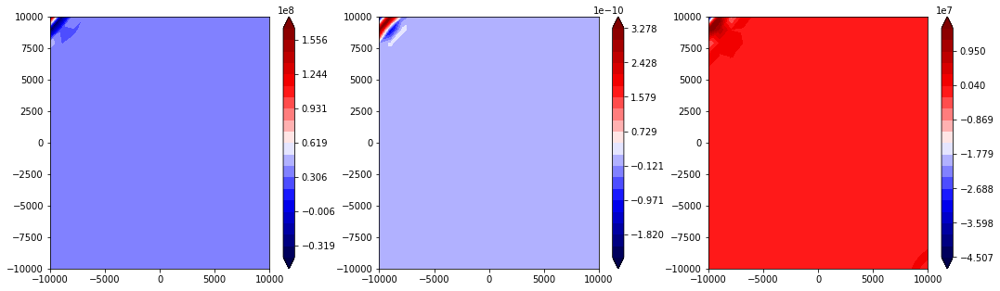

state


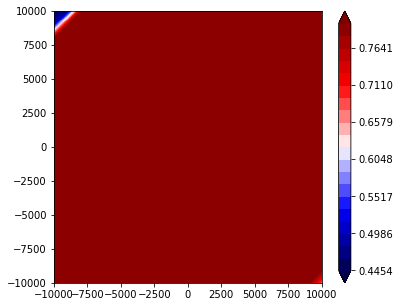

451 37.1545158123
452 37.1545158126
453 37.1545158129
454 37.154515813
455 37.1545158132
456 37.1545158135
457 37.1545158136
458 37.1545158138
459 37.1545158142
460 37.1545158143
V


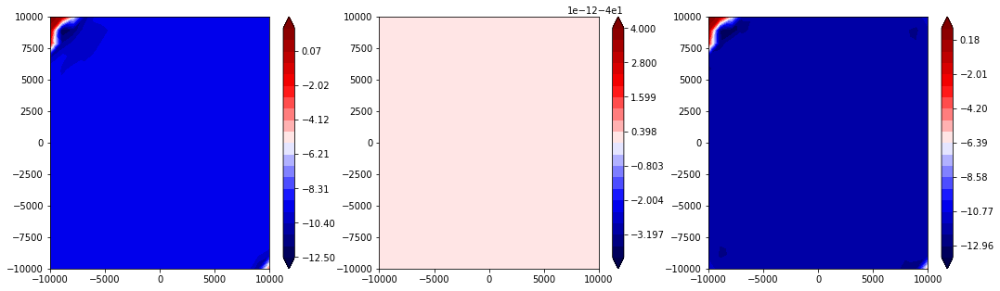

traction


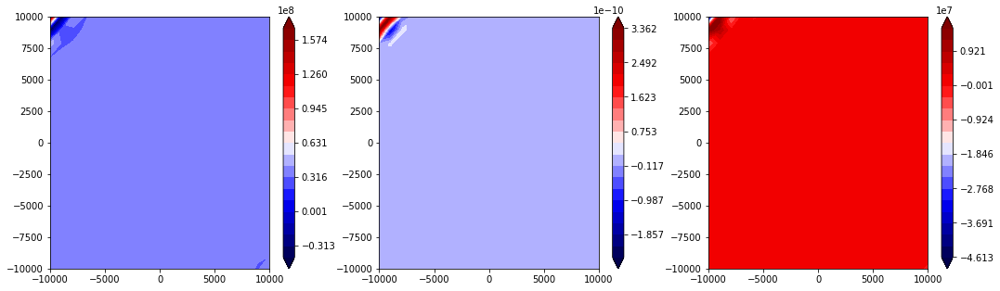

state


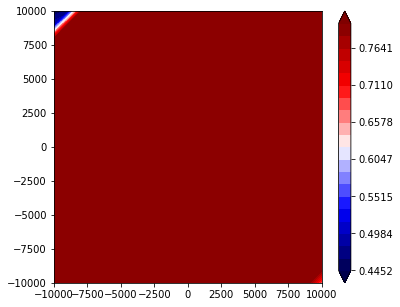

461 37.1545158144
462 37.1545158148
463 37.1545158148
464 37.1545158151
465 37.1545158154
466 37.1545158155
467 37.1545158157
468 37.154515816
469 37.1545158161
470 37.1545158163
V


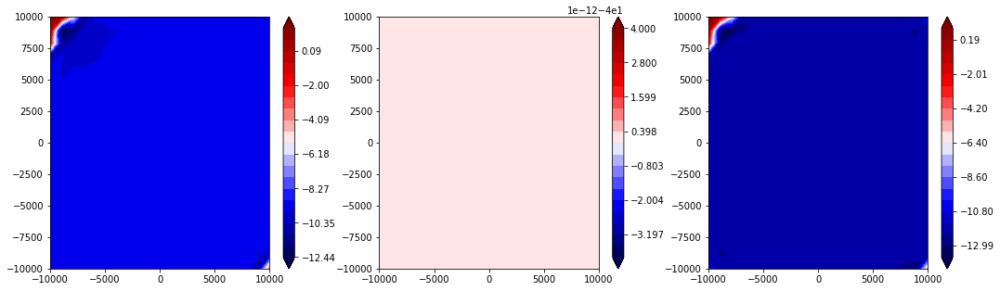

traction


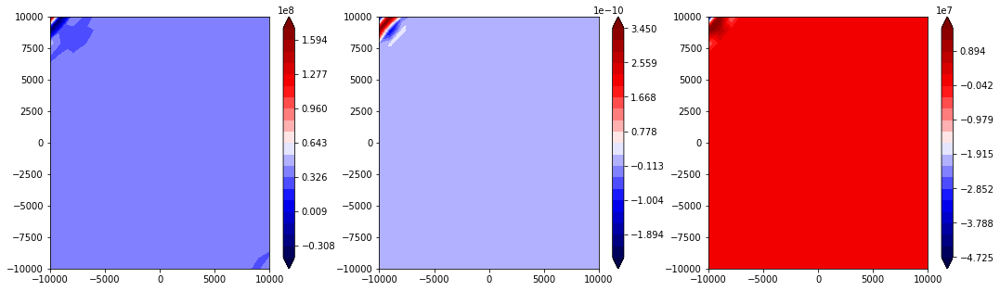

state


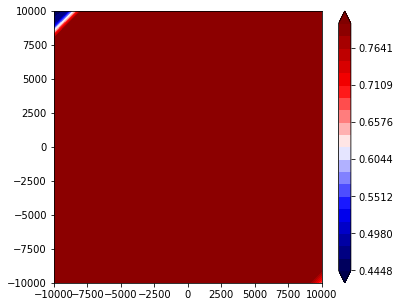

471 37.1545158167
472 37.1545158168
473 37.1545158169
474 37.1545158173
475 37.1545158173
476 37.1545158176
477 37.1545158179
478 37.154515818
479 37.1545158181
480 37.1545158182
V


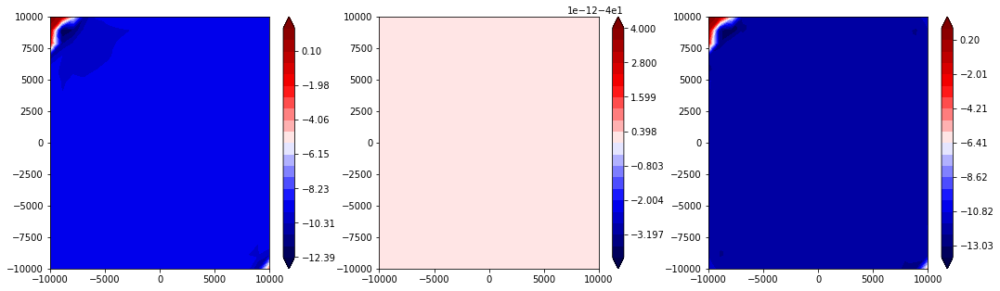

traction


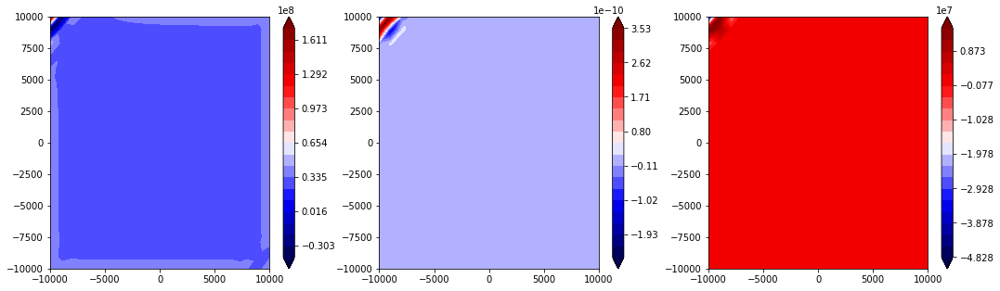

state


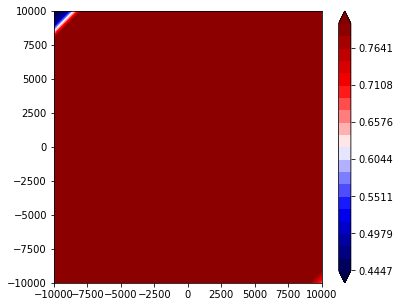

481 37.1545158185
482 37.1545158186
483 37.1545158186
484 37.1545158188
485 37.1545158191
486 37.1545158191
487 37.1545158193
488 37.1545158197
489 37.1545158197
490 37.15451582
V


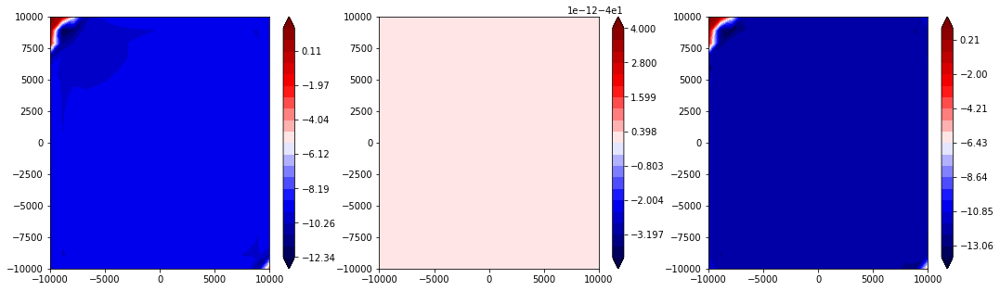

traction


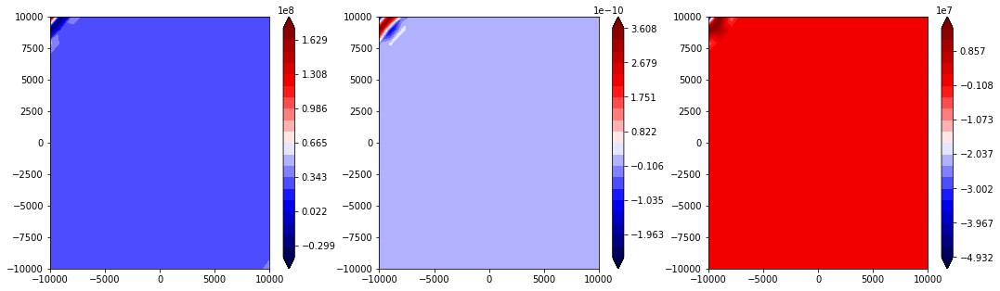

state


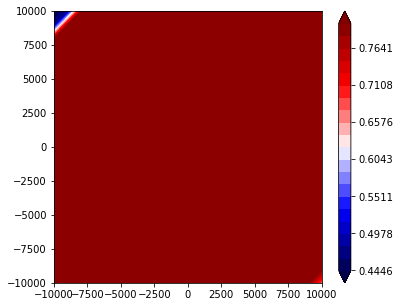

491 37.1545158203
492 37.1545158203
493 37.1545158205
494 37.1545158209
495 37.154515821
496 37.1545158212
497 37.1545158215
498 37.1545158216
499 37.1545158217
500 37.154515822
V


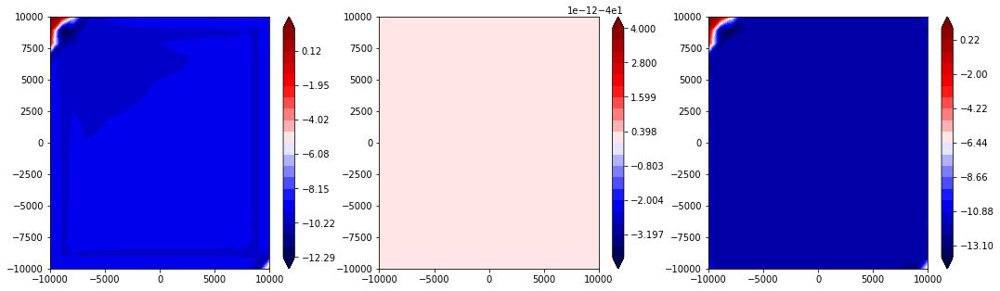

traction


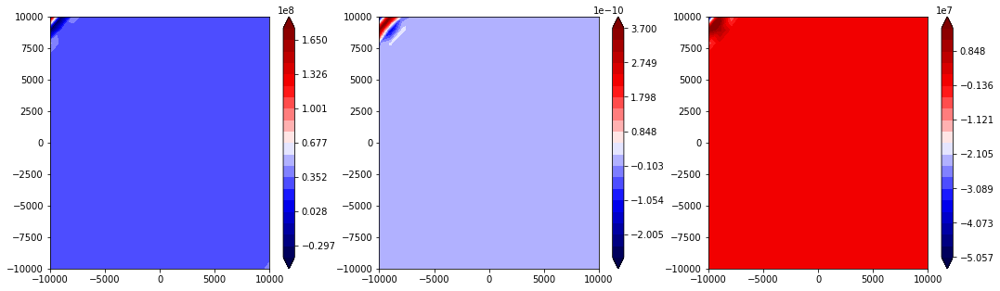

state


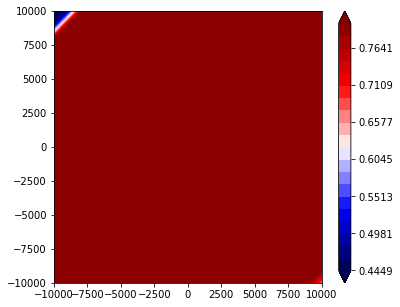

501 37.1545158221
502 37.1545158223
503 37.1545158226
504 37.1545158227
505 37.1545158229
506 37.1545158232
507 37.1545158233
508 37.1545158235
509 37.1545158238
510 37.1545158239
V


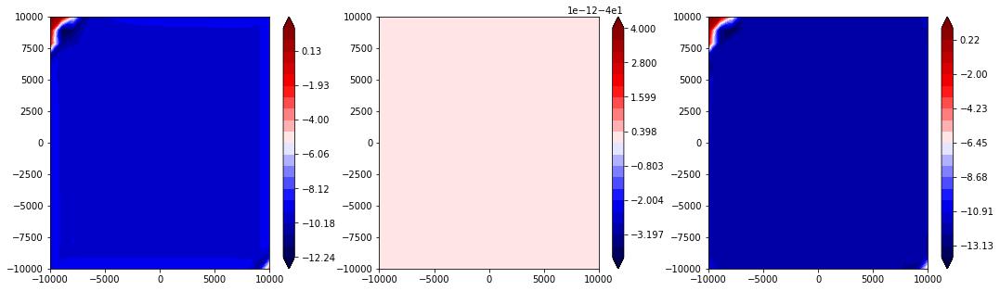

traction


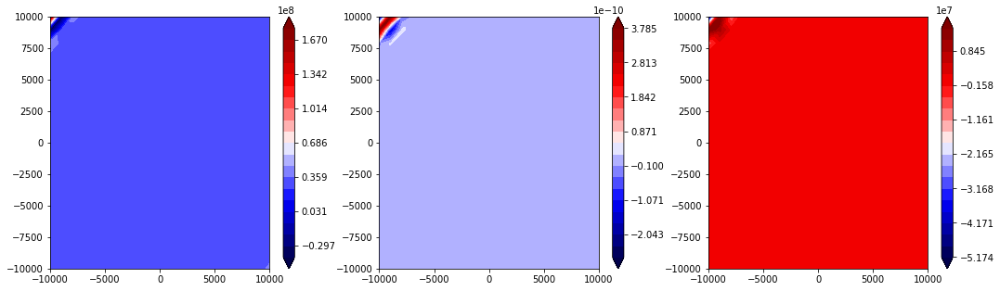

state


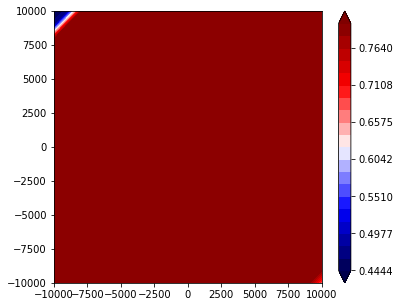

511 37.1545158241
512 37.1545158244
513 37.1545158245
514 37.1545158247
515 37.154515825
516 37.1545158251
517 37.1545158252
518 37.1545158253
519 37.1545158256
520 37.1545158256
V


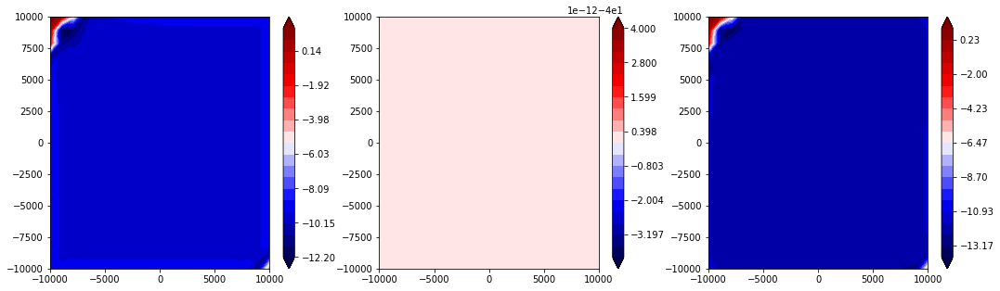

traction


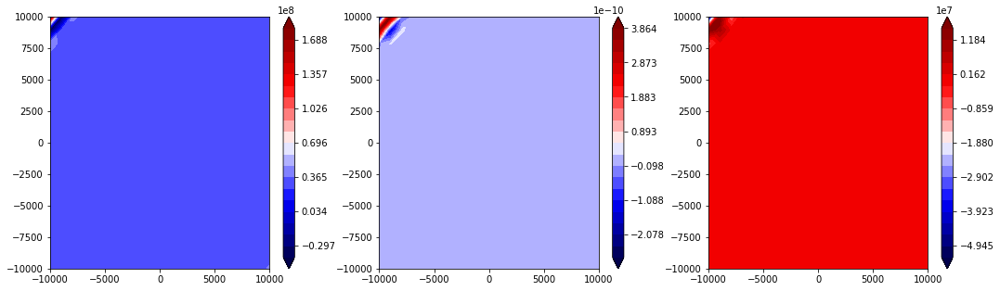

state


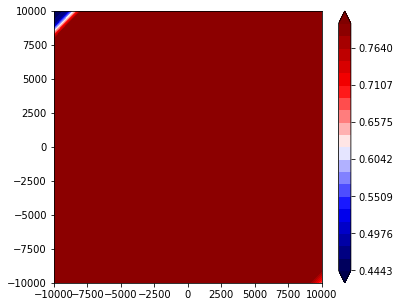

521 37.1545158258
522 37.1545158261
523 37.1545158262
524 37.1545158264
525 37.1545158267
526 37.1545158268
527 37.1545158269
528 37.1545158273
529 37.1545158273
530 37.1545158275
V


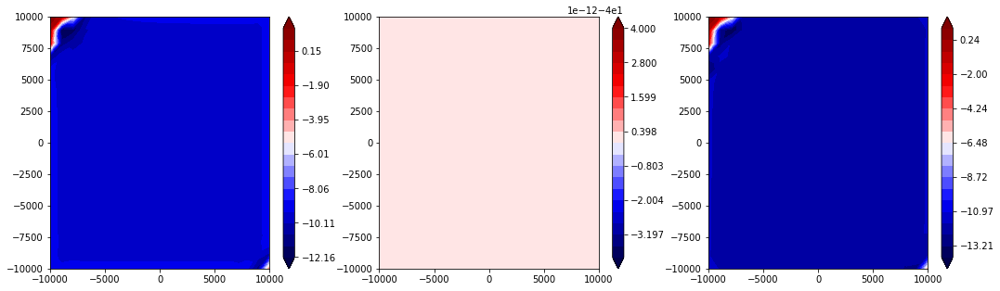

traction


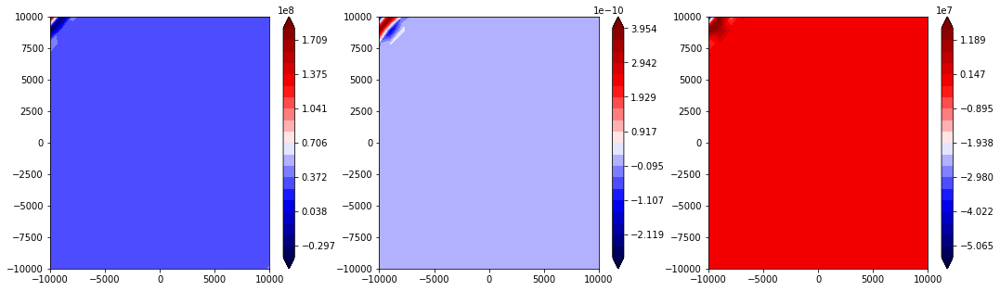

state


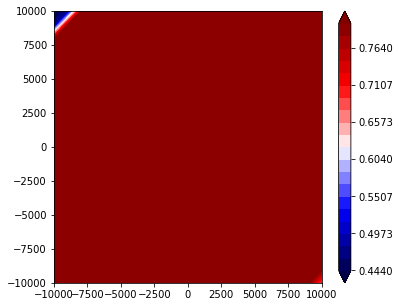

531 37.1545158278
532 37.1545158279
533 37.1545158281
534 37.1545158284
535 37.1545158285
536 37.1545158287
537 37.154515829
538 37.154515829
539 37.1545158292
540 37.1545158295
V


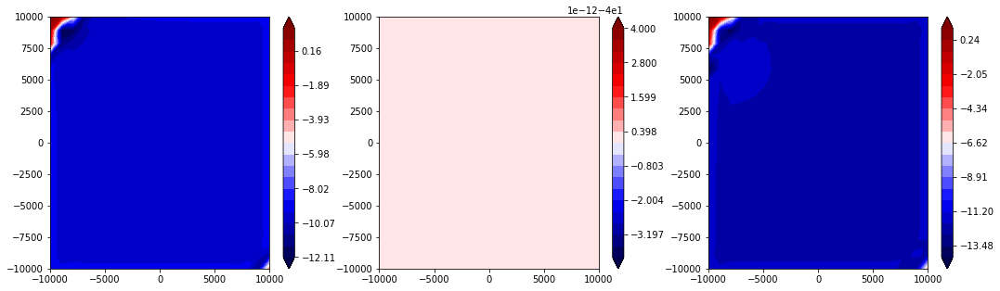

traction


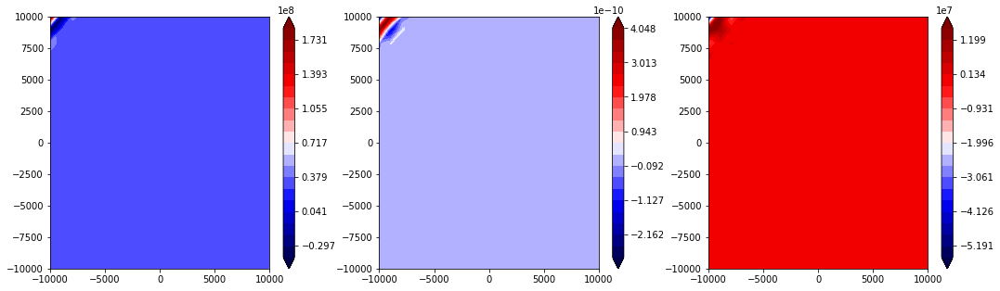

state


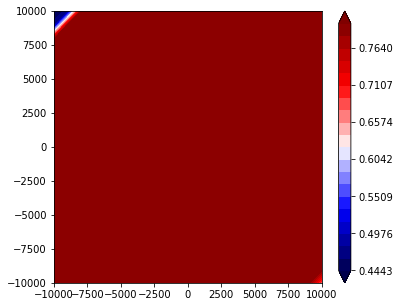

541 37.1545158296
542 37.1545158298
543 37.1545158301
544 37.1545158302
545 37.1545158303
546 37.1545158306
547 37.1545158306
548 37.1545158307
549 37.154515831
550 37.1545158312
V


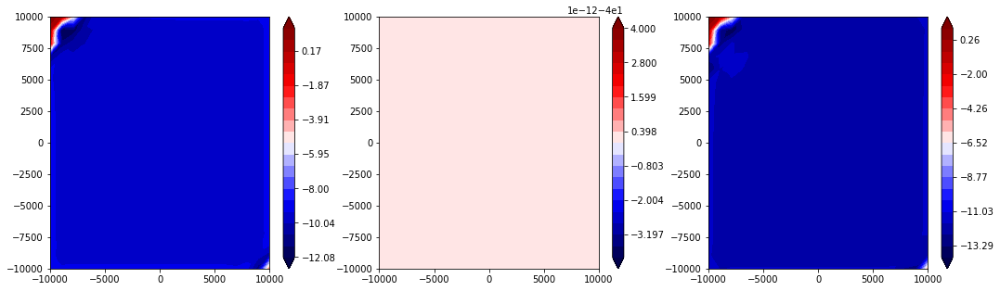

traction


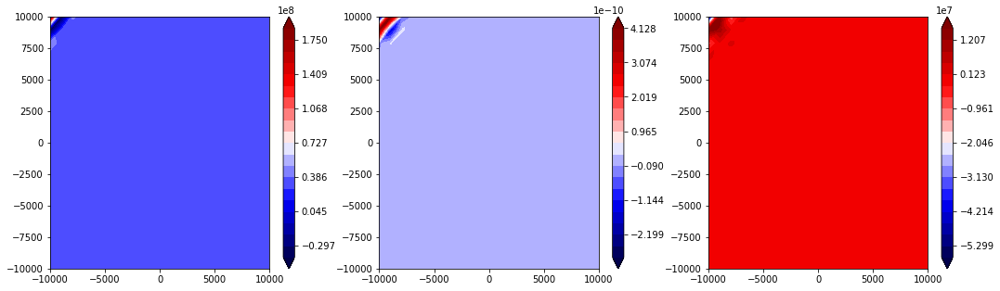

state


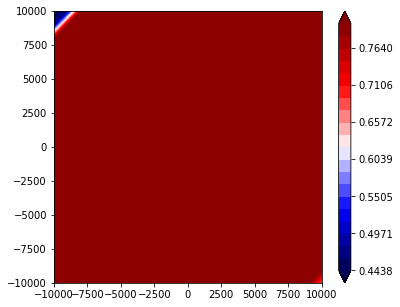

551 37.1545158314
552 37.1545158316
553 37.1545158319
554 37.1545158319
555 37.1545158321
556 37.1545158324
557 37.1545158324
558 37.1545158325
559 37.1545158327
560 37.154515833
V


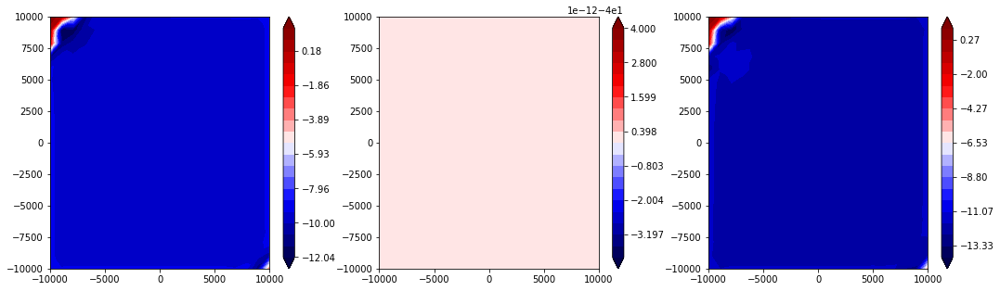

traction


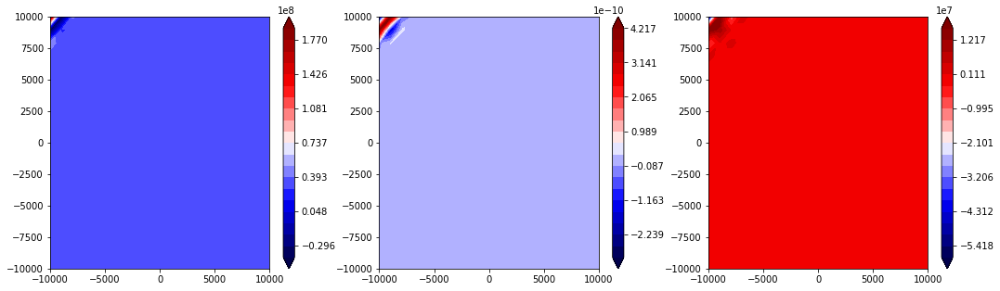

state


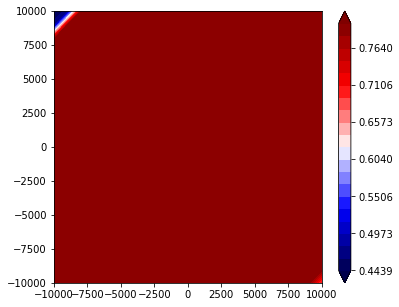

561 37.1545158331
562 37.1545158333
563 37.1545158334
564 37.1545158335
565 37.1545158339
566 37.1545158339
567 37.1545158341
568 37.1545158344
569 37.1545158345
570 37.1545158346
V


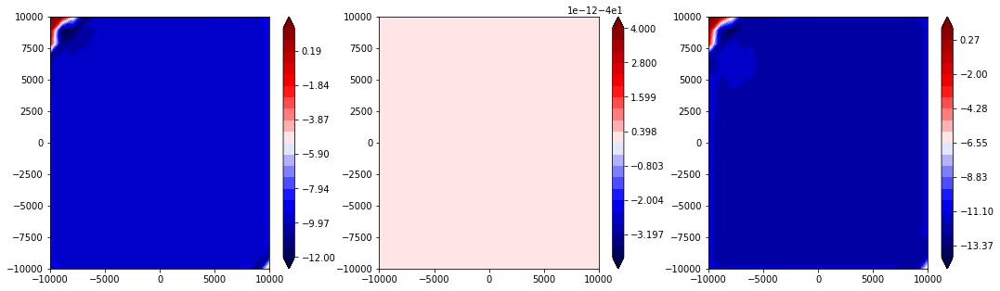

traction


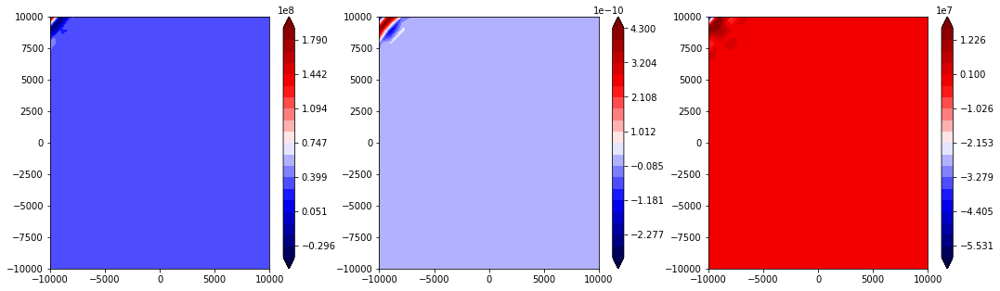

state


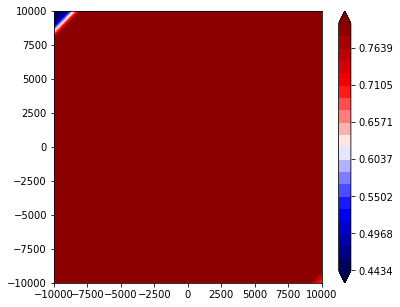

571 37.1545158349
572 37.154515835
573 37.1545158352
574 37.1545158355
575 37.1545158355
576 37.1545158357
577 37.154515836
578 37.154515836
579 37.1545158362
580 37.1545158365
V


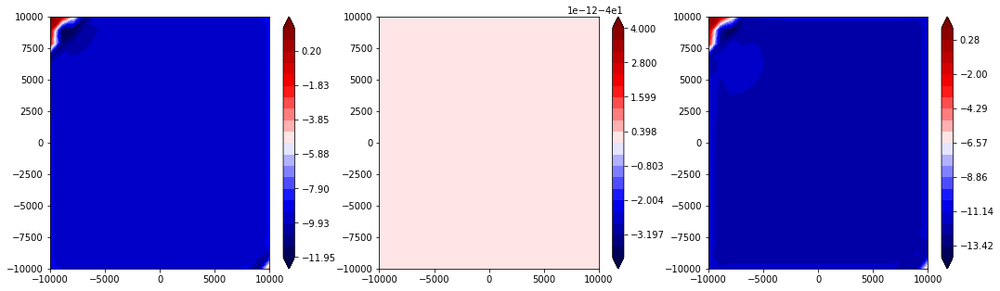

traction


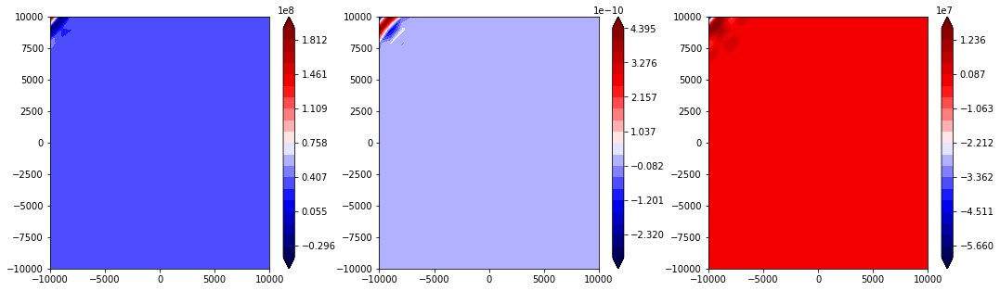

state


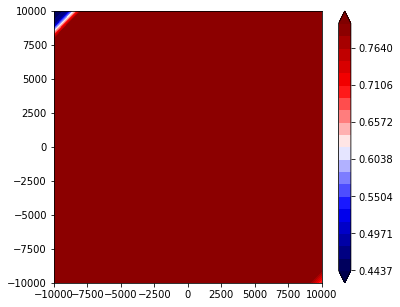

581 37.1545158366
582 37.1545158368
583 37.1545158371
584 37.1545158371
585 37.1545158372
586 37.1545158374
587 37.1545158377
588 37.1545158377
589 37.1545158378
590 37.1545158381
V


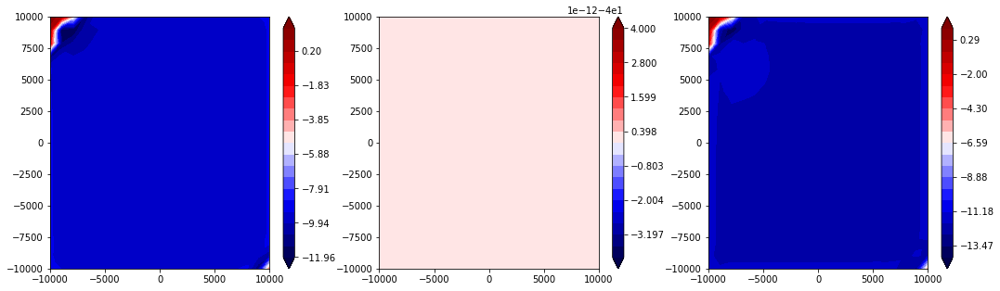

traction


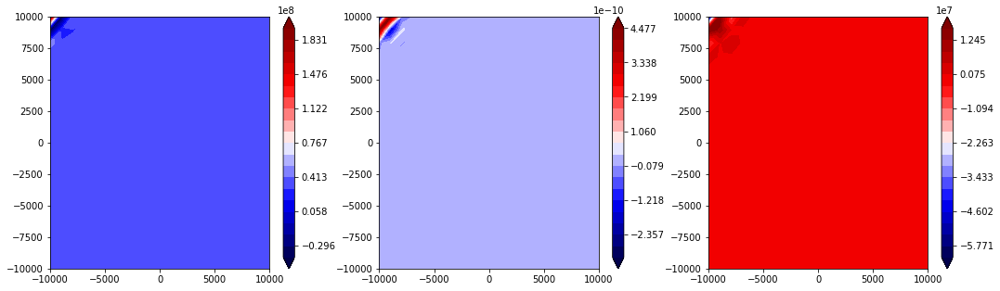

state


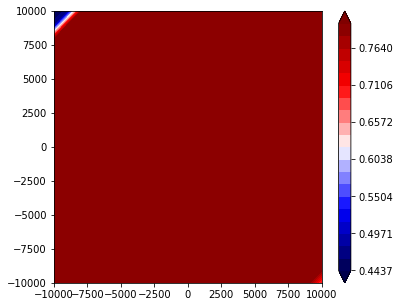

591 37.1545158381
592 37.1545158383
593 37.1545158386
594 37.1545158386
595 37.1545158388
596 37.1545158391
597 37.1545158391
598 37.1545158393
599 37.1545158396
600 37.1545158397
V


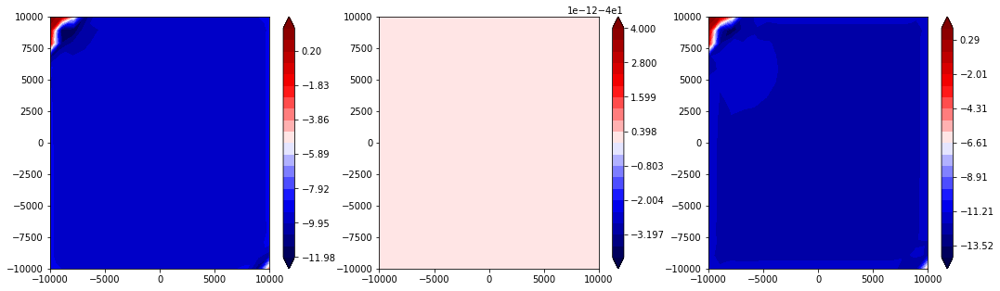

traction


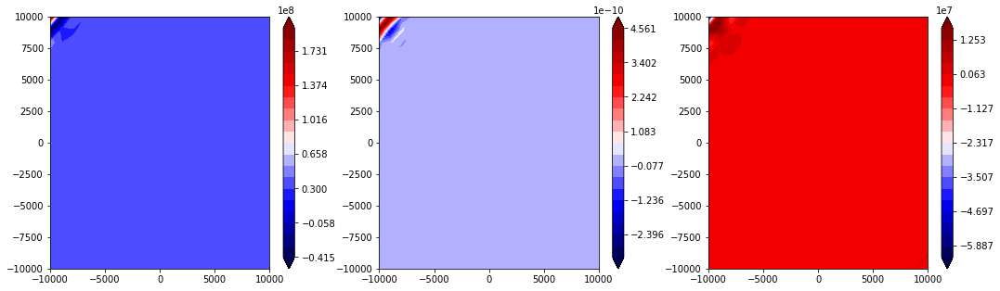

state


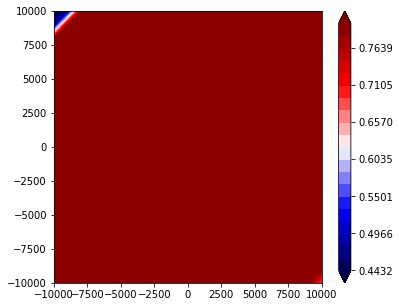

601 37.1545158398
602 37.1545158401
603 37.1545158402
604 37.1545158403
605 37.1545158406
606 37.1545158406
607 37.1545158408
608 37.1545158411
609 37.1545158411
610 37.1545158413
V


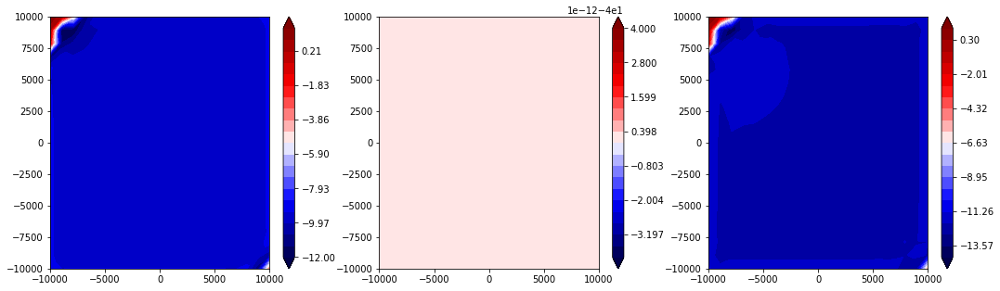

traction


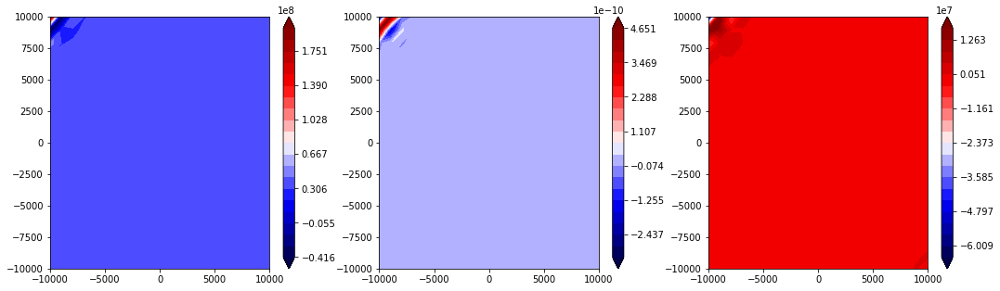

state


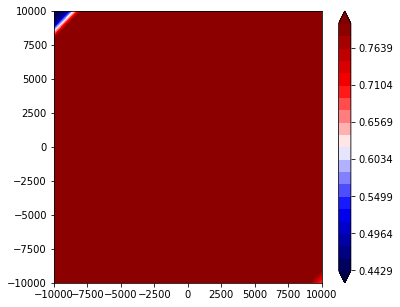

611 37.1545158416
612 37.1545158416
613 37.1545158418
614 37.1545158421
615 37.1545158422
616 37.1545158423
617 37.1545158426
618 37.1545158427
619 37.1545158428
620 37.1545158431
V


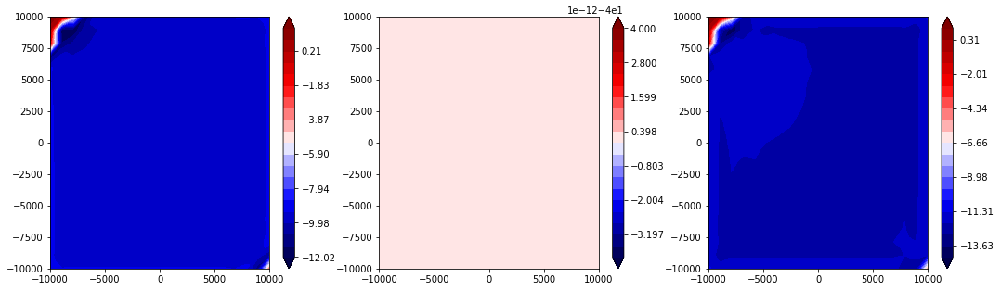

traction


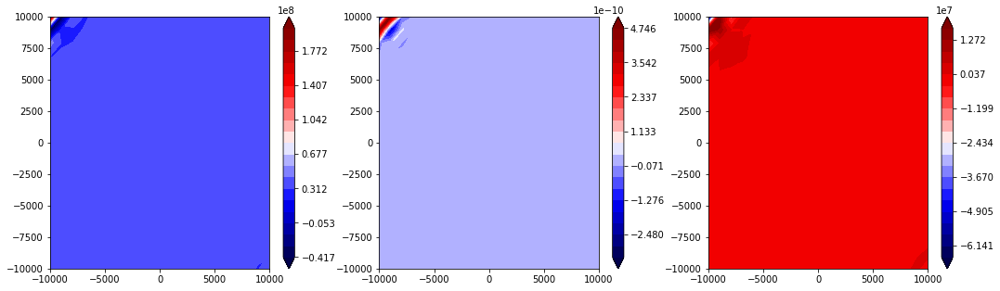

state


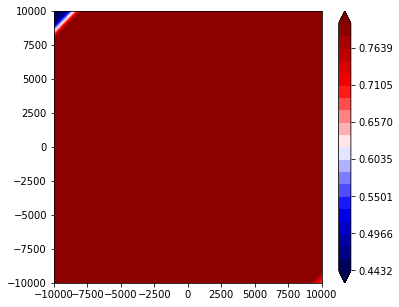

621 37.1545158432
622 37.1545158433
623 37.1545158436
624 37.1545158437
625 37.1545158438
626 37.154515844
627 37.1545158441
628 37.1545158444
629 37.1545158445
630 37.1545158446
V


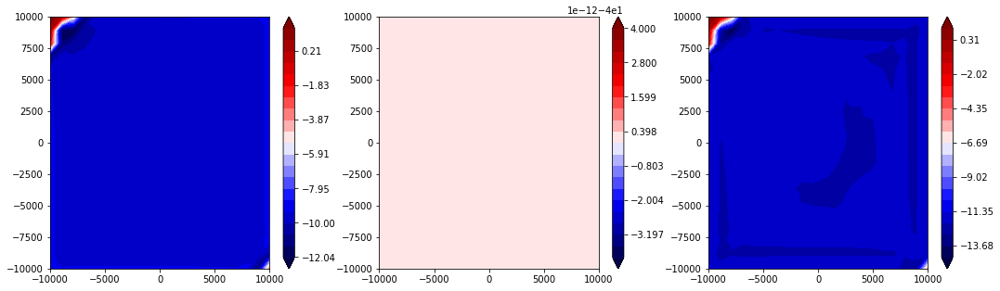

traction


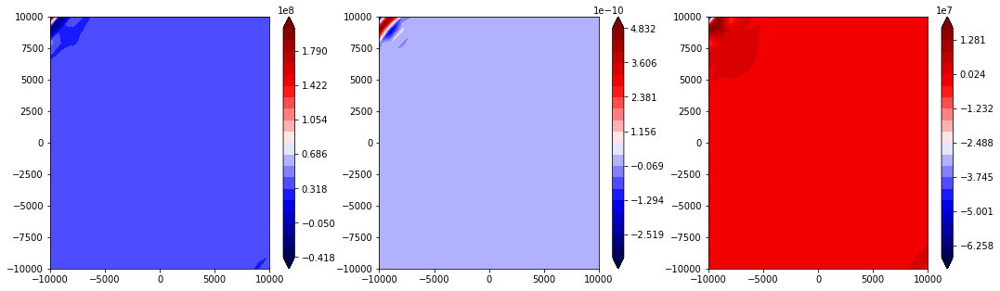

state


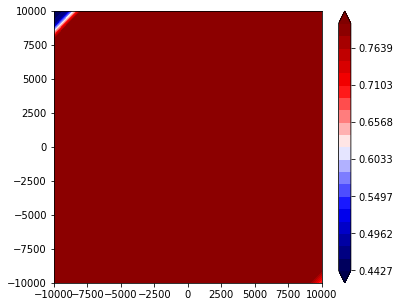

631 37.1545158449
632 37.1545158449
633 37.1545158451
634 37.1545158454
635 37.1545158454
636 37.1545158456
637 37.1545158459
638 37.1545158459
639 37.1545158461
640 37.1545158463
V


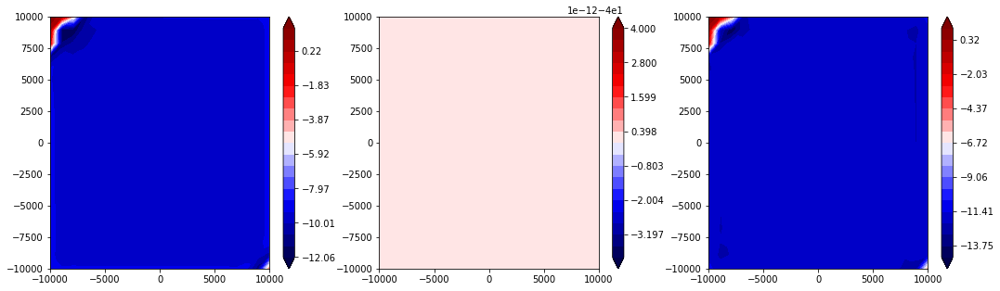

traction


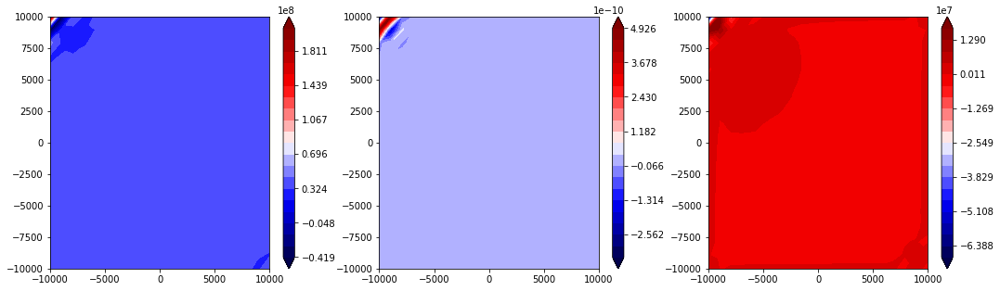

state


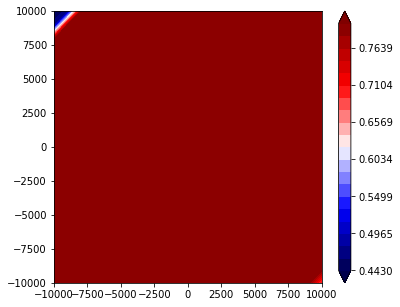

641 37.1545158464
642 37.1545158466
643 37.1545158468
644 37.1545158469
645 37.154515847
646 37.1545158473
647 37.1545158473
648 37.1545158475
649 37.1545158478
650 37.1545158478
V


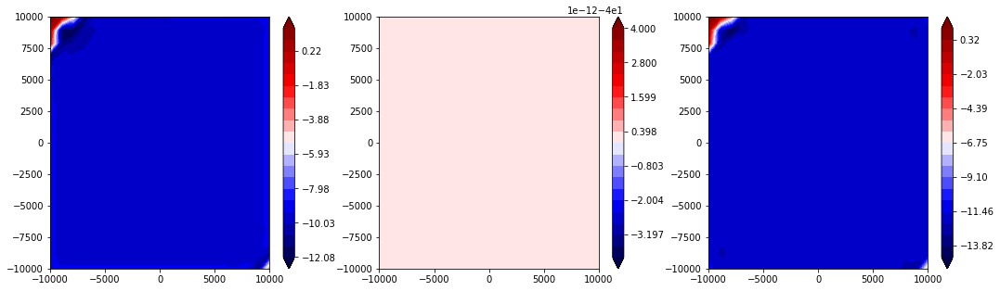

traction


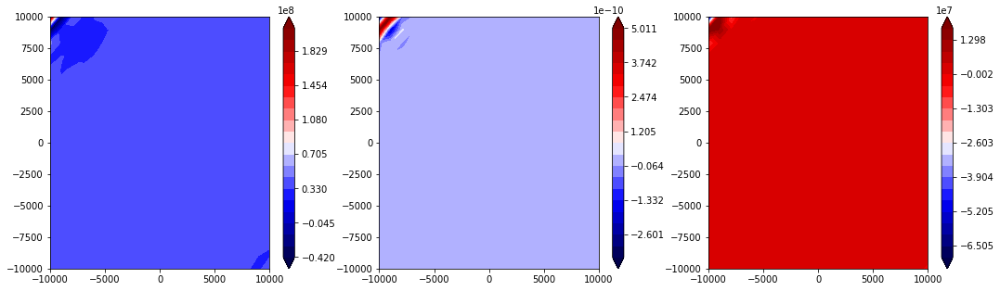

state


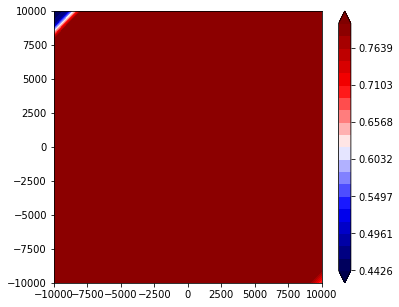

651 37.154515848
652 37.1545158482
653 37.1545158483
654 37.1545158485
655 37.1545158487
656 37.1545158488
657 37.1545158489
658 37.1545158492
659 37.1545158492
660 37.1545158494
V


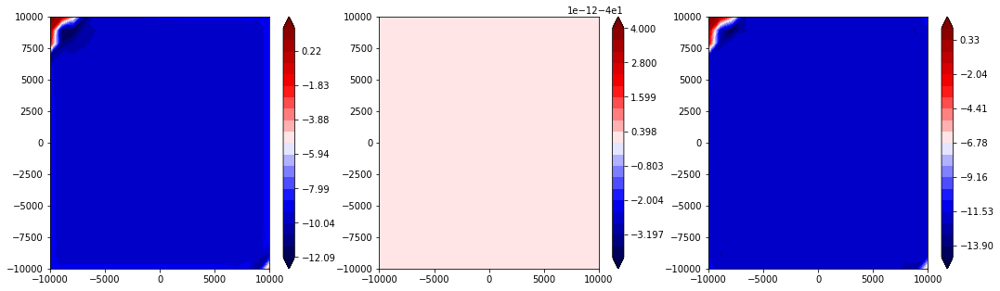

traction


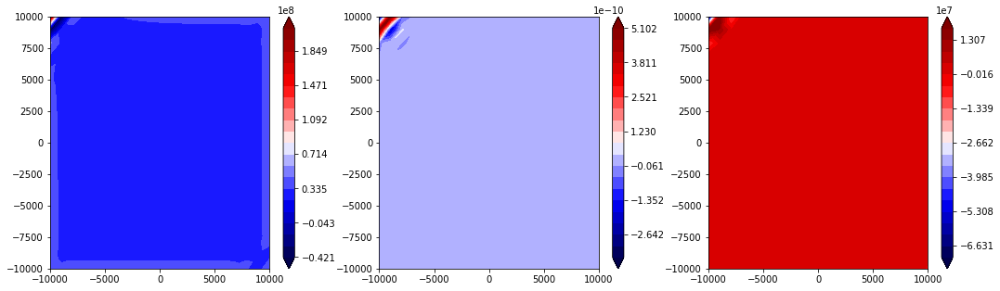

state


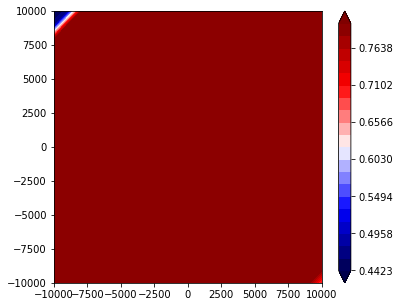

661 37.1545158497
662 37.1545158497
663 37.1545158499
664 37.1545158501
665 37.1545158502
666 37.1545158504
667 37.1545158506
668 37.1545158507
669 37.1545158508
670 37.154515851
V


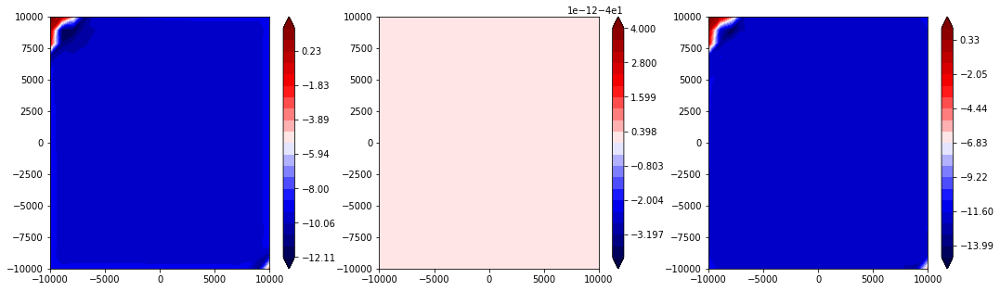

traction


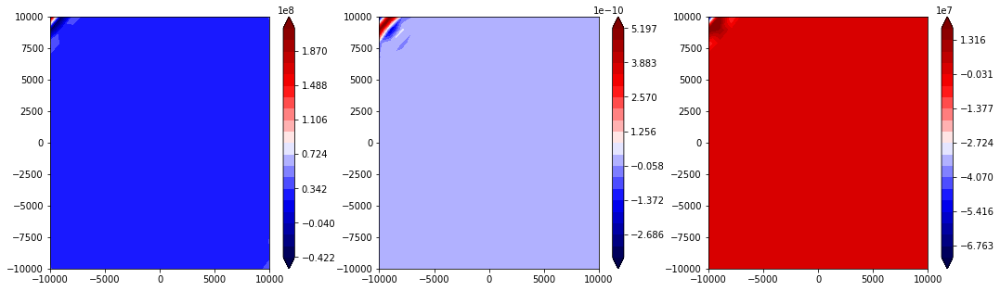

state


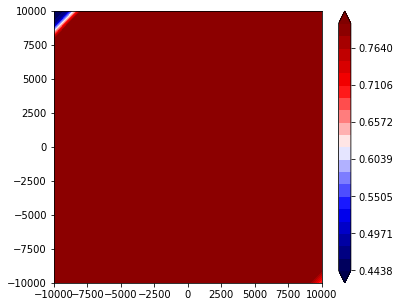

671 37.1545158511
672 37.1545158511
673 37.1545158513
674 37.1545158515
675 37.1545158516
676 37.1545158517
677 37.154515852
678 37.1545158521
679 37.1545158522
680 37.1545158525
V


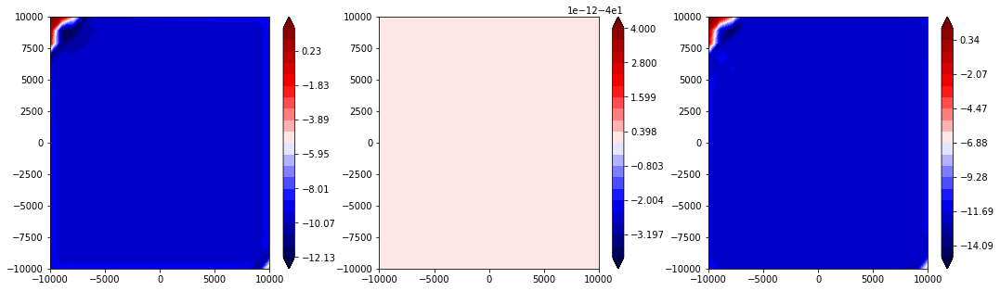

traction


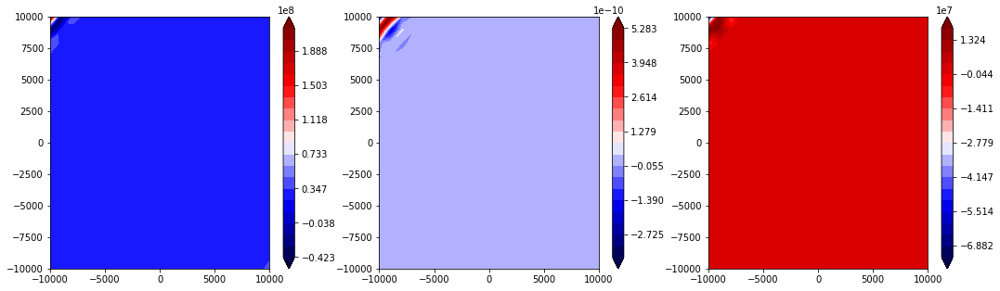

state


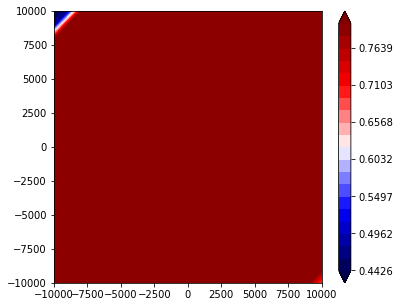

681 37.1545158525
682 37.1545158526
683 37.1545158529
684 37.154515853
685 37.1545158531
686 37.1545158534
687 37.1545158534
688 37.1545158536
689 37.1545158538
690 37.1545158539
V


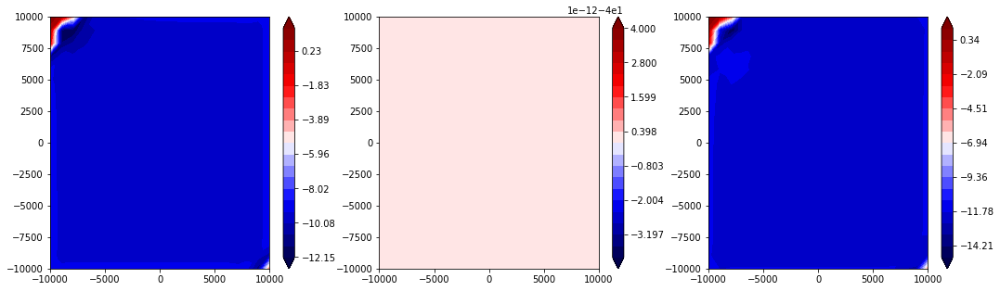

traction


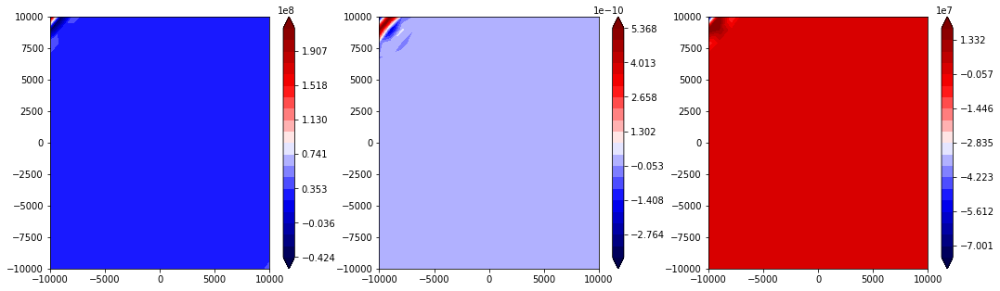

state


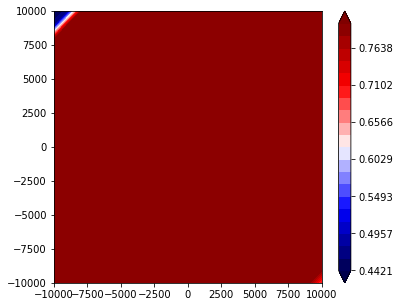

691 37.154515854
692 37.1545158543
693 37.1545158543
694 37.1545158545
695 37.1545158547
696 37.1545158548
697 37.1545158549
698 37.1545158552
699 37.1545158552
700 37.1545158553
V


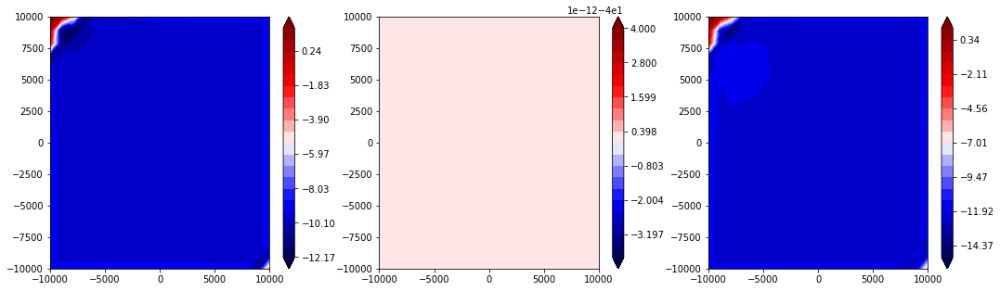

traction


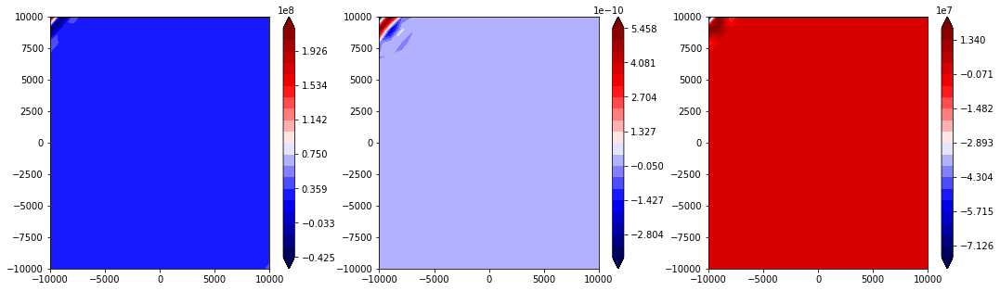

state


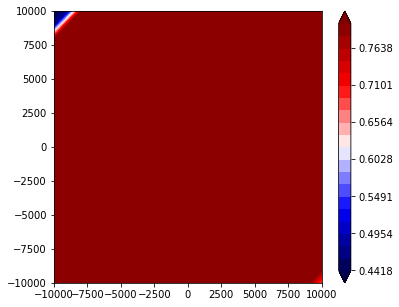

701 37.1545158556
702 37.1545158556
703 37.1545158558
704 37.154515856
705 37.1545158561
706 37.1545158562
707 37.1545158565
708 37.1545158565
709 37.1545158567
710 37.1545158569
V


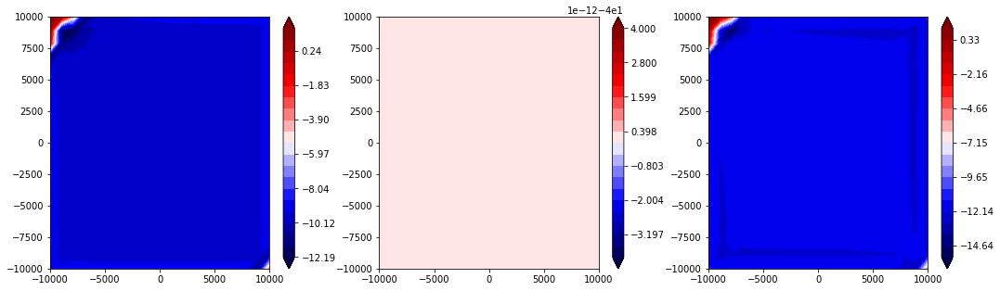

traction


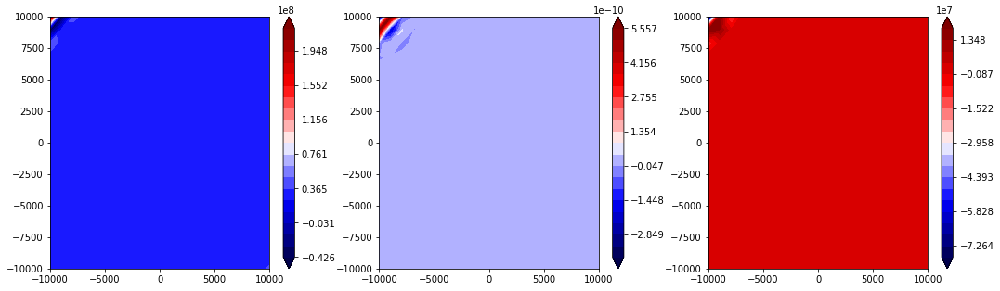

state


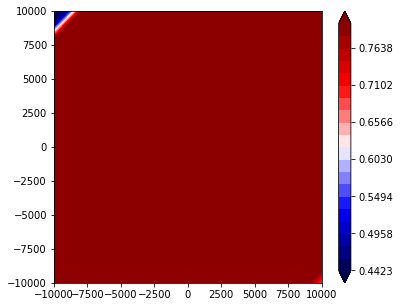

711 37.154515857
712 37.1545158571
713 37.1545158574
714 37.1545158574
715 37.1545158576
716 37.1545158578
717 37.1545158579
718 37.154515858
719 37.1545158581
720 37.1545158583
V


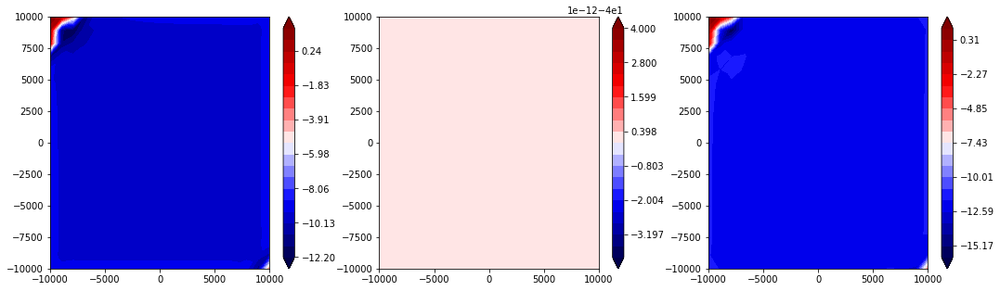

traction


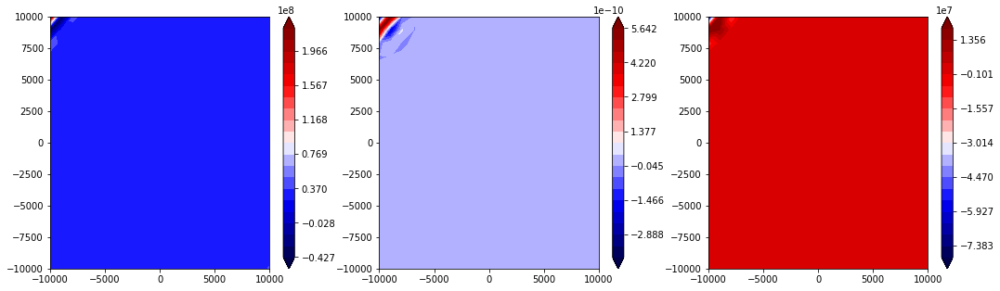

state


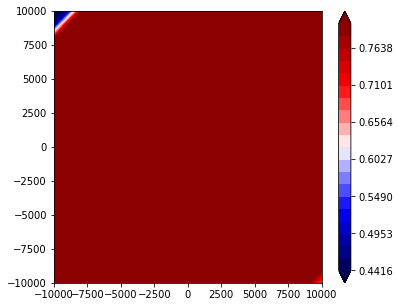

721 37.1545158585
722 37.1545158586
723 37.1545158587
724 37.1545158588
725 37.154515859
726 37.1545158592
727 37.1545158593
728 37.1545158594
729 37.1545158597
730 37.1545158597
V


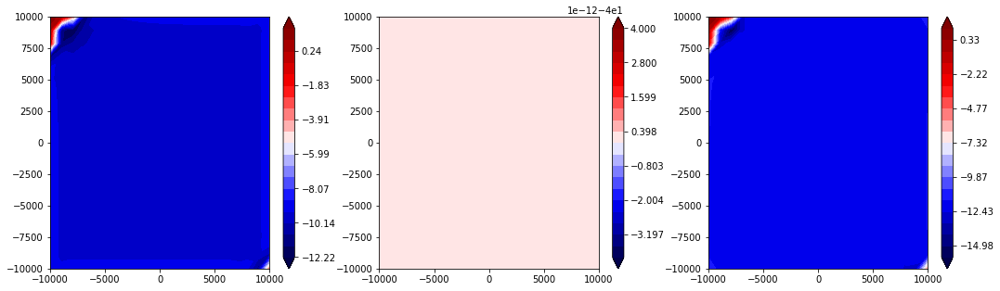

traction


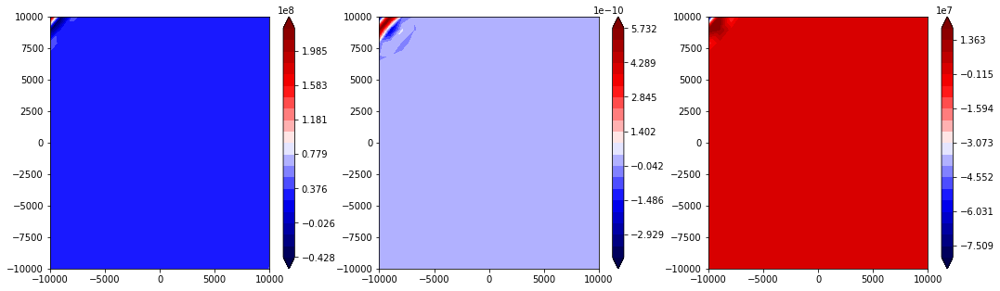

state


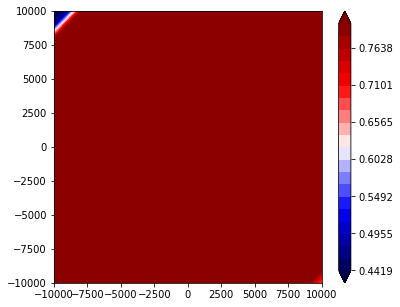

731 37.1545158598
732 37.15451586
733 37.1545158601
734 37.1545158601
735 37.1545158603
736 37.1545158605
737 37.1545158606
738 37.1545158606
739 37.1545158608
740 37.154515861
V


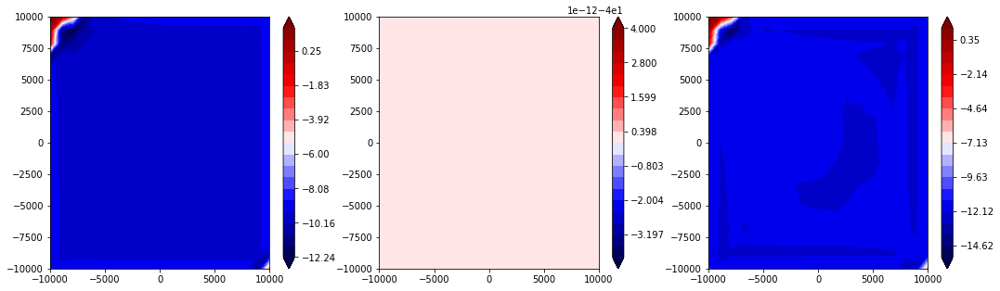

traction


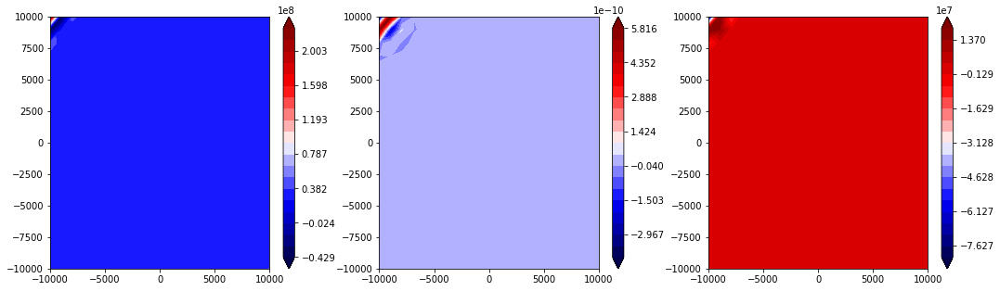

state


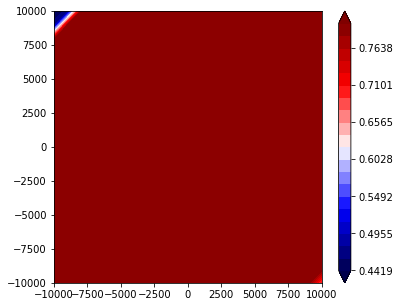

741 37.1545158611
742 37.1545158612
743 37.1545158614
744 37.1545158615
745 37.1545158616
746 37.1545158619
747 37.1545158619
748 37.154515862
749 37.1545158621
750 37.1545158624
V


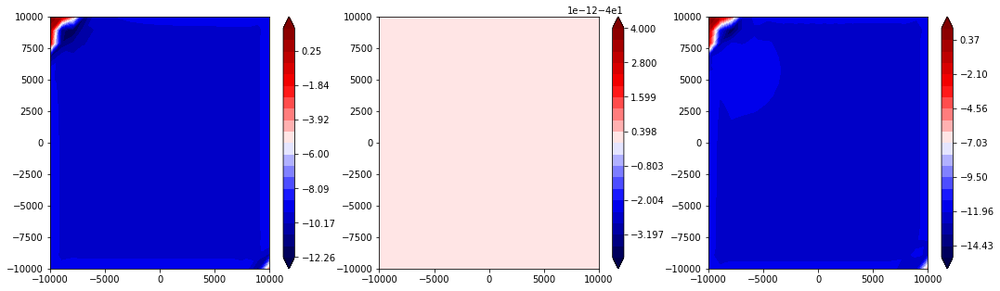

traction


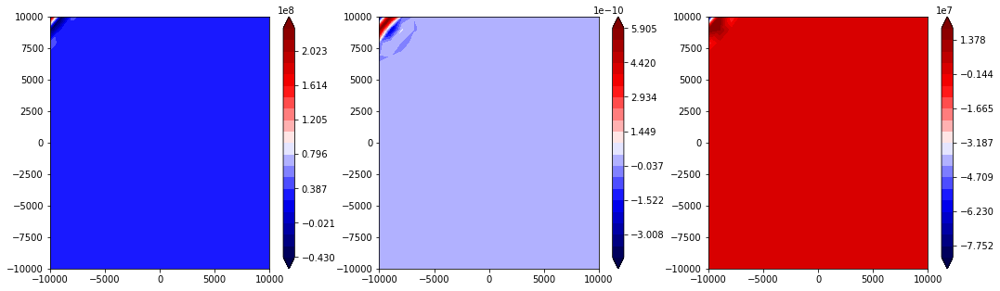

state


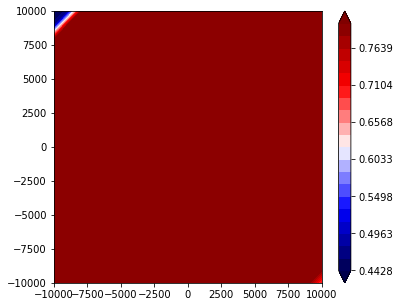

751 37.1545158624
752 37.1545158625
753 37.1545158626
754 37.1545158629
755 37.1545158629
756 37.154515863
757 37.1545158632
758 37.1545158633
759 37.1545158633
760 37.1545158635
V


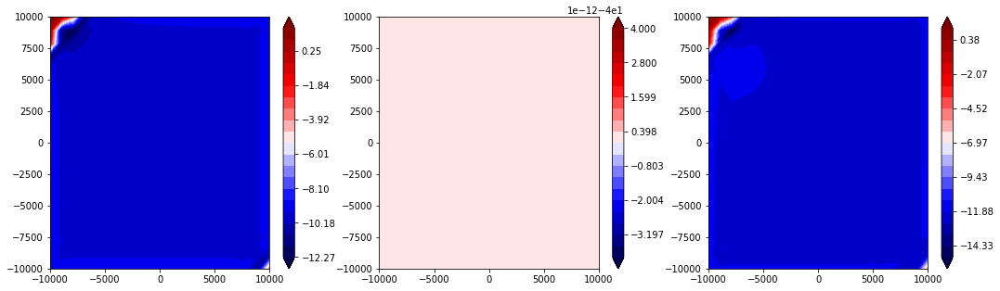

traction


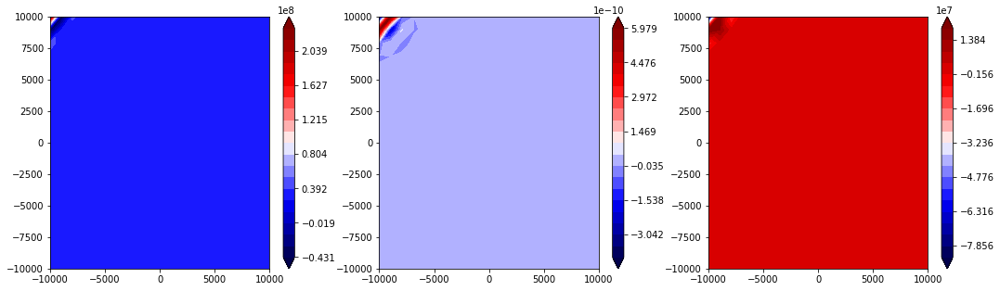

state


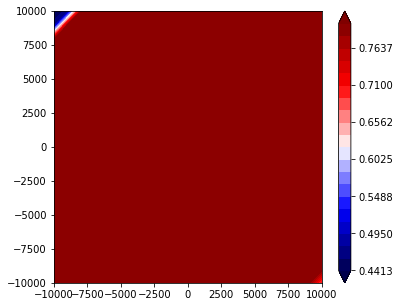

761 37.1545158637
762 37.1545158638
763 37.1545158639
764 37.1545158642
765 37.1545158642
766 37.1545158643
767 37.1545158645
768 37.1545158646
769 37.1545158648
770 37.1545158649
V


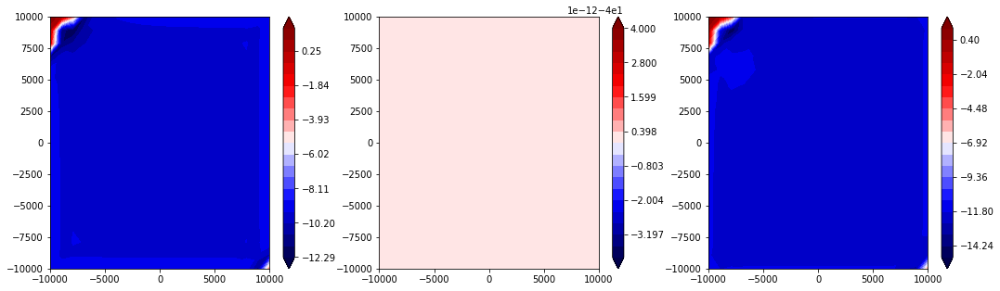

traction


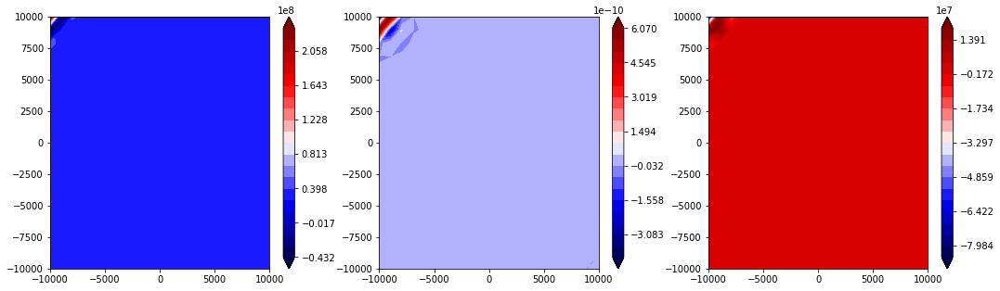

state


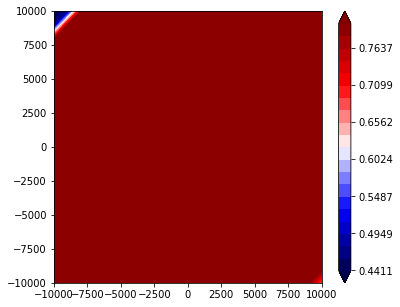

771 37.154515865
772 37.1545158652
773 37.1545158653
774 37.1545158654
775 37.1545158656
776 37.1545158657
777 37.1545158658
778 37.1545158661
779 37.1545158661
780 37.1545158662
V


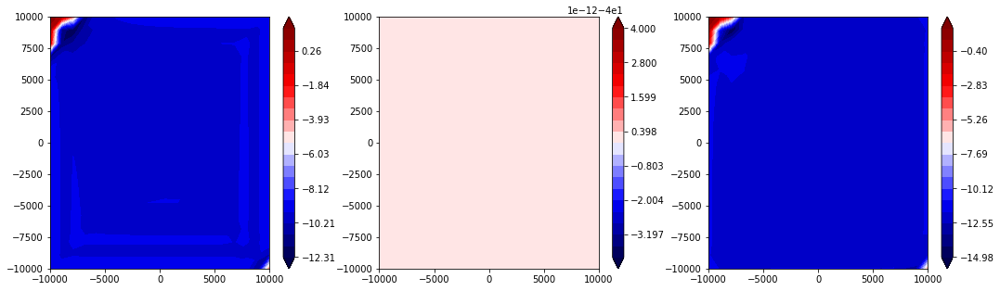

traction


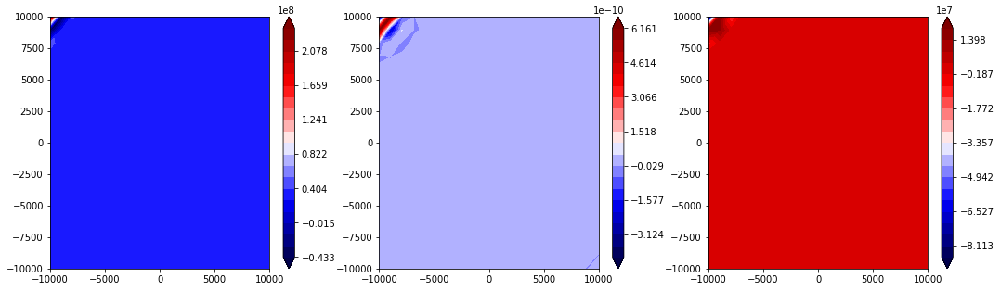

state


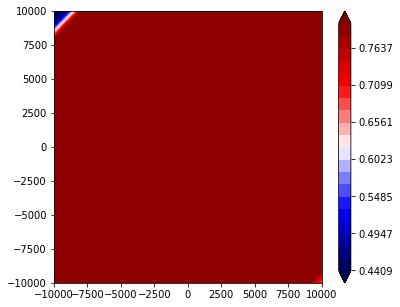

781 37.1545158664
782 37.1545158665
783 37.1545158666
784 37.1545158668
785 37.1545158669
786 37.154515867
787 37.1545158672
788 37.1545158673
789 37.1545158674
790 37.1545158676
V


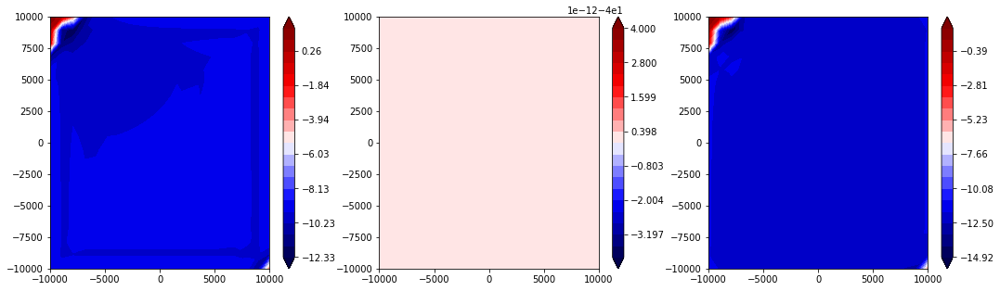

traction


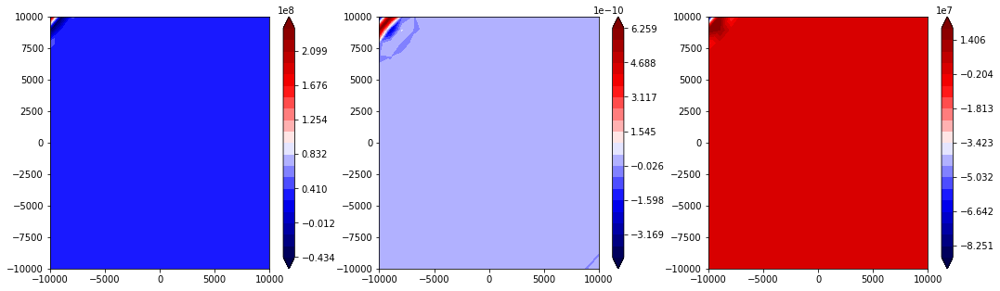

state


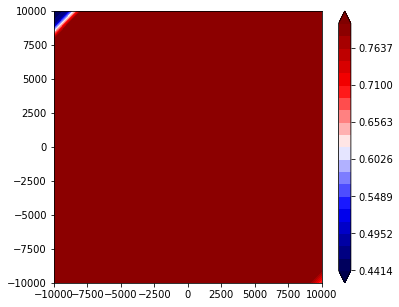

791 37.1545158677
792 37.1545158678
793 37.154515868
794 37.1545158681
795 37.1545158682
796 37.1545158684
797 37.1545158685
798 37.1545158686
799 37.1545158688
800 37.1545158688
V


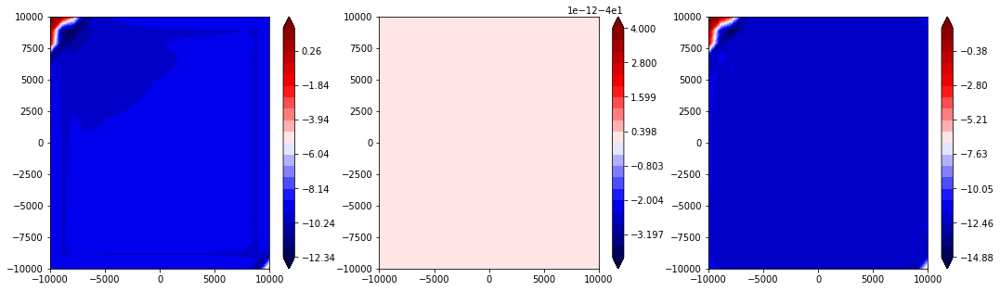

traction


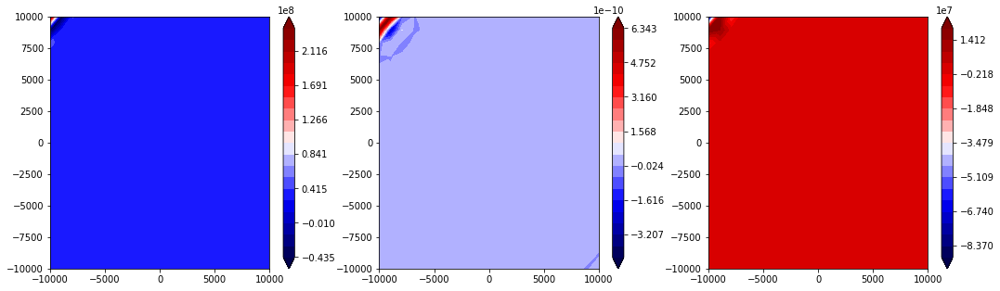

state


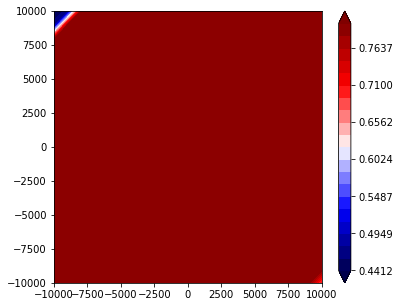

801 37.1545158689
802 37.1545158691
803 37.1545158691
804 37.1545158693
805 37.1545158695
806 37.1545158695
807 37.1545158697
808 37.1545158699
809 37.1545158699
810 37.15451587
V


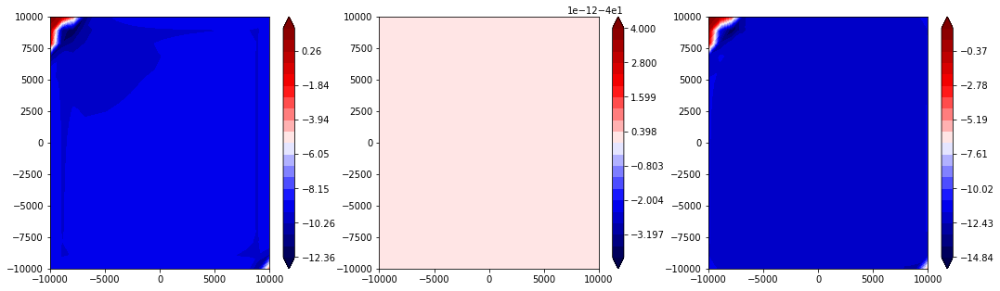

traction


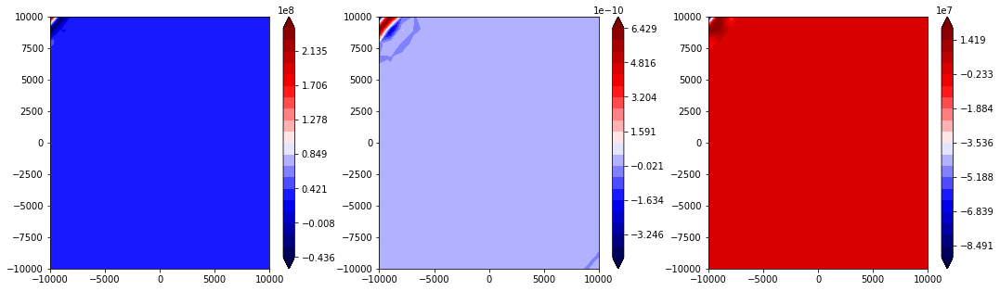

state


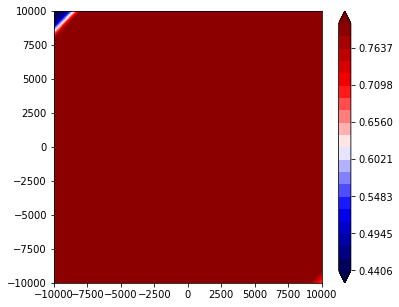

811 37.1545158703
812 37.1545158703
813 37.1545158705
814 37.1545158707
815 37.1545158707
816 37.1545158708
817 37.154515871
818 37.1545158711
819 37.1545158711
820 37.1545158713
V


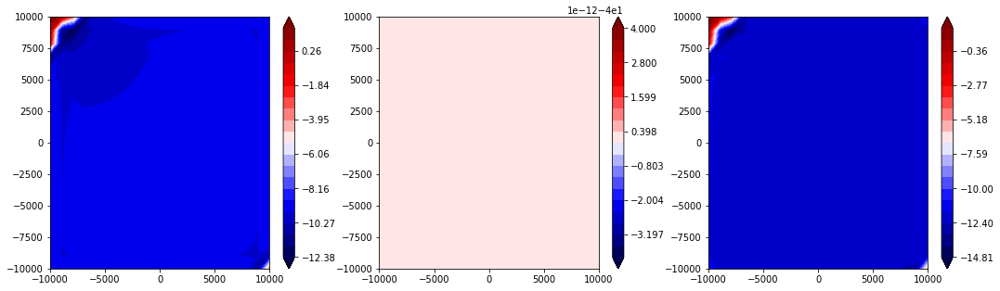

traction


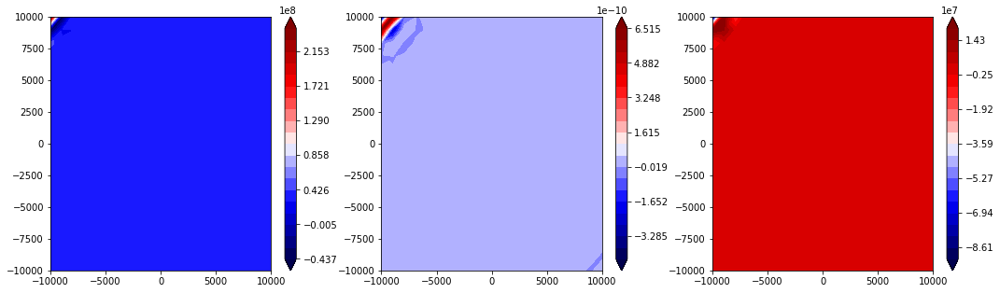

state


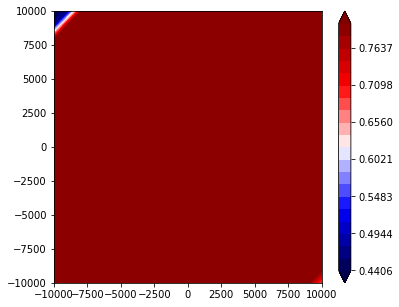

821 37.1545158715
822 37.1545158715
823 37.1545158716
824 37.1545158717
825 37.1545158719
826 37.1545158719
827 37.1545158721
828 37.1545158723
829 37.1545158723
830 37.1545158725
V


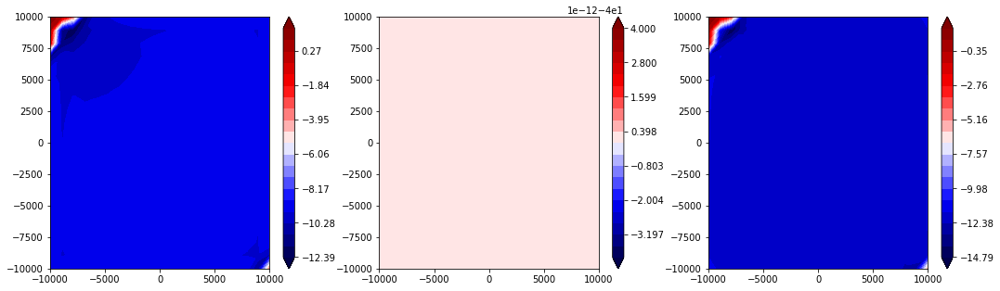

traction


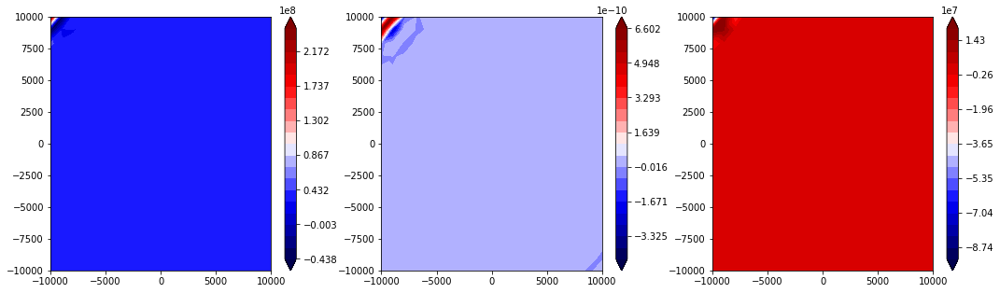

state


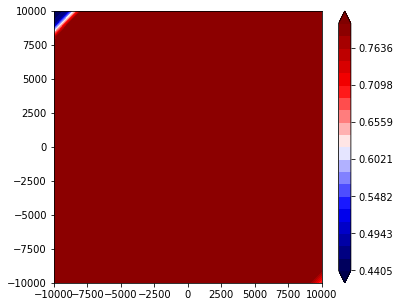

831 37.1545158727
832 37.1545158727
833 37.1545158728
834 37.1545158731
835 37.1545158731
836 37.1545158732
837 37.1545158734
838 37.1545158735
839 37.1545158736
840 37.1545158738
V


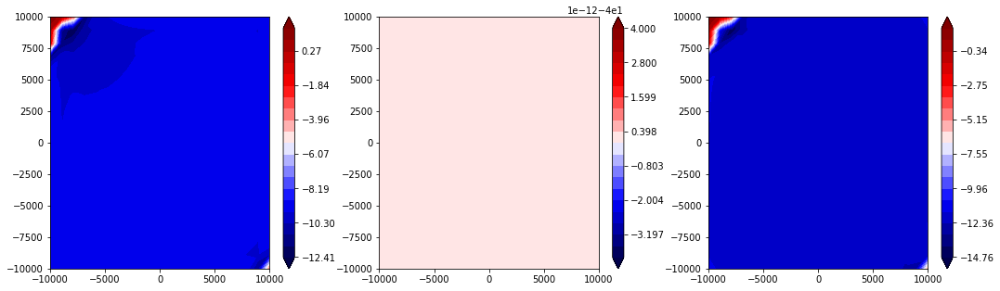

traction


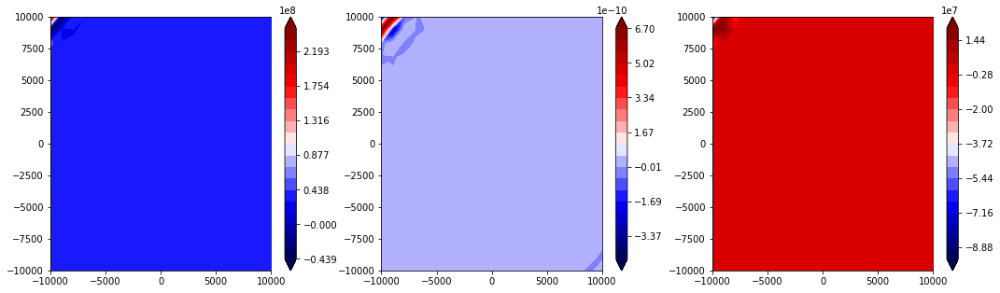

state


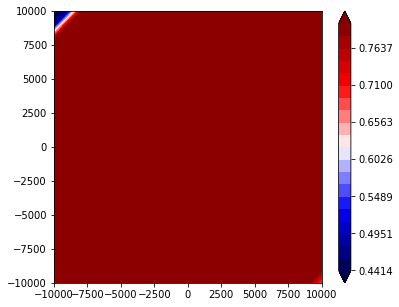

841 37.1545158739
842 37.154515874
843 37.1545158742
844 37.1545158742
845 37.1545158743
846 37.1545158744
847 37.1545158746
848 37.1545158746
849 37.1545158748
850 37.1545158749
V


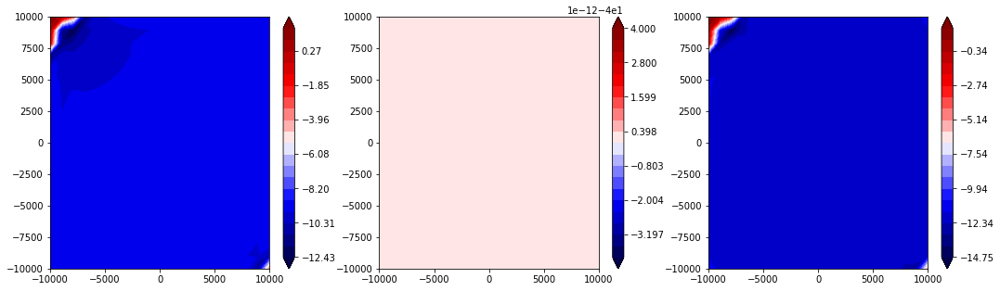

traction


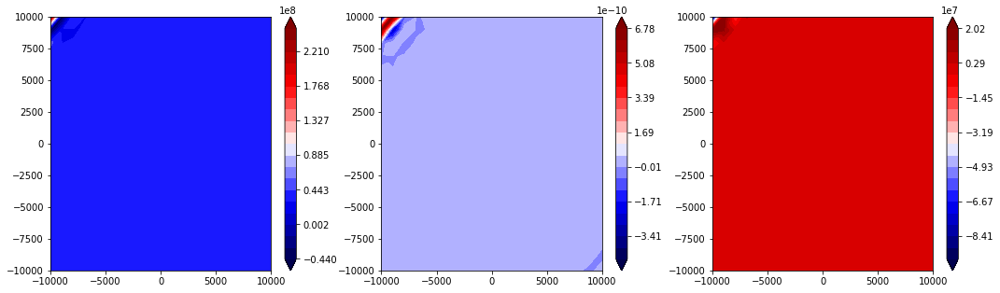

state


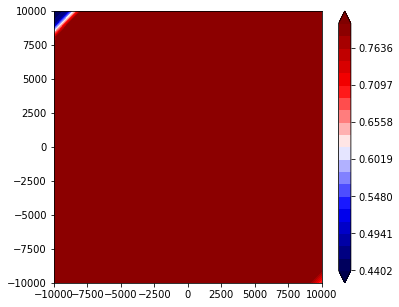

851 37.1545158751
852 37.1545158752
853 37.1545158753
854 37.1545158755
855 37.1545158755
856 37.1545158757
857 37.1545158759
858 37.1545158759
859 37.154515876
860 37.1545158762
V


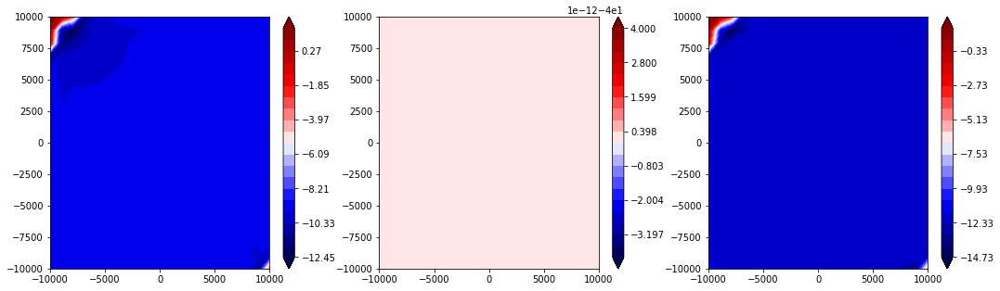

traction


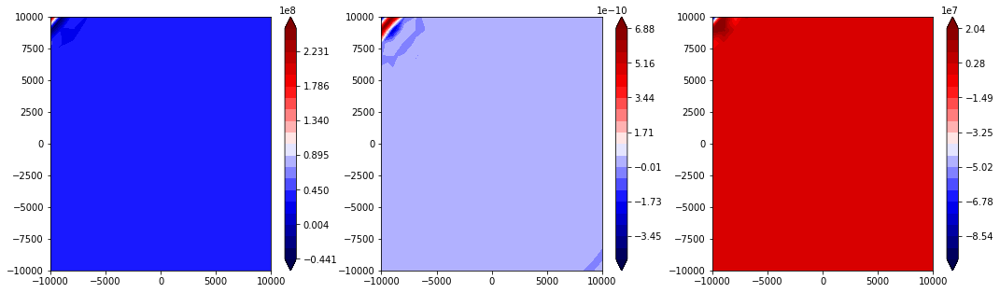

state


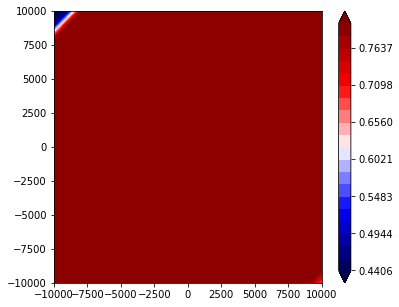

861 37.1545158763
862 37.1545158764
863 37.1545158766
864 37.1545158767
865 37.1545158767
866 37.1545158769
867 37.1545158771
868 37.1545158771
869 37.1545158772
870 37.1545158774
V


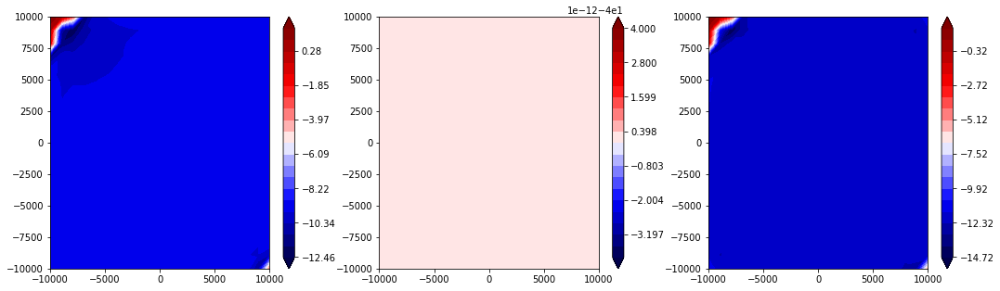

traction


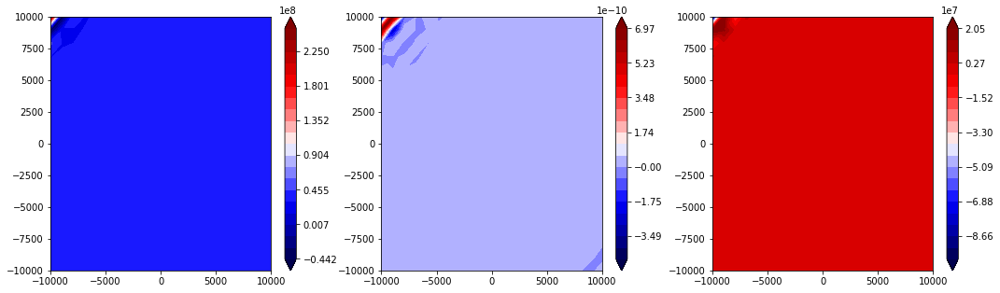

state


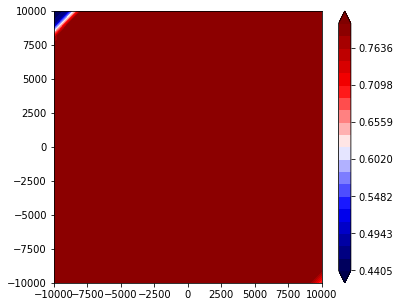

871 37.1545158775
872 37.1545158776
873 37.1545158778
874 37.1545158779
875 37.1545158779
876 37.154515878
877 37.1545158782
878 37.1545158782
879 37.1545158782
880 37.1545158783
V


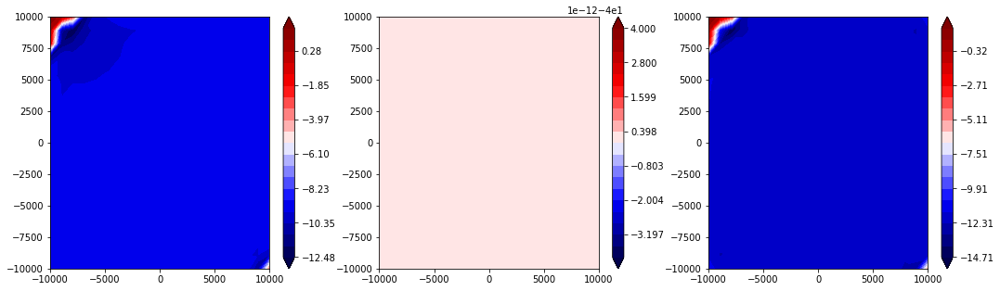

traction


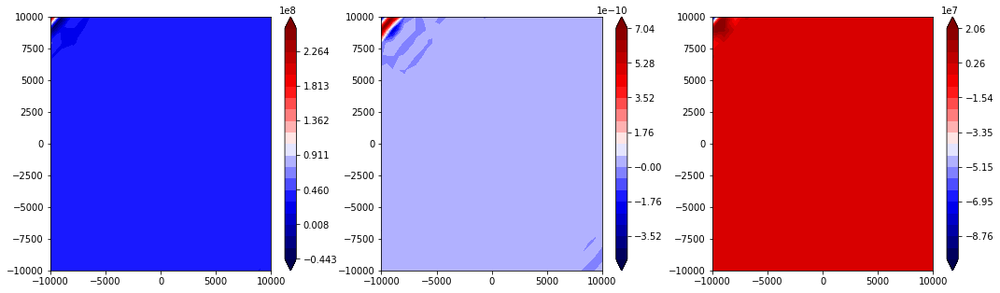

state


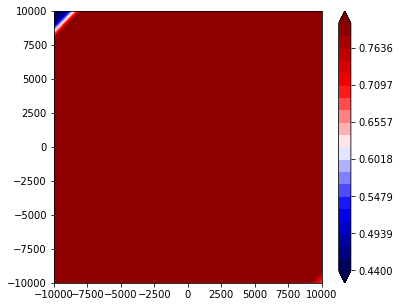

881 37.1545158785
882 37.1545158786
883 37.1545158786
884 37.1545158788
885 37.1545158789
886 37.1545158791
887 37.1545158791
888 37.1545158792
889 37.1545158794
890 37.1545158794
V


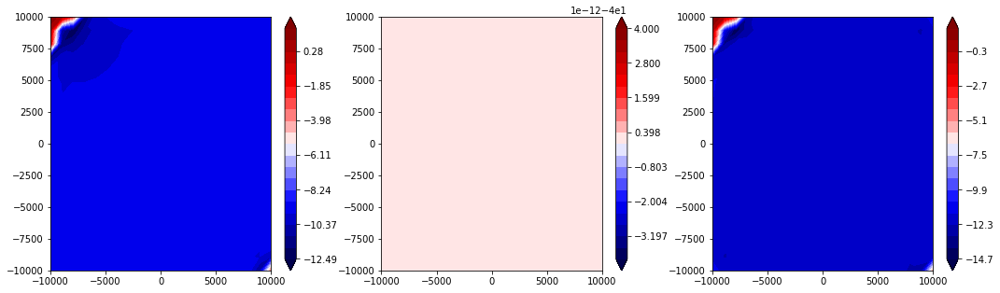

traction


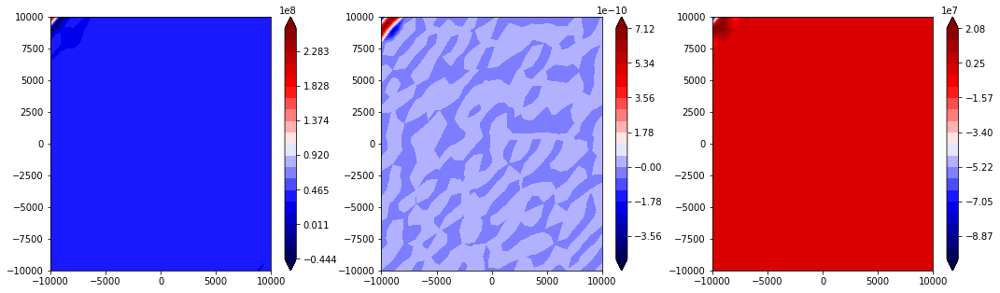

state


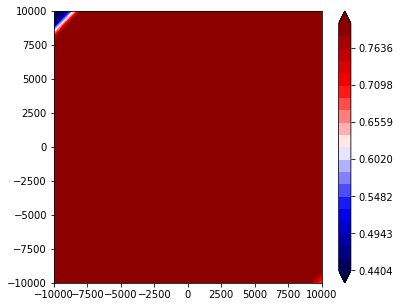

891 37.1545158795
892 37.1545158797
893 37.1545158798
894 37.15451588
895 37.15451588
896 37.1545158801
897 37.1545158803
898 37.1545158803
899 37.1545158805
900 37.1545158807
V


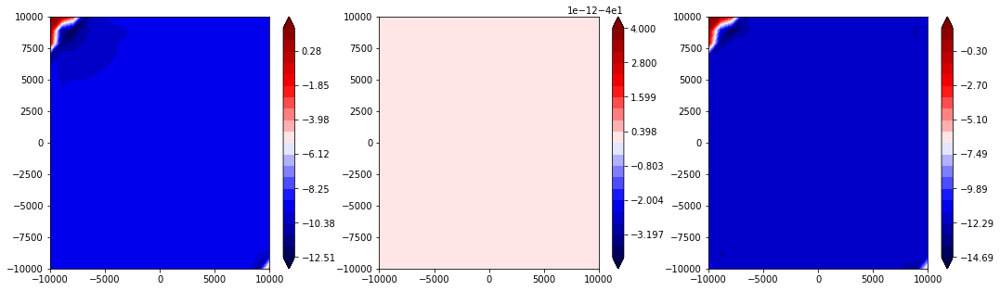

traction


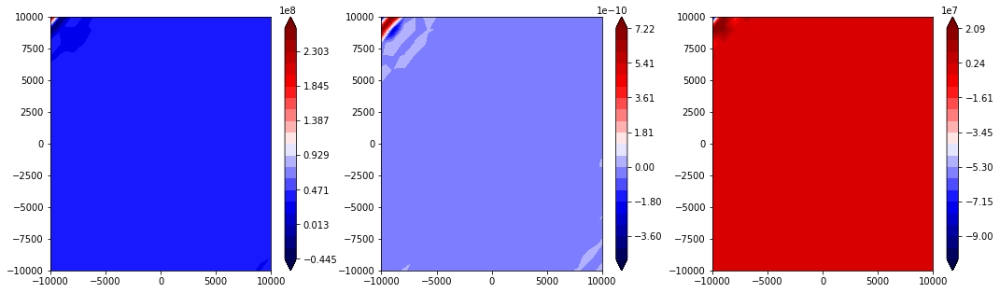

state


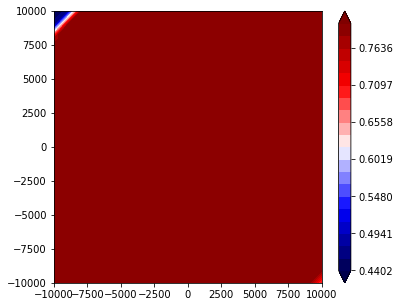

901 37.1545158807
902 37.1545158808
903 37.154515881
904 37.1545158811
905 37.1545158812
906 37.1545158814
907 37.1545158814
908 37.1545158815
909 37.1545158817
910 37.1545158818
V


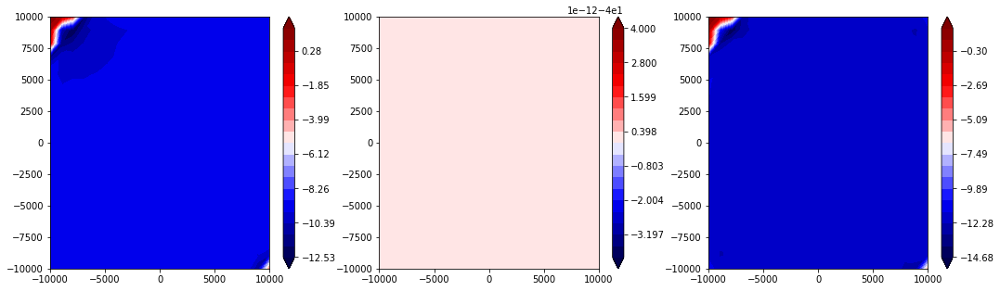

traction


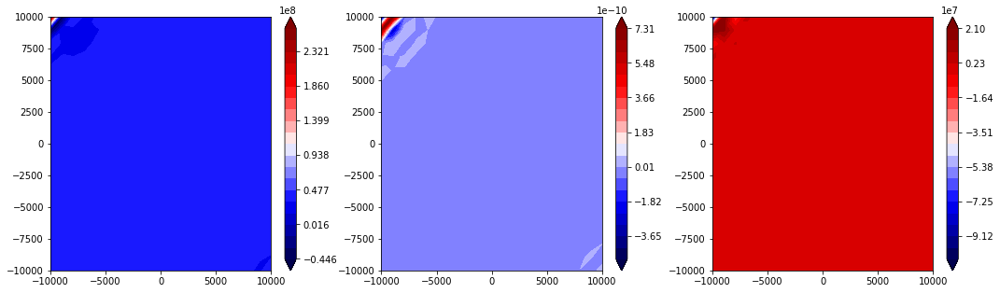

state


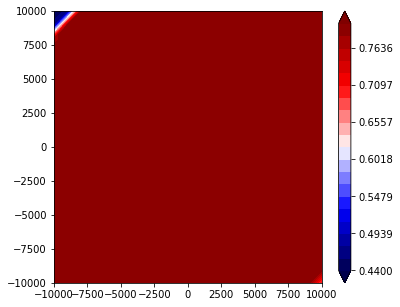

911 37.1545158819
912 37.1545158821
913 37.1545158821
914 37.1545158822
915 37.1545158824
916 37.1545158825
917 37.1545158826
918 37.1545158828
919 37.1545158828
920 37.1545158829
V


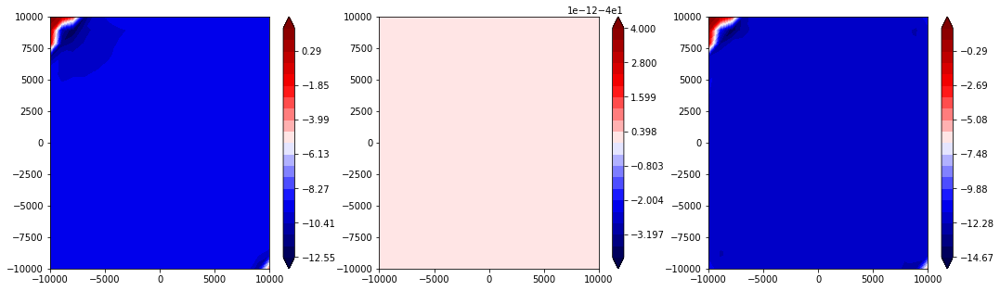

traction


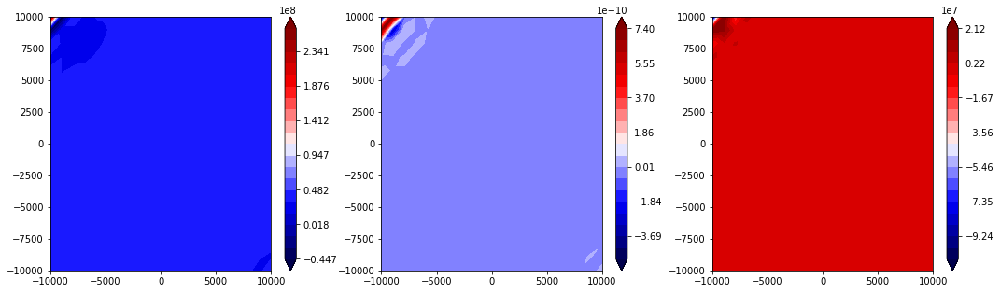

state


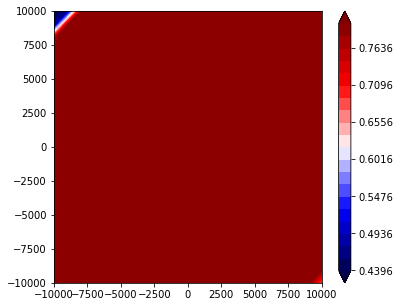

921 37.1545158831
922 37.1545158832
923 37.1545158833
924 37.1545158835
925 37.1545158835
926 37.1545158836
927 37.1545158838
928 37.1545158838
929 37.154515884
930 37.1545158842
V


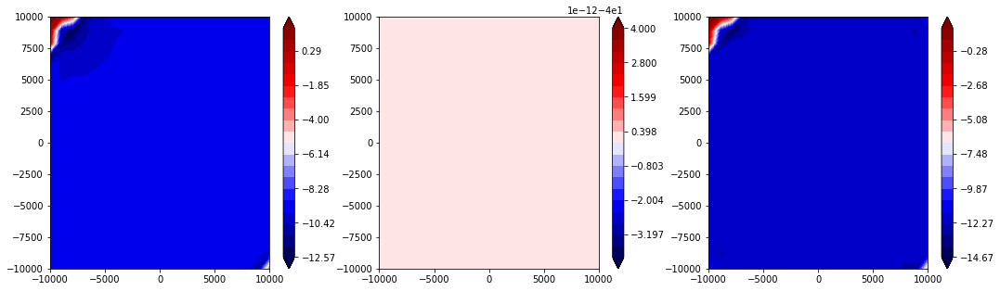

traction


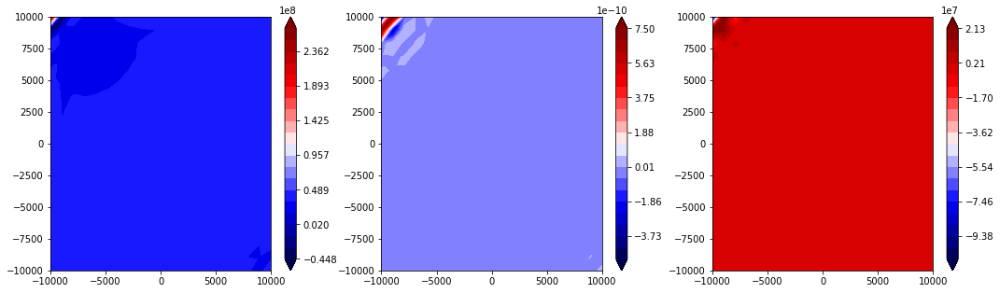

state


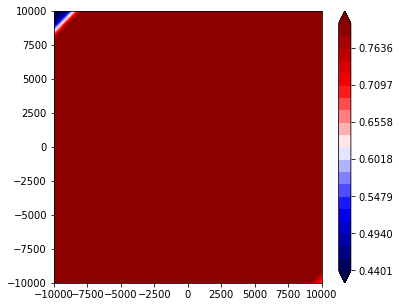

931 37.1545158842
932 37.1545158843
933 37.1545158845
934 37.1545158846
935 37.1545158847
936 37.1545158849
937 37.1545158849
938 37.154515885
939 37.1545158852
940 37.1545158853
V


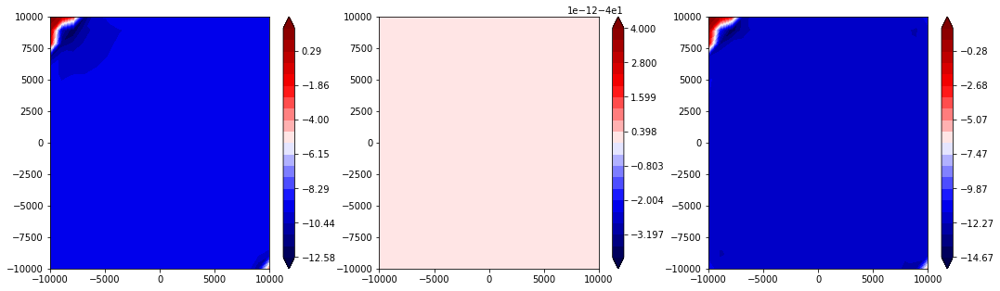

traction


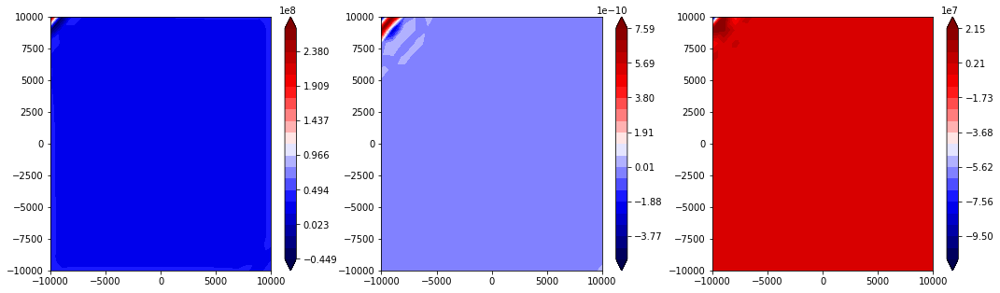

state


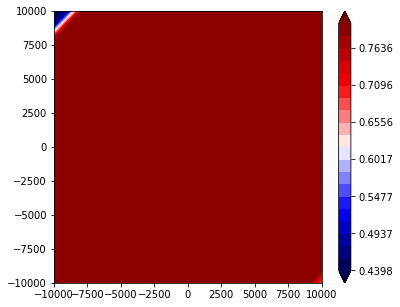

941 37.1545158853
942 37.1545158855
943 37.1545158856
944 37.1545158857
945 37.1545158859
946 37.1545158859
947 37.154515886
948 37.1545158862
949 37.1545158863
950 37.1545158864
V


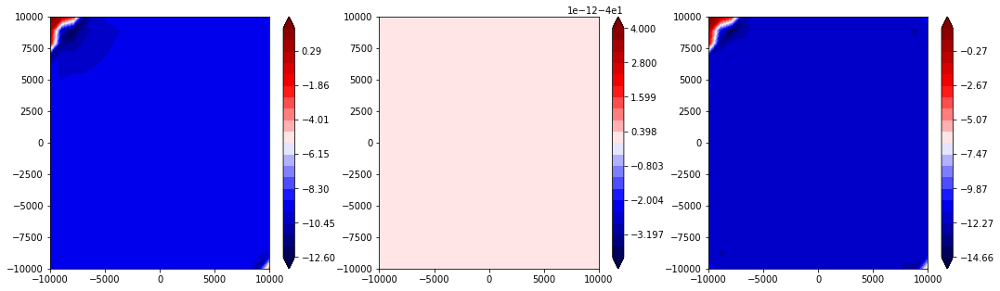

traction


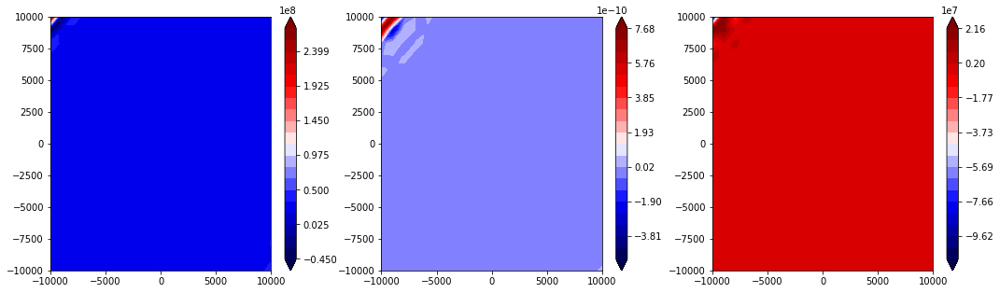

state


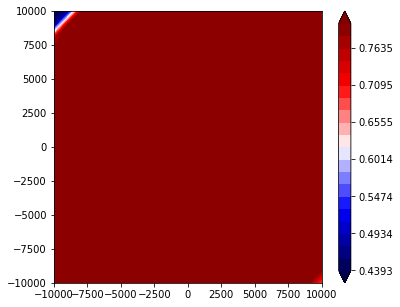

951 37.1545158865
952 37.1545158866
953 37.1545158867
954 37.1545158869
955 37.1545158869
956 37.154515887
957 37.1545158871
958 37.1545158873
959 37.1545158874
960 37.1545158875
V


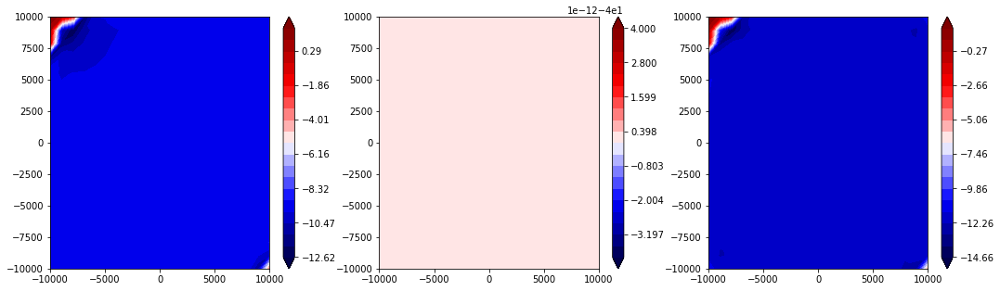

traction


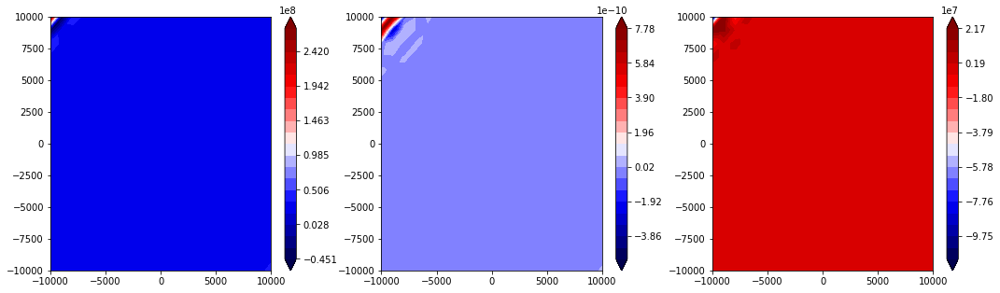

state


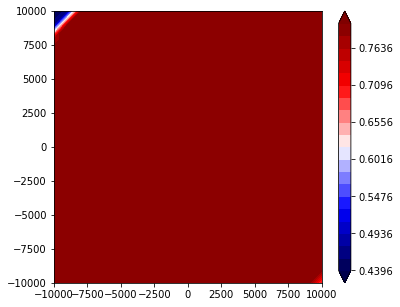

961 37.1545158876
962 37.1545158878
963 37.1545158878
964 37.1545158879
965 37.154515888
966 37.1545158882
967 37.1545158882
968 37.1545158883
969 37.1545158885
970 37.1545158886
V


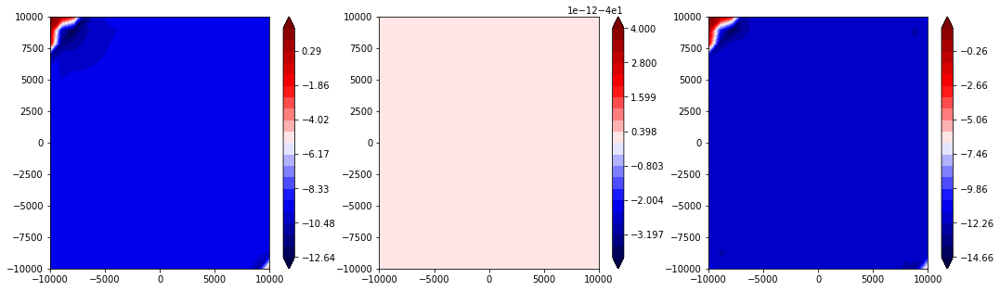

traction


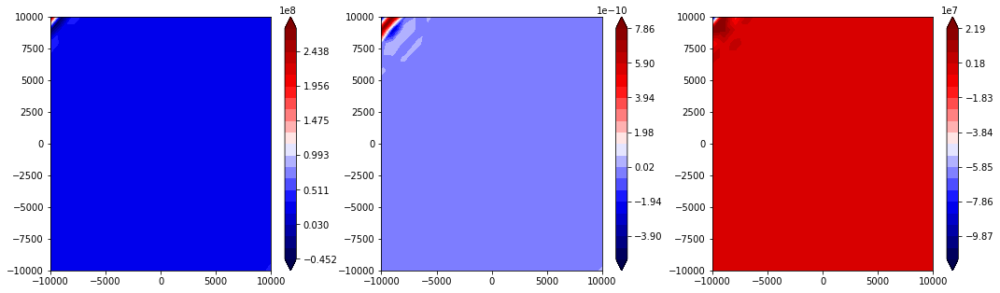

state


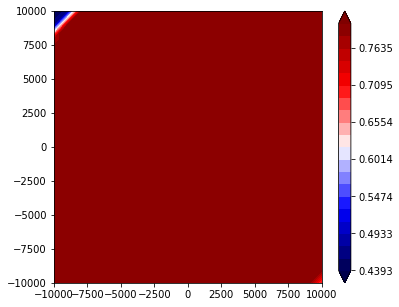

971 37.1545158887
972 37.1545158889
973 37.1545158889
974 37.1545158889
975 37.154515889
976 37.1545158892
977 37.1545158892
978 37.1545158893
979 37.1545158893
980 37.1545158895
V


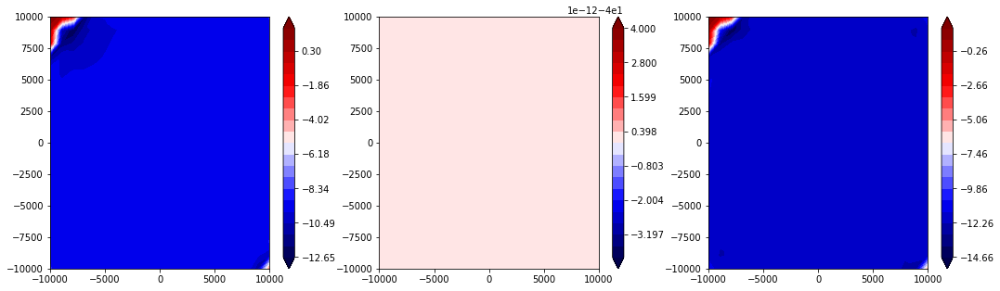

traction


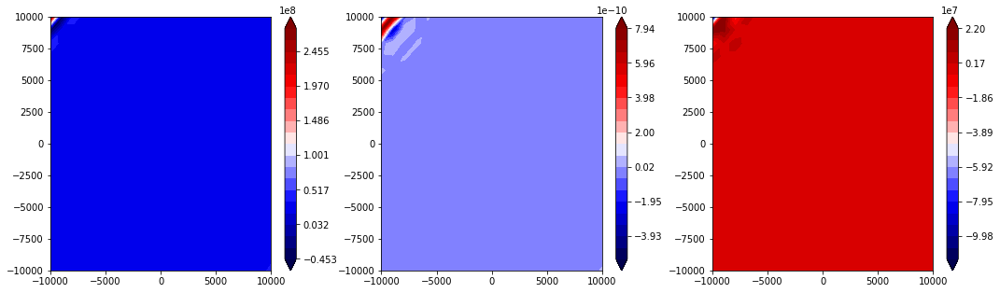

state


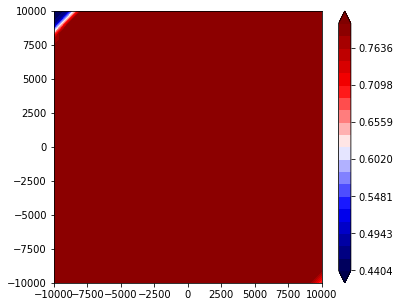

981 37.1545158895
982 37.1545158896
983 37.1545158897
984 37.1545158898
985 37.15451589
986 37.1545158901
987 37.1545158902
988 37.1545158904
989 37.1545158904
990 37.1545158905
V


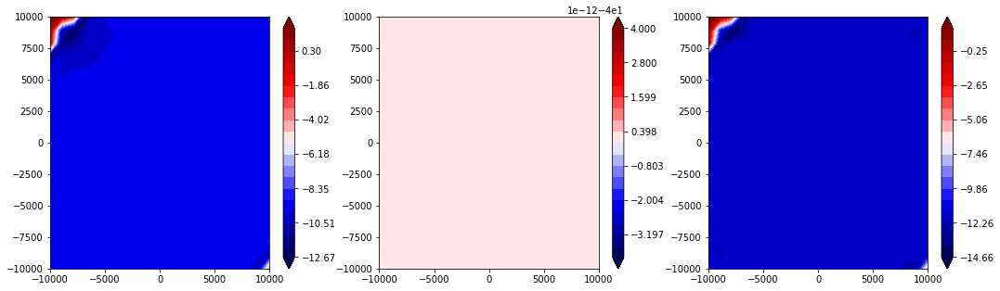

traction


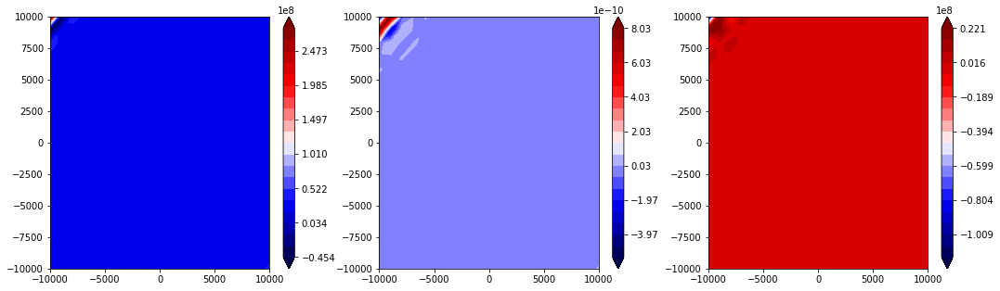

state


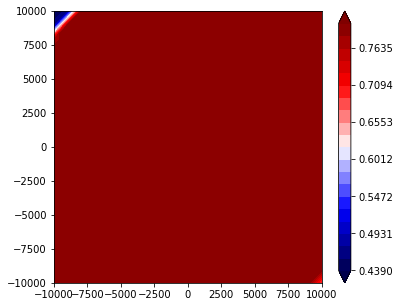

991 37.1545158907
992 37.1545158907
993 37.1545158908
994 37.154515891
995 37.1545158911
996 37.1545158912
997 37.1545158914
998 37.1545158914
999 37.1545158915
1000 37.1545158917
V


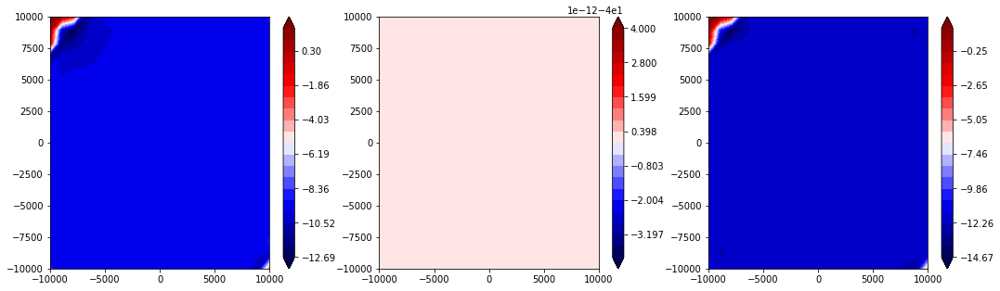

traction


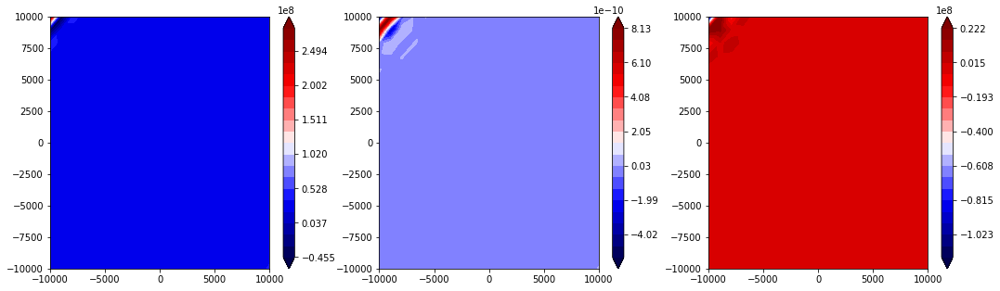

state


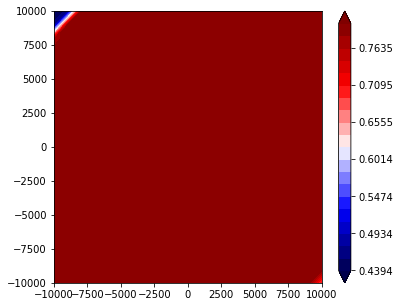

1001 37.1545158917
1002 37.1545158918
1003 37.154515892
1004 37.154515892
1005 37.1545158921
1006 37.1545158923
1007 37.1545158923
1008 37.1545158923
1009 37.1545158924
1010 37.1545158926
V


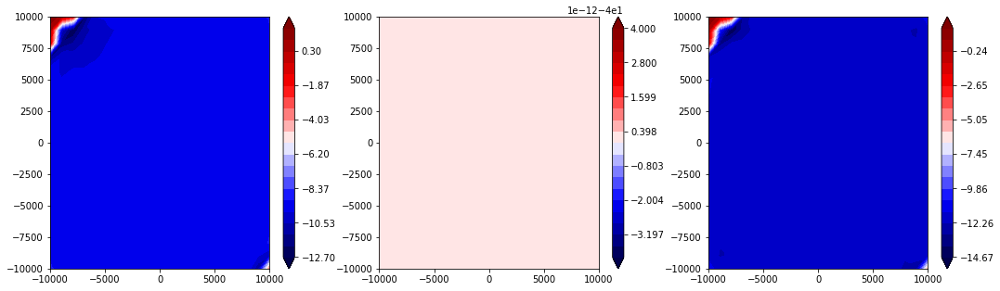

traction


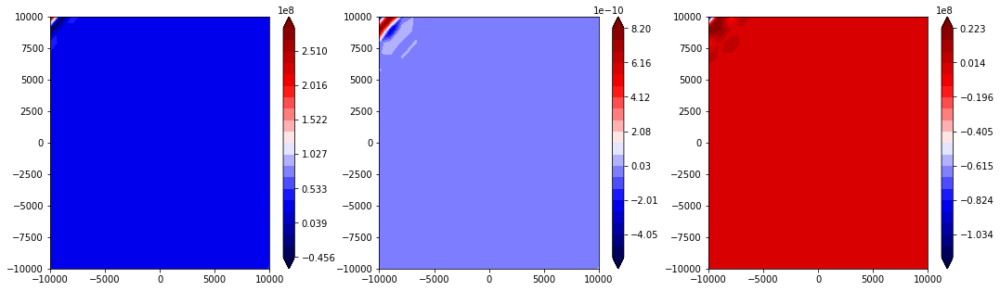

state


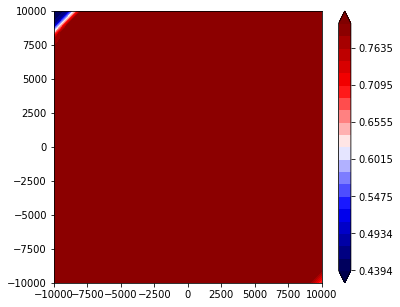

1011 37.1545158926
1012 37.1545158927
1013 37.1545158929
1014 37.1545158929
1015 37.154515893
1016 37.1545158932
1017 37.1545158932
1018 37.1545158933
1019 37.1545158935
1020 37.1545158936
V


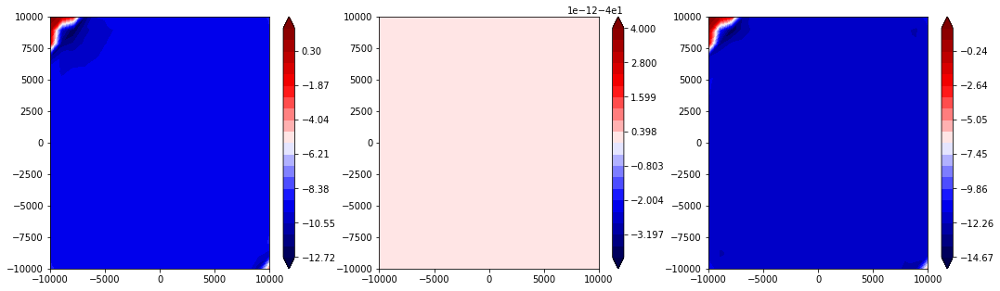

traction


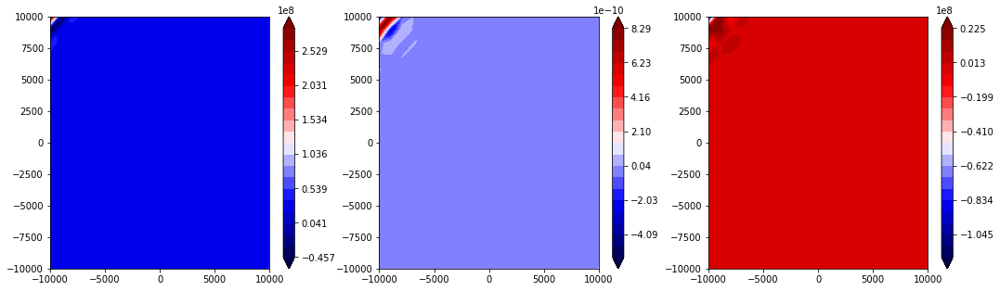

state


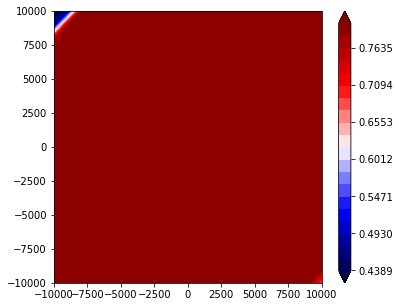

1021 37.1545158937
1022 37.1545158938
1023 37.1545158939
1024 37.1545158939
1025 37.1545158941
1026 37.1545158942
1027 37.1545158943
1028 37.1545158944
1029 37.1545158945
1030 37.1545158946
V


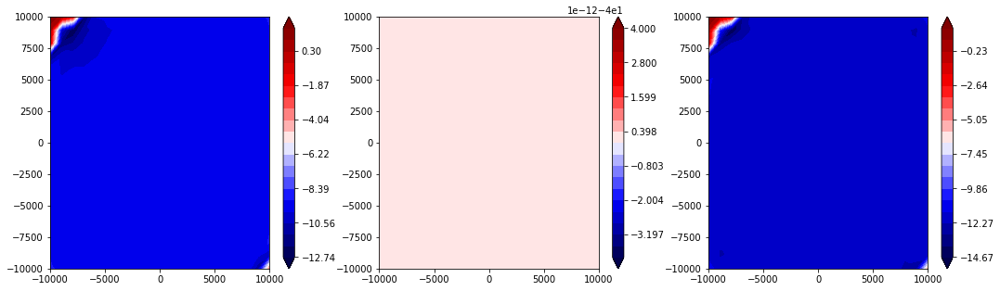

traction


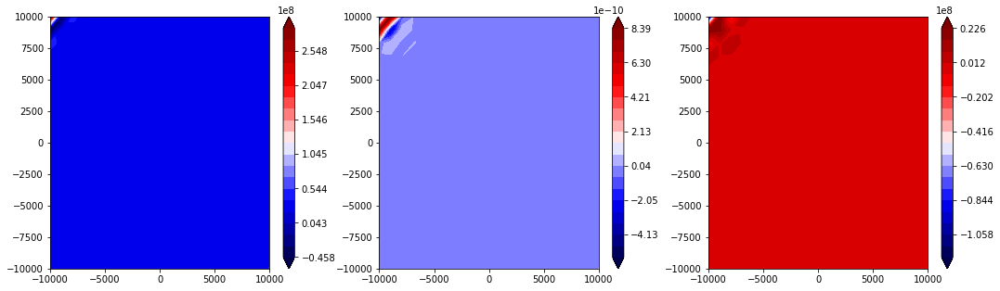

state


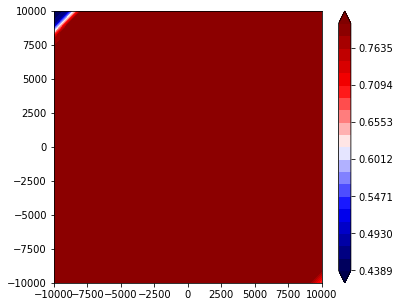

1031 37.1545158947
1032 37.1545158949
1033 37.1545158949
1034 37.154515895
1035 37.1545158952
1036 37.1545158952
1037 37.1545158953
1038 37.1545158954
1039 37.1545158955
1040 37.1545158956
V


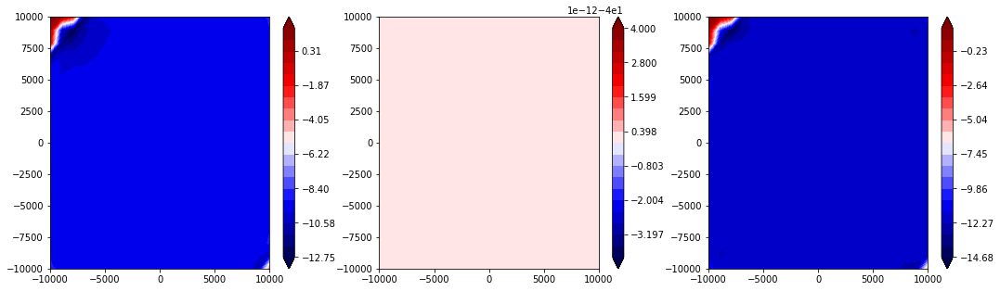

traction


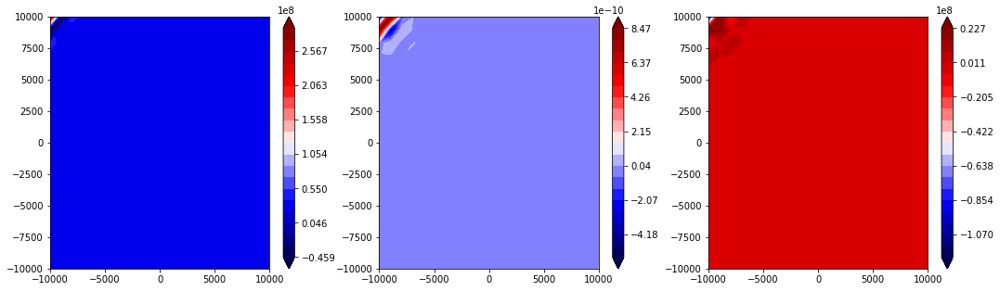

state


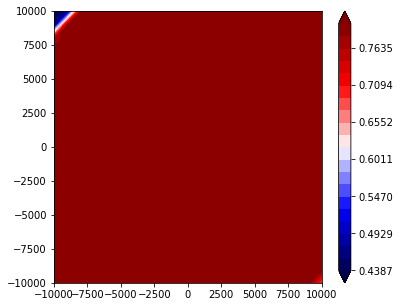

1041 37.1545158957
1042 37.1545158959
1043 37.1545158959
1044 37.154515896
1045 37.1545158962
1046 37.1545158962
1047 37.1545158963
1048 37.1545158965
1049 37.1545158965
1050 37.1545158966
V


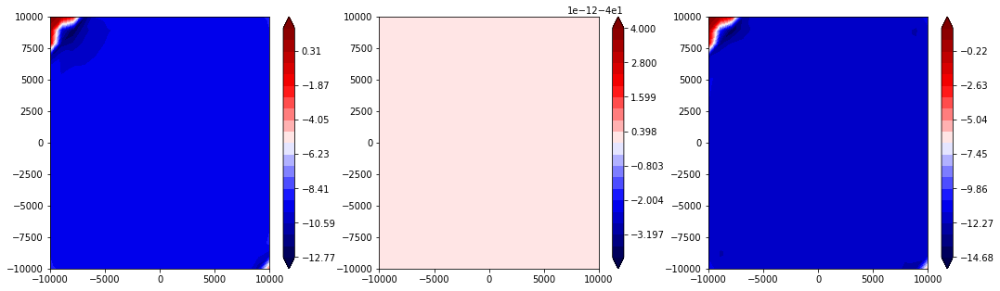

traction


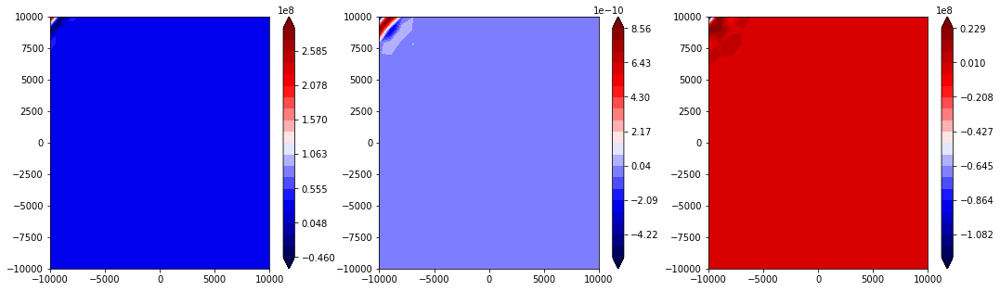

state


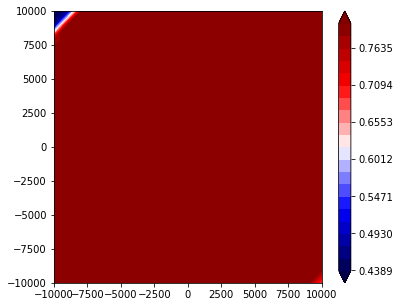

1051 37.1545158966
1052 37.1545158968
1053 37.1545158968
1054 37.1545158969
1055 37.1545158971
1056 37.1545158971
1057 37.1545158972
1058 37.1545158974
1059 37.1545158974
1060 37.1545158975
V


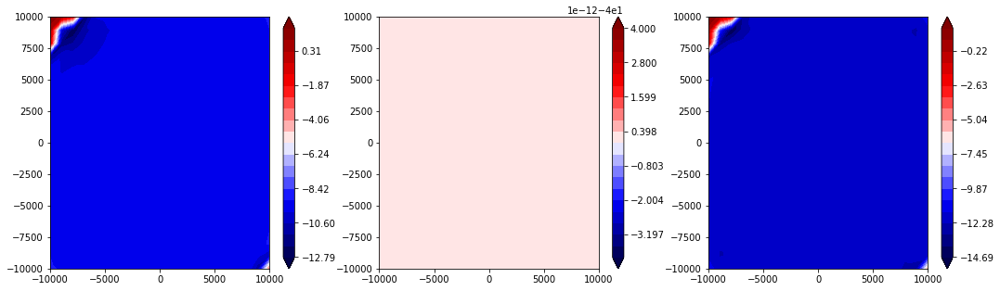

traction


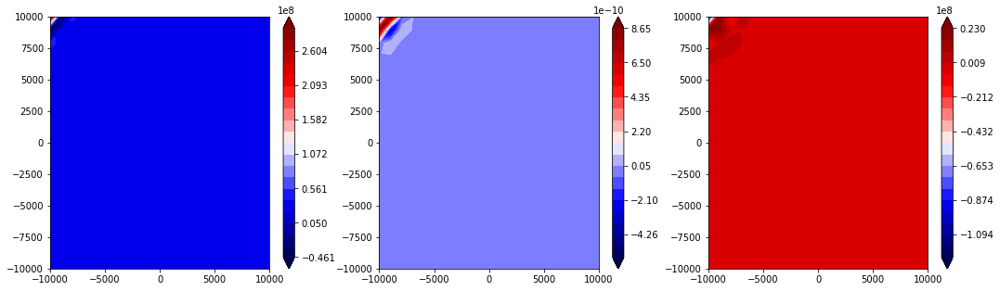

state


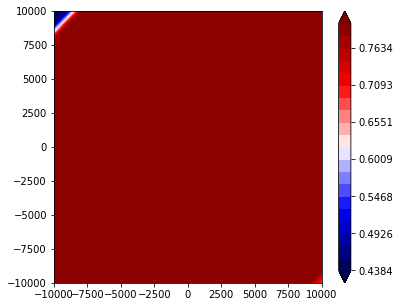

1061 37.1545158977
1062 37.1545158977
1063 37.1545158978
1064 37.154515898
1065 37.154515898
1066 37.1545158982
1067 37.1545158983
1068 37.1545158984
1069 37.1545158984
1070 37.1545158986
V


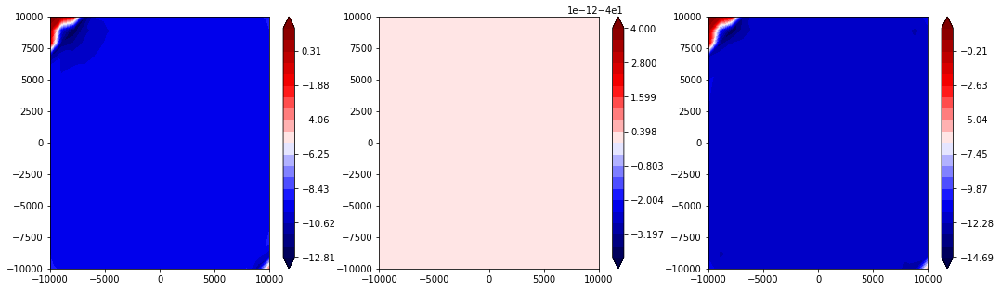

traction


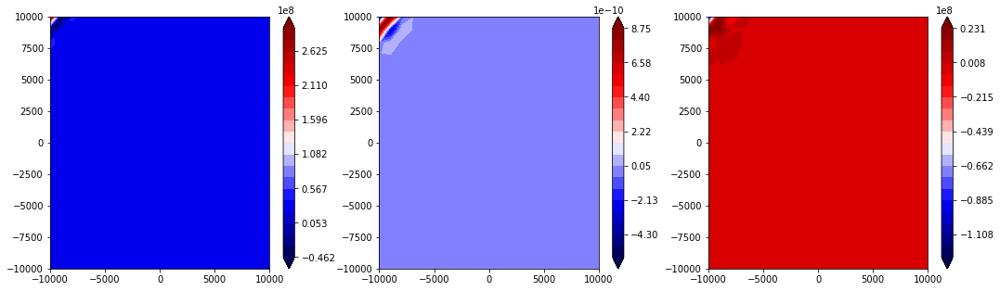

state


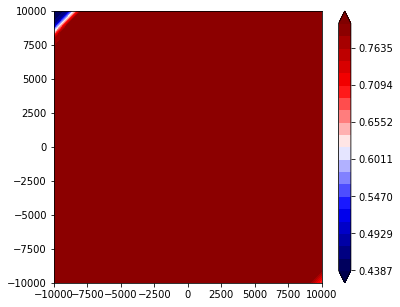

1071 37.1545158987
1072 37.1545158988
1073 37.1545158989
1074 37.154515899
1075 37.1545158991
1076 37.1545158992
1077 37.1545158993
1078 37.1545158994
1079 37.1545158995
1080 37.1545158996
V


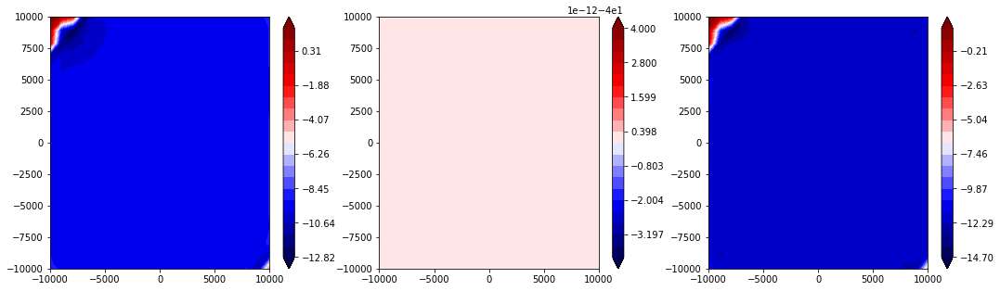

traction


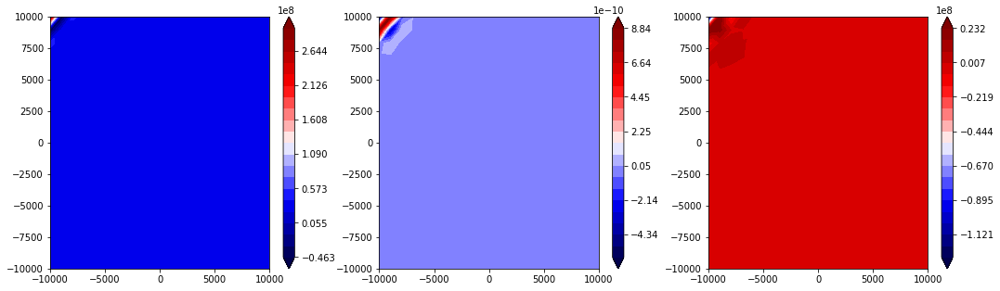

state


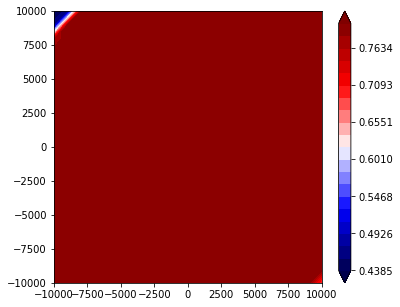

1081 37.1545158997
1082 37.1545158998
1083 37.1545158999
1084 37.1545159
1085 37.1545159002
1086 37.1545159002
1087 37.1545159002
1088 37.1545159003
1089 37.1545159005
1090 37.1545159005
V


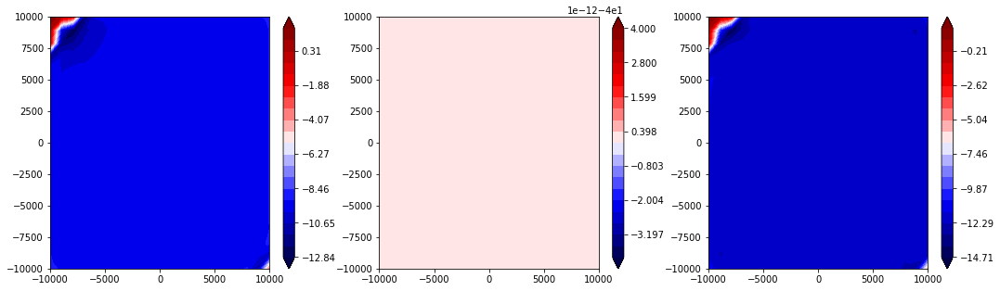

traction


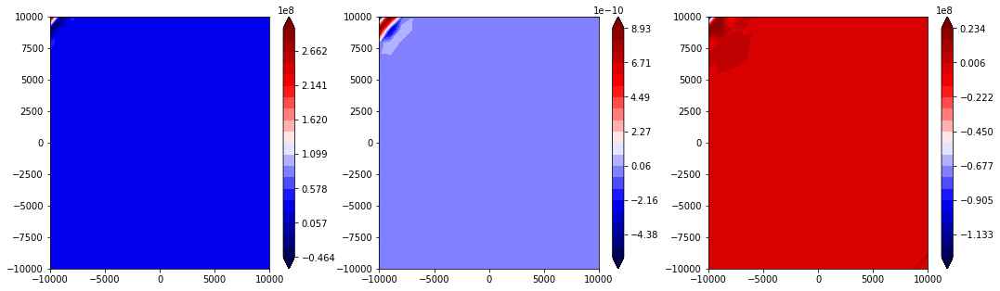

state


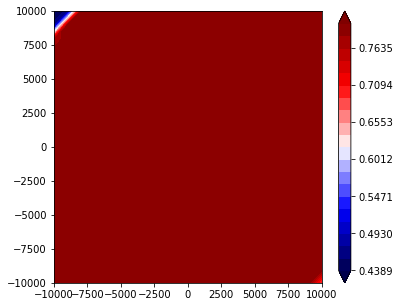

1091 37.1545159006
1092 37.1545159007
1093 37.1545159009
1094 37.1545159009
1095 37.1545159009
1096 37.1545159011
1097 37.1545159011
1098 37.1545159012
1099 37.1545159013
1100 37.1545159014
V


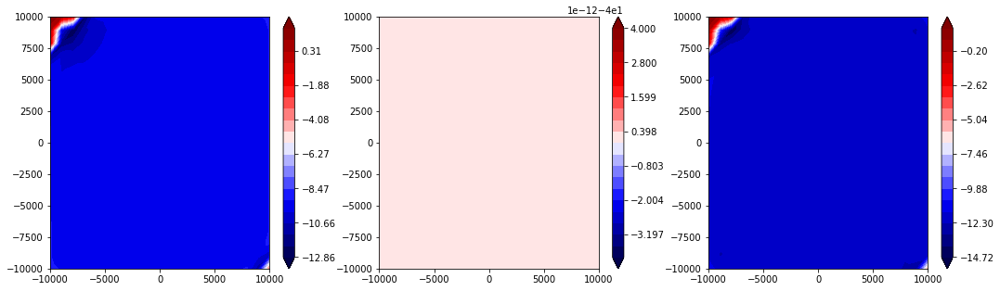

traction


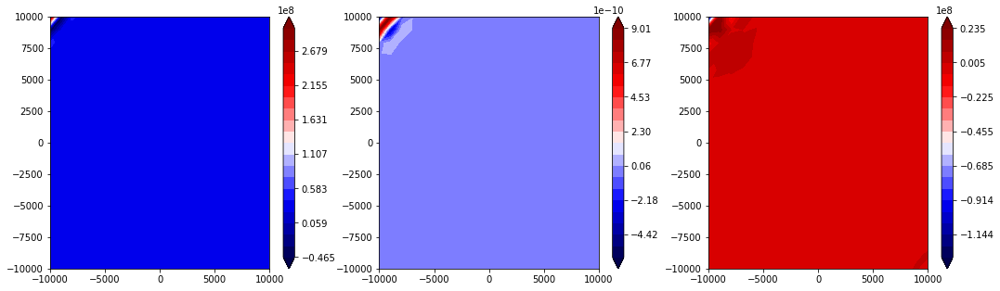

state


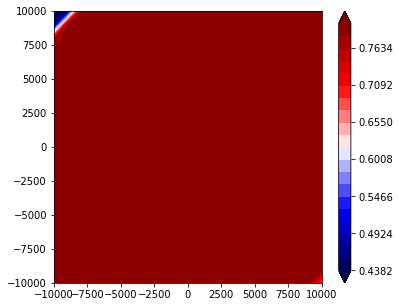

1101 37.1545159016
1102 37.1545159016
1103 37.1545159017
1104 37.1545159018
1105 37.1545159018
1106 37.1545159019
1107 37.1545159019
1108 37.1545159021
1109 37.1545159021
1110 37.1545159022
V


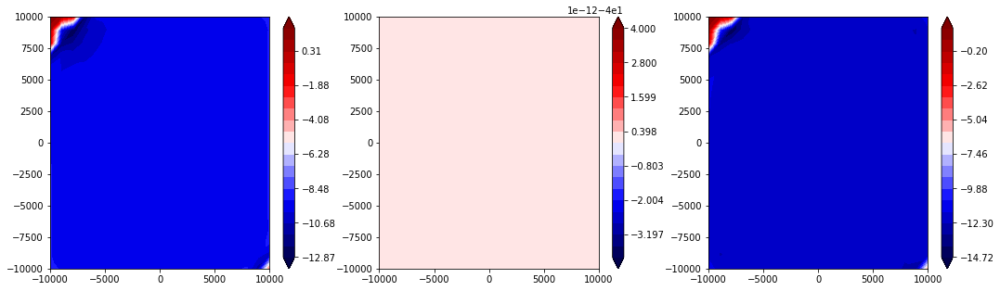

traction


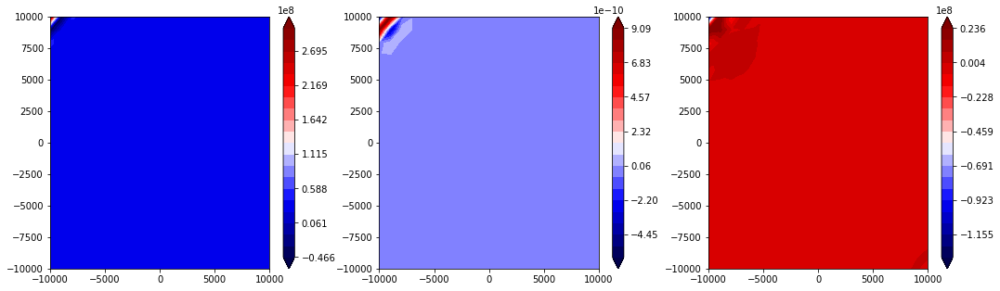

state


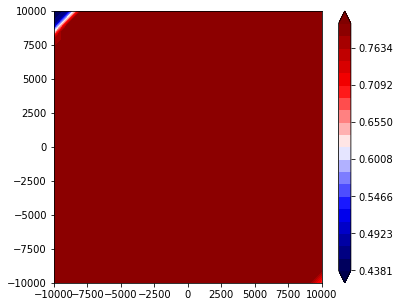

1111 37.1545159023
1112 37.1545159024
1113 37.1545159024
1114 37.1545159026
1115 37.1545159027
1116 37.1545159028
1117 37.1545159029
1118 37.1545159029
1119 37.154515903
1120 37.1545159032
V


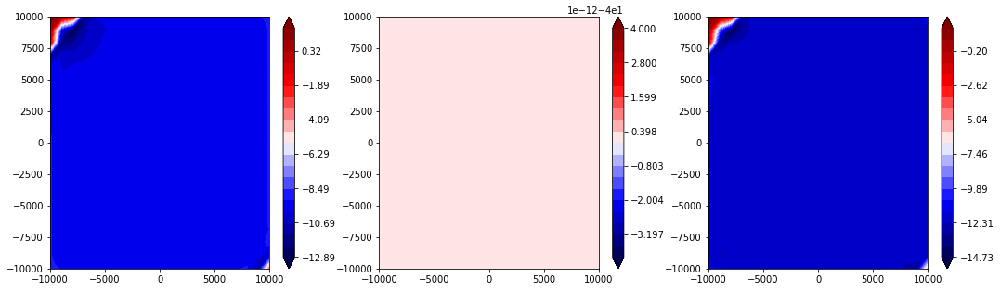

traction


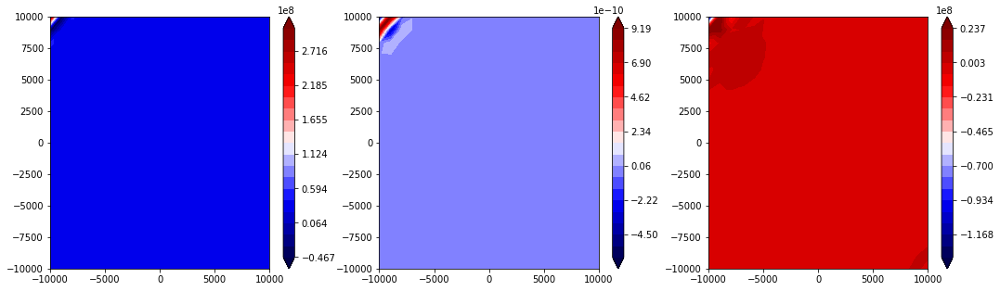

state


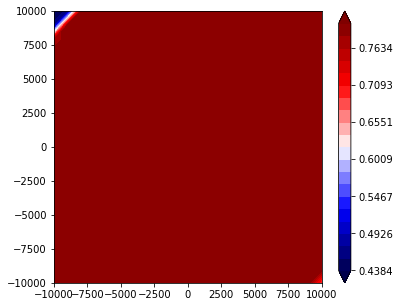

1121 37.1545159032
1122 37.1545159034
1123 37.1545159035
1124 37.1545159035
1125 37.1545159036
1126 37.1545159038
1127 37.1545159038
1128 37.1545159039
1129 37.1545159041
1130 37.1545159041
V


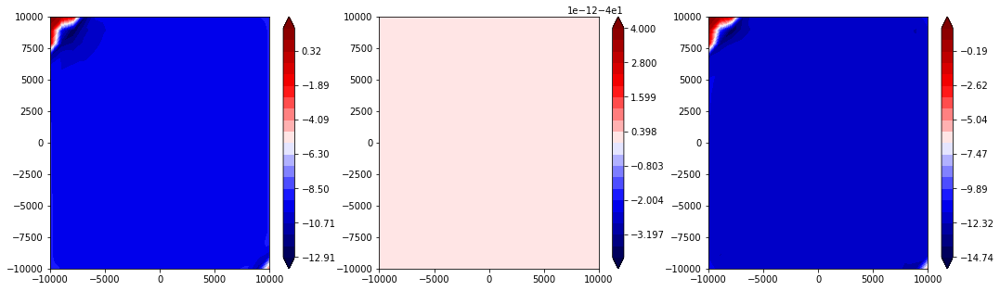

traction


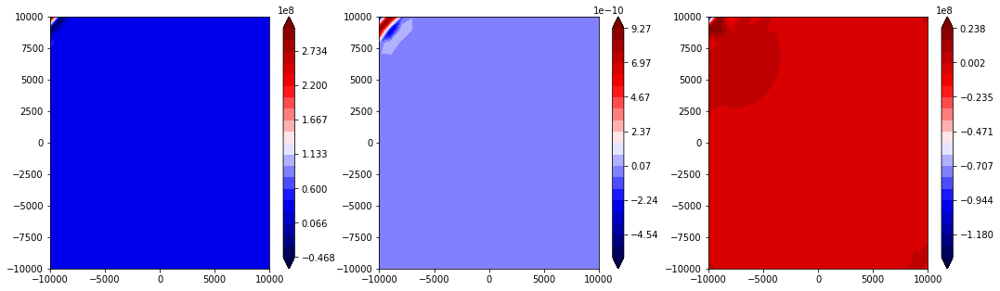

state


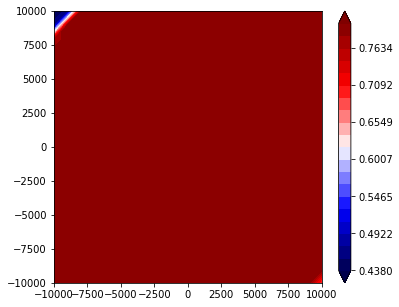

1131 37.1545159042
1132 37.1545159044
1133 37.1545159044
1134 37.1545159045
1135 37.1545159047
1136 37.1545159047
1137 37.1545159048
1138 37.154515905
1139 37.154515905
1140 37.154515905
V


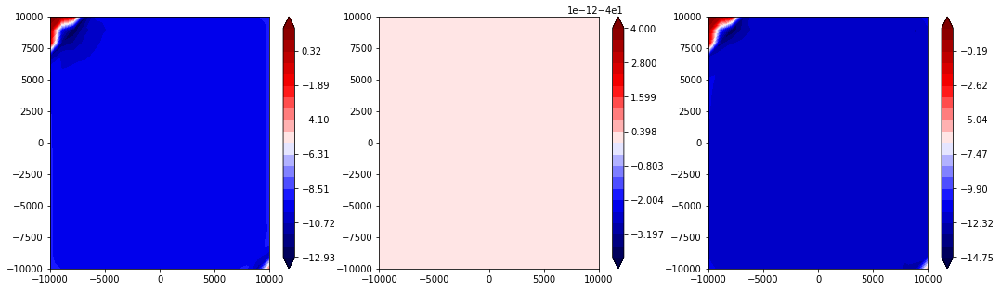

traction


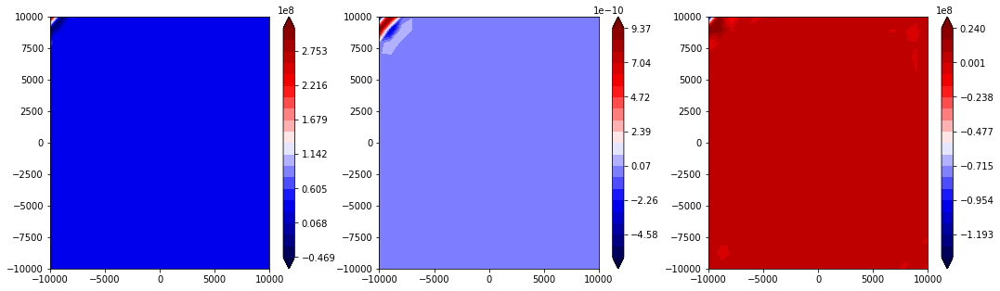

state


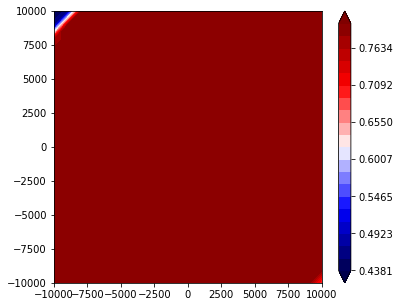

1141 37.1545159051
1142 37.1545159053
1143 37.1545159053
1144 37.1545159054
1145 37.1545159056
1146 37.1545159056
1147 37.1545159057
1148 37.1545159059
1149 37.1545159059
1150 37.154515906
V


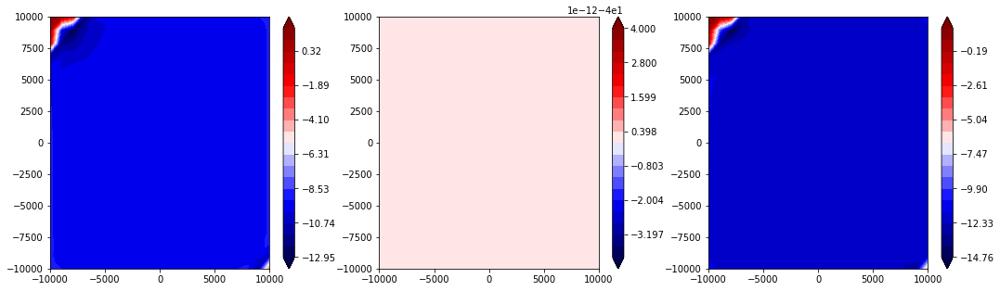

traction


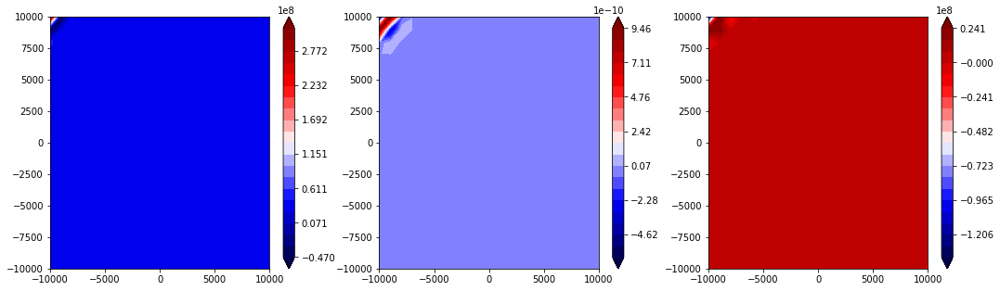

state


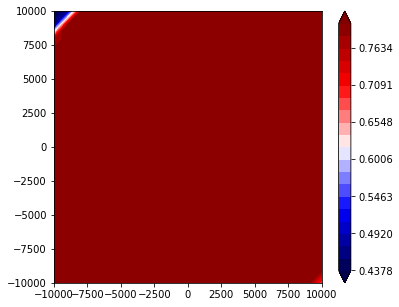

1151 37.1545159061
1152 37.1545159062
1153 37.1545159063
1154 37.1545159064
1155 37.1545159065
1156 37.1545159066
1157 37.1545159067
1158 37.1545159068
1159 37.1545159068
1160 37.154515907
V


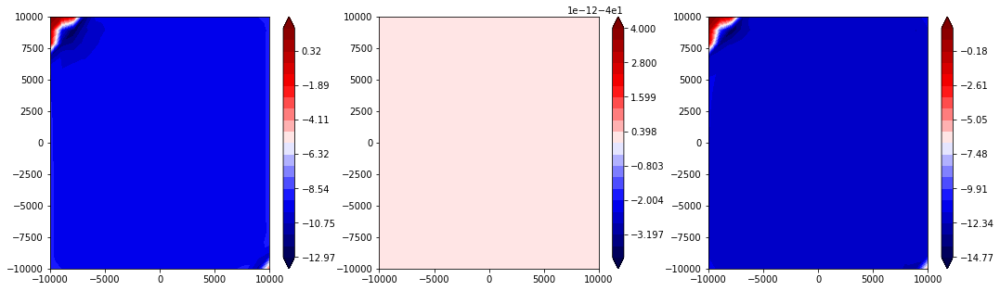

traction


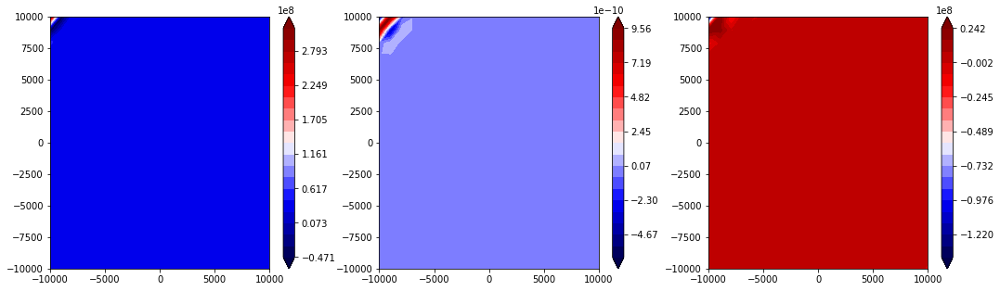

state


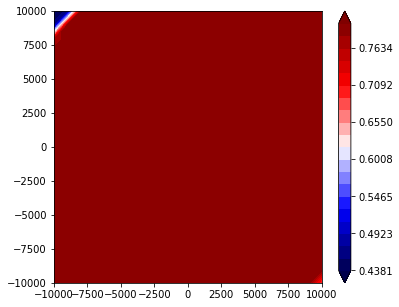

1161 37.154515907
1162 37.1545159071
1163 37.1545159073
1164 37.1545159073
1165 37.1545159074
1166 37.1545159075
1167 37.1545159076
1168 37.1545159077
1169 37.1545159078
1170 37.1545159079
V


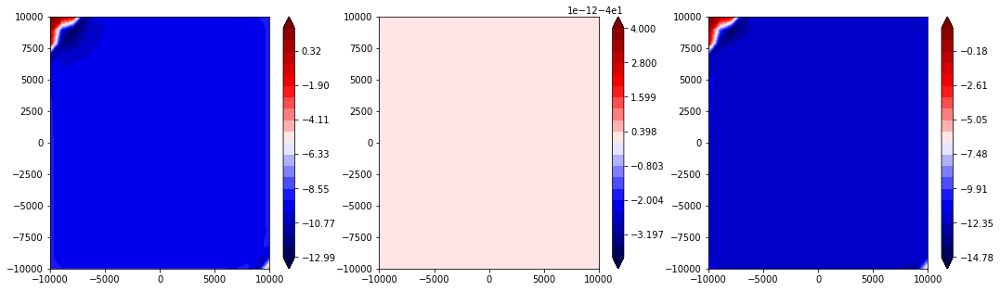

traction


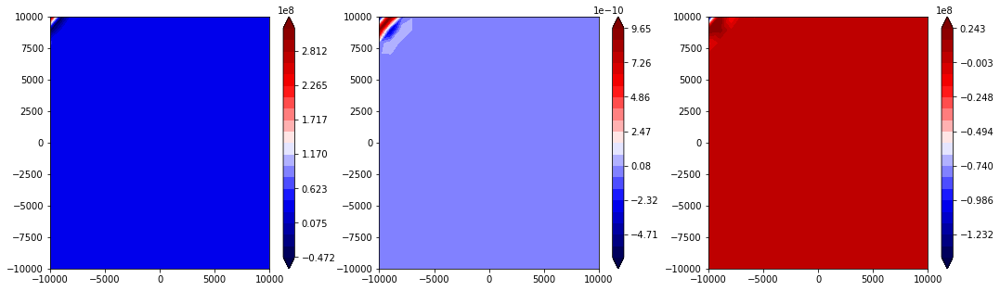

state


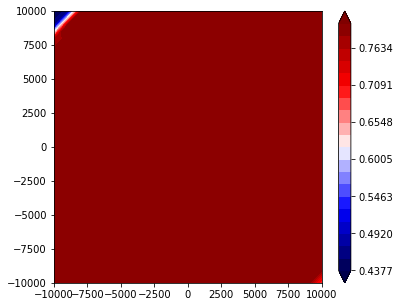

1171 37.154515908
1172 37.1545159081
1173 37.1545159082
1174 37.1545159082
1175 37.1545159084
1176 37.1545159084
1177 37.1545159085
1178 37.1545159087
1179 37.1545159087
1180 37.1545159088
V


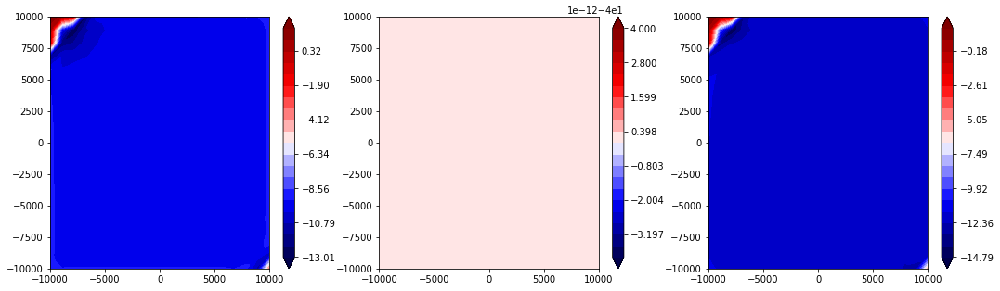

traction


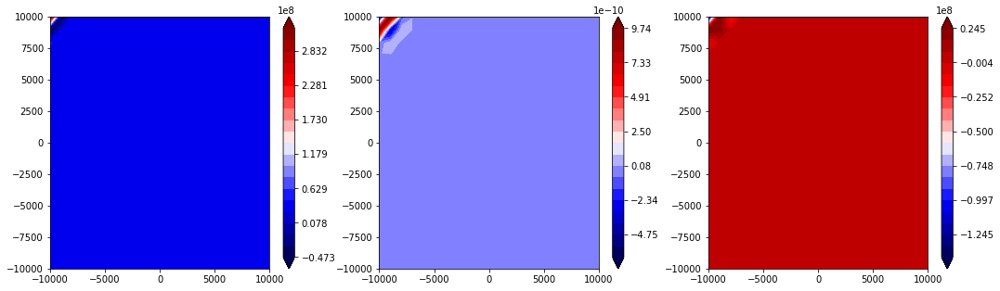

state


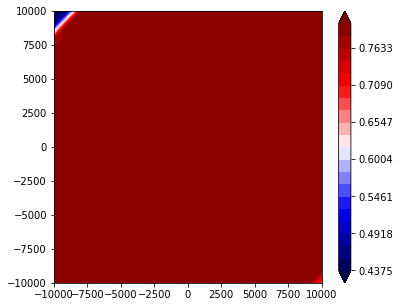

1181 37.154515909
1182 37.154515909
1183 37.1545159091
1184 37.1545159092
1185 37.1545159093
1186 37.1545159094
1187 37.1545159095
1188 37.1545159096
1189 37.1545159096
1190 37.1545159097
V


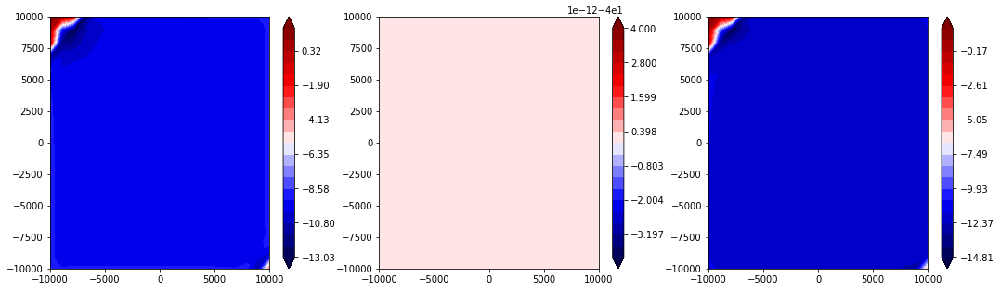

traction


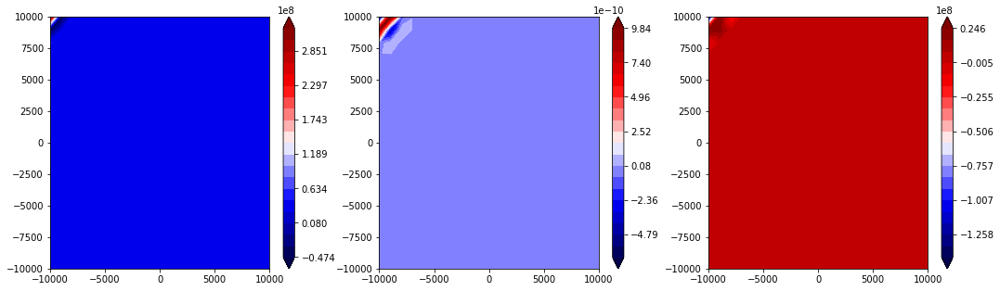

state


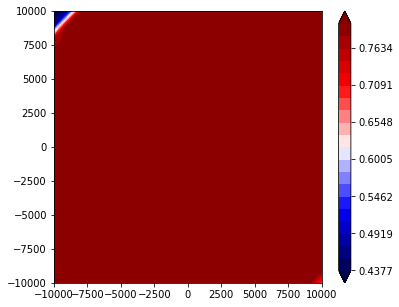

1191 37.1545159098
1192 37.15451591
1193 37.15451591
1194 37.1545159101
1195 37.1545159102
1196 37.1545159103
1197 37.1545159104
1198 37.1545159105
1199 37.1545159106
1200 37.1545159106
V


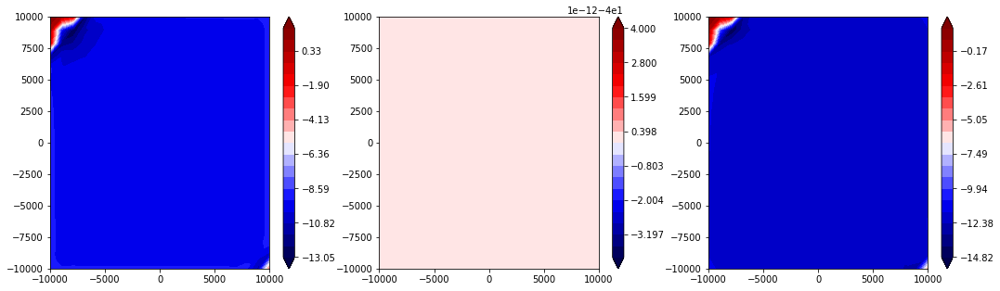

traction


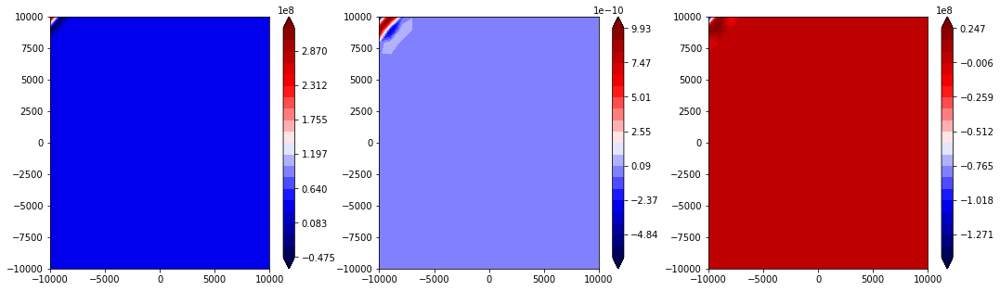

state


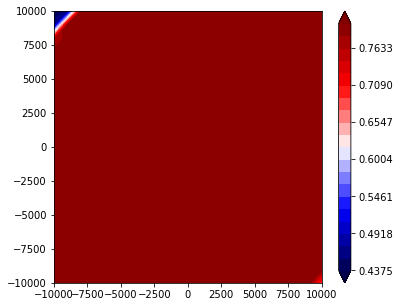

1201 37.1545159107
1202 37.1545159108
1203 37.154515911
1204 37.154515911
1205 37.1545159111
1206 37.1545159112
1207 37.1545159113
1208 37.1545159113
1209 37.1545159114
1210 37.1545159116
V


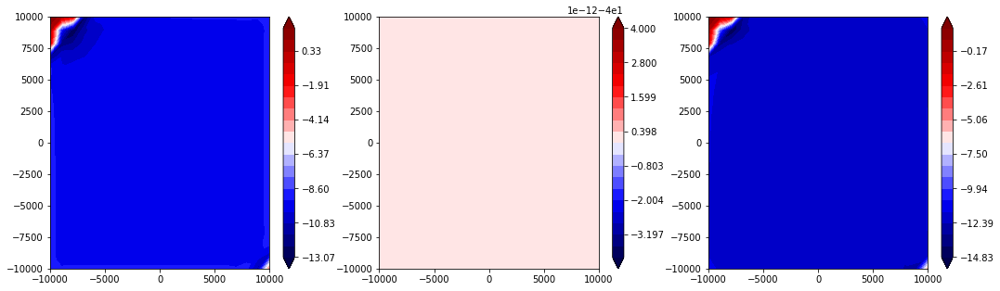

traction


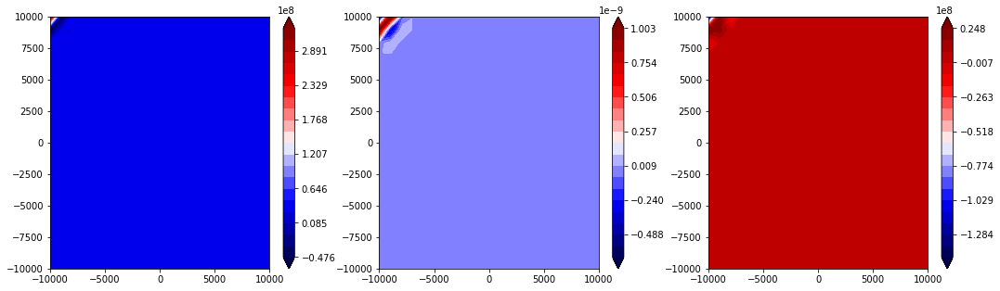

state


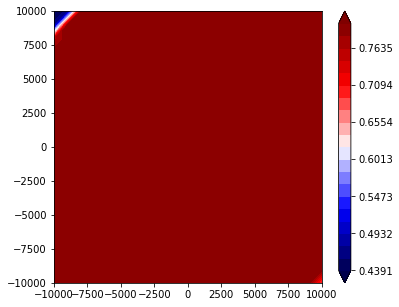

1211 37.1545159116
1212 37.1545159116
1213 37.1545159117
1214 37.1545159118
1215 37.1545159119
1216 37.1545159119
1217 37.154515912
1218 37.1545159121
1219 37.1545159122
1220 37.1545159123
V


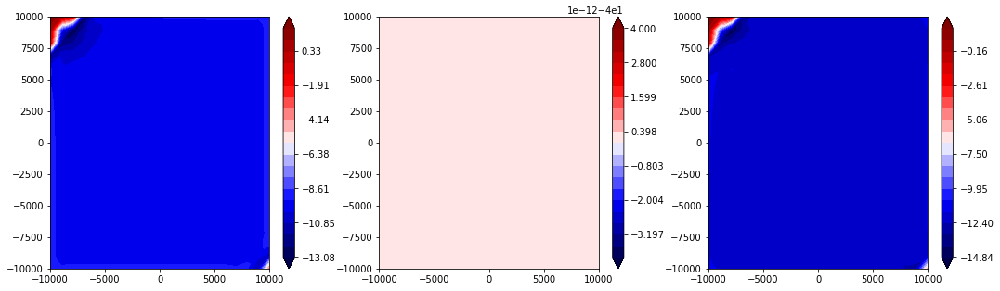

traction


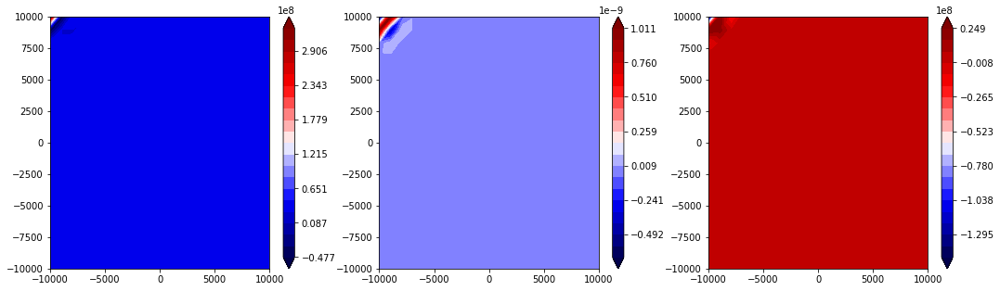

state


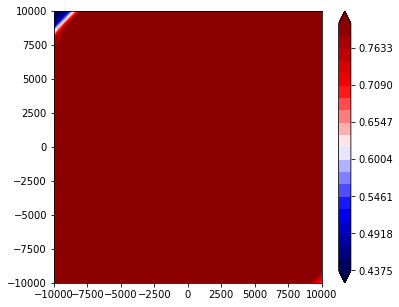

1221 37.1545159124
1222 37.1545159125
1223 37.1545159125
1224 37.1545159126
1225 37.1545159128
1226 37.1545159128
1227 37.1545159129
1228 37.154515913
1229 37.1545159131
1230 37.1545159131
V


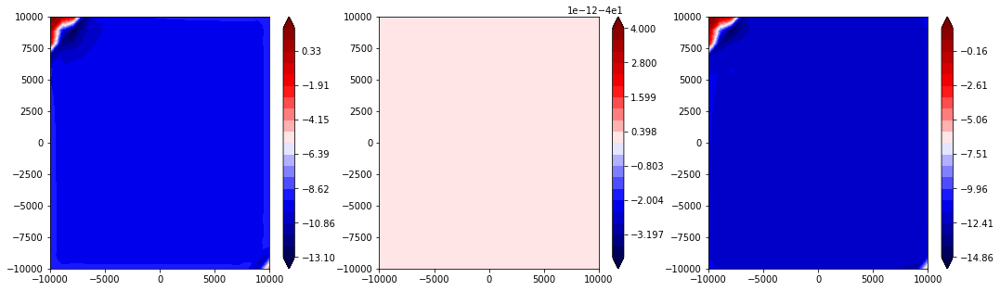

traction


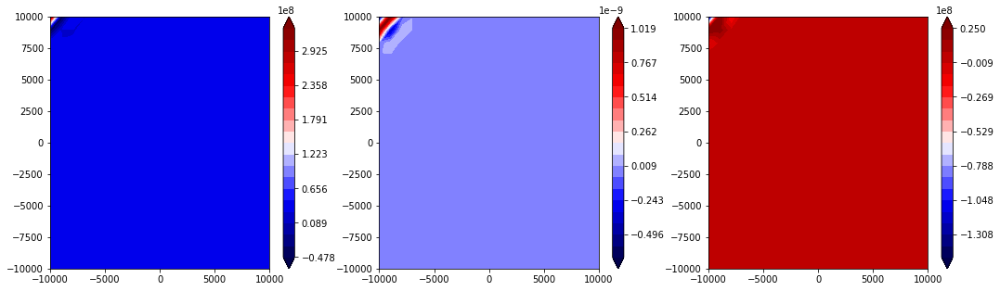

state


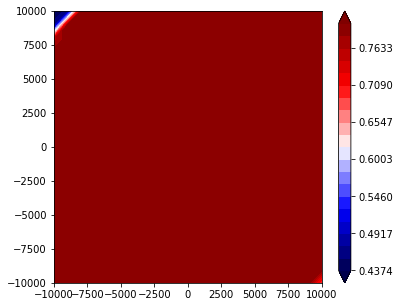

1231 37.1545159132
1232 37.1545159134
1233 37.1545159134
1234 37.1545159135
1235 37.1545159136
1236 37.1545159137
1237 37.1545159138
1238 37.1545159139
1239 37.1545159139
1240 37.154515914
V


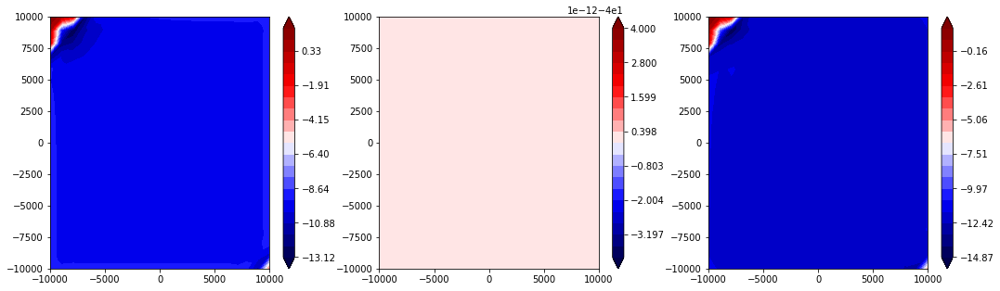

traction


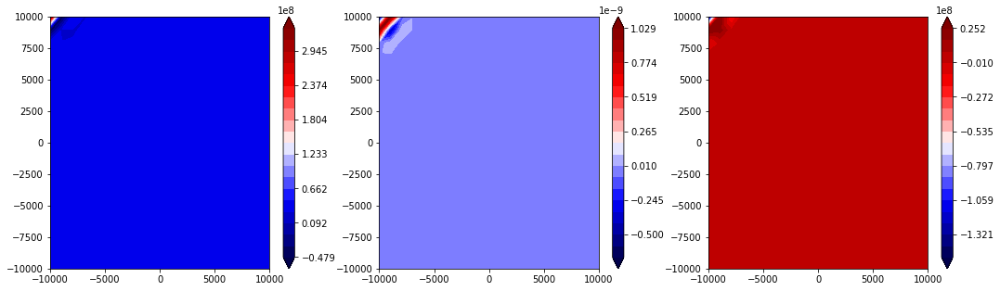

state


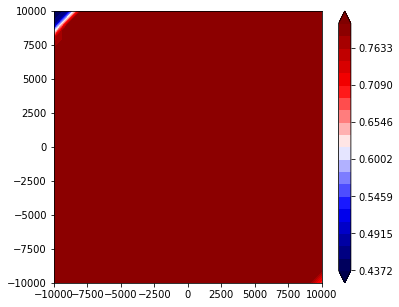

1241 37.1545159142
1242 37.1545159142
1243 37.1545159143
1244 37.1545159144
1245 37.1545159145
1246 37.1545159146
1247 37.1545159147
1248 37.1545159147
1249 37.1545159148
1250 37.154515915
V


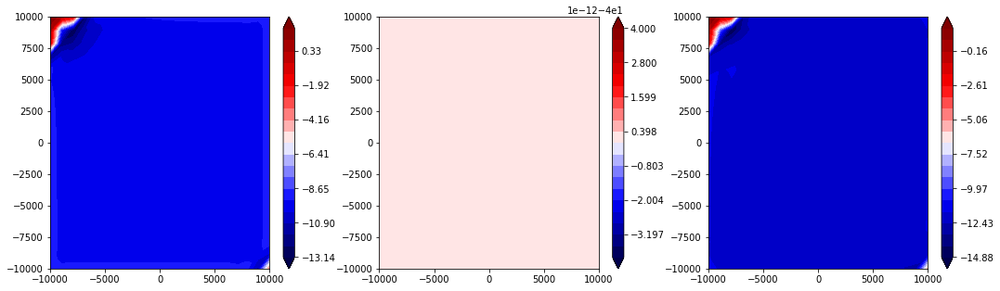

traction


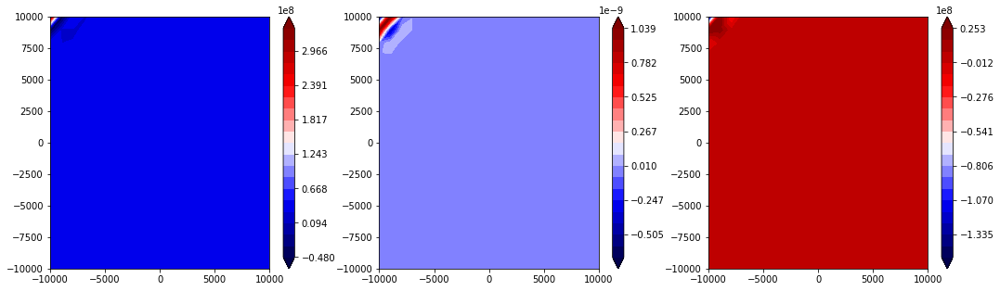

state


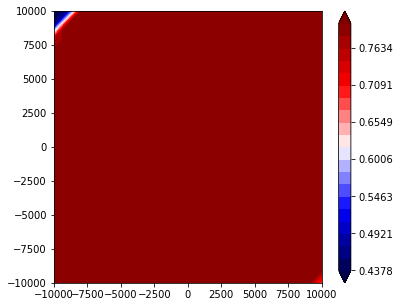

1251 37.154515915
1252 37.1545159151
1253 37.1545159152
1254 37.1545159153
1255 37.1545159153
1256 37.1545159155
1257 37.1545159155
1258 37.1545159156
1259 37.1545159157
1260 37.1545159158
V


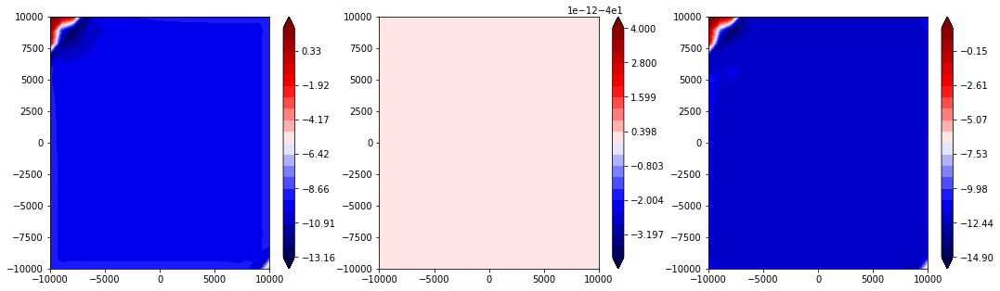

traction


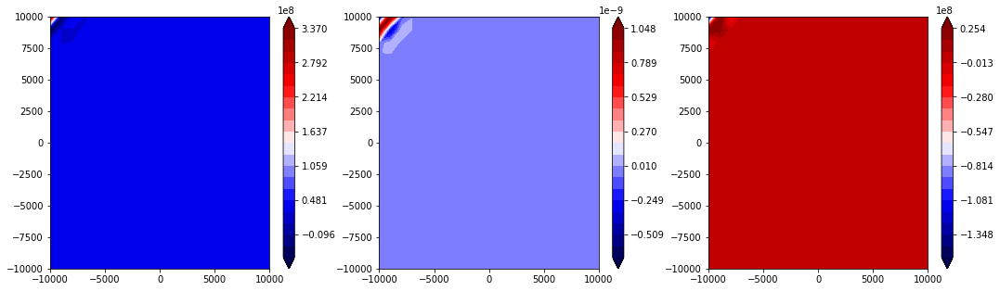

state


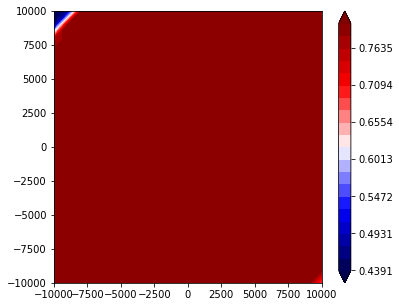

1261 37.1545159158
1262 37.1545159159
1263 37.1545159159
1264 37.154515916
1265 37.1545159161
1266 37.1545159162
1267 37.1545159163
1268 37.1545159164
1269 37.1545159164
1270 37.1545159165
V


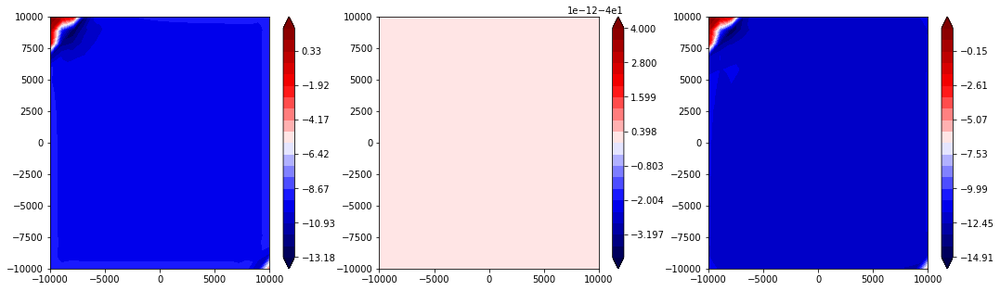

traction


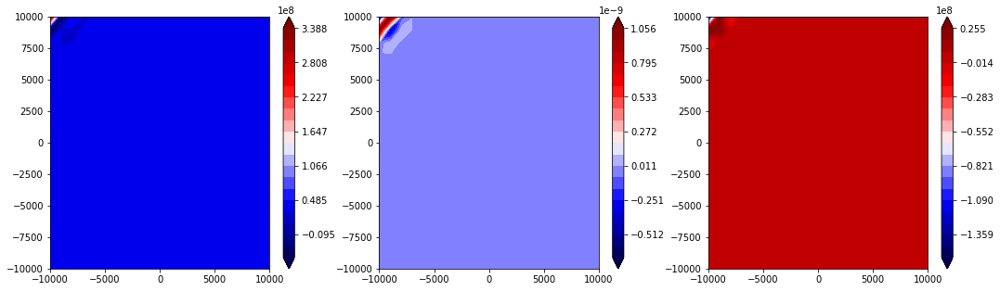

state


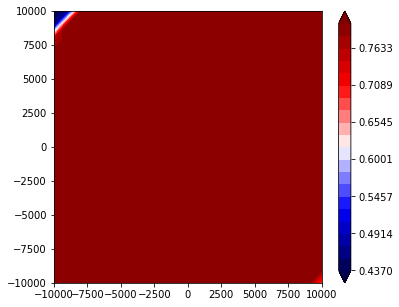

1271 37.1545159167
1272 37.1545159167
1273 37.1545159168
1274 37.1545159169
1275 37.154515917
1276 37.1545159171
1277 37.1545159172
1278 37.1545159172
1279 37.1545159173
1280 37.1545159175
V


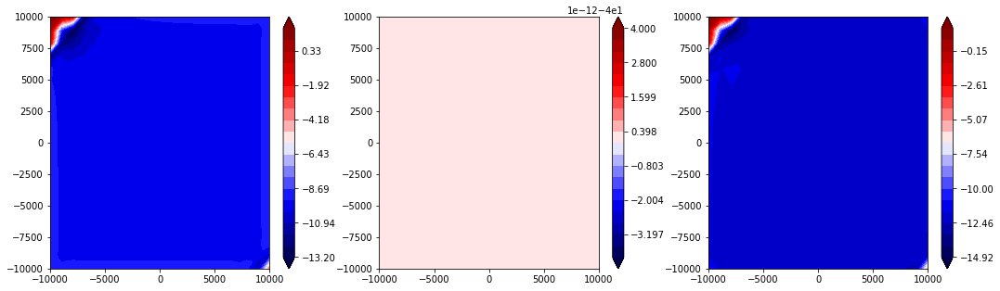

traction


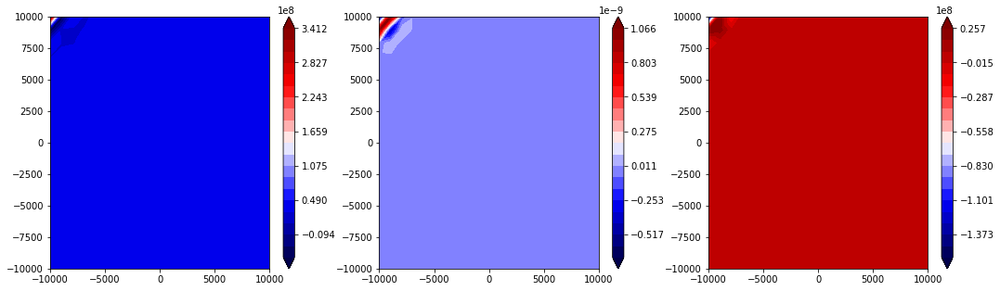

state


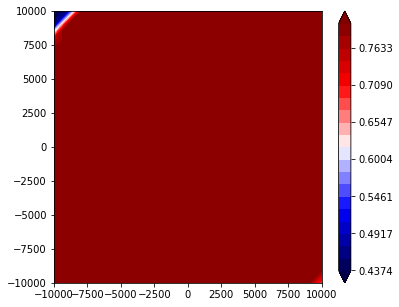

1281 37.1545159175
1282 37.1545159176
1283 37.1545159177
1284 37.1545159177
1285 37.1545159178
1286 37.154515918
1287 37.154515918
1288 37.1545159181
1289 37.1545159182
1290 37.1545159182
V


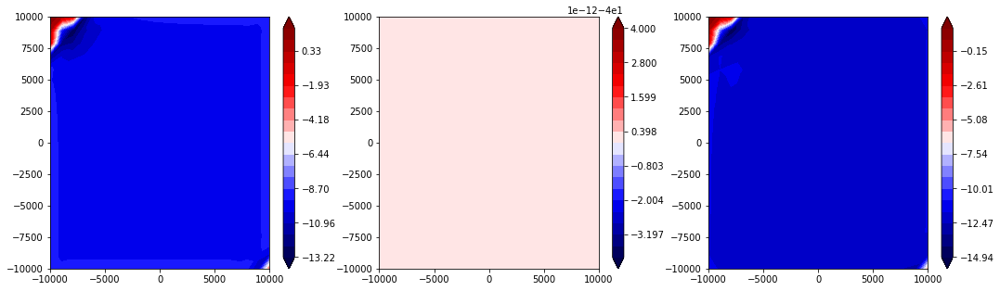

traction


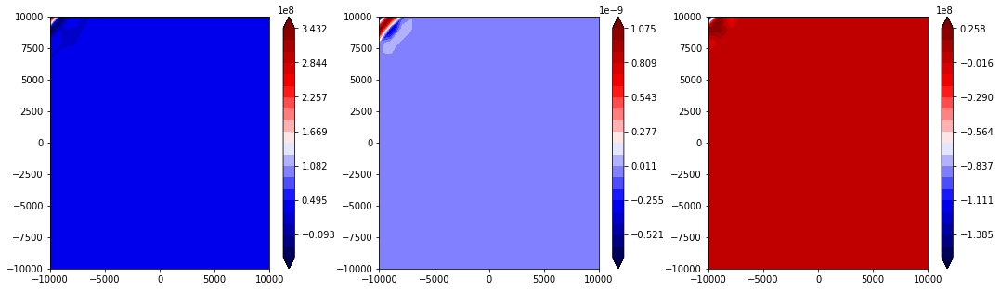

state


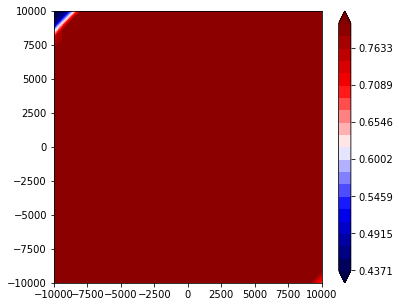

1291 37.1545159183
1292 37.1545159184
1293 37.1545159185
1294 37.1545159185
1295 37.1545159187
1296 37.1545159187
1297 37.1545159188
1298 37.1545159189
1299 37.154515919
1300 37.154515919
V


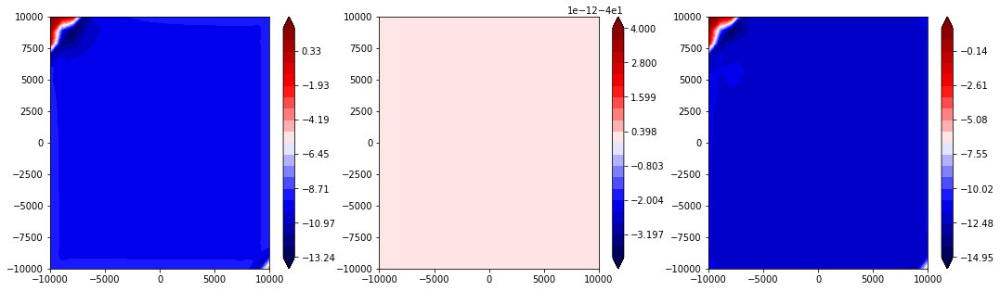

traction


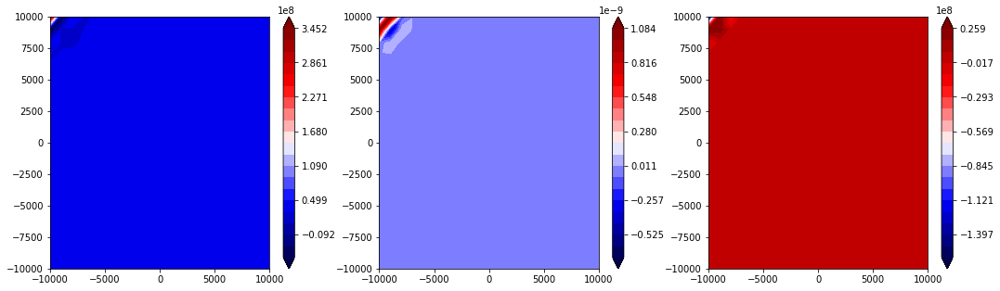

state


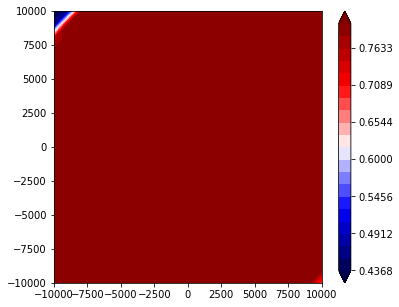

1301 37.1545159192
1302 37.1545159192
1303 37.1545159192
1304 37.1545159193
1305 37.1545159195
1306 37.1545159195
1307 37.1545159195
1308 37.1545159196
1309 37.1545159197
1310 37.1545159198
V


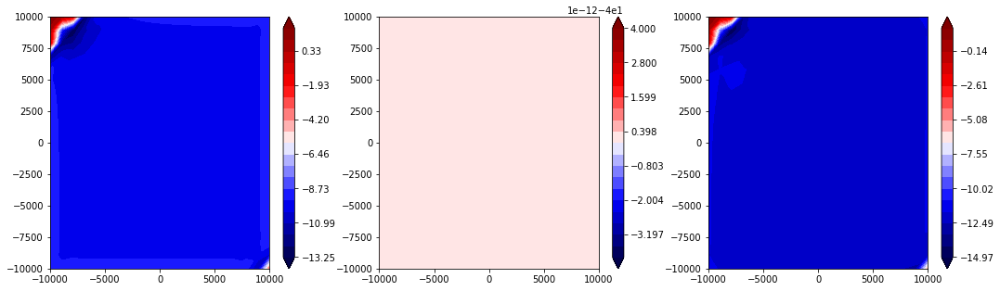

traction


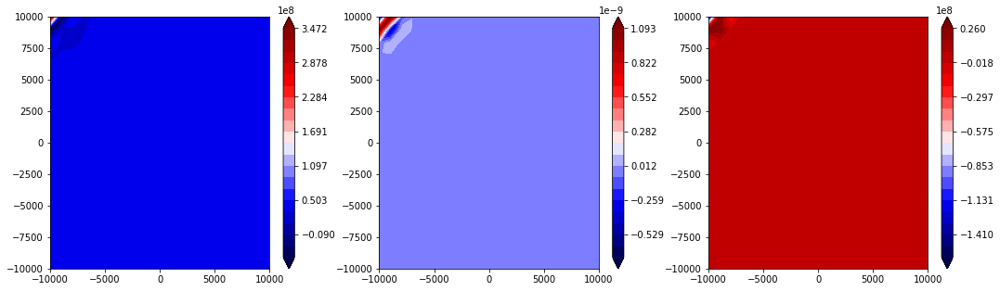

state


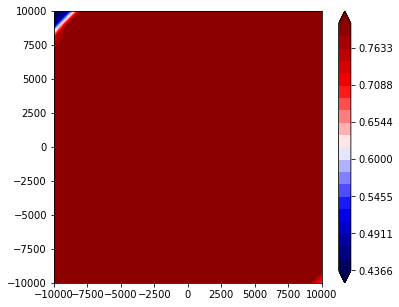

1311 37.1545159199
1312 37.15451592
1313 37.1545159201
1314 37.1545159202
1315 37.1545159202
1316 37.1545159203
1317 37.1545159204
1318 37.1545159205
1319 37.1545159206
1320 37.1545159207
V


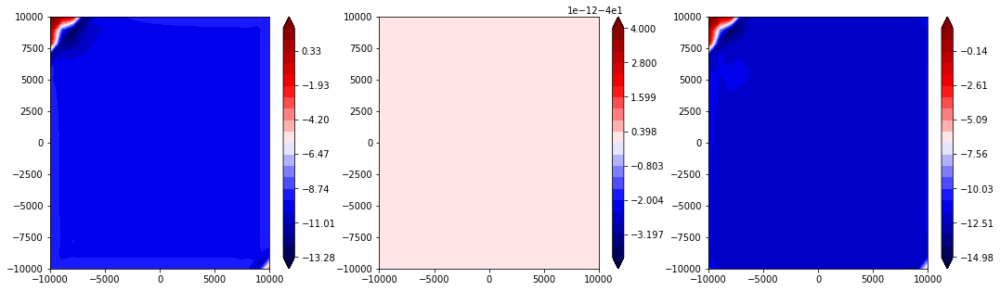

traction


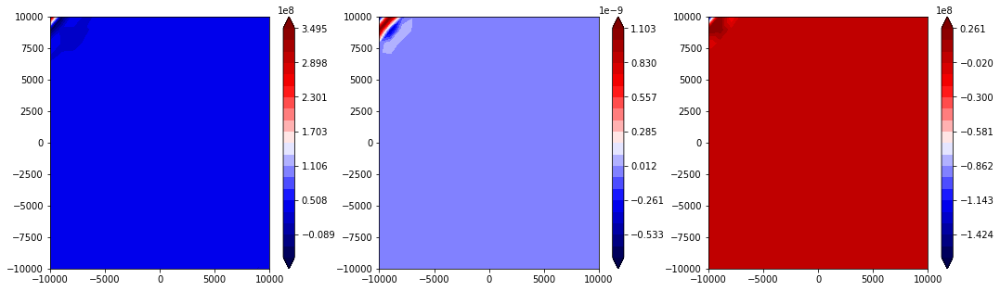

state


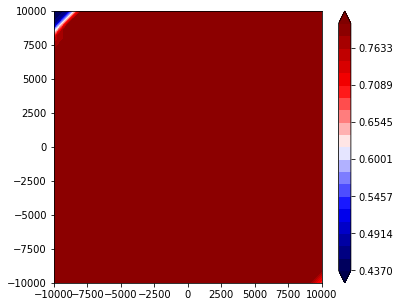

1321 37.1545159207
1322 37.1545159208
1323 37.154515921
1324 37.154515921
1325 37.154515921
1326 37.1545159211
1327 37.1545159212
1328 37.1545159212
1329 37.1545159213
1330 37.1545159214
V


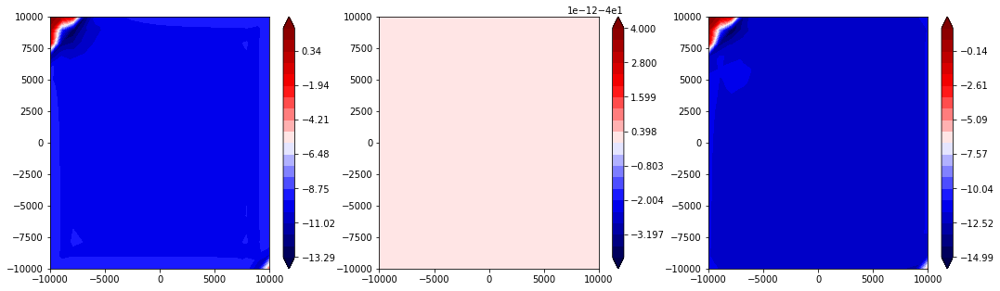

traction


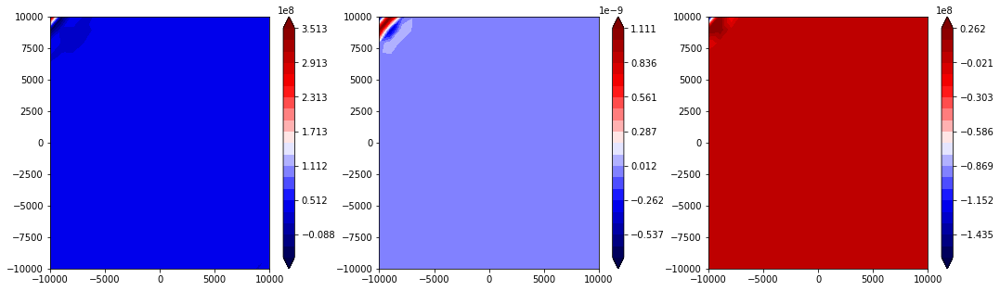

state


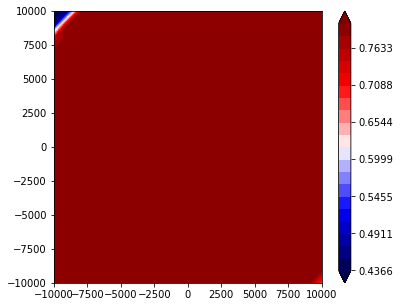

1331 37.1545159215
1332 37.1545159215
1333 37.1545159217
1334 37.1545159217
1335 37.1545159218
1336 37.1545159219
1337 37.1545159219
1338 37.154515922
1339 37.1545159221
1340 37.1545159221
V


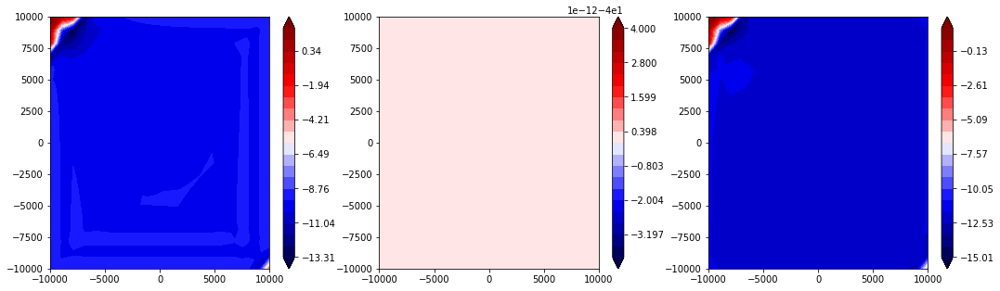

traction


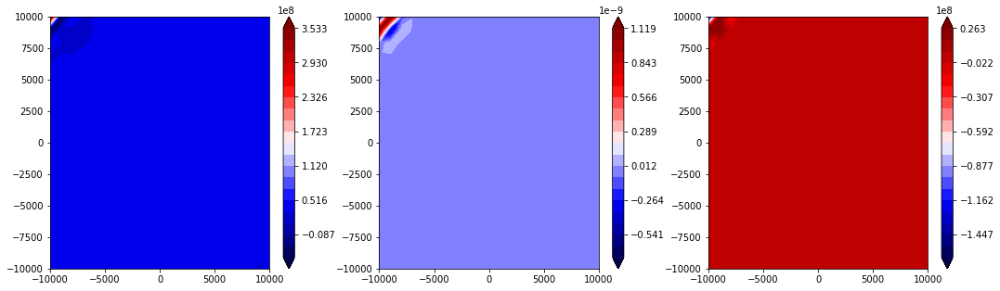

state


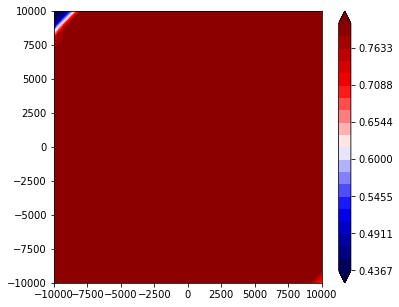

1341 37.1545159222
1342 37.1545159223
1343 37.1545159224
1344 37.1545159224
1345 37.1545159226
1346 37.1545159226
1347 37.1545159227
1348 37.1545159228
1349 37.1545159228
1350 37.1545159229
V


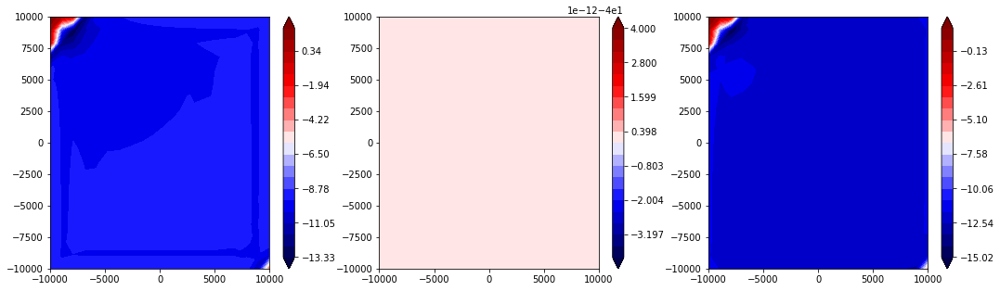

traction


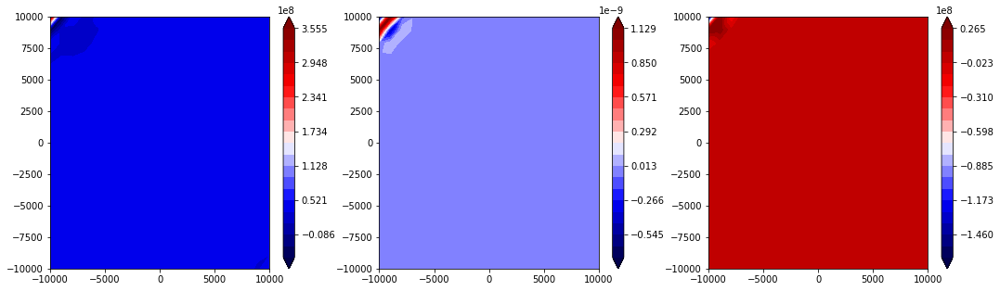

state


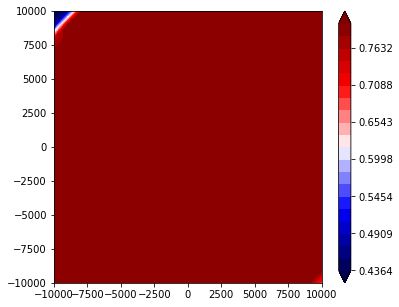

1351 37.1545159231
1352 37.1545159231
1353 37.1545159231
1354 37.1545159232
1355 37.1545159233
1356 37.1545159233
1357 37.1545159234
1358 37.1545159235
1359 37.1545159236
1360 37.1545159236
V


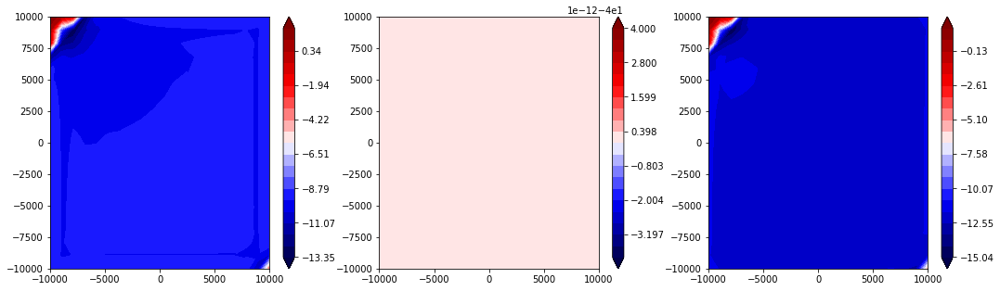

traction


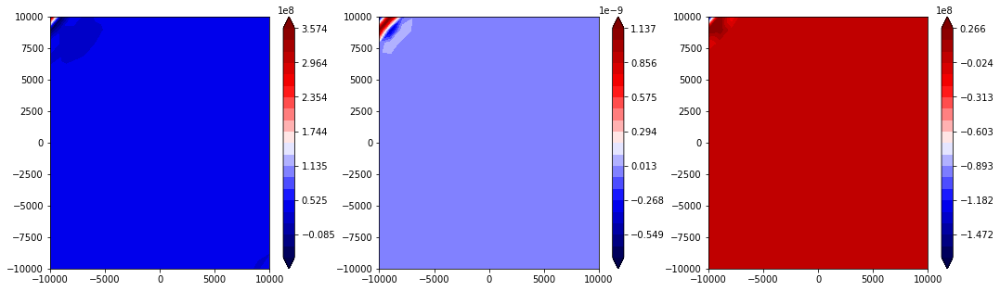

state


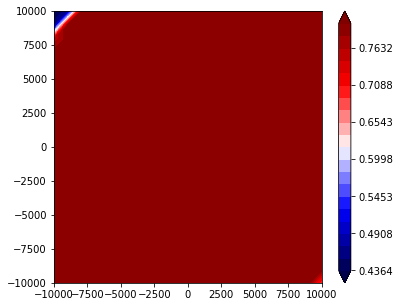

1361 37.1545159238
1362 37.1545159238
1363 37.1545159238
1364 37.154515924
1365 37.154515924
1366 37.1545159241
1367 37.1545159242
1368 37.1545159242
1369 37.1545159243
1370 37.1545159244
V


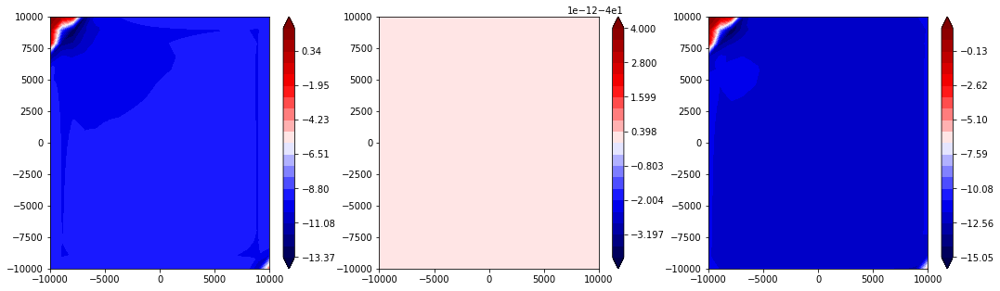

traction


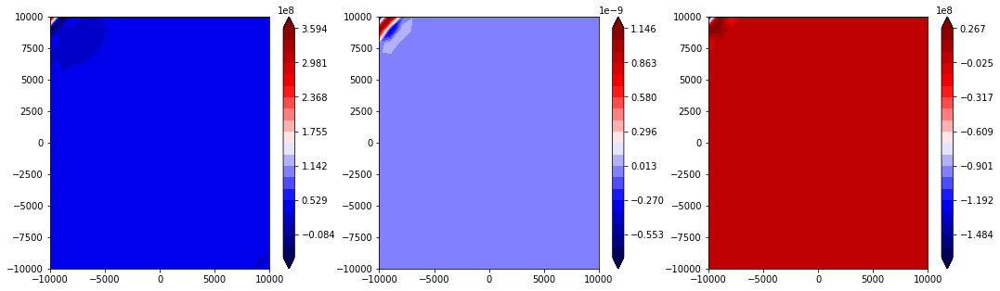

state


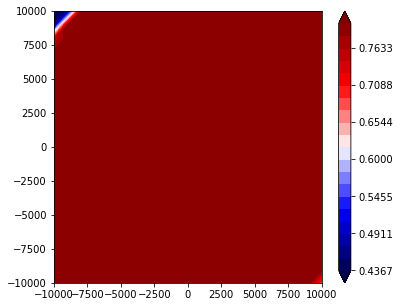

1371 37.1545159244
1372 37.1545159245
1373 37.1545159246
1374 37.1545159247
1375 37.1545159247
1376 37.1545159249
1377 37.1545159249
1378 37.154515925
1379 37.1545159251
1380 37.1545159252
V


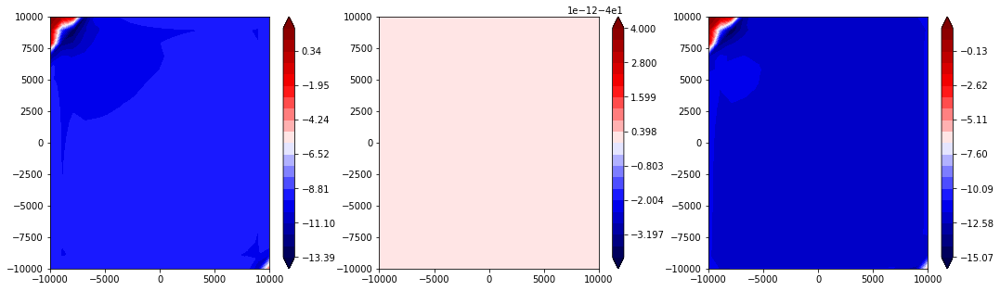

traction


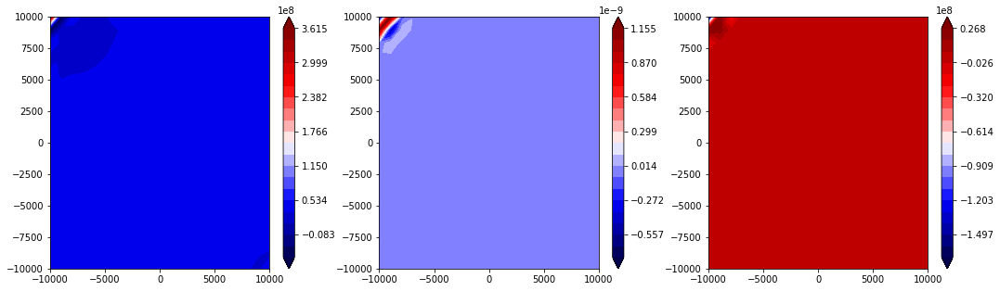

state


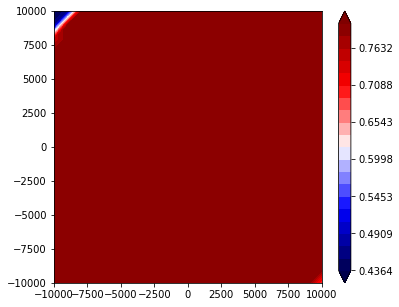

1381 37.1545159252
1382 37.1545159254
1383 37.1545159254
1384 37.1545159255
1385 37.1545159256
1386 37.1545159256
1387 37.1545159257
1388 37.1545159258
1389 37.1545159259
1390 37.1545159259
V


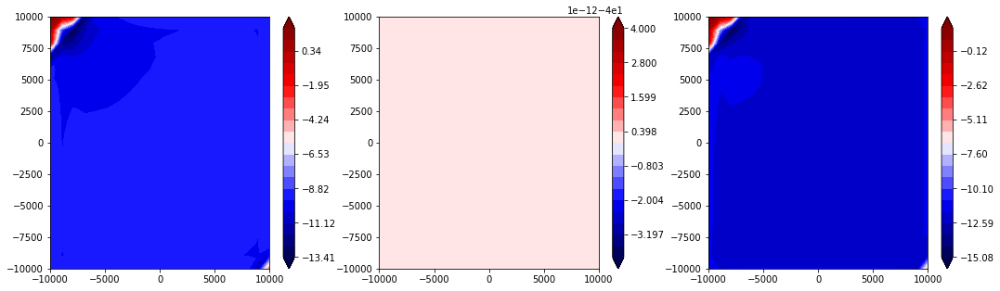

traction


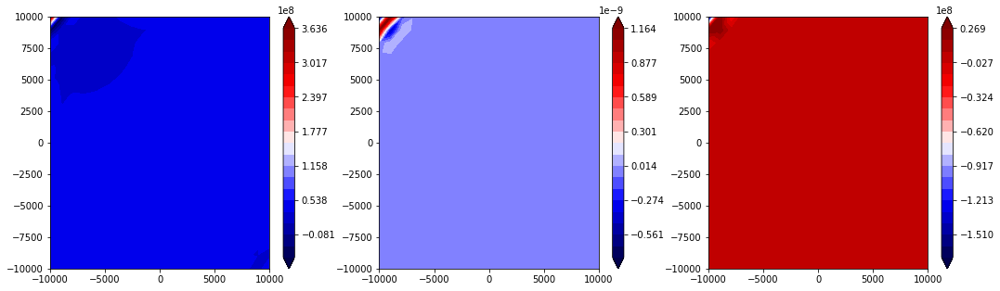

state


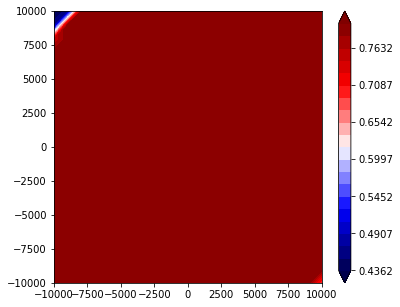

1391 37.154515926
1392 37.1545159261
1393 37.1545159262
1394 37.1545159263
1395 37.1545159264
1396 37.1545159265
1397 37.1545159265
1398 37.1545159266
1399 37.1545159267
1400 37.1545159267
V


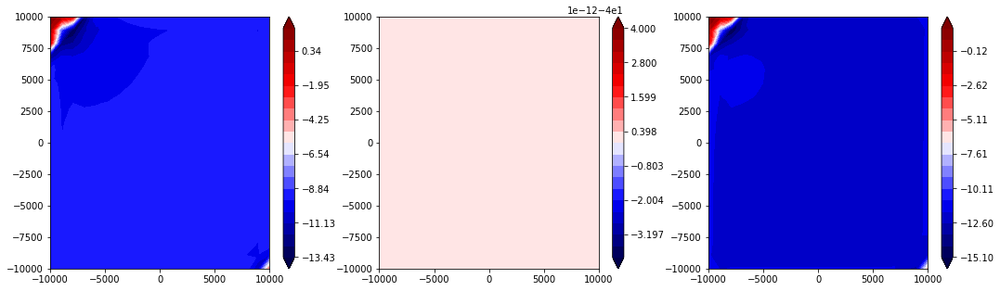

traction


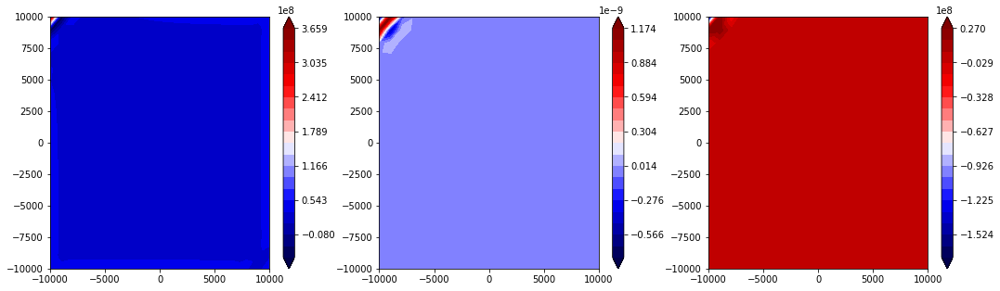

state


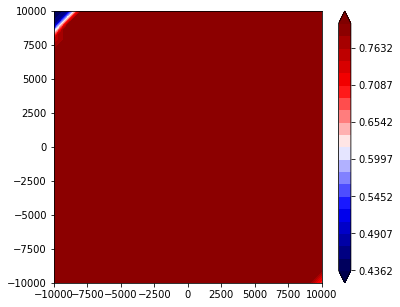

1401 37.1545159268
1402 37.154515927
1403 37.154515927
1404 37.154515927
1405 37.1545159271
1406 37.1545159272
1407 37.1545159272
1408 37.1545159272
1409 37.1545159273
1410 37.1545159275
V


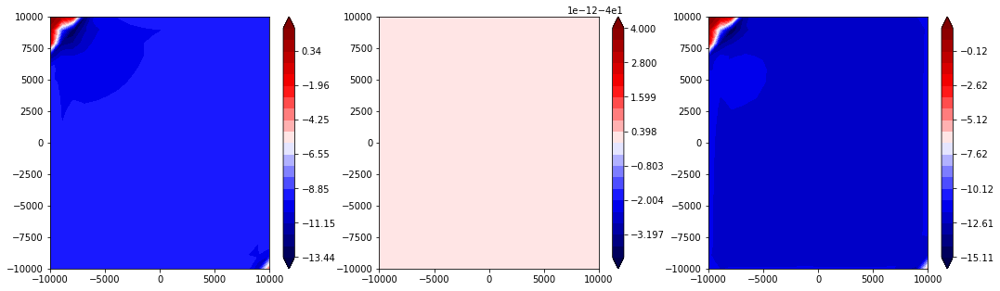

traction


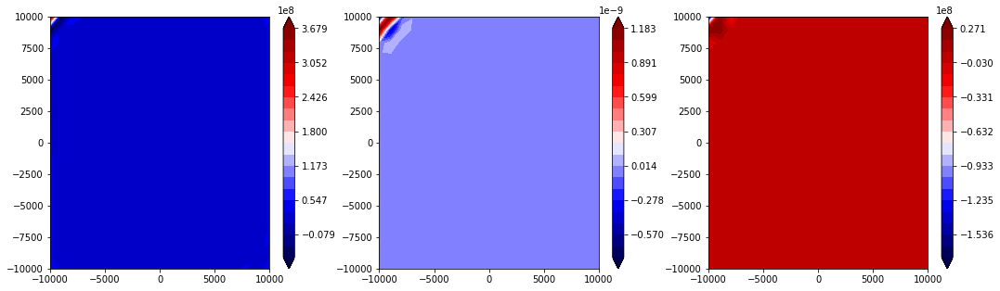

state


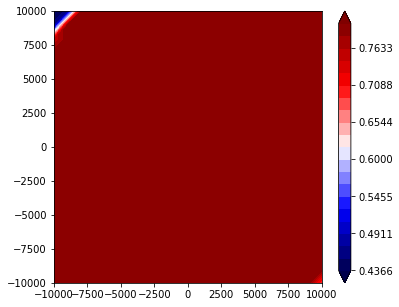

1411 37.1545159275
1412 37.1545159275
1413 37.1545159277
1414 37.1545159277
1415 37.1545159278
1416 37.1545159279
1417 37.1545159279
1418 37.154515928
1419 37.1545159282
1420 37.1545159282
V


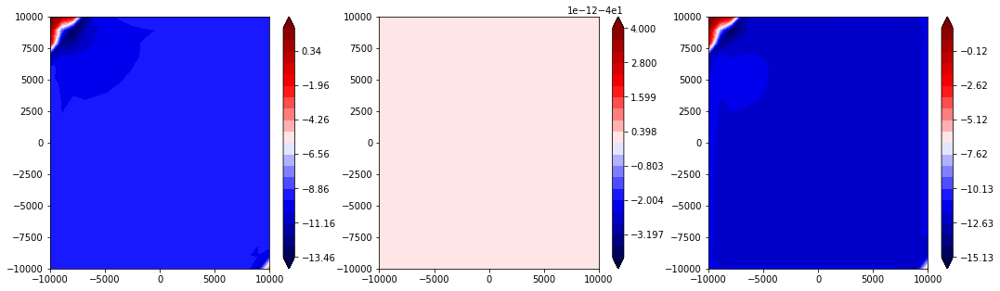

traction


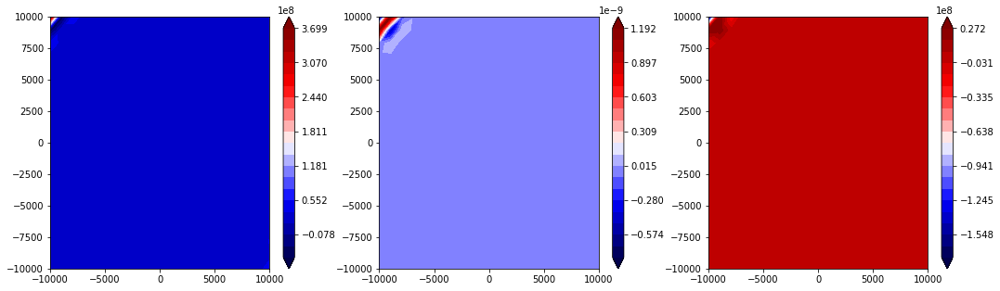

state


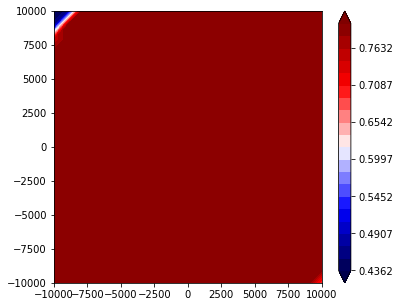

1421 37.1545159283
1422 37.1545159284
1423 37.1545159284
1424 37.1545159285
1425 37.1545159286
1426 37.1545159286
1427 37.1545159287
1428 37.1545159289
1429 37.1545159289
1430 37.154515929
V


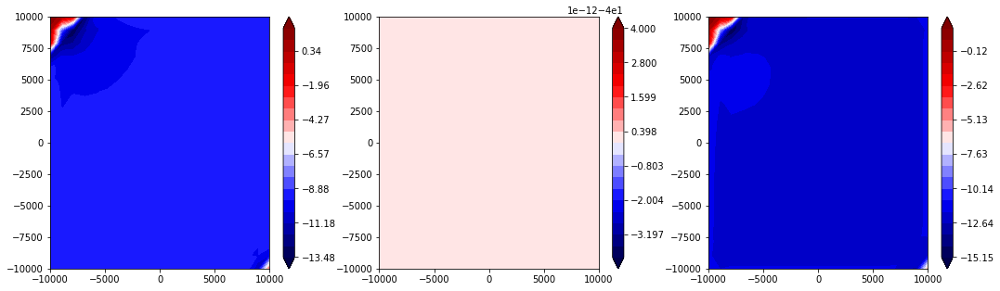

traction


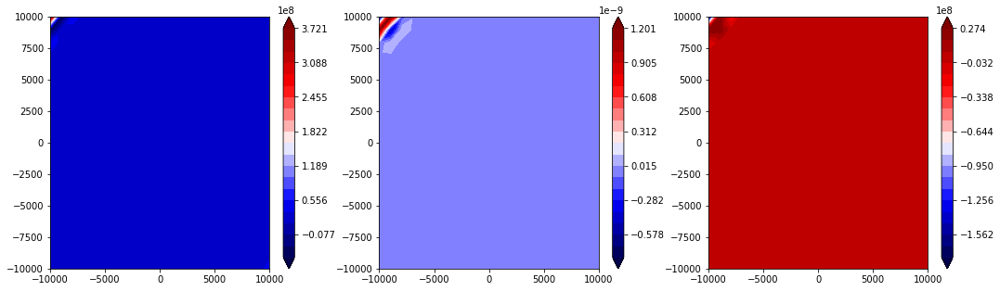

state


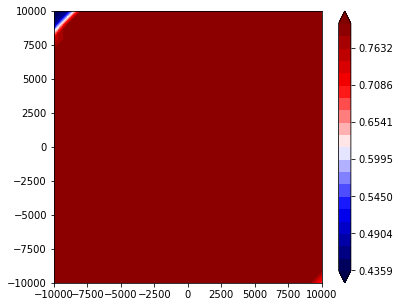

1431 37.1545159291
1432 37.1545159291
1433 37.1545159292
1434 37.1545159293
1435 37.1545159294
1436 37.1545159294
1437 37.1545159294
1438 37.1545159296
1439 37.1545159296
1440 37.1545159296
V


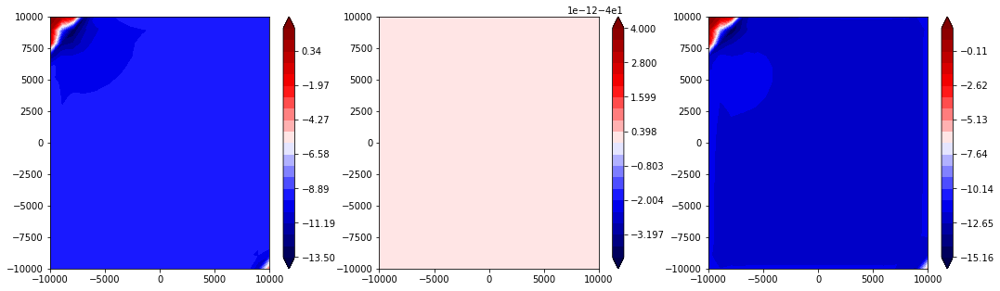

traction


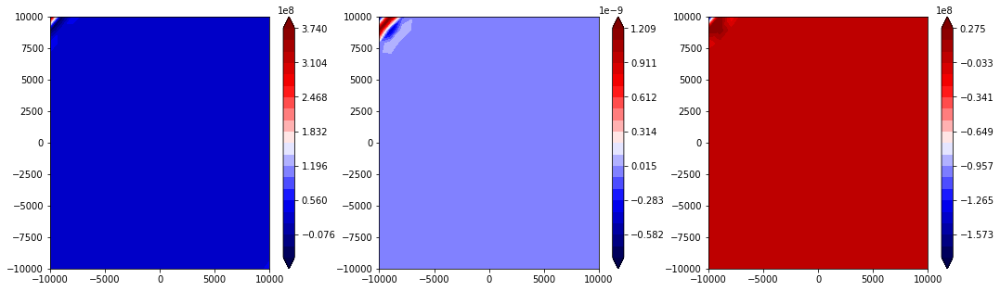

state


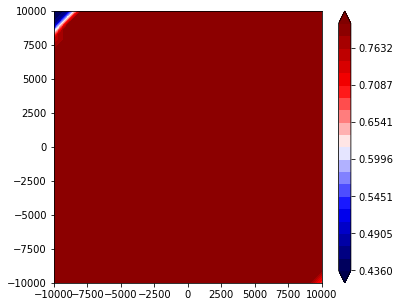

1441 37.1545159297
1442 37.1545159298
1443 37.1545159299
1444 37.15451593
1445 37.15451593
1446 37.1545159301
1447 37.1545159301
1448 37.1545159302
1449 37.1545159303
1450 37.1545159304
V


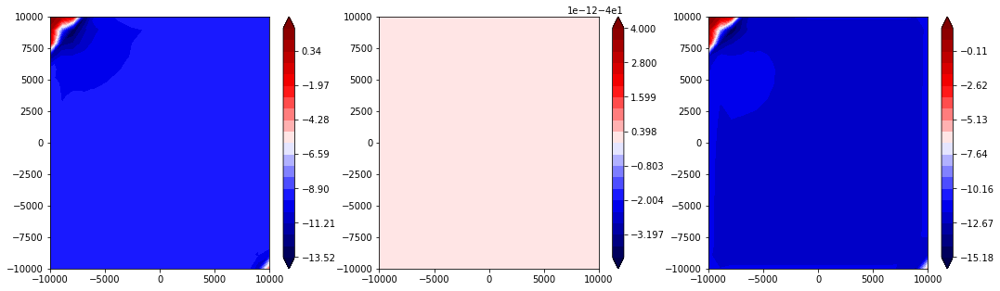

traction


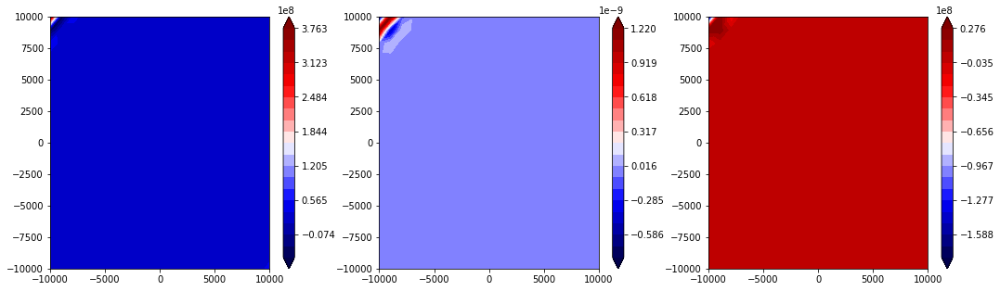

state


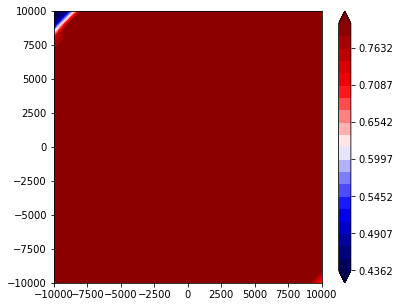

1451 37.1545159305
1452 37.1545159305
1453 37.1545159307
1454 37.1545159307
1455 37.1545159307
1456 37.1545159308
1457 37.1545159309
1458 37.154515931
1459 37.154515931
1460 37.1545159312
V


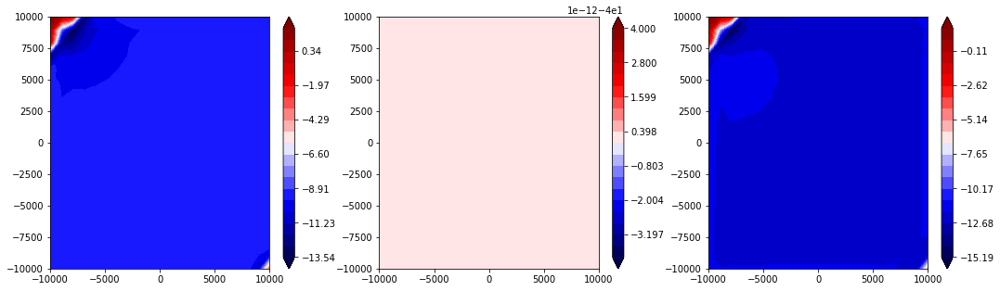

traction


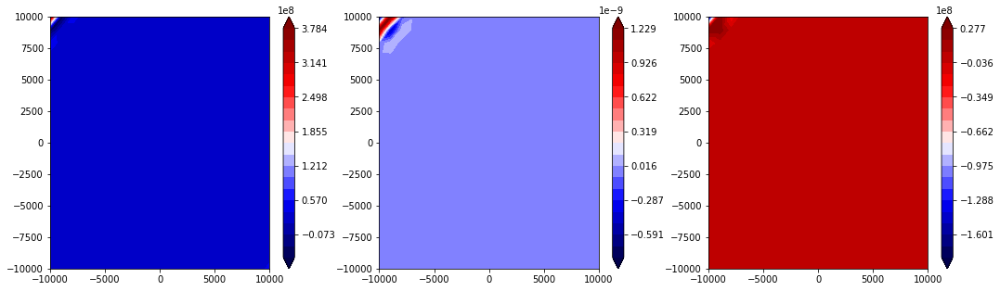

state


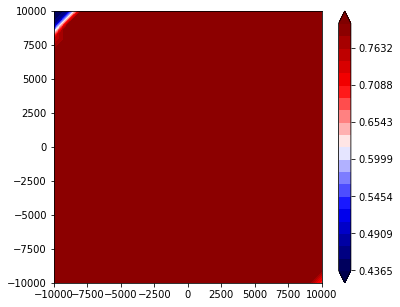

1461 37.1545159312
1462 37.1545159313
1463 37.1545159314
1464 37.1545159314
1465 37.1545159315
1466 37.1545159316
1467 37.1545159316
1468 37.1545159317
1469 37.1545159318
1470 37.1545159319
V


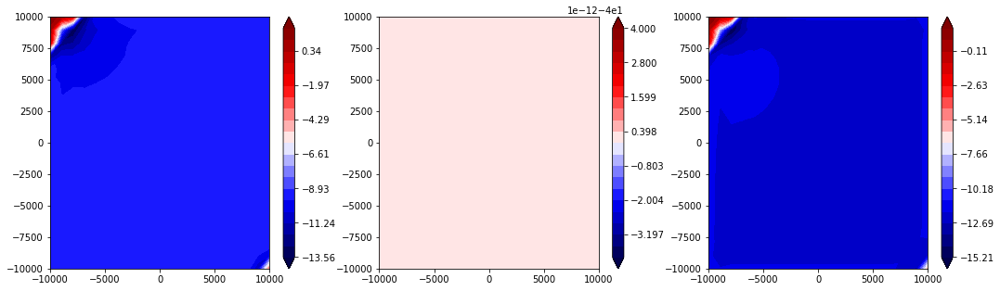

traction


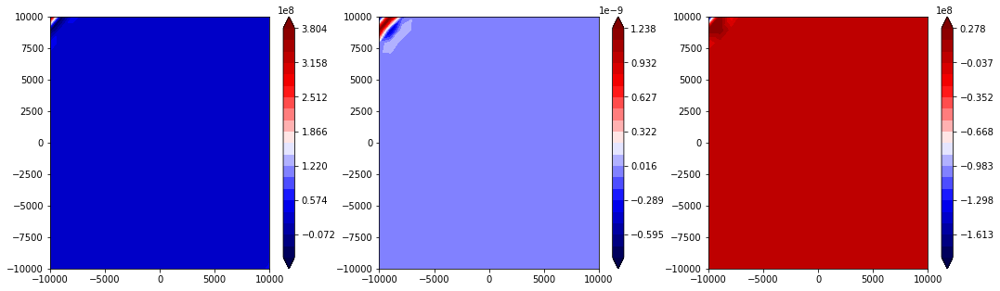

state


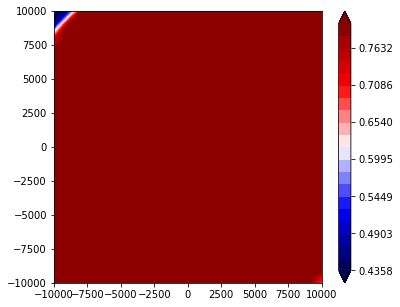

1471 37.154515932
1472 37.1545159321
1473 37.1545159321
1474 37.1545159322
1475 37.1545159323
1476 37.1545159323
1477 37.1545159324
1478 37.1545159325
1479 37.1545159325
1480 37.1545159326
V


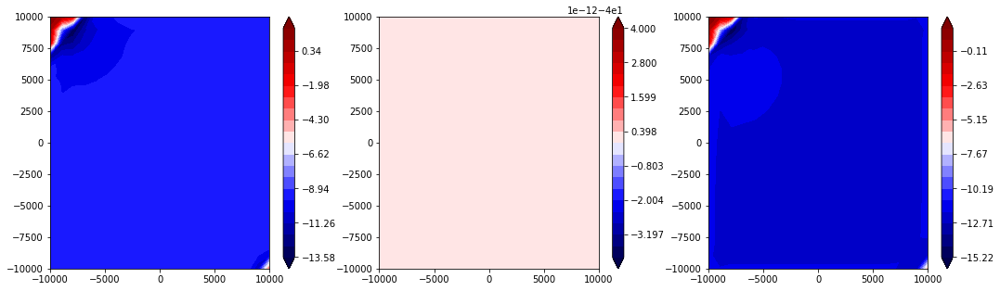

traction


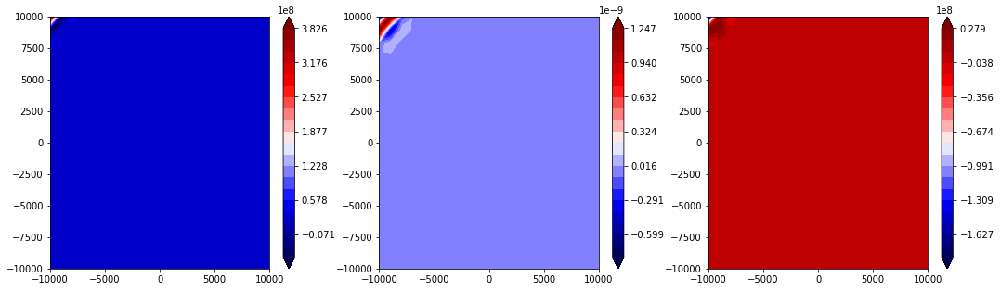

state


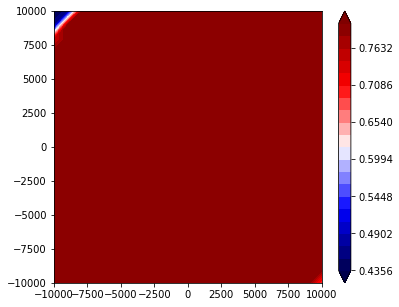

1481 37.1545159327
1482 37.1545159328
1483 37.1545159329
1484 37.154515933
1485 37.154515933
1486 37.154515933
1487 37.1545159332
1488 37.1545159332
1489 37.1545159332
1490 37.1545159333
V


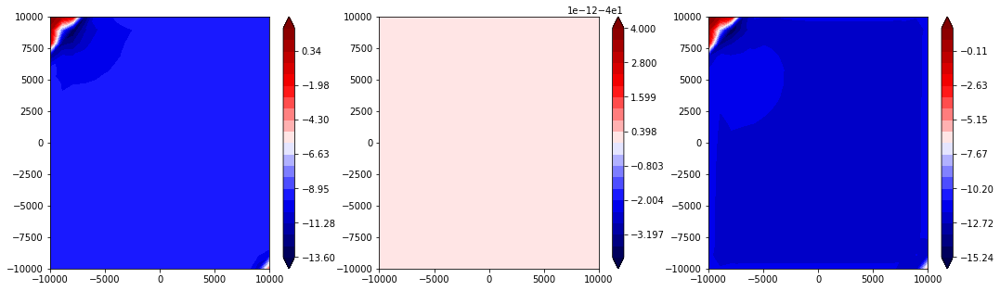

traction


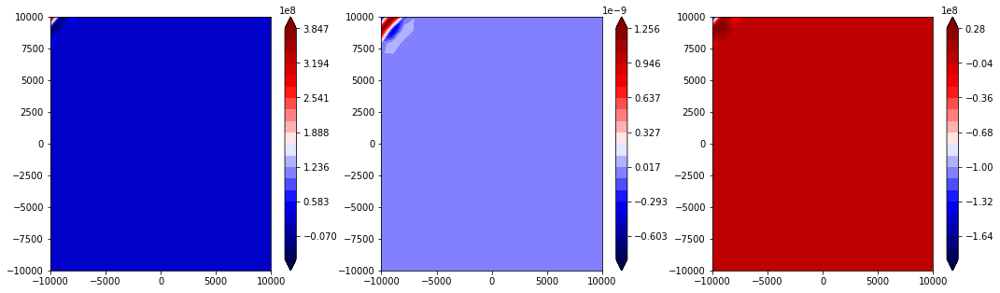

state


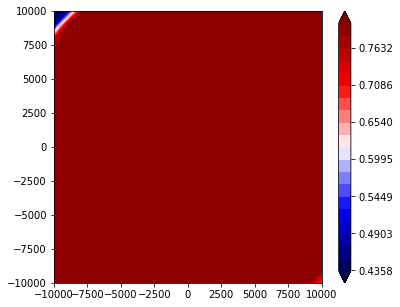

1491 37.1545159334
1492 37.1545159335
1493 37.1545159335
1494 37.1545159336
1495 37.1545159338
1496 37.1545159338
1497 37.1545159338
1498 37.1545159339
1499 37.154515934
1500 37.154515934
V


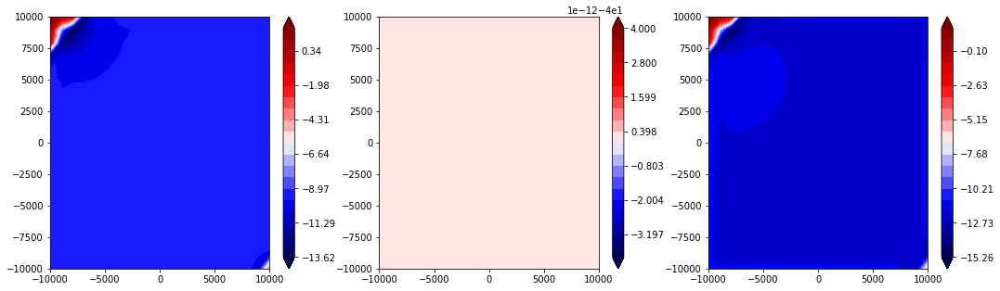

traction


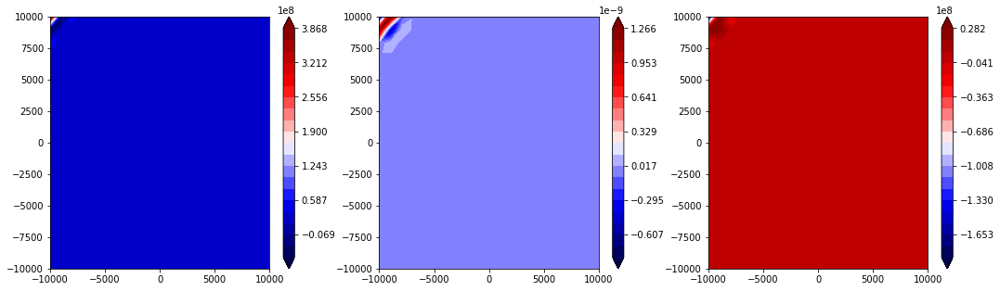

state


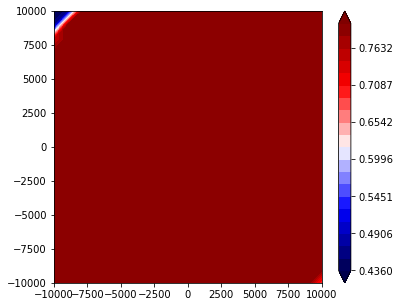

1501 37.1545159341
1502 37.1545159342
1503 37.1545159342
1504 37.1545159344
1505 37.1545159344
1506 37.1545159344
1507 37.1545159345
1508 37.1545159346
1509 37.1545159346
1510 37.1545159347
V


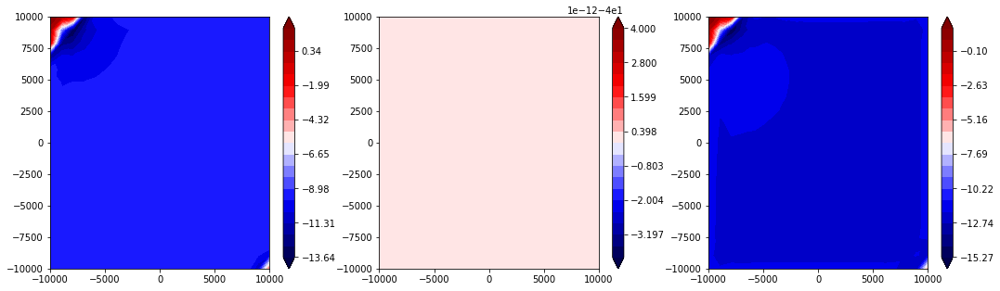

traction


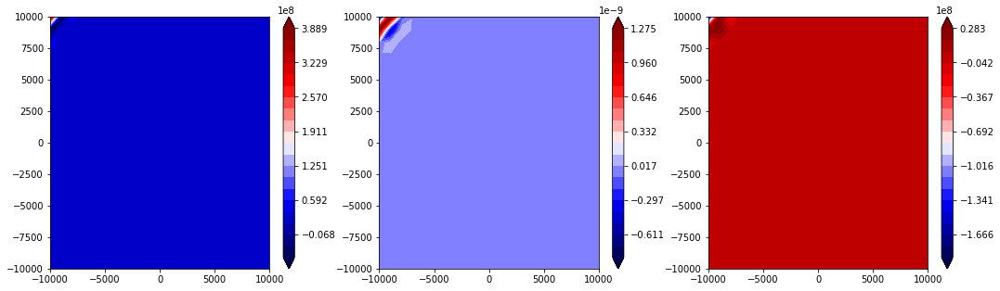

state


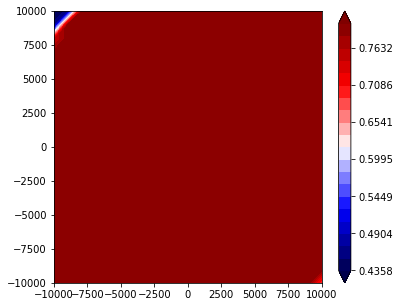

1511 37.1545159348
1512 37.1545159349
1513 37.154515935
1514 37.154515935
1515 37.1545159351
1516 37.1545159352
1517 37.1545159352
1518 37.1545159353
1519 37.1545159354
1520 37.1545159354
V


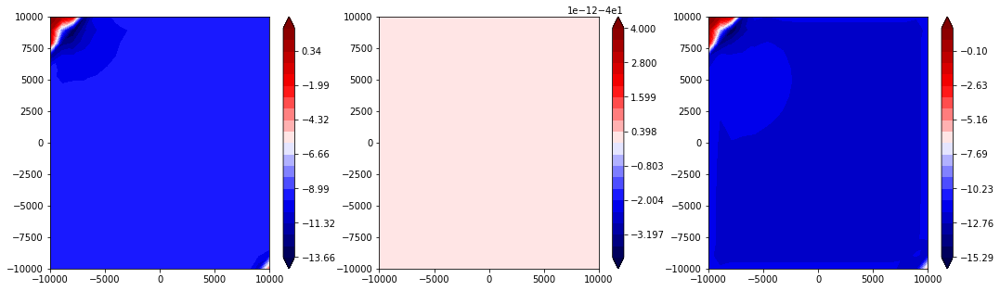

traction


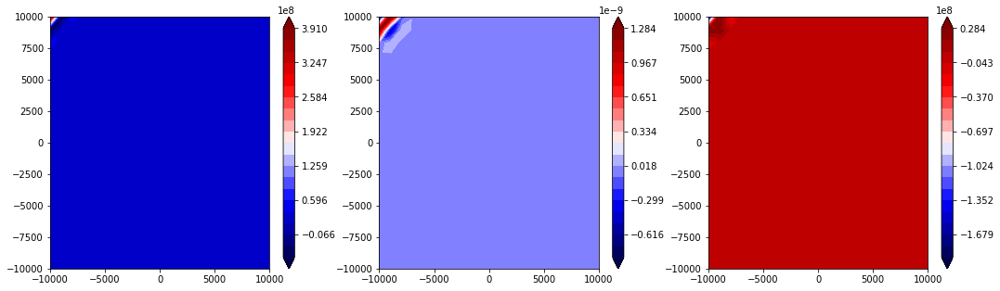

state


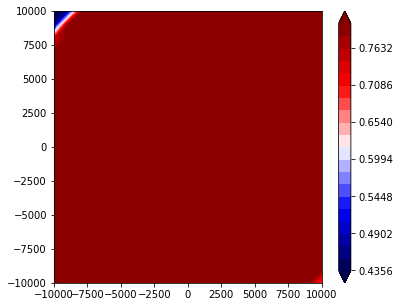

1521 37.1545159355
1522 37.1545159356
1523 37.1545159357
1524 37.1545159357
1525 37.1545159359
1526 37.1545159359
1527 37.154515936
1528 37.1545159361
1529 37.1545159361
1530 37.1545159362
V


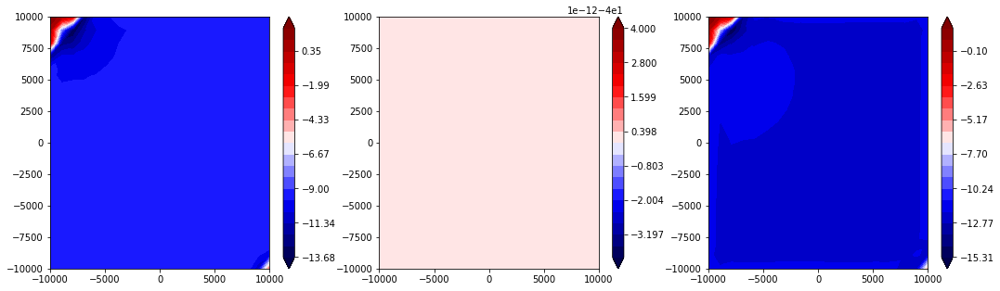

traction


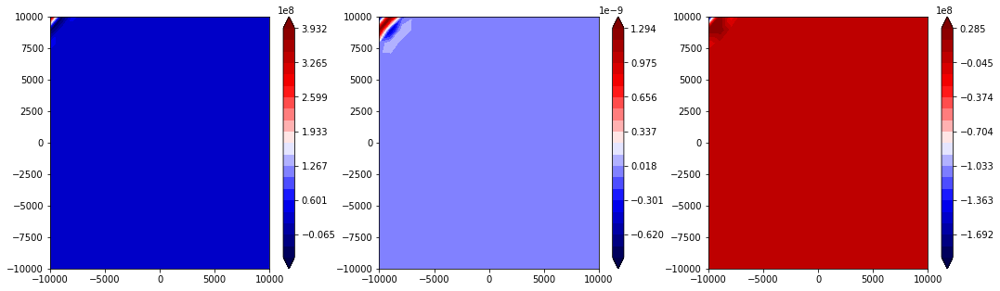

state


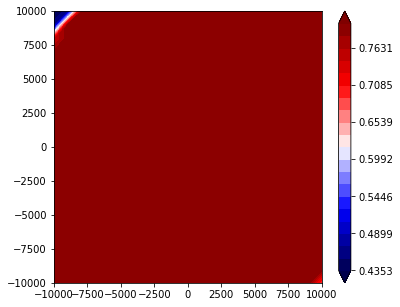

1531 37.1545159363
1532 37.1545159363
1533 37.1545159364
1534 37.1545159365
1535 37.1545159366
1536 37.1545159366
1537 37.1545159367
1538 37.1545159368
1539 37.1545159368
1540 37.1545159369
V


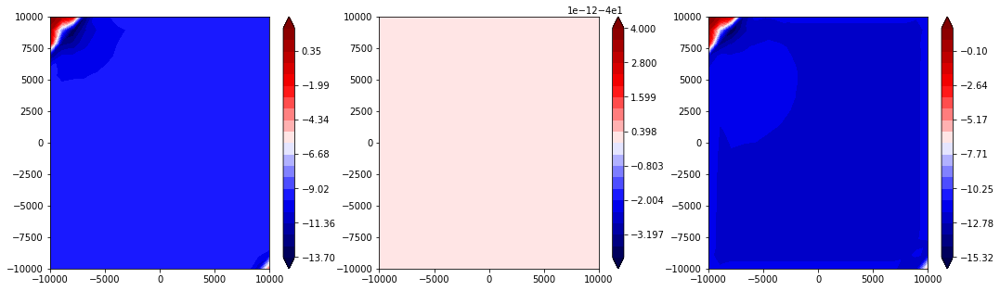

traction


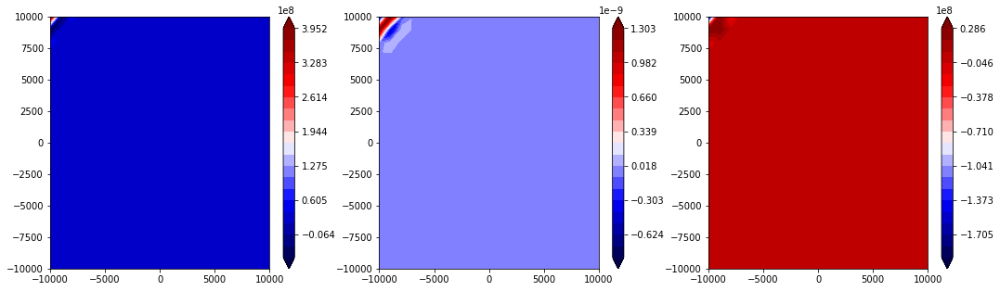

state


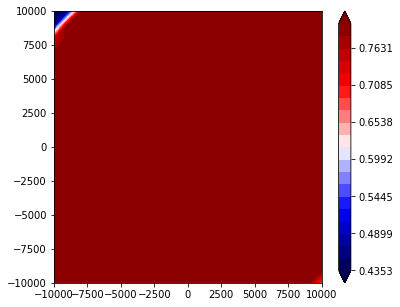

1541 37.154515937
1542 37.154515937
1543 37.1545159371
1544 37.1545159372
1545 37.1545159372
1546 37.1545159373
1547 37.1545159374
1548 37.1545159374
1549 37.1545159375
1550 37.1545159376
V


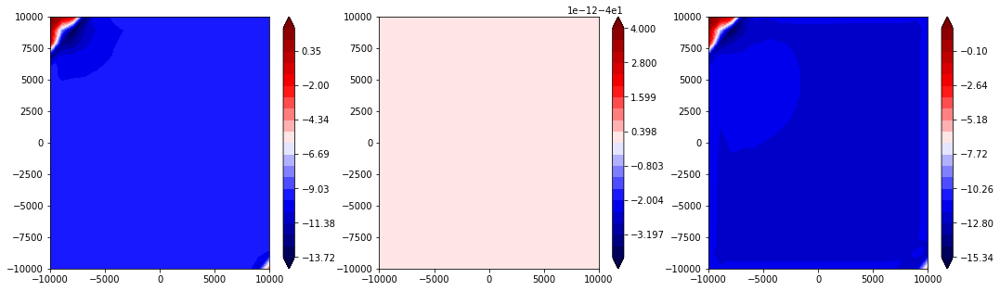

traction


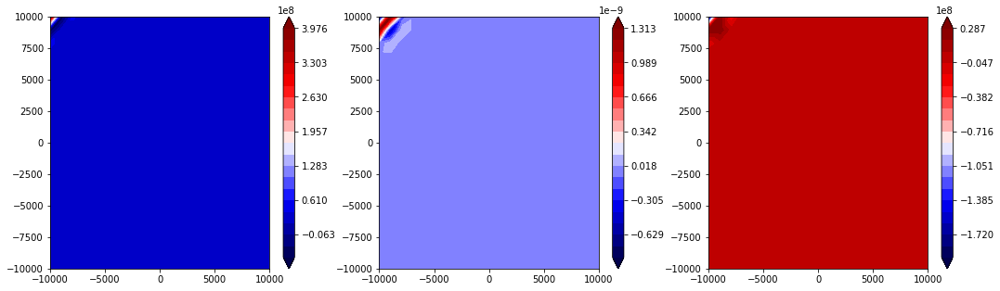

state


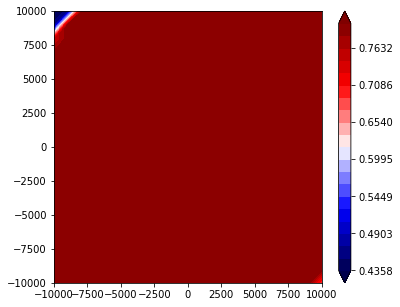

1551 37.1545159377
1552 37.1545159377
1553 37.1545159378
1554 37.1545159379
1555 37.154515938
1556 37.1545159381
1557 37.1545159381
1558 37.1545159381
1559 37.1545159383
1560 37.1545159383
V


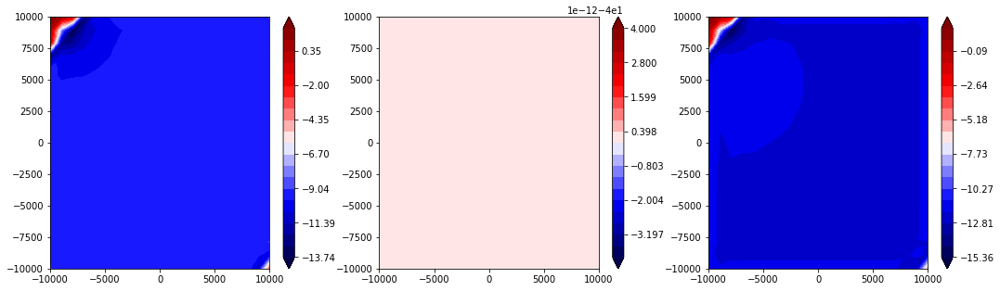

traction


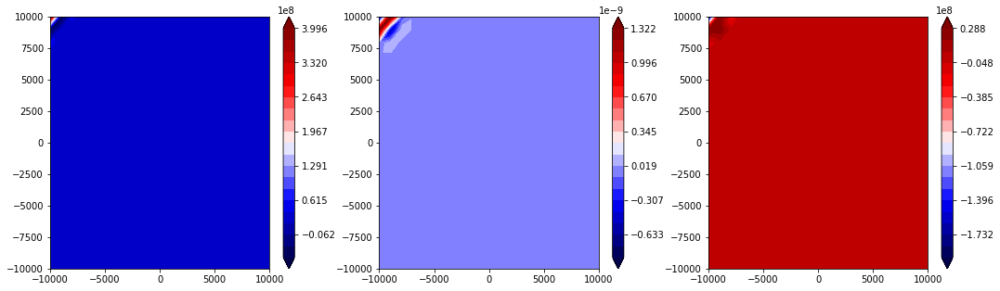

state


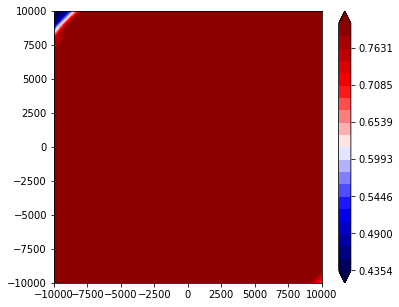

1561 37.1545159384
1562 37.1545159385
1563 37.1545159385
1564 37.1545159386
1565 37.1545159387
1566 37.1545159387
1567 37.1545159388
1568 37.1545159389
1569 37.1545159389
1570 37.154515939
V


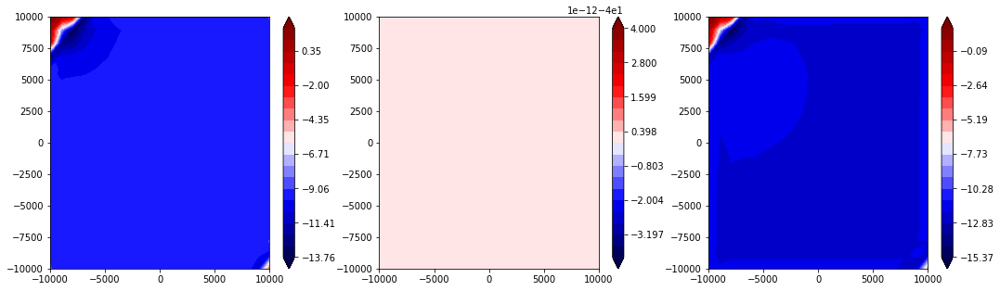

traction


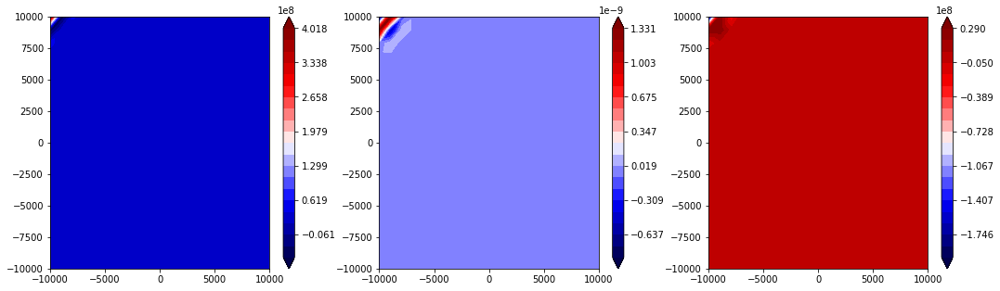

state


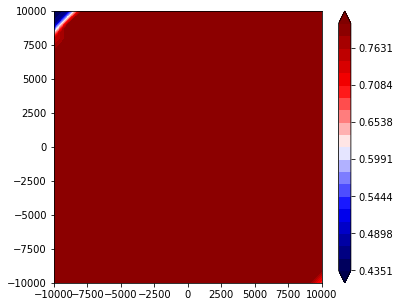

1571 37.1545159391
1572 37.1545159391
1573 37.1545159392
1574 37.1545159393
1575 37.1545159393
1576 37.1545159394
1577 37.1545159395
1578 37.1545159396
1579 37.1545159396
1580 37.1545159397
V


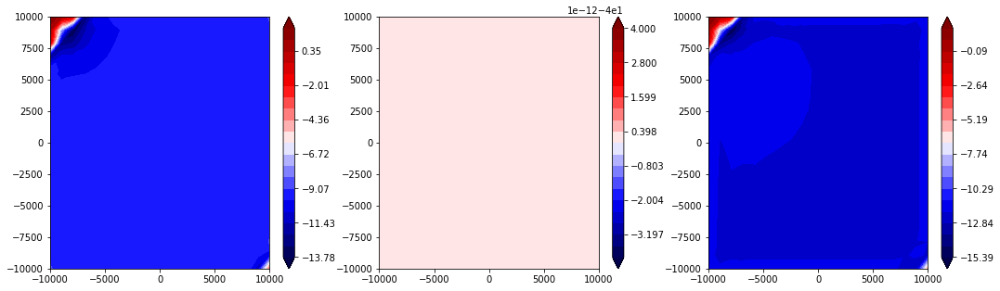

traction


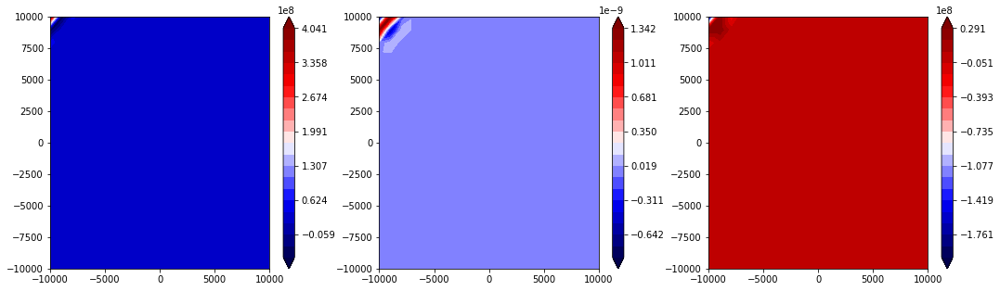

state


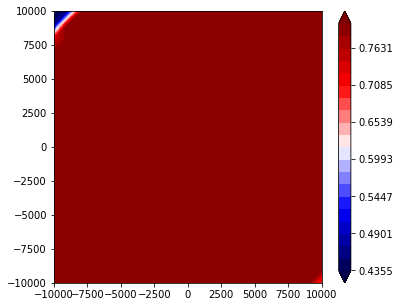

1581 37.1545159398
1582 37.1545159398
1583 37.15451594
1584 37.15451594
1585 37.15451594
1586 37.1545159402
1587 37.1545159402
1588 37.1545159402
1589 37.1545159403
1590 37.1545159404
V


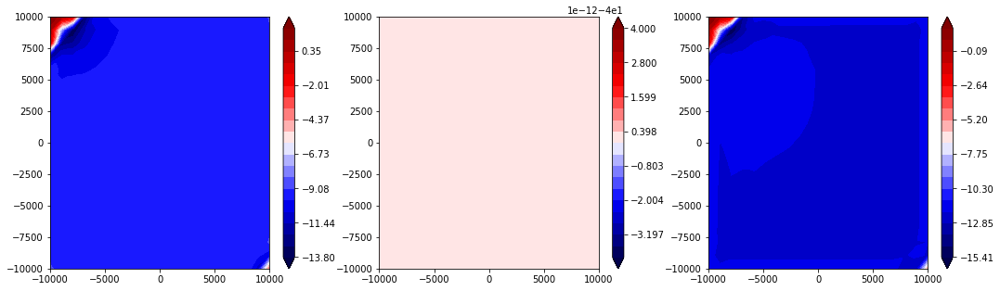

traction


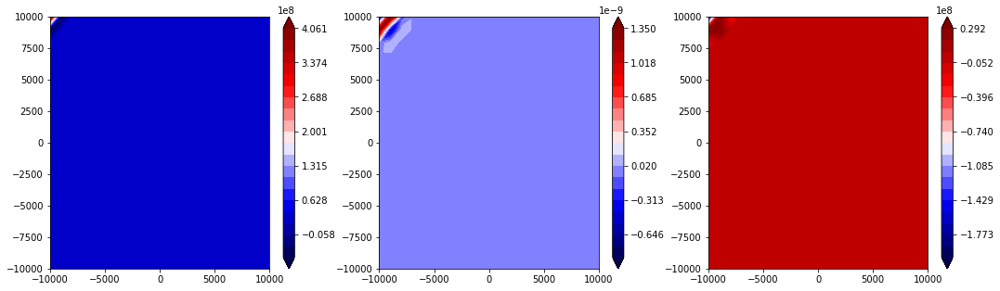

state


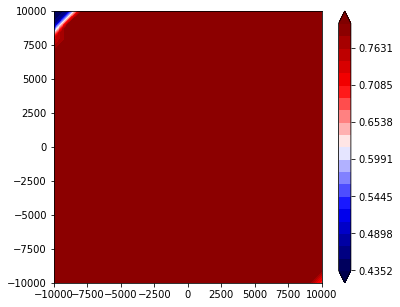

1591 37.1545159404
1592 37.1545159406
1593 37.1545159406
1594 37.1545159407
1595 37.1545159408
1596 37.1545159408
1597 37.1545159409
1598 37.154515941
1599 37.154515941
1600 37.1545159411
V


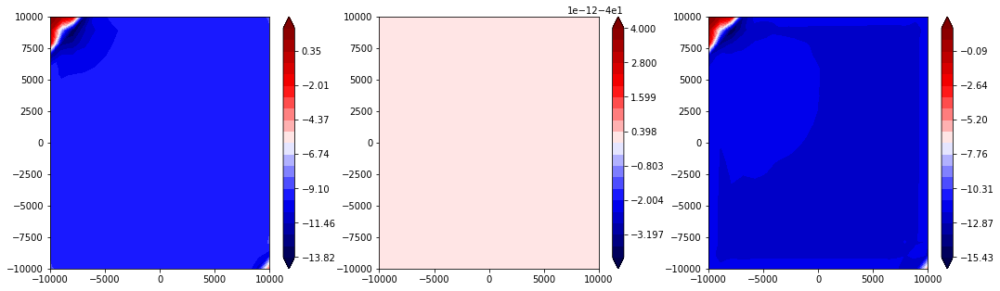

traction


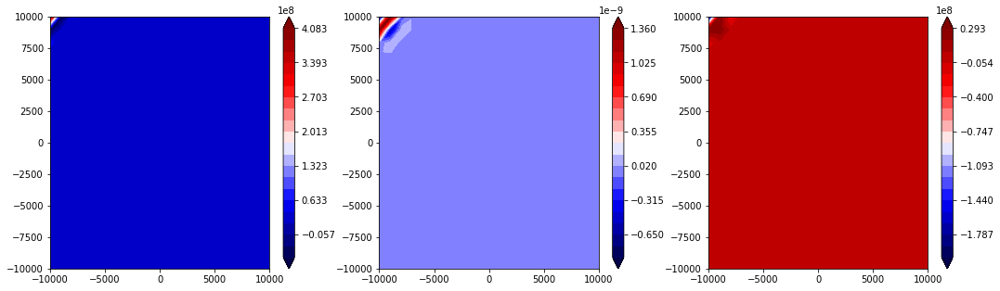

state


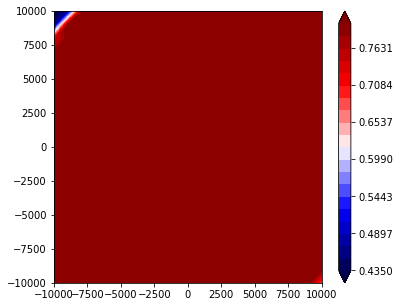

1601 37.1545159412
1602 37.1545159412
1603 37.1545159413
1604 37.1545159414
1605 37.1545159414
1606 37.1545159415
1607 37.1545159416
1608 37.1545159416
1609 37.1545159417
1610 37.1545159418
V


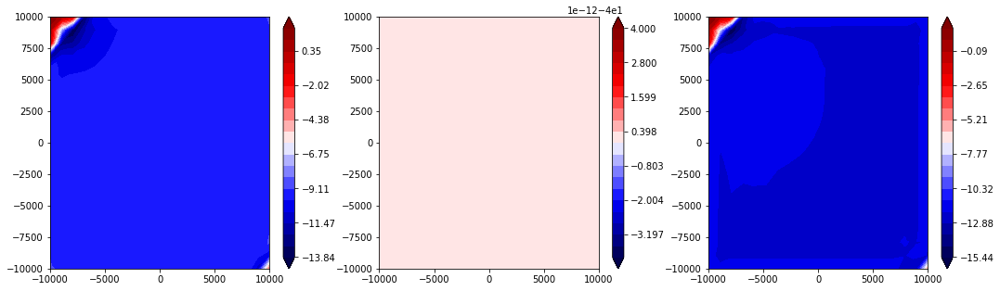

traction


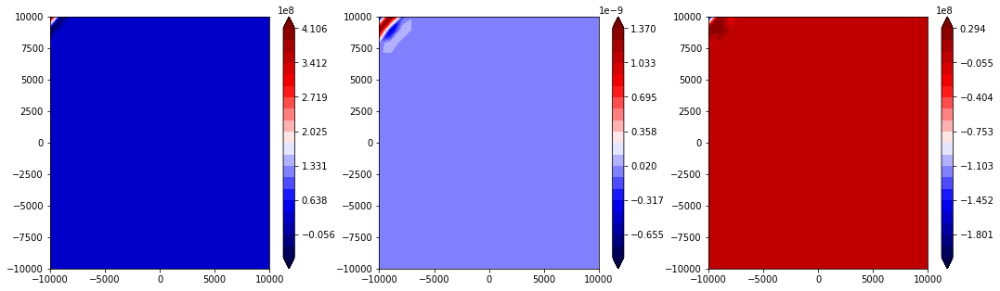

state


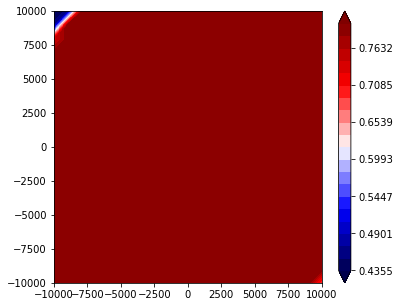

1611 37.1545159418
1612 37.1545159419
1613 37.154515942
1614 37.154515942
1615 37.1545159421
1616 37.1545159422
1617 37.1545159422
1618 37.1545159423
1619 37.1545159424
1620 37.1545159425
V


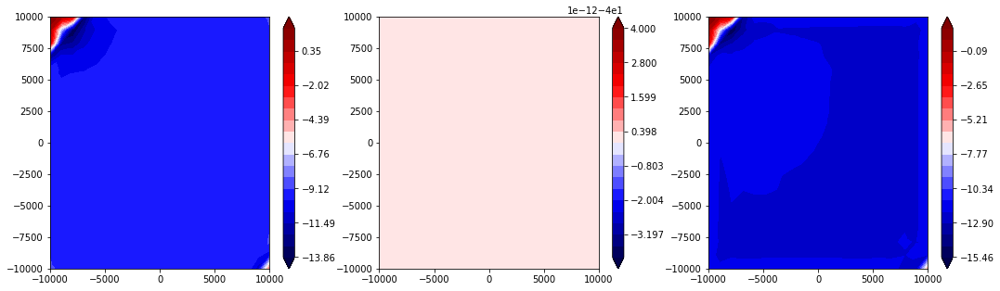

traction


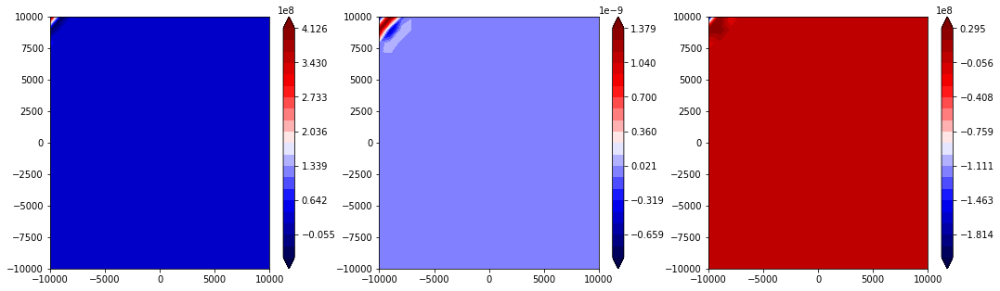

state


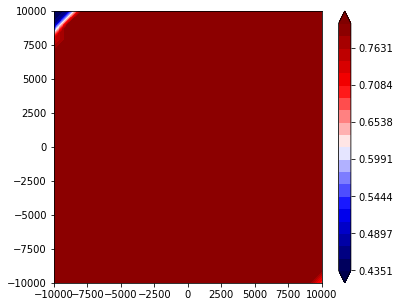

1621 37.1545159425
1622 37.1545159426
1623 37.1545159427
1624 37.1545159427
1625 37.1545159428
1626 37.1545159429
1627 37.1545159429
1628 37.154515943
1629 37.1545159431
1630 37.1545159431
V


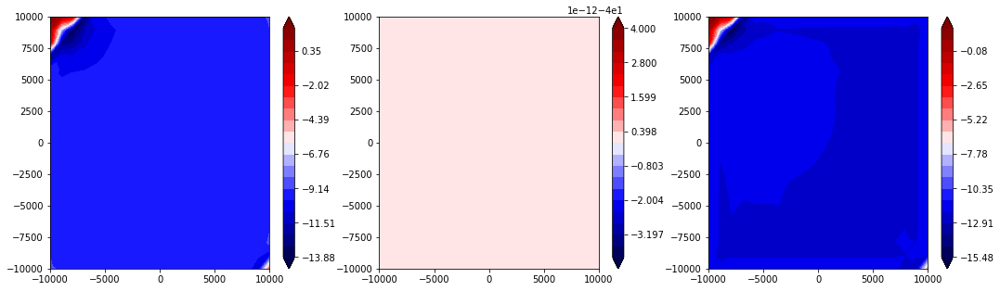

traction


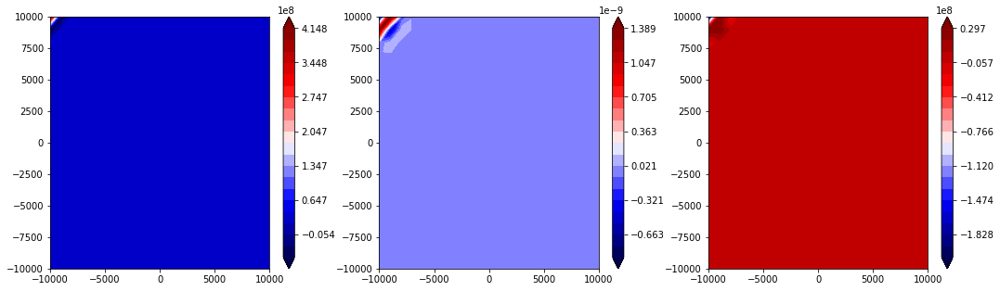

state


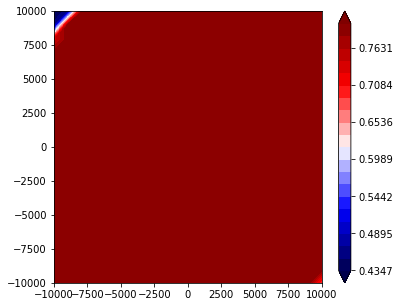

1631 37.1545159432
1632 37.1545159433
1633 37.1545159433
1634 37.1545159434
1635 37.1545159435
1636 37.1545159435
1637 37.1545159437
1638 37.1545159437
1639 37.1545159437
1640 37.1545159438
V


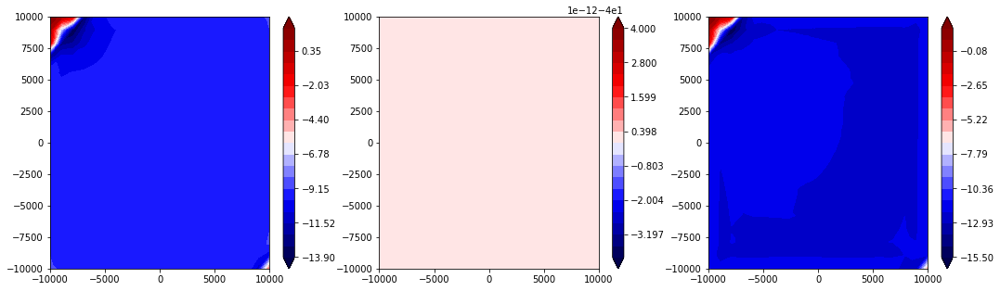

traction


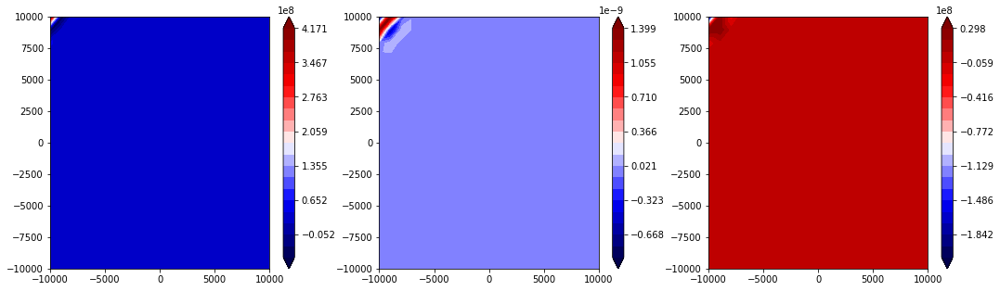

state


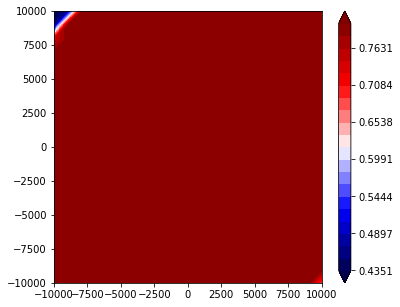

1641 37.1545159439
1642 37.1545159439
1643 37.1545159441
1644 37.1545159441
1645 37.1545159441
1646 37.1545159443
1647 37.1545159443
1648 37.1545159444
1649 37.1545159445
1650 37.1545159445
V


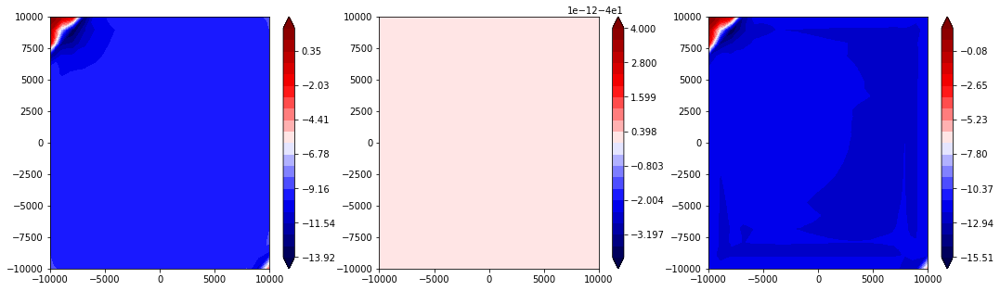

traction


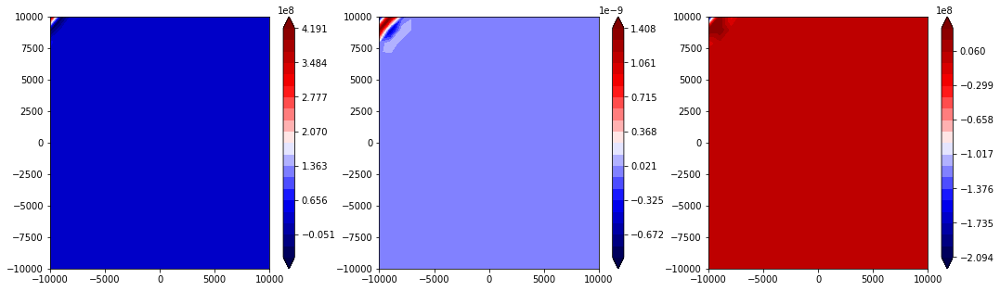

state


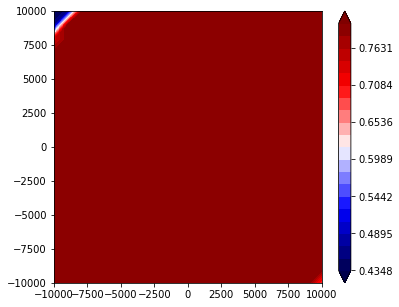

1651 37.1545159445
1652 37.1545159447
1653 37.1545159447
1654 37.1545159448
1655 37.1545159449
1656 37.1545159449
1657 37.1545159449
1658 37.1545159451
1659 37.1545159451
1660 37.1545159452
V


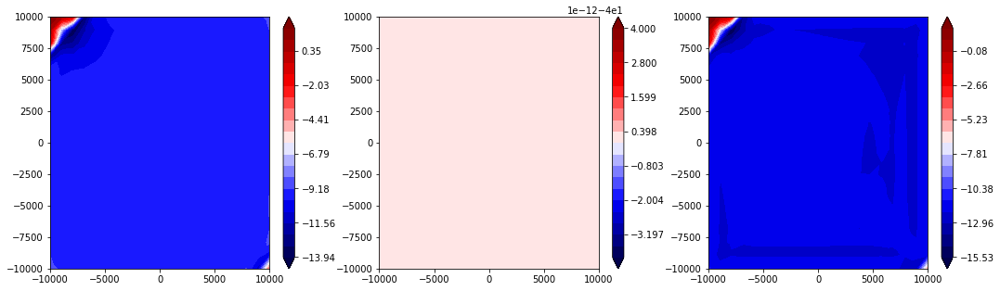

traction


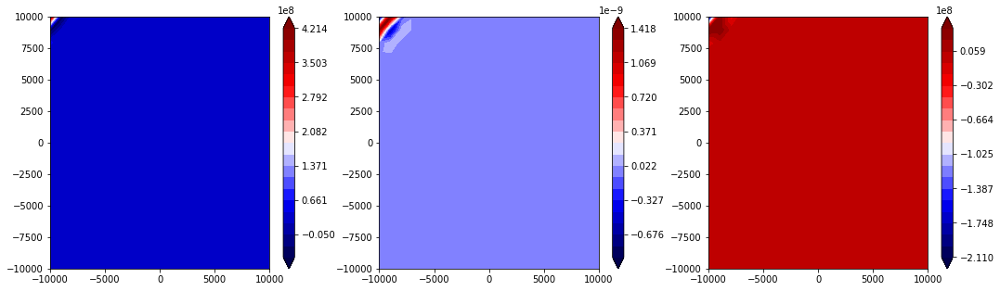

state


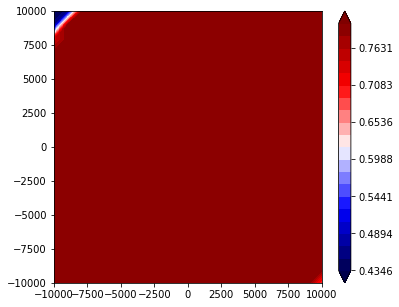

1661 37.1545159453
1662 37.1545159453
1663 37.1545159453
1664 37.1545159455
1665 37.1545159455
1666 37.1545159456
1667 37.1545159457
1668 37.1545159457
1669 37.1545159457
1670 37.1545159459
V


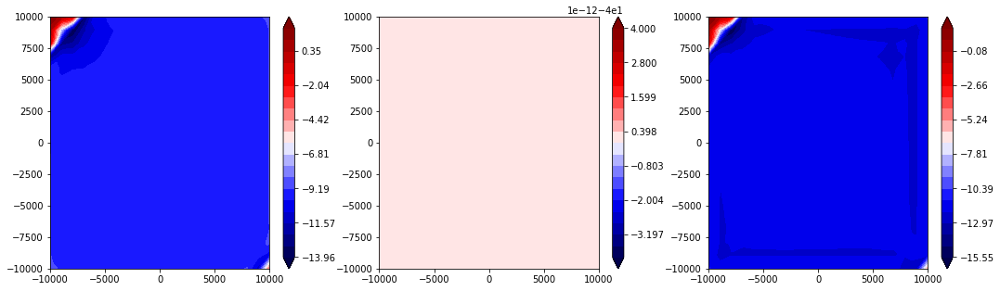

traction


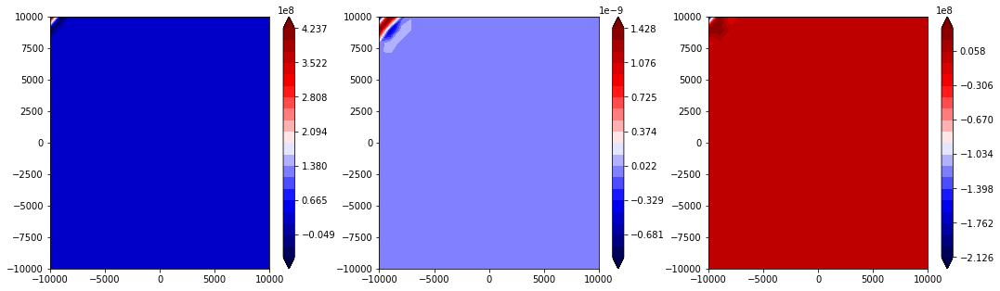

state


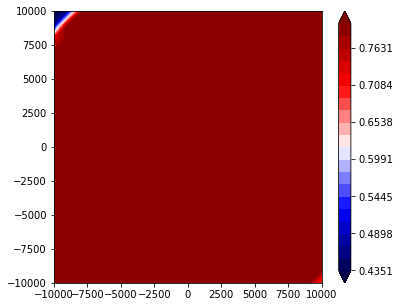

1671 37.1545159459
1672 37.1545159459
1673 37.1545159461
1674 37.1545159461
1675 37.1545159462
1676 37.1545159463
1677 37.1545159463
1678 37.1545159463
1679 37.1545159465
1680 37.1545159465
V


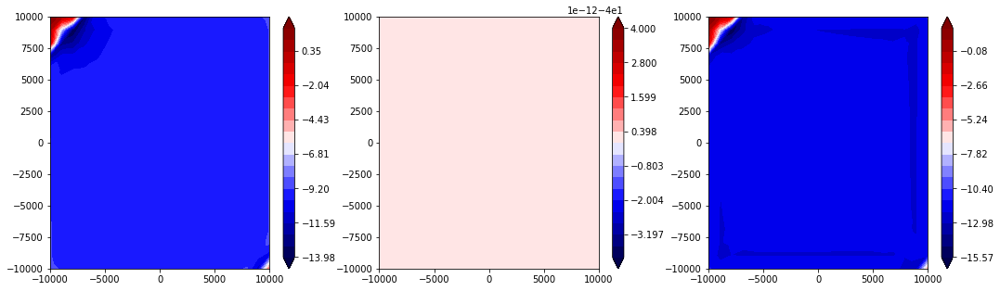

traction


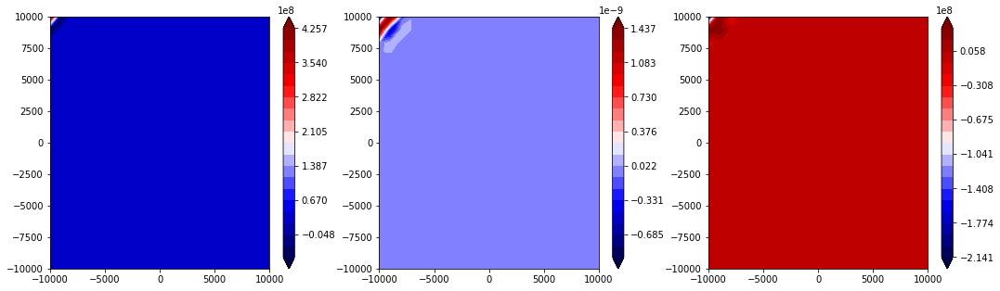

state


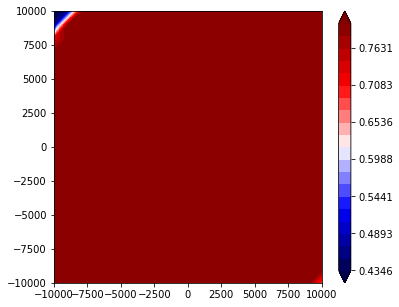

1681 37.1545159466
1682 37.1545159467
1683 37.1545159467
1684 37.1545159467
1685 37.1545159469
1686 37.1545159469
1687 37.1545159469
1688 37.1545159471
1689 37.1545159471
1690 37.1545159471
V


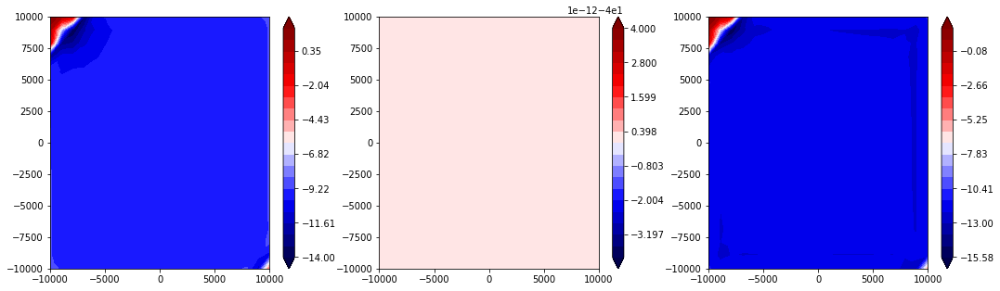

traction


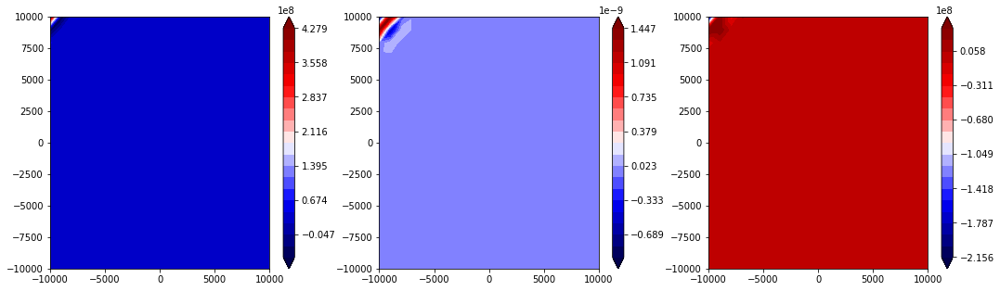

state


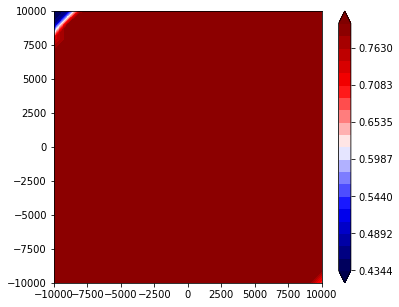

1691 37.1545159472
1692 37.1545159473
1693 37.1545159473
1694 37.1545159474
1695 37.1545159475
1696 37.1545159475
1697 37.1545159476
1698 37.1545159477
1699 37.1545159477
1700 37.1545159477
V


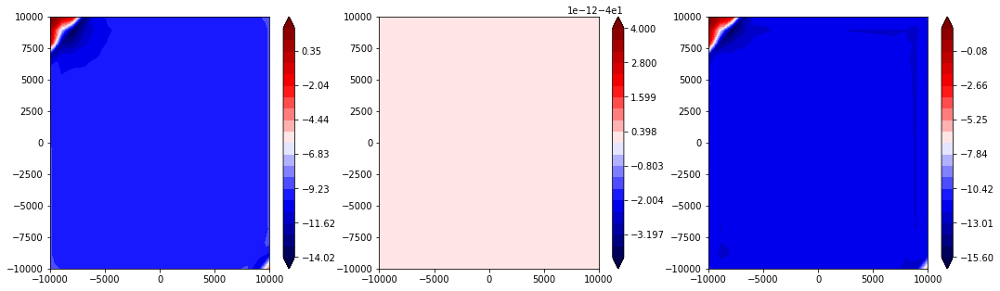

traction


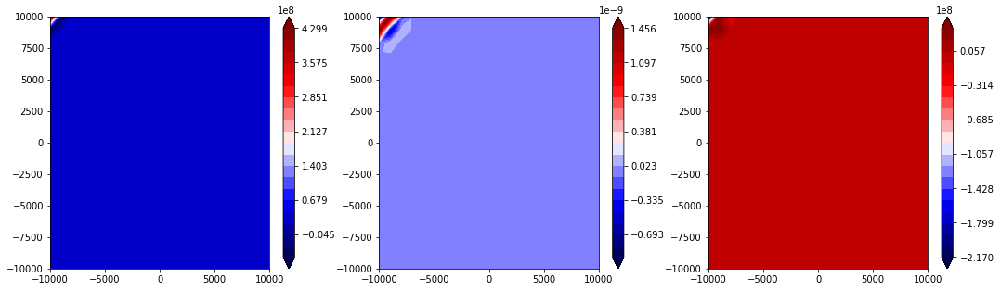

state


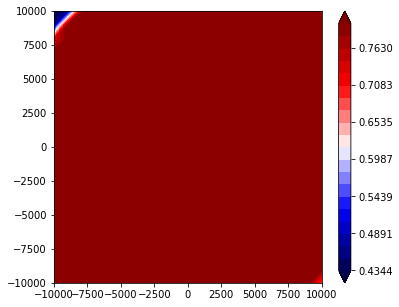

1701 37.1545159479
1702 37.1545159479
1703 37.154515948
1704 37.154515948
1705 37.1545159481
1706 37.1545159481
1707 37.1545159482
1708 37.1545159483
1709 37.1545159483
1710 37.1545159484
V


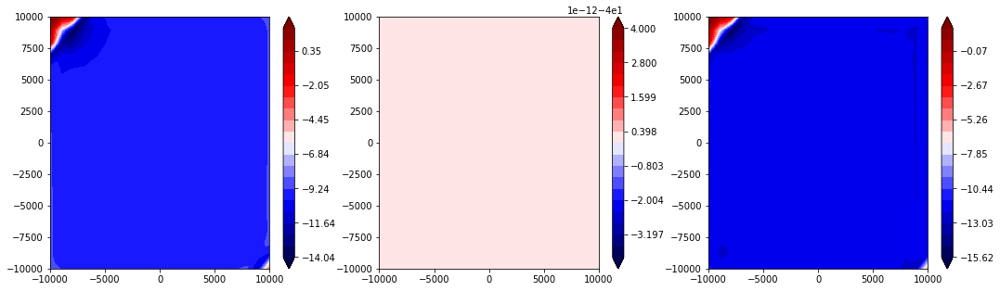

traction


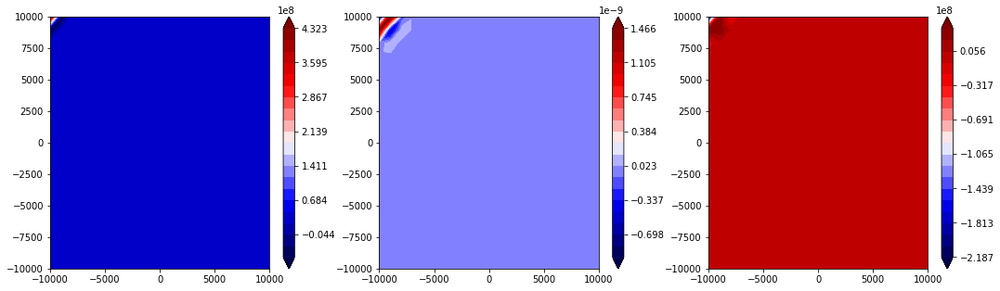

state


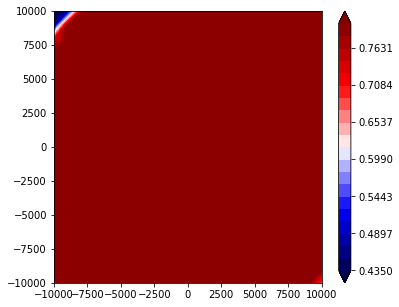

1711 37.1545159485
1712 37.1545159485
1713 37.1545159486
1714 37.1545159487
1715 37.1545159487
1716 37.1545159488
1717 37.1545159489
1718 37.1545159489
1719 37.154515949
1720 37.1545159491
V


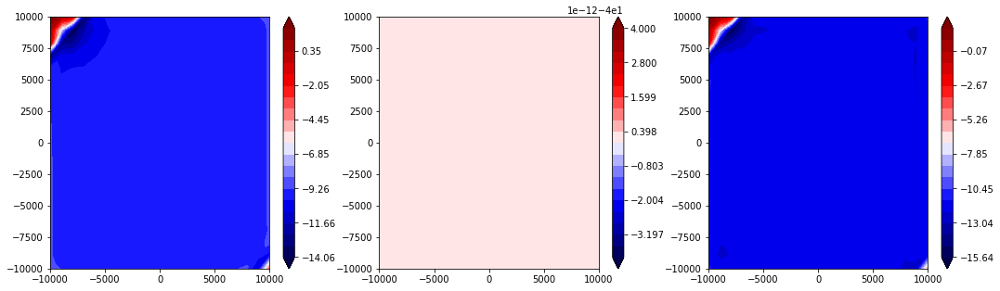

traction


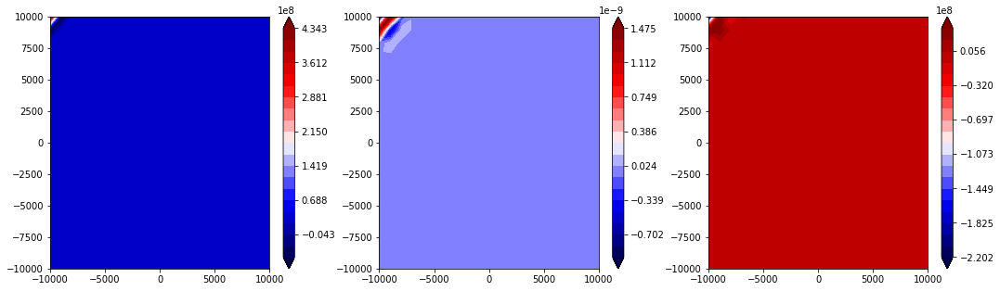

state


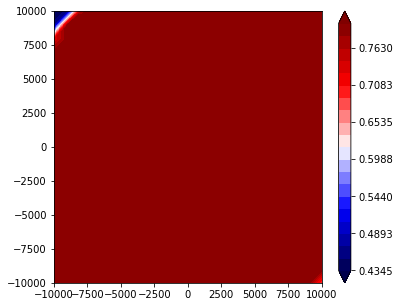

1721 37.1545159491
1722 37.1545159492
1723 37.1545159492
1724 37.1545159493
1725 37.1545159494
1726 37.1545159494
1727 37.1545159495
1728 37.1545159496
1729 37.1545159496
1730 37.1545159497
V


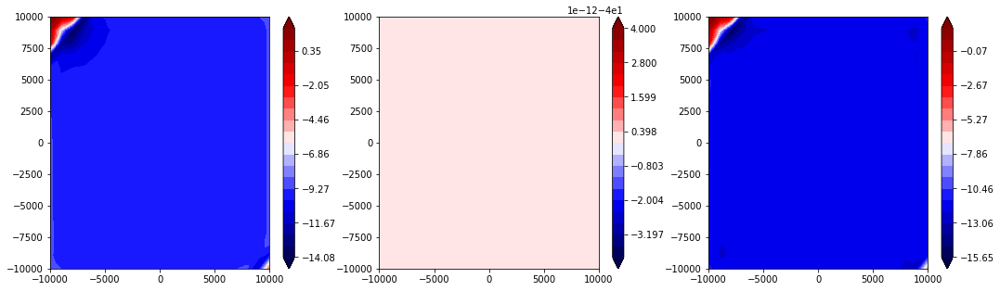

traction


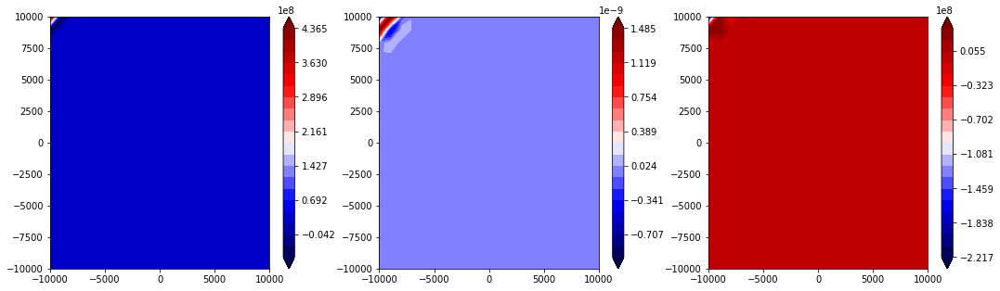

state


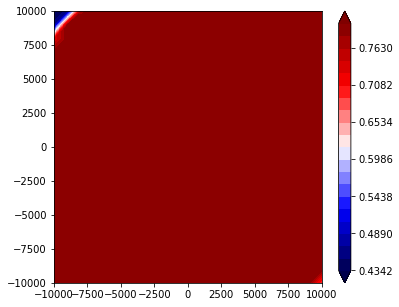

1731 37.1545159498
1732 37.1545159498
1733 37.1545159499
1734 37.15451595
1735 37.15451595
1736 37.1545159501
1737 37.1545159502
1738 37.1545159502
1739 37.1545159503
1740 37.1545159504
V


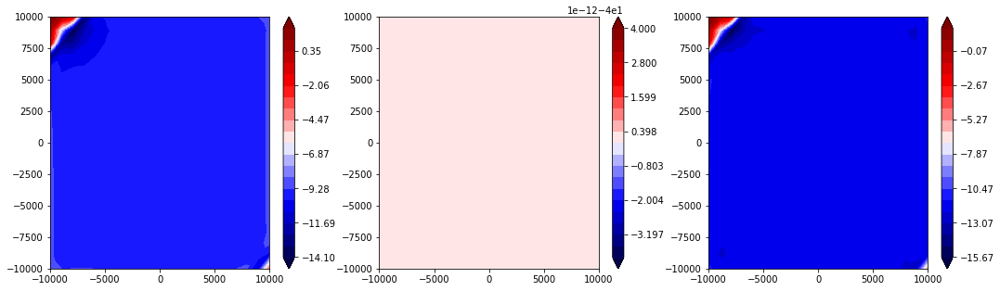

traction


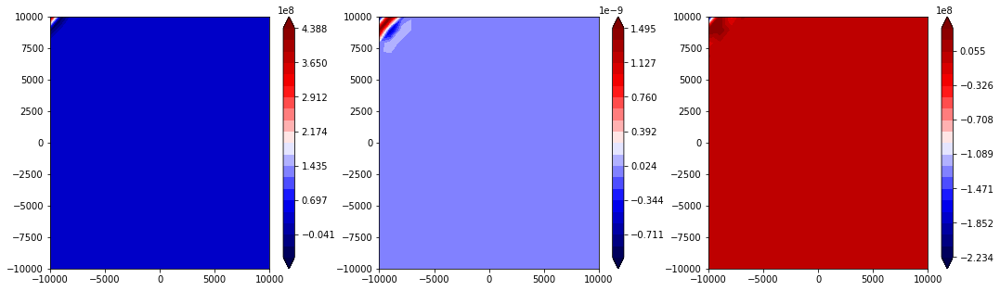

state


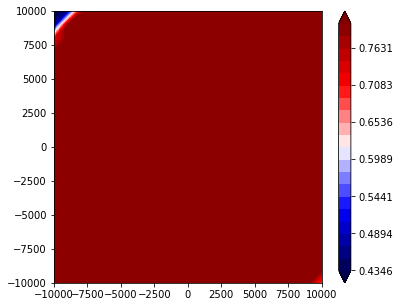

1741 37.1545159504
1742 37.1545159504
1743 37.1545159506
1744 37.1545159506
1745 37.1545159507
1746 37.1545159508
1747 37.1545159508
1748 37.1545159508
1749 37.1545159508
1750 37.1545159509
V


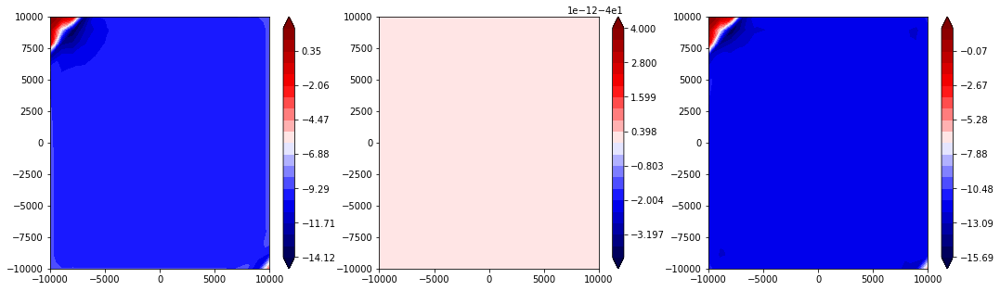

traction


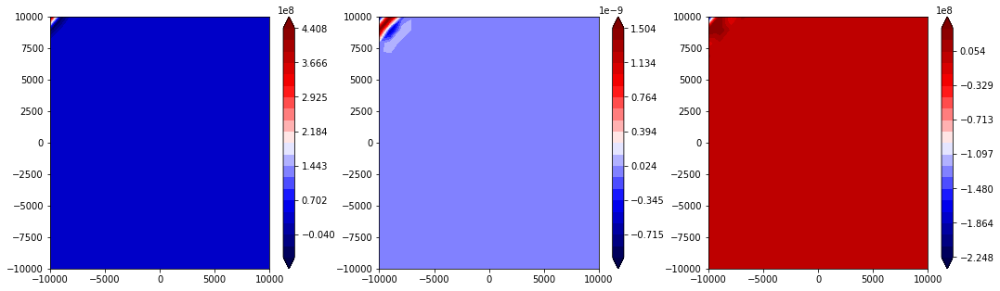

state


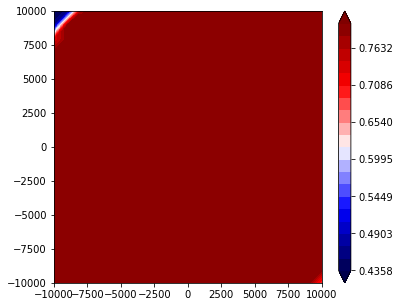

1751 37.154515951
1752 37.154515951
1753 37.1545159511
1754 37.1545159512
1755 37.1545159512
1756 37.1545159512
1757 37.1545159513
1758 37.1545159514
1759 37.1545159514
1760 37.1545159515
V


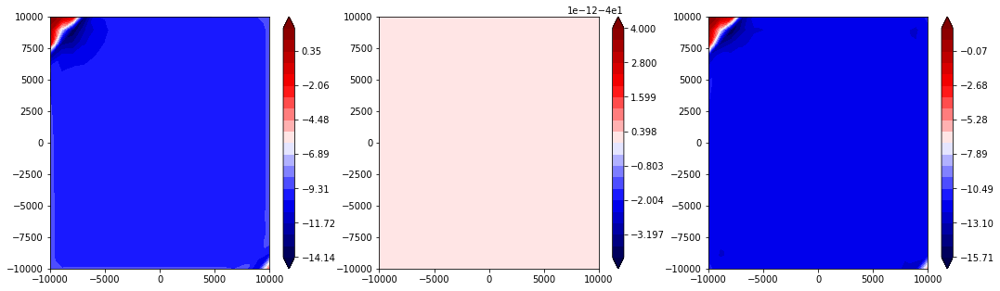

traction


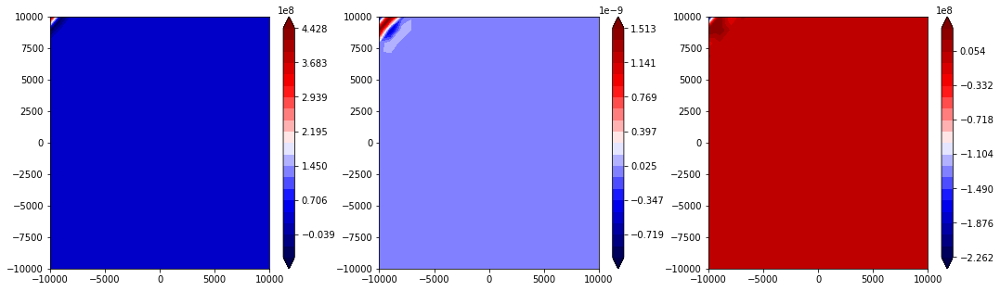

state


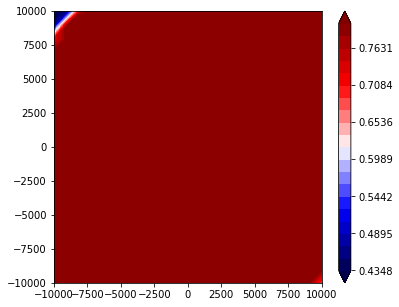

1761 37.1545159516
1762 37.1545159516
1763 37.1545159517
1764 37.1545159517
1765 37.1545159518
1766 37.1545159519
1767 37.1545159519
1768 37.154515952
1769 37.1545159521
1770 37.1545159521
V


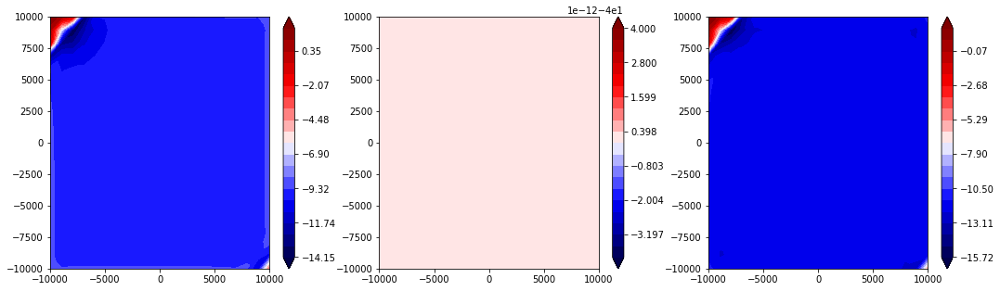

traction


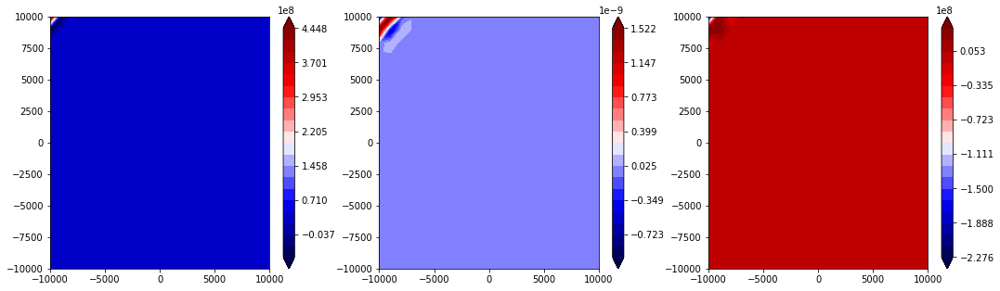

state


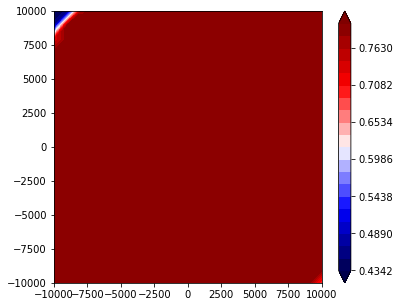

1771 37.1545159522
1772 37.1545159523
1773 37.1545159523
1774 37.1545159524
1775 37.1545159525
1776 37.1545159525
1777 37.1545159526
1778 37.1545159527
1779 37.1545159527
1780 37.1545159527
V


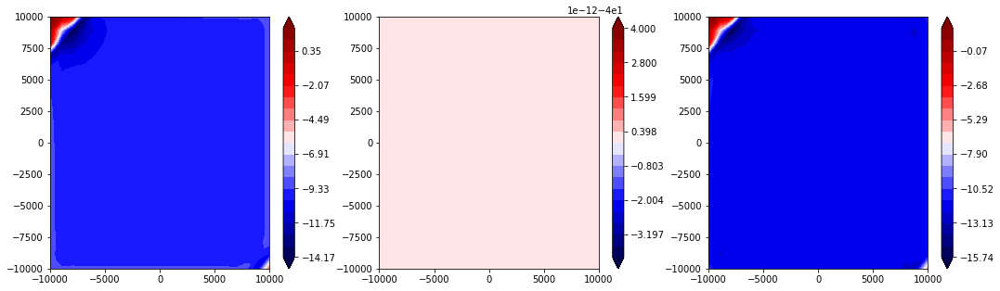

traction


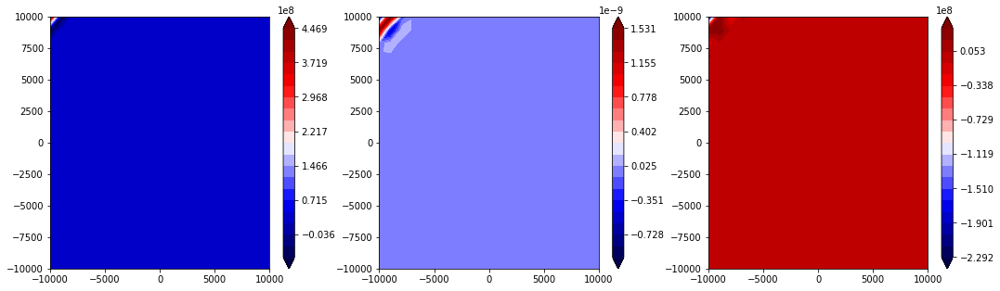

state


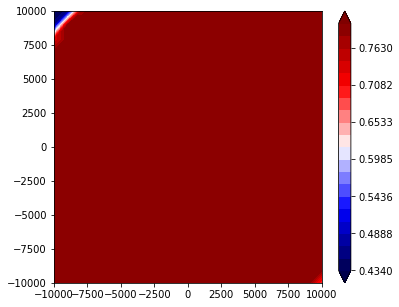

1781 37.1545159528
1782 37.1545159529
1783 37.1545159529
1784 37.154515953
1785 37.154515953
1786 37.1545159531
1787 37.1545159532
1788 37.1545159532
1789 37.1545159533
1790 37.1545159534
V


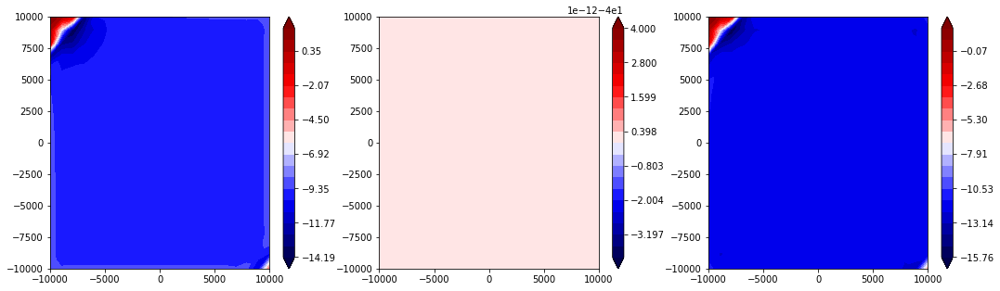

traction


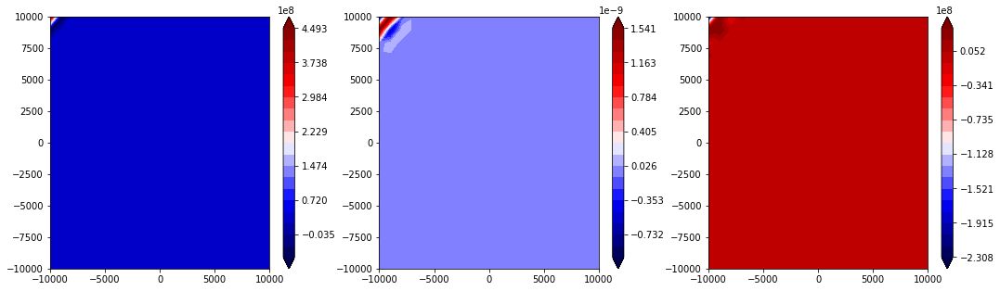

state


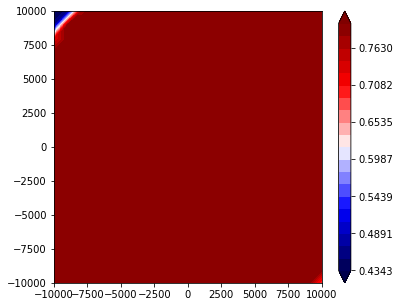

1791 37.1545159534
1792 37.1545159535
1793 37.1545159536
1794 37.1545159536
1795 37.1545159536
1796 37.1545159537
1797 37.1545159538
1798 37.1545159538
1799 37.1545159539
1800 37.154515954
V


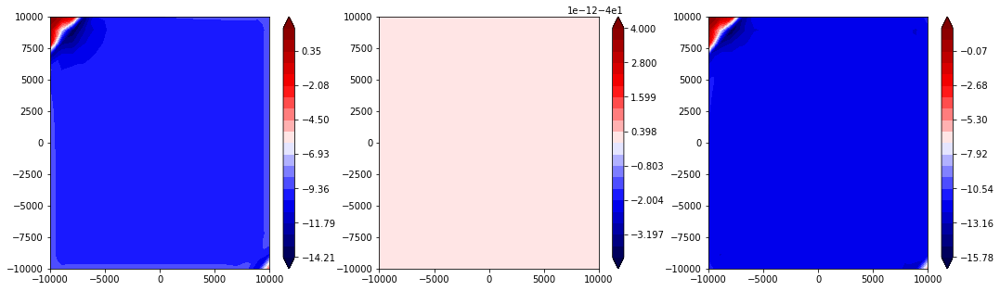

traction


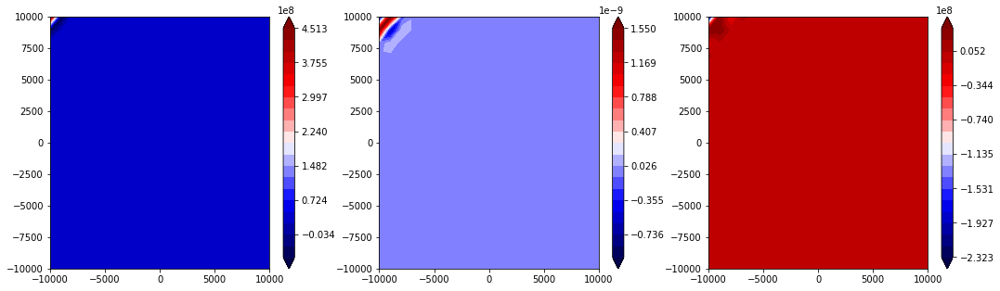

state


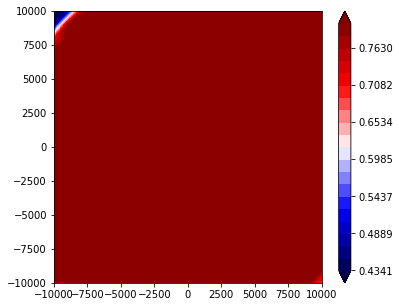

1801 37.154515954
1802 37.1545159541
1803 37.1545159542
1804 37.1545159542
1805 37.1545159543
1806 37.1545159543
1807 37.1545159544
1808 37.1545159545
1809 37.1545159545
1810 37.1545159545
V


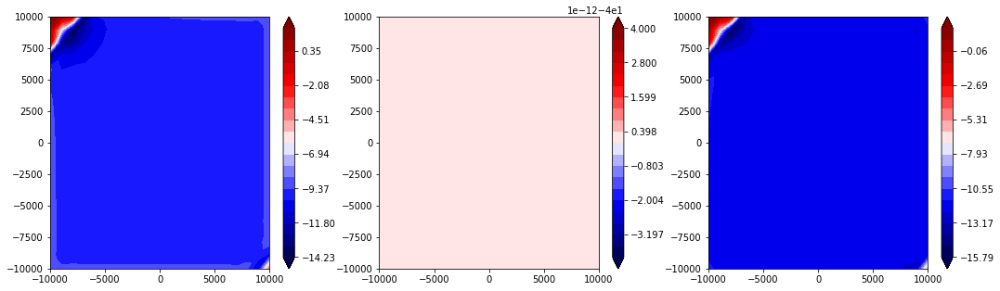

traction


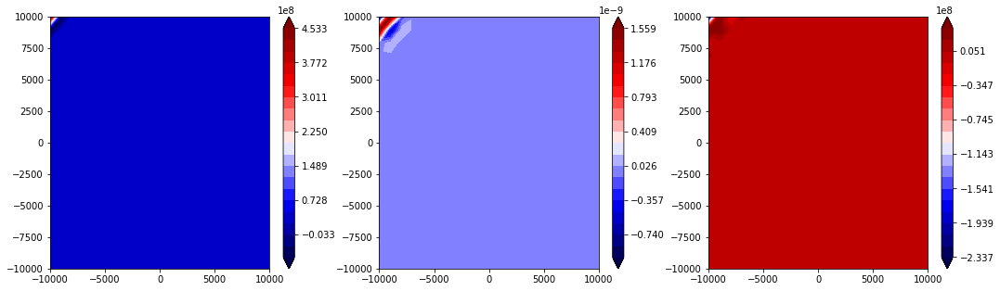

state


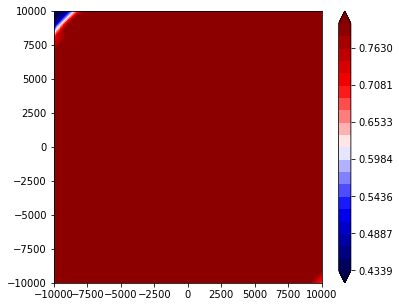

1811 37.1545159546
1812 37.1545159547
1813 37.1545159548
1814 37.1545159548
1815 37.1545159548
1816 37.1545159549
1817 37.154515955
1818 37.154515955
1819 37.154515955
1820 37.1545159552
V


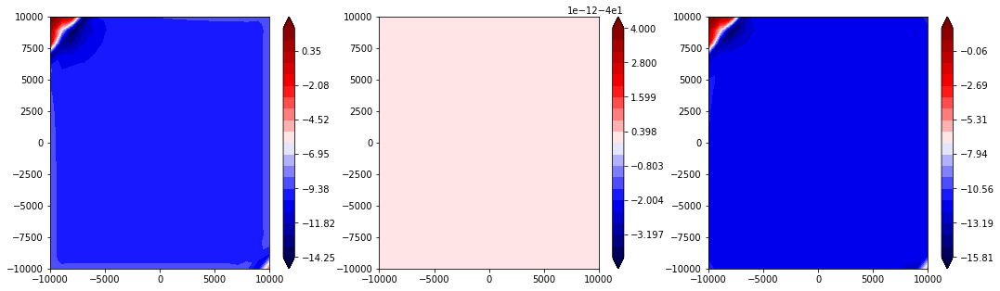

traction


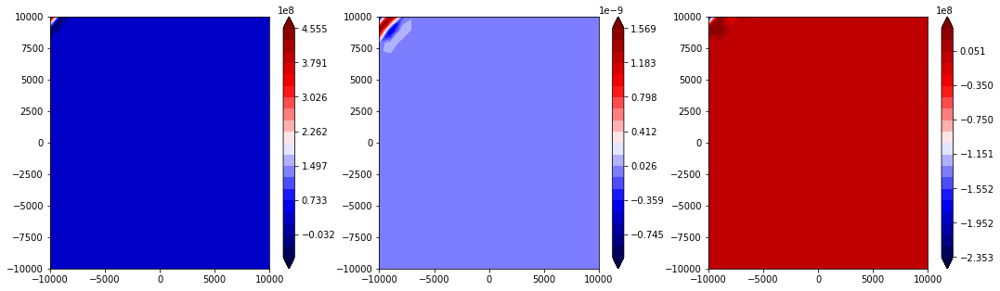

state


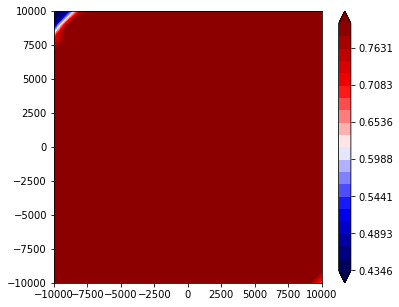

1821 37.1545159552
1822 37.1545159552
1823 37.1545159553
1824 37.1545159553
1825 37.1545159554
1826 37.1545159555
1827 37.1545159555
1828 37.1545159556
1829 37.1545159557
1830 37.1545159557
V


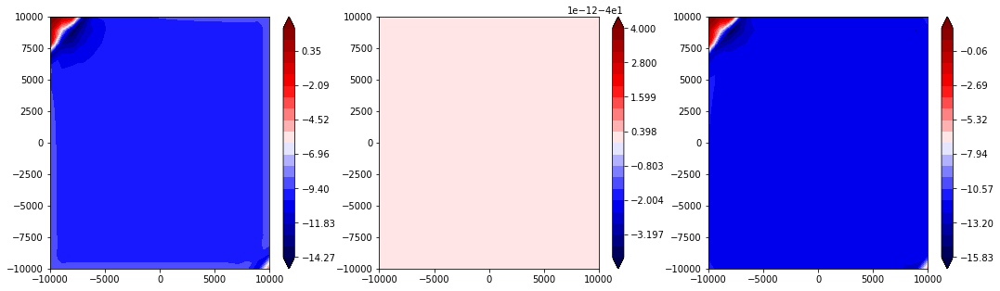

traction


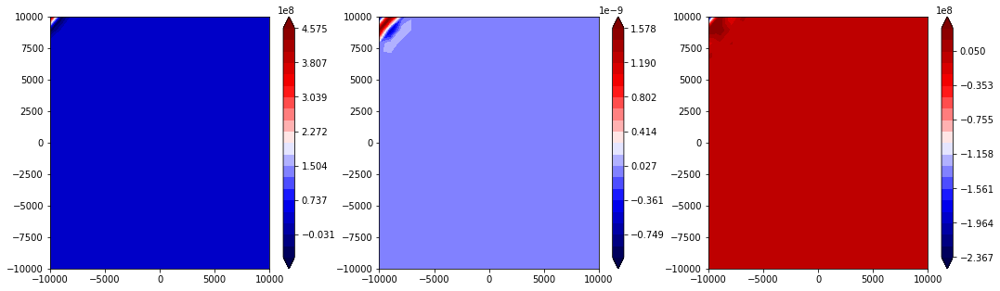

state


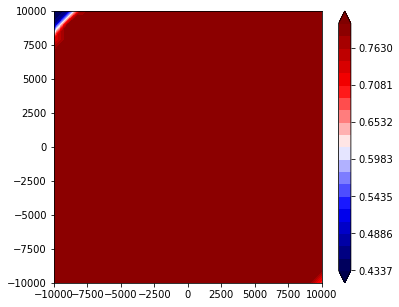

1831 37.1545159558
1832 37.1545159558
1833 37.1545159559
1834 37.154515956
1835 37.154515956
1836 37.1545159561
1837 37.1545159562
1838 37.1545159562
1839 37.1545159563
1840 37.1545159564
V


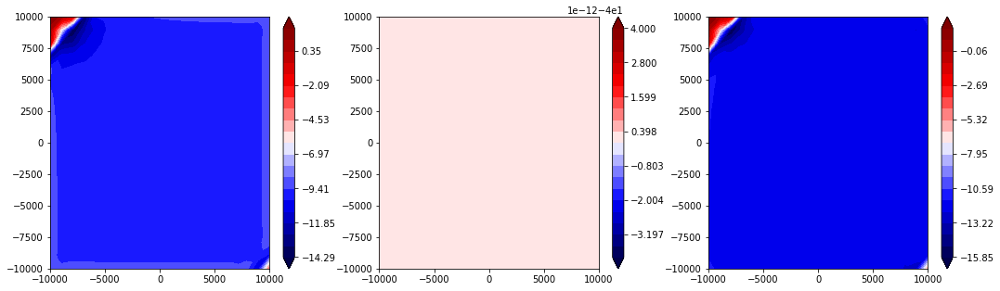

traction


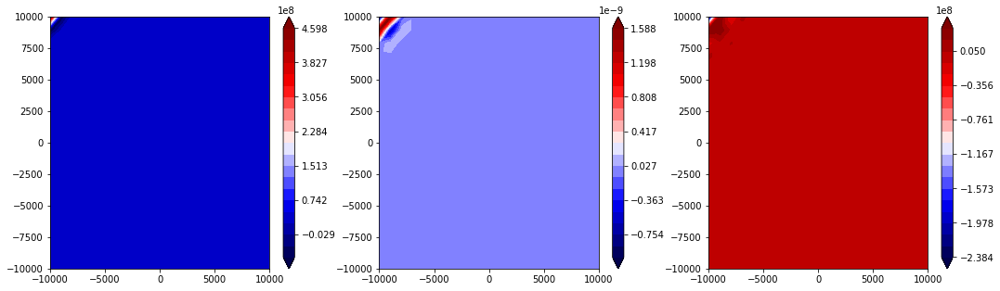

state


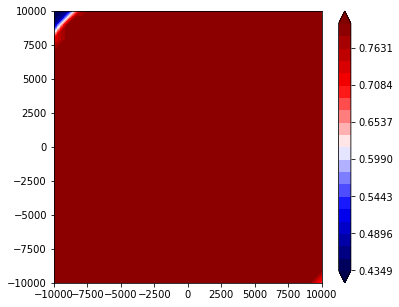

1841 37.1545159564
1842 37.1545159564
1843 37.1545159565
1844 37.1545159565
1845 37.1545159566
1846 37.1545159567
1847 37.1545159568
1848 37.1545159568
1849 37.1545159568
1850 37.1545159569
V


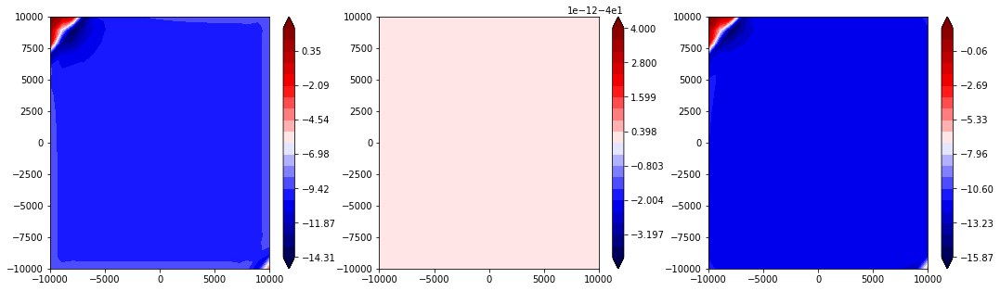

traction


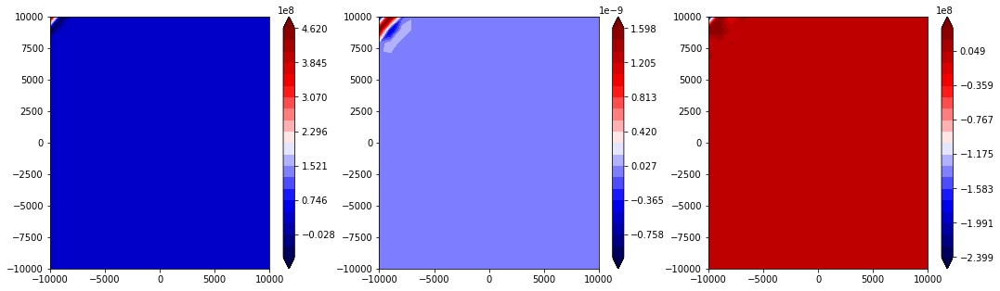

state


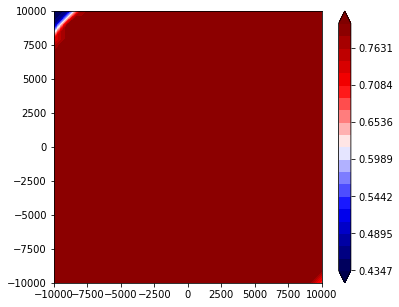

1851 37.154515957
1852 37.154515957
1853 37.1545159571
1854 37.1545159571
1855 37.1545159571
1856 37.1545159572
1857 37.1545159573
1858 37.1545159573
1859 37.1545159573
1860 37.1545159574
V


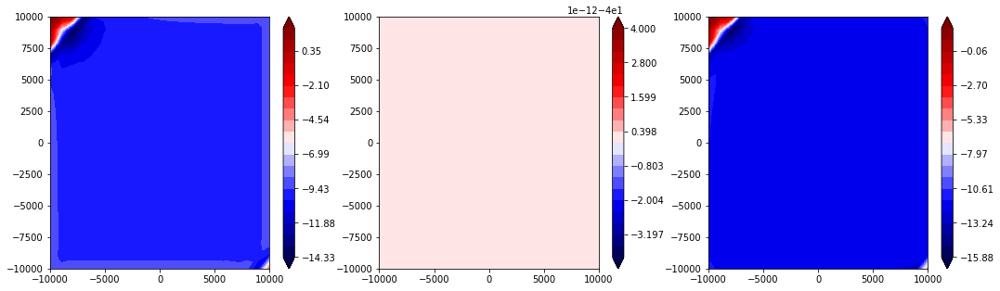

traction


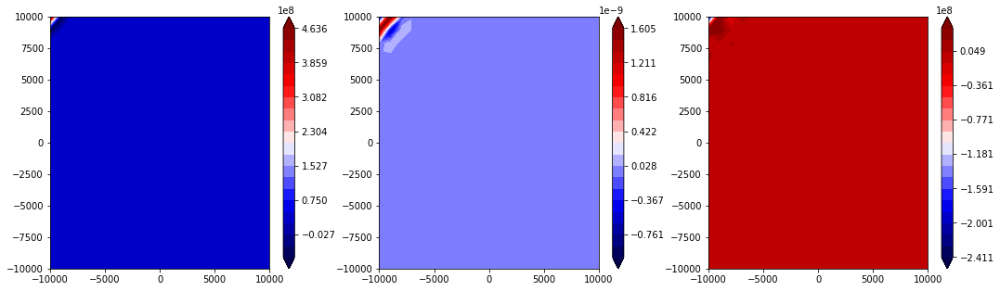

state


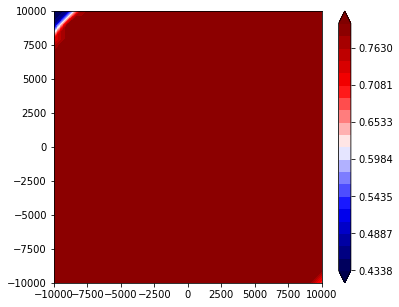

1861 37.1545159575
1862 37.1545159576
1863 37.1545159576
1864 37.1545159576
1865 37.1545159577
1866 37.1545159578
1867 37.1545159578
1868 37.1545159579
1869 37.1545159579
1870 37.154515958
V


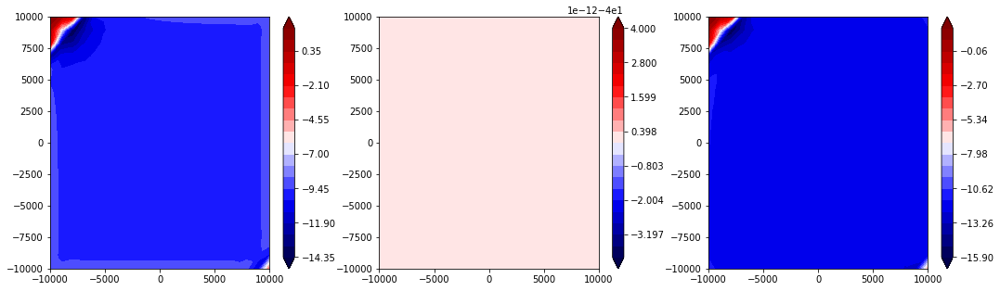

traction


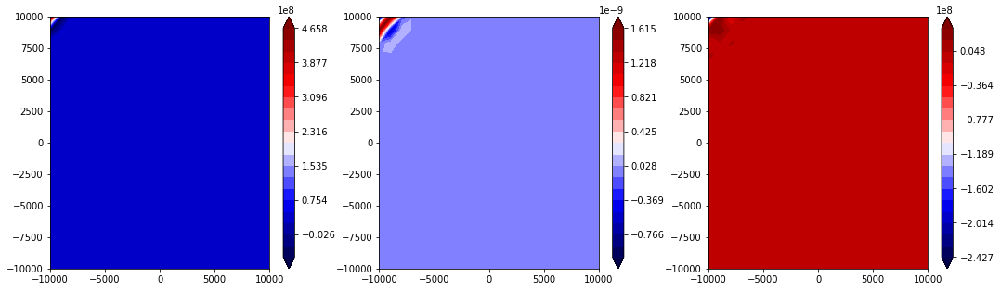

state


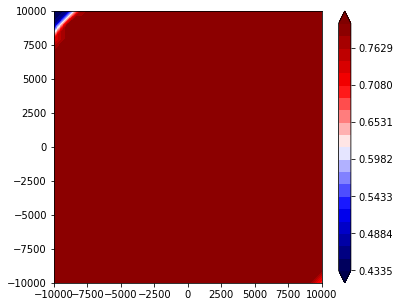

1871 37.1545159581
1872 37.1545159581
1873 37.1545159582
1874 37.1545159583
1875 37.1545159583
1876 37.1545159583
1877 37.1545159584
1878 37.1545159585
1879 37.1545159585
1880 37.1545159586
V


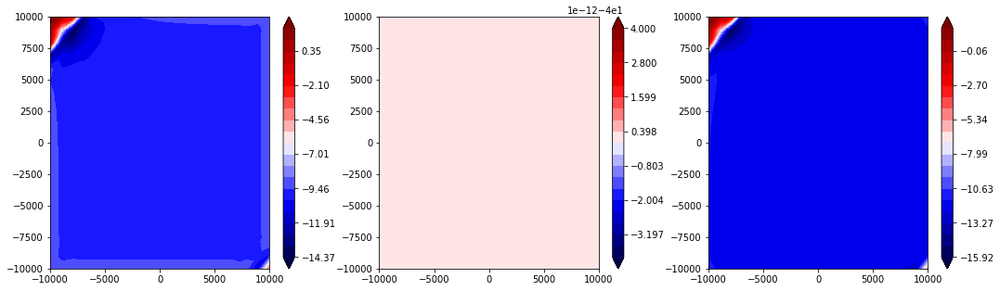

traction


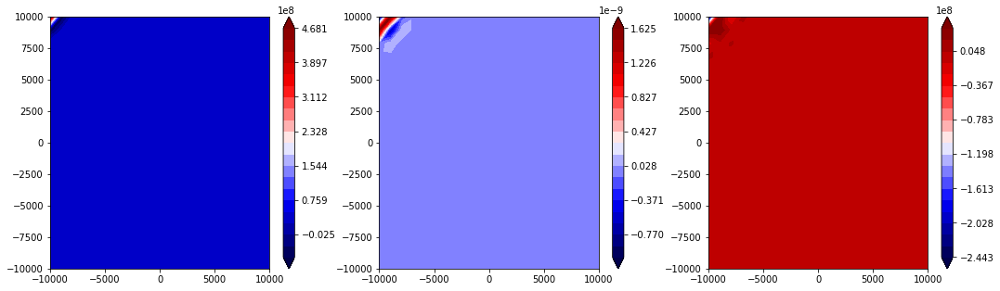

state


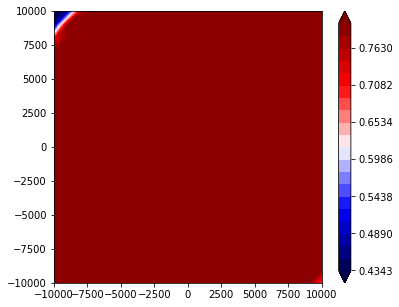

1881 37.1545159586
1882 37.1545159587
1883 37.1545159588
1884 37.1545159588
1885 37.1545159589
1886 37.154515959
1887 37.154515959
1888 37.154515959
1889 37.1545159591
1890 37.1545159592
V


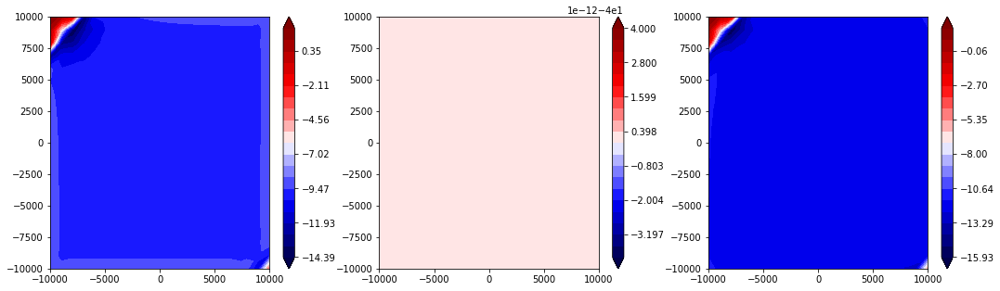

traction


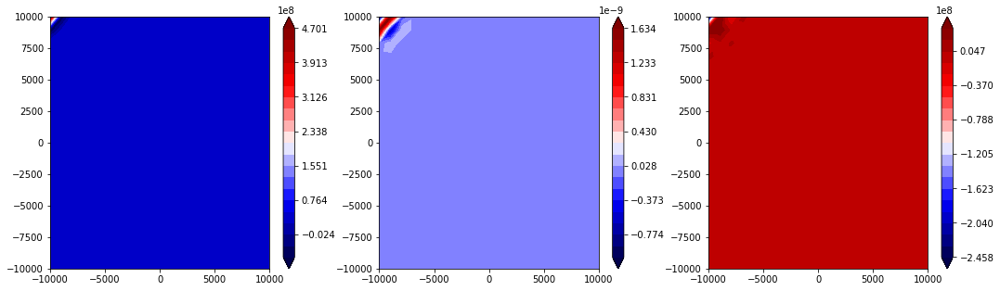

state


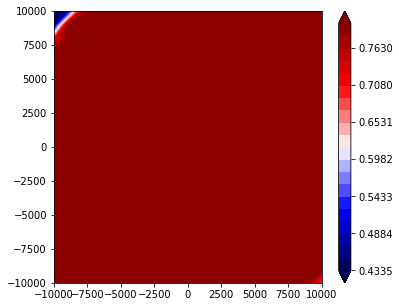

1891 37.1545159592
1892 37.1545159593
1893 37.1545159593
1894 37.1545159594
1895 37.1545159595
1896 37.1545159596
1897 37.1545159596
1898 37.1545159596
1899 37.1545159597
1900 37.1545159597
V


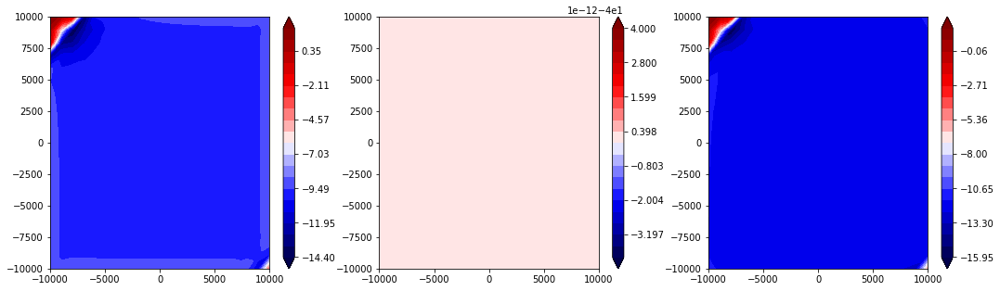

traction


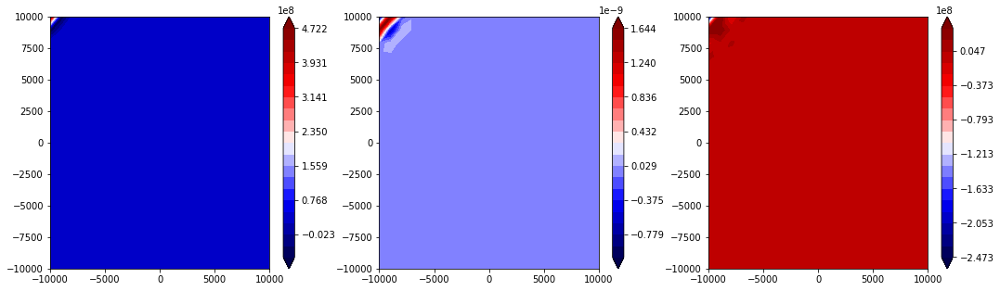

state


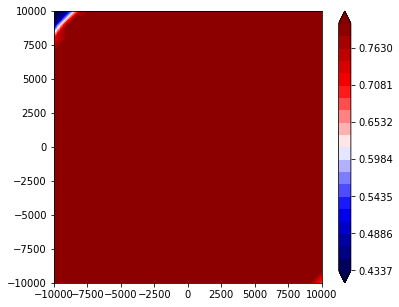

1901 37.1545159598
1902 37.1545159599
1903 37.1545159599
1904 37.1545159599
1905 37.15451596
1906 37.1545159601
1907 37.1545159601
1908 37.1545159602
1909 37.1545159602
1910 37.1545159603
V


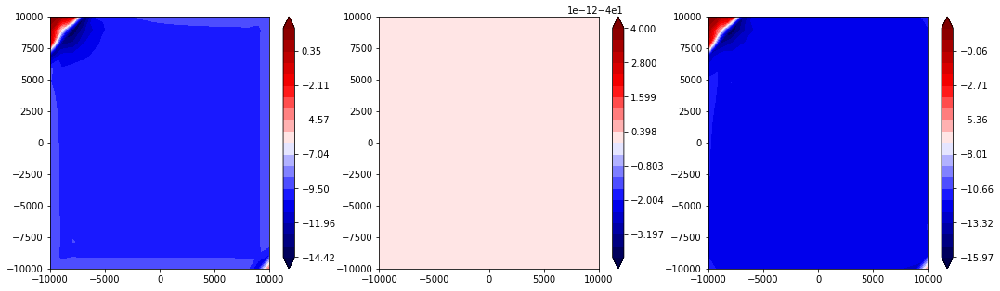

traction


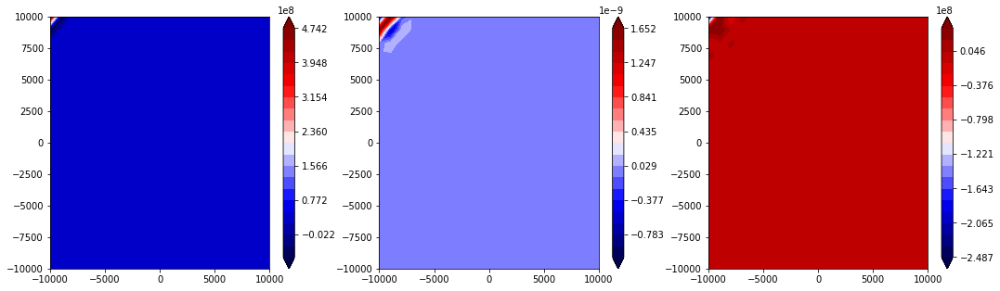

state


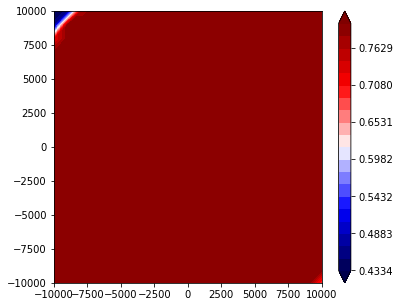

1911 37.1545159604
1912 37.1545159604
1913 37.1545159604
1914 37.1545159604
1915 37.1545159605
1916 37.1545159606
1917 37.1545159606
1918 37.1545159607
1919 37.1545159607
1920 37.1545159608
V


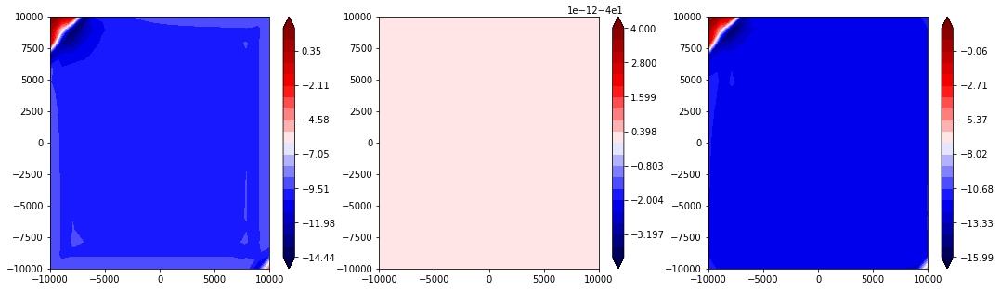

traction


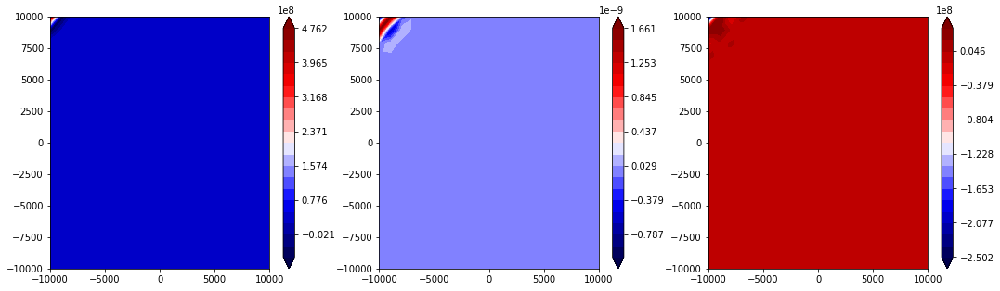

state


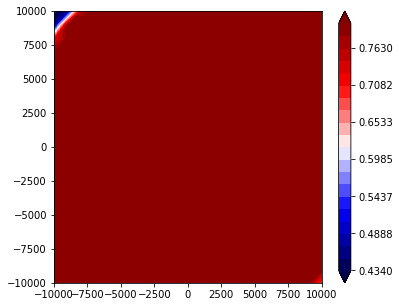

1921 37.1545159608
1922 37.1545159609
1923 37.154515961
1924 37.154515961
1925 37.1545159611
1926 37.1545159612
1927 37.1545159612
1928 37.1545159612
1929 37.1545159612
1930 37.1545159613
V


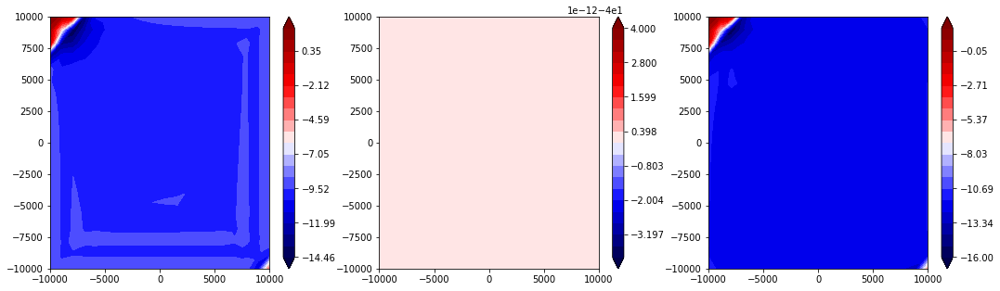

traction


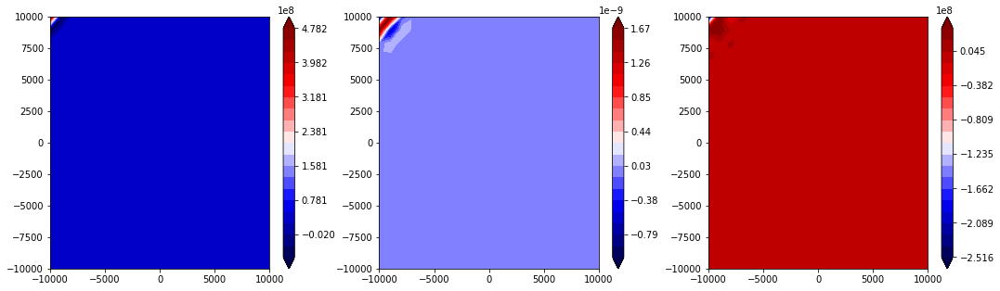

state


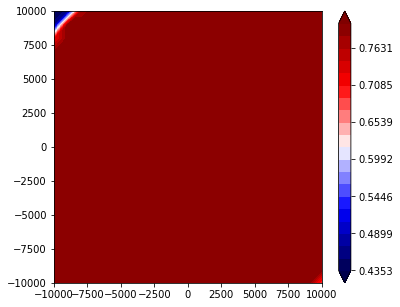

1931 37.1545159614
1932 37.1545159614
1933 37.1545159614
1934 37.1545159615
1935 37.1545159615
1936 37.1545159616
1937 37.1545159617
1938 37.1545159617
1939 37.1545159617
1940 37.1545159618
V


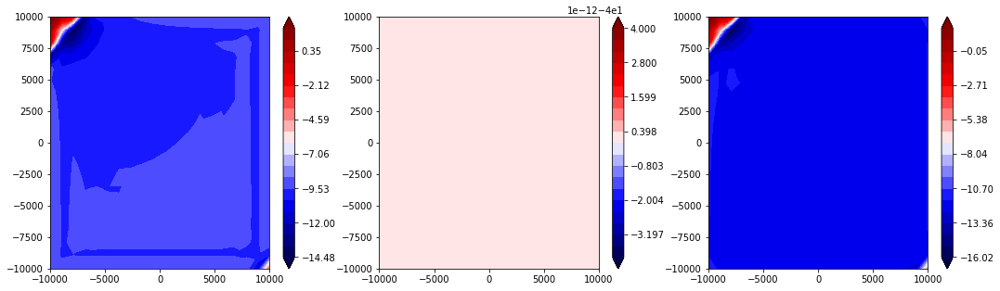

traction


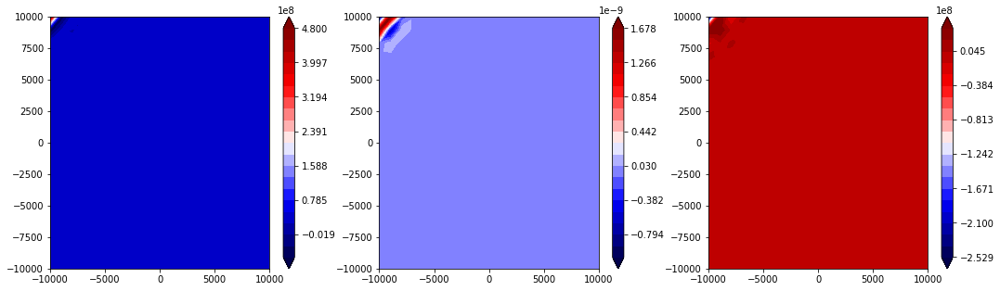

state


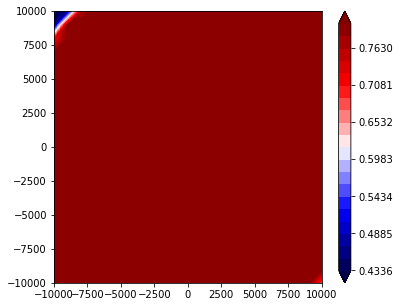

1941 37.1545159619
1942 37.1545159619
1943 37.154515962
1944 37.1545159621
1945 37.1545159621
1946 37.1545159621
1947 37.1545159622
1948 37.1545159623
1949 37.1545159623
1950 37.1545159624
V


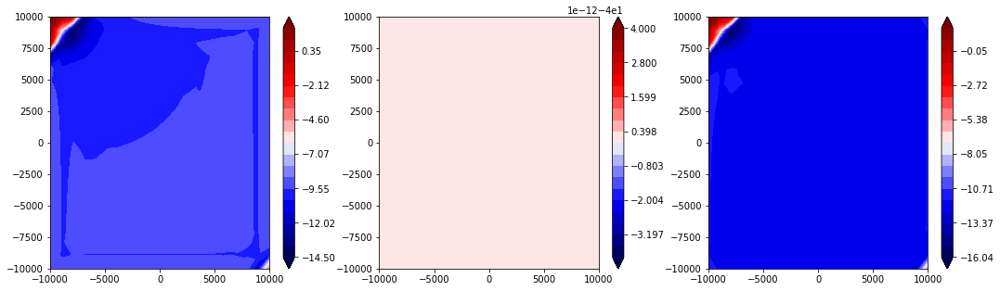

traction


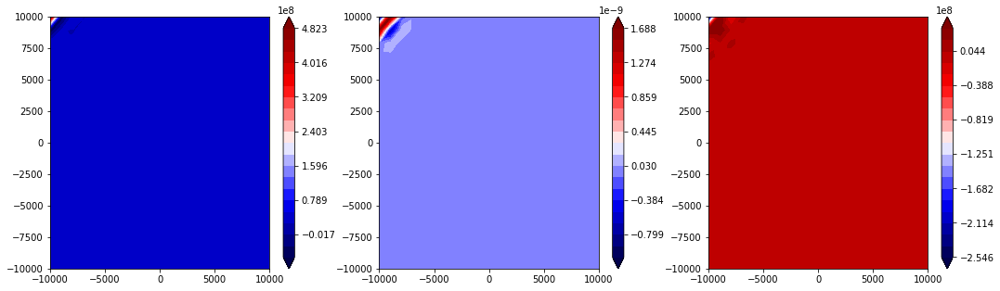

state


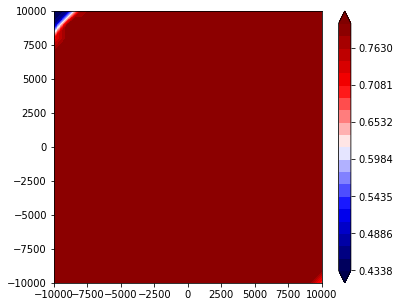

1951 37.1545159624
1952 37.1545159625
1953 37.1545159626
1954 37.1545159626
1955 37.1545159627
1956 37.1545159627
1957 37.1545159628
1958 37.1545159629
1959 37.1545159629
1960 37.154515963
V


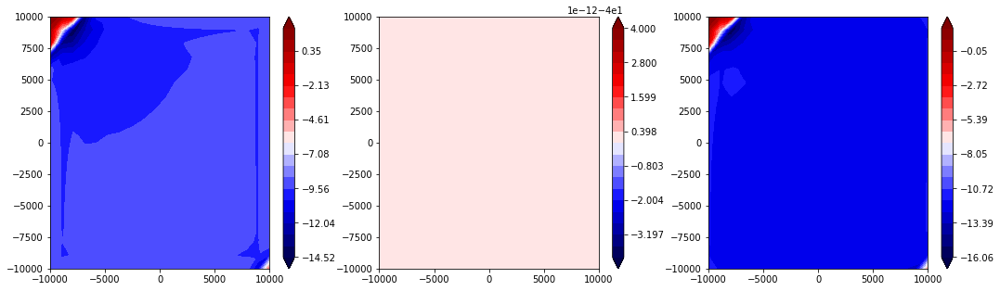

traction


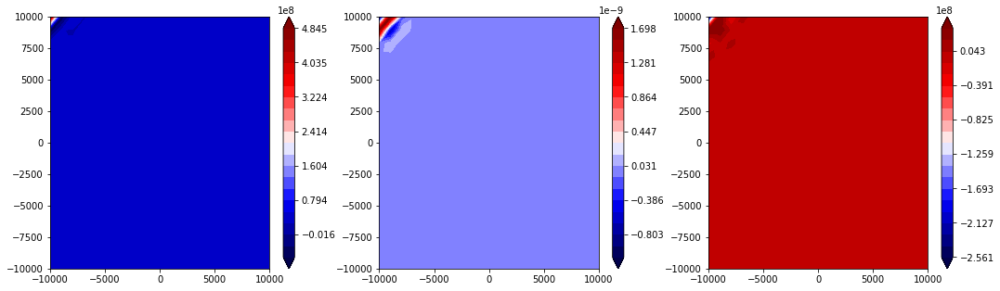

state


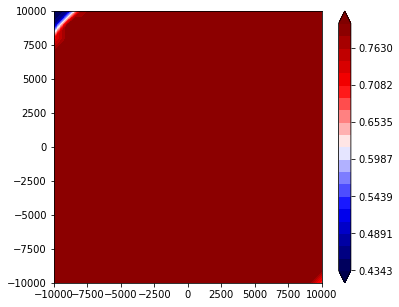

1961 37.154515963
1962 37.154515963
1963 37.1545159631
1964 37.1545159632
1965 37.1545159632
1966 37.1545159632
1967 37.1545159633
1968 37.1545159633
1969 37.1545159634
1970 37.1545159634
V


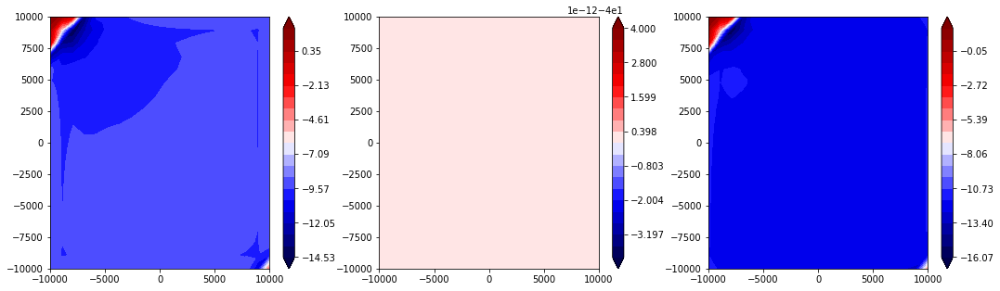

traction


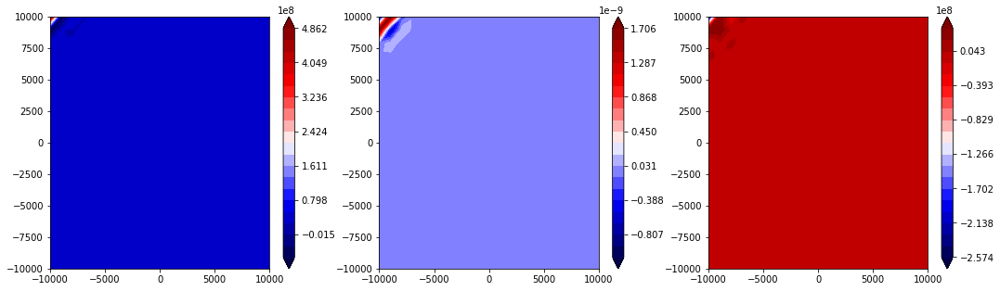

state


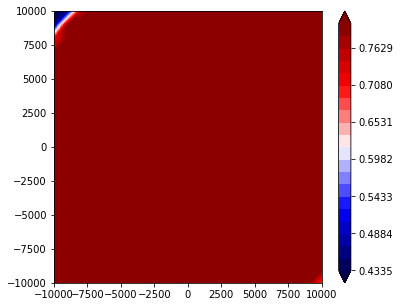

1971 37.1545159635
1972 37.1545159635
1973 37.1545159636
1974 37.1545159636
1975 37.1545159637
1976 37.1545159638
1977 37.1545159639
1978 37.1545159639
1979 37.1545159639
1980 37.154515964
V


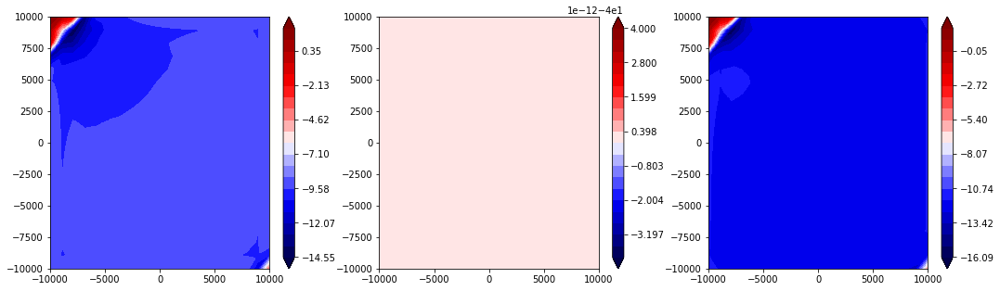

traction


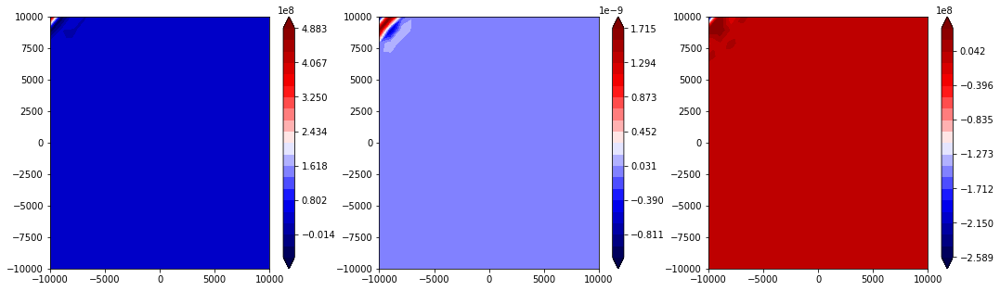

state


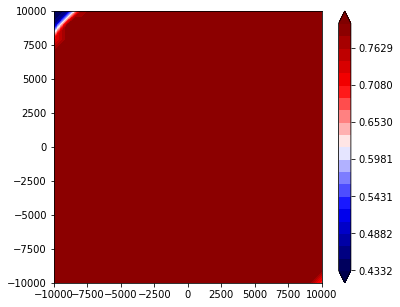

1981 37.154515964
1982 37.1545159641
1983 37.1545159641
1984 37.1545159642
1985 37.1545159643
1986 37.1545159643
1987 37.1545159644
1988 37.1545159645
1989 37.1545159645
1990 37.1545159645
V


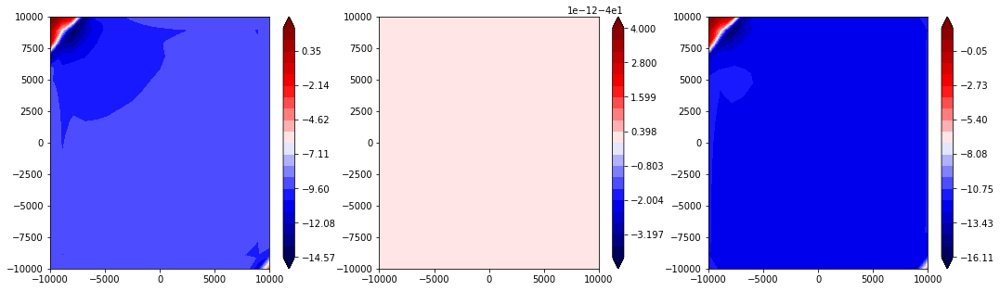

traction


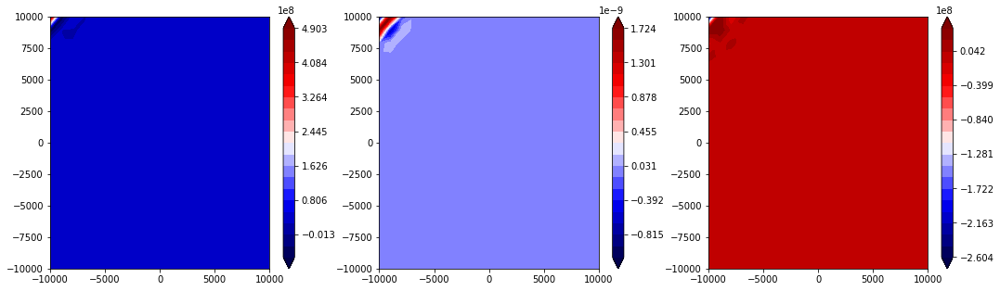

state


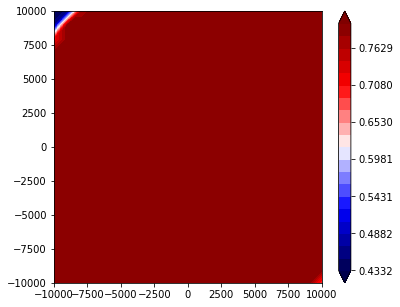

1991 37.1545159646
1992 37.1545159646
1993 37.1545159647
1994 37.1545159647
1995 37.1545159648
1996 37.1545159648
1997 37.1545159649
1998 37.154515965
1999 37.154515965
2000 37.1545159651
V


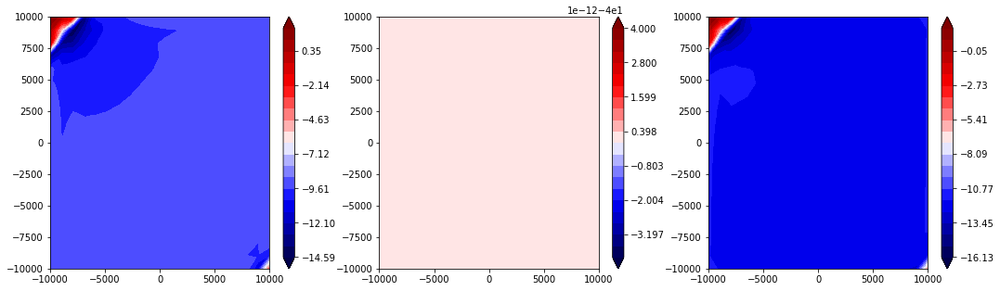

traction


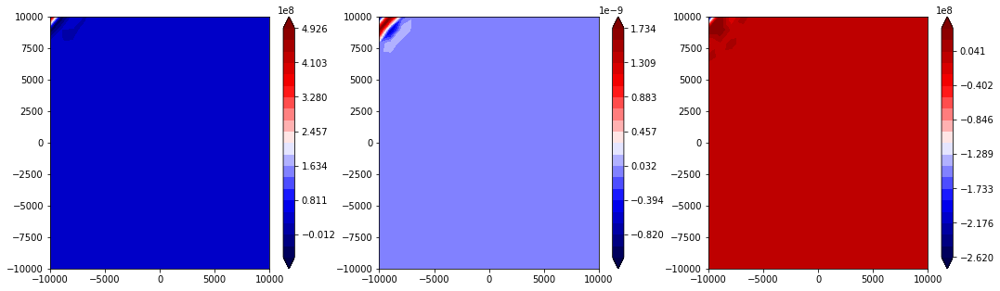

state


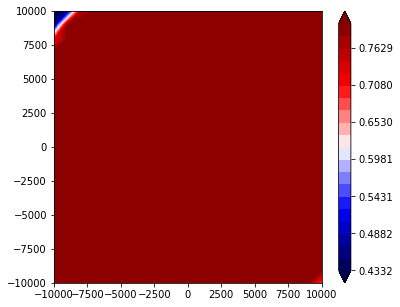

2001 37.1545159651
2002 37.1545159652
2003 37.1545159652
2004 37.1545159653
2005 37.1545159654
2006 37.1545159654
2007 37.1545159655
2008 37.1545159655
2009 37.1545159656
2010 37.1545159656
V


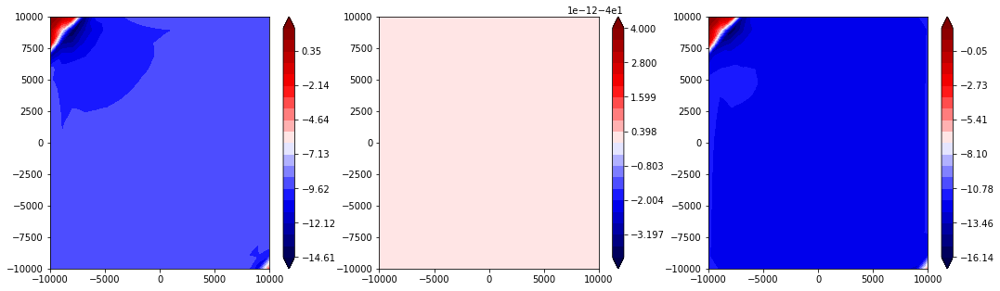

traction


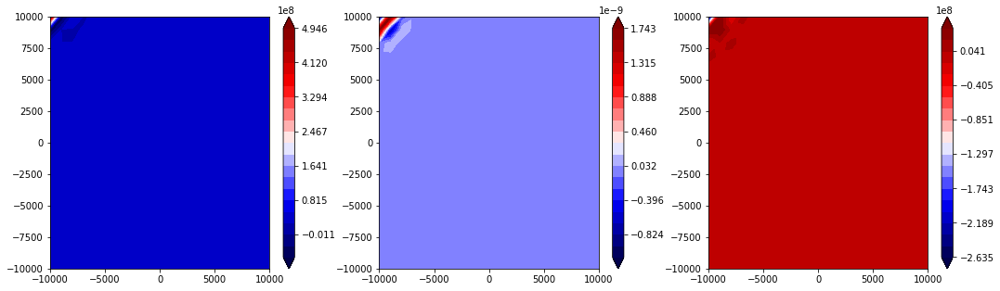

state


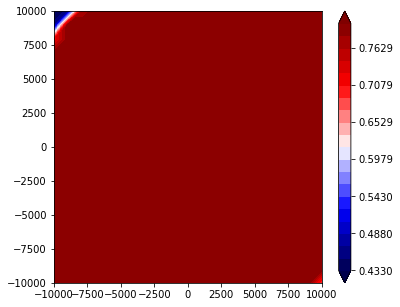

2011 37.1545159657
2012 37.1545159657
2013 37.1545159657
2014 37.1545159658
2015 37.1545159659
2016 37.1545159659
2017 37.154515966
2018 37.154515966
2019 37.1545159661
2020 37.1545159661
V


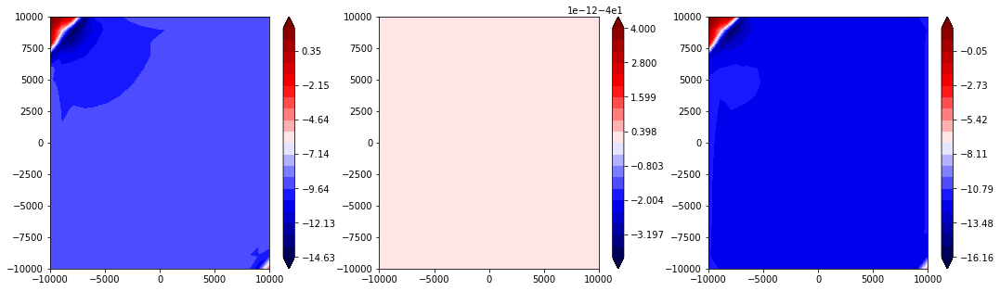

traction


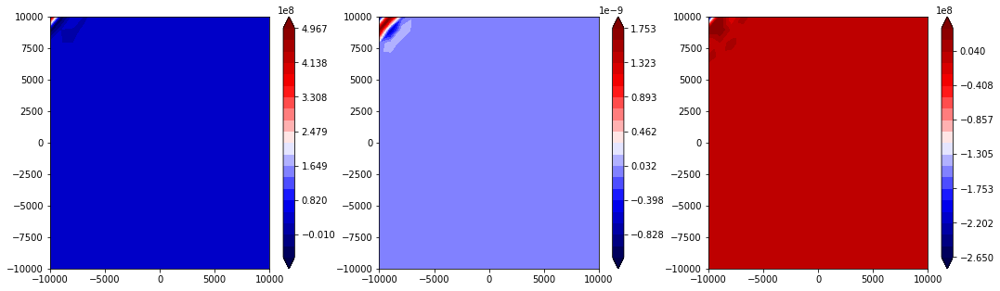

state


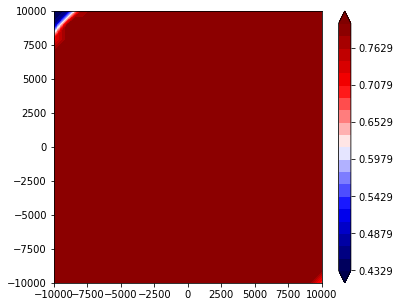

2021 37.1545159662
2022 37.1545159662
2023 37.1545159663
2024 37.1545159664
2025 37.1545159664
2026 37.1545159665
2027 37.1545159665
2028 37.1545159666
2029 37.1545159666
2030 37.1545159667
V


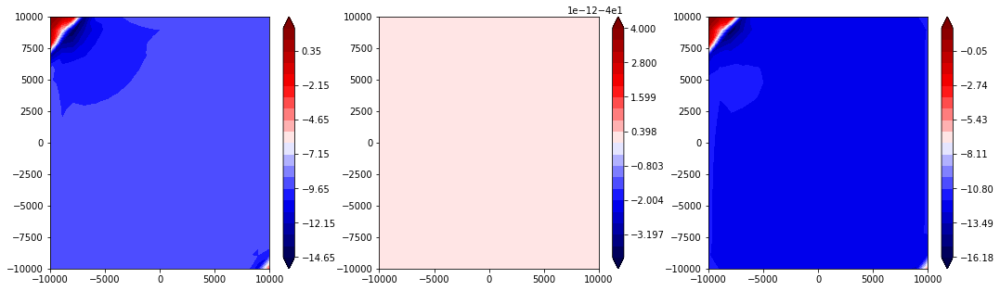

traction


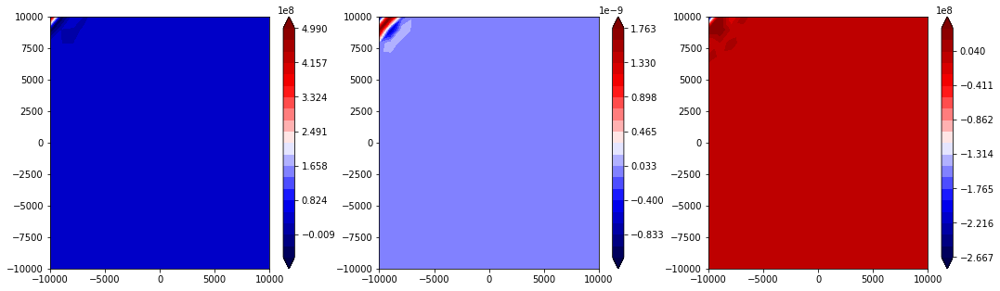

state


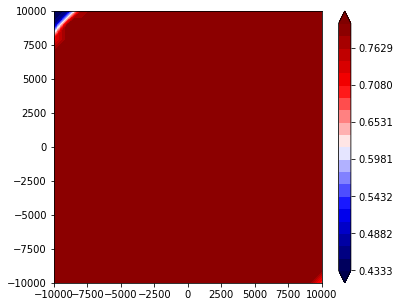

2031 37.1545159667
2032 37.1545159668
2033 37.1545159669
2034 37.1545159669
2035 37.1545159669
2036 37.154515967
2037 37.154515967
2038 37.1545159671
2039 37.1545159671
2040 37.1545159672
V


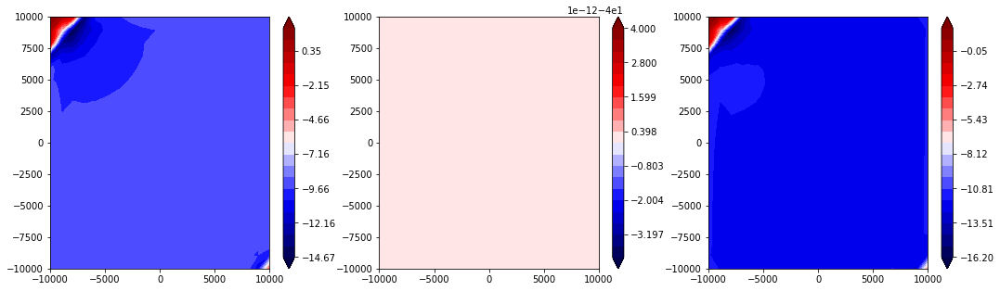

traction


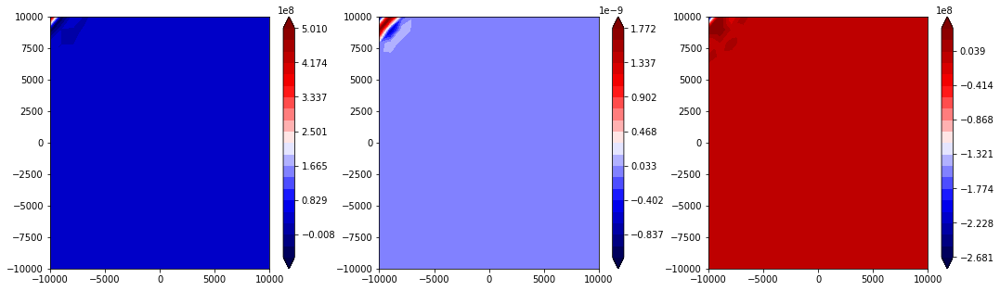

state


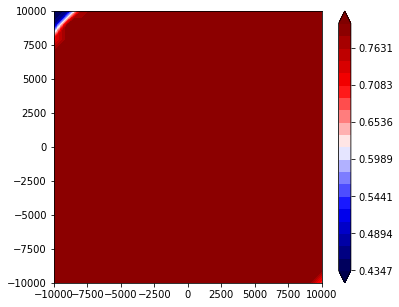

2041 37.1545159672
2042 37.1545159673
2043 37.1545159673
2044 37.1545159674
2045 37.1545159674
2046 37.1545159674
2047 37.1545159675
2048 37.1545159676
2049 37.1545159676
2050 37.1545159676
V


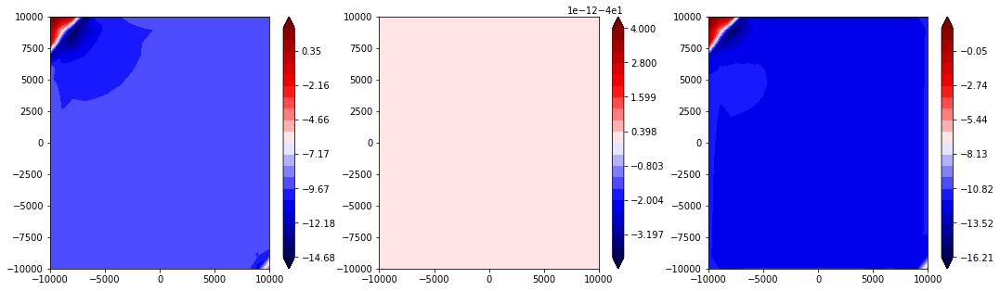

traction


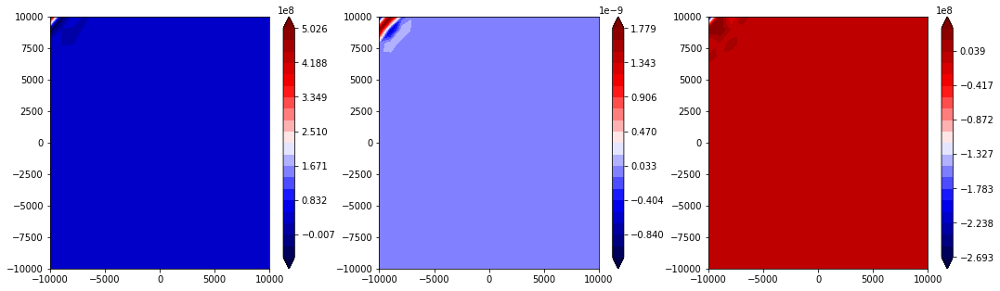

state


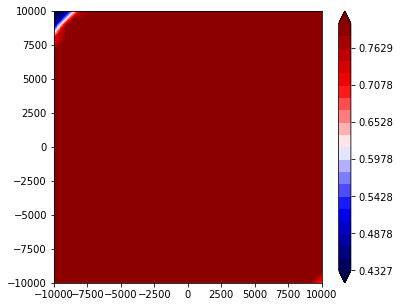

2051 37.1545159677
2052 37.1545159677
2053 37.1545159678
2054 37.1545159679
2055 37.1545159679
2056 37.154515968
2057 37.1545159681
2058 37.1545159681
2059 37.1545159681
2060 37.1545159682
V


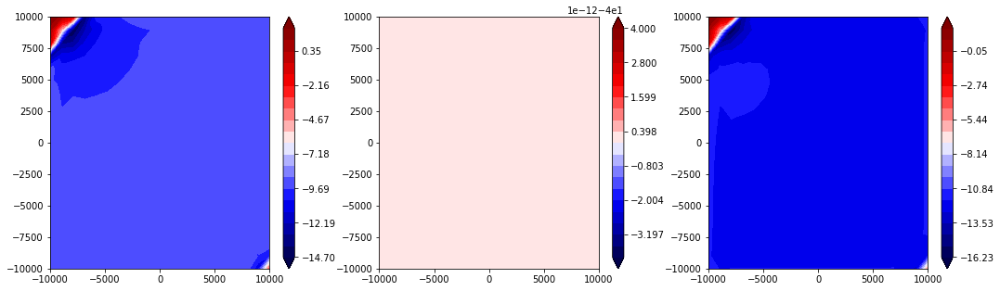

traction


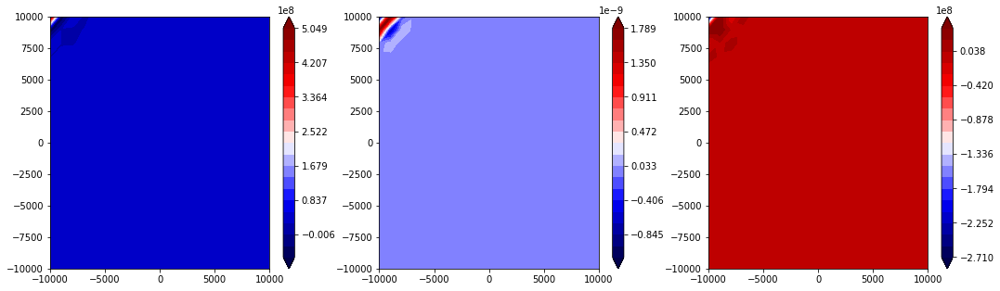

state


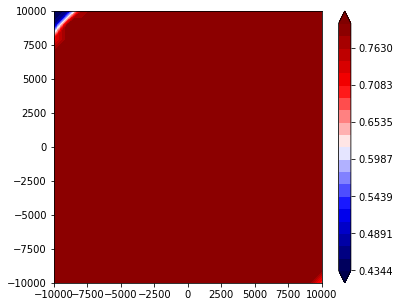

2061 37.1545159682
2062 37.1545159682
2063 37.1545159683
2064 37.1545159684
2065 37.1545159684
2066 37.1545159684
2067 37.1545159685
2068 37.1545159686
2069 37.1545159686
2070 37.1545159687
V


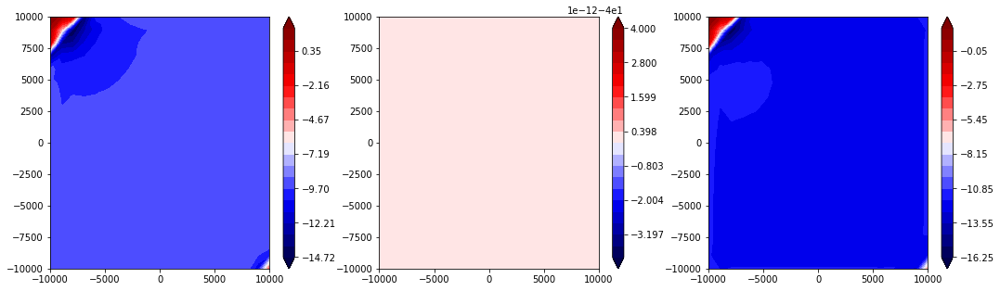

traction


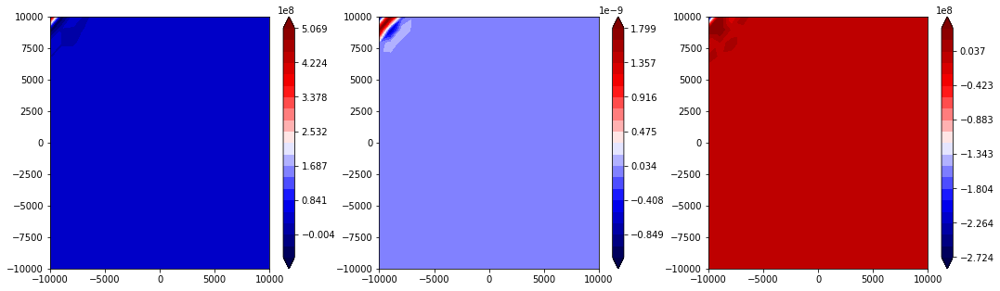

state


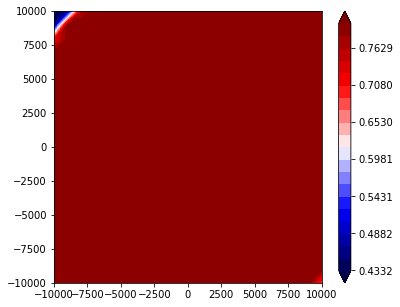

2071 37.1545159687
2072 37.1545159688
2073 37.1545159689
2074 37.1545159689
2075 37.1545159689
2076 37.154515969
2077 37.154515969
2078 37.1545159691
2079 37.1545159692
2080 37.1545159692
V


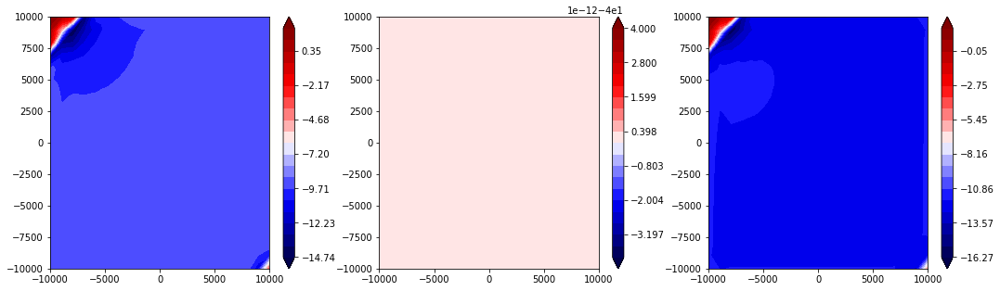

traction


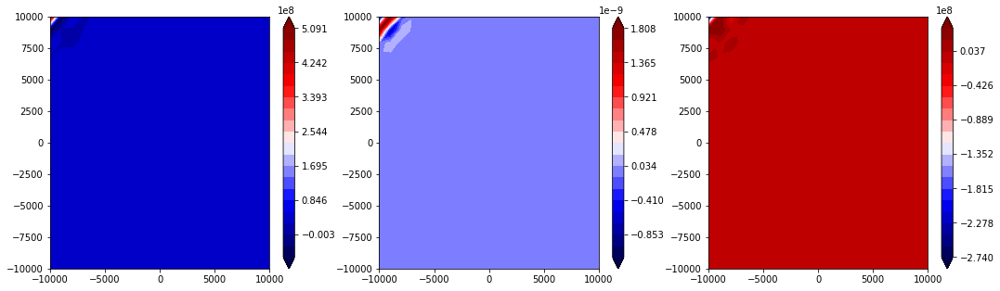

state


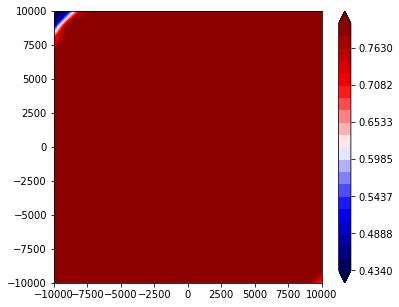

2081 37.1545159693
2082 37.1545159693
2083 37.1545159694
2084 37.1545159694
2085 37.1545159695
2086 37.1545159695
2087 37.1545159696
2088 37.1545159697
2089 37.1545159697
2090 37.1545159697
V


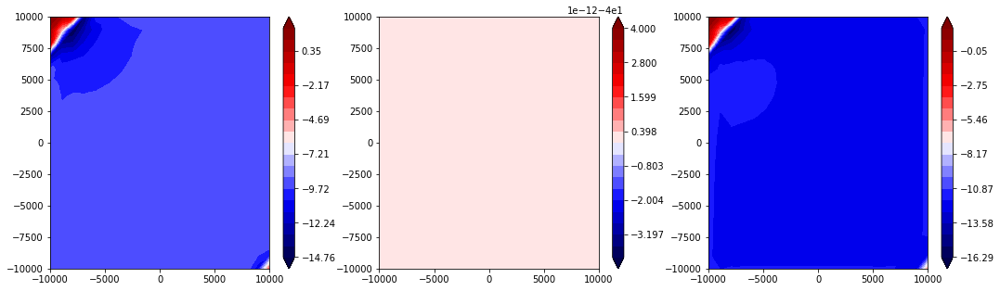

traction


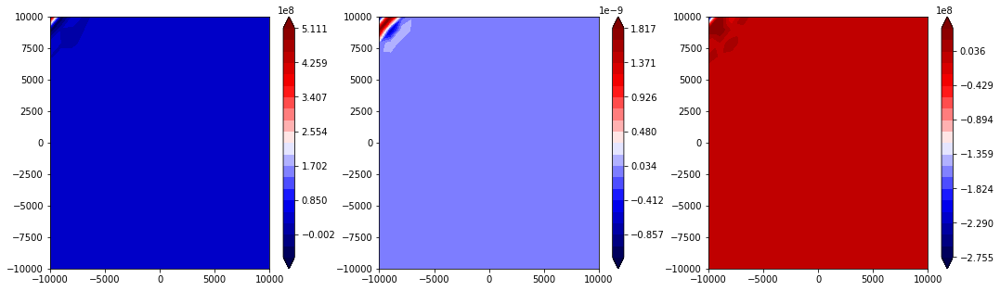

state


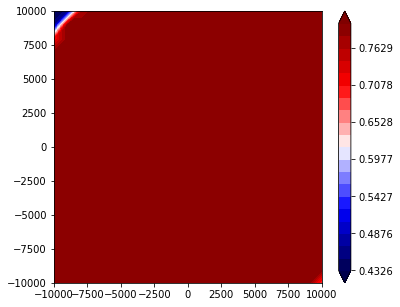

2091 37.1545159698
2092 37.1545159698
2093 37.1545159699
2094 37.15451597
2095 37.15451597
2096 37.1545159701
2097 37.1545159701
2098 37.1545159702
2099 37.1545159702
2100 37.1545159703
V


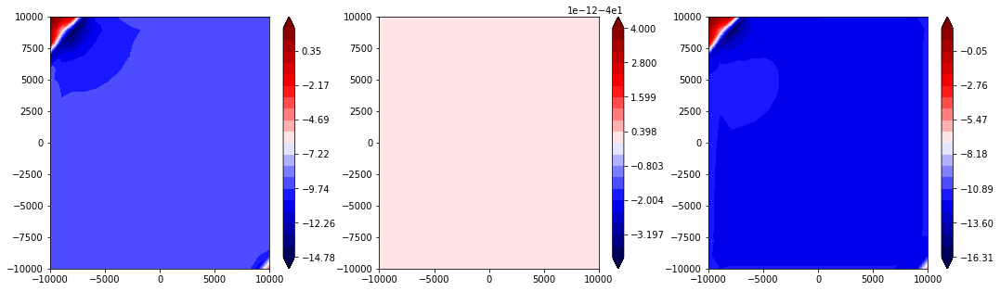

traction


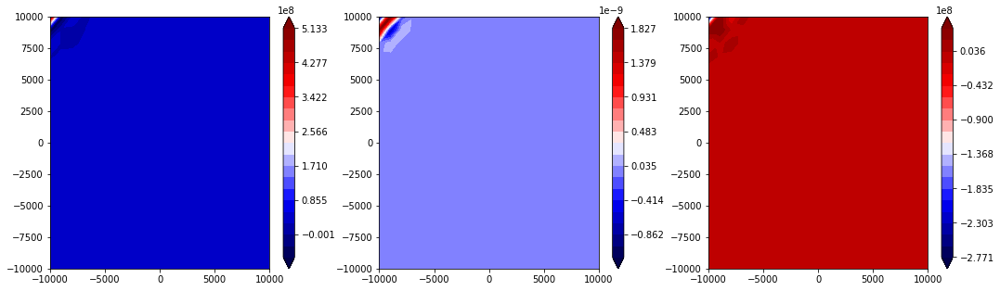

state


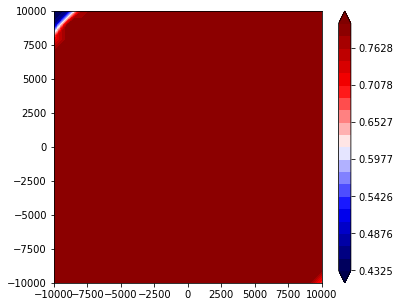

2101 37.1545159704
2102 37.1545159704
2103 37.1545159704
2104 37.1545159705
2105 37.1545159705
2106 37.1545159706
2107 37.1545159707
2108 37.1545159707
2109 37.1545159707
2110 37.1545159708
V


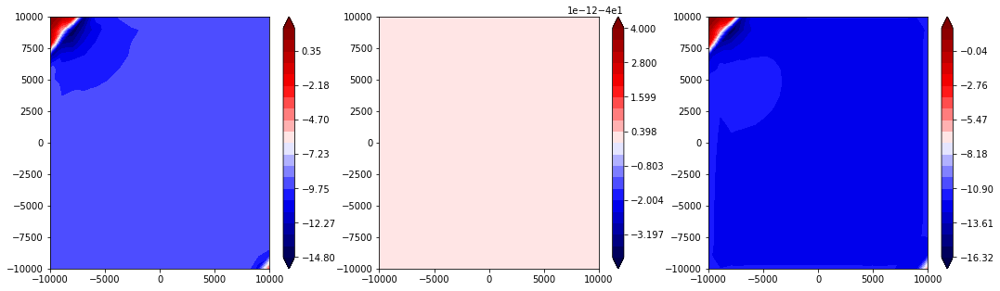

traction


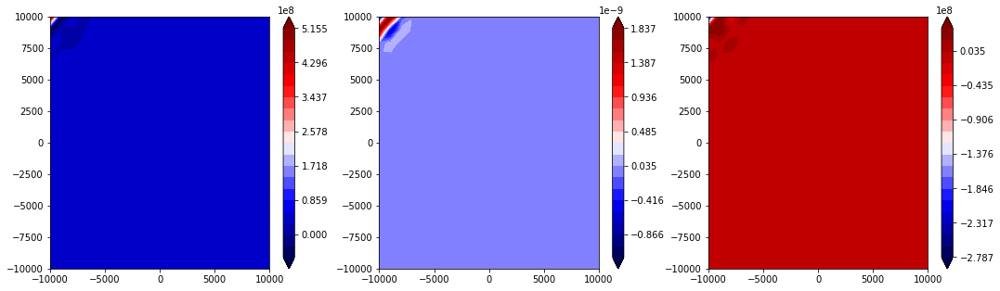

state


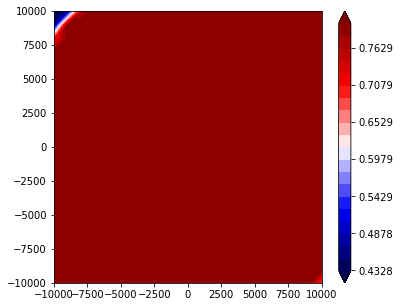

2111 37.1545159708
2112 37.1545159709
2113 37.1545159709
2114 37.154515971
2115 37.1545159711
2116 37.1545159711
2117 37.1545159712
2118 37.1545159712
2119 37.1545159713
2120 37.1545159713
V


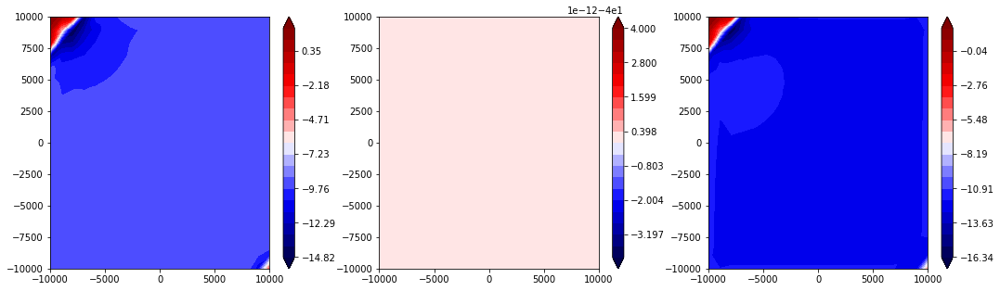

traction


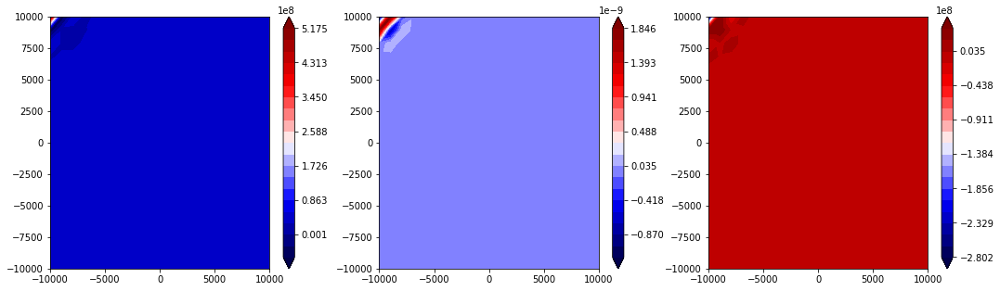

state


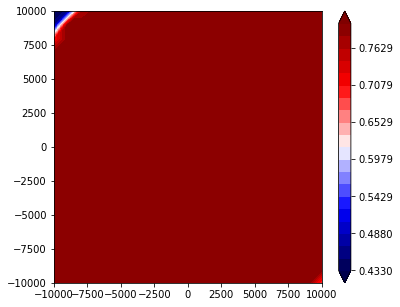

2121 37.1545159713
2122 37.1545159714
2123 37.1545159714
2124 37.1545159715
2125 37.1545159715
2126 37.1545159716
2127 37.1545159717
2128 37.1545159717
2129 37.1545159717
2130 37.1545159718
V


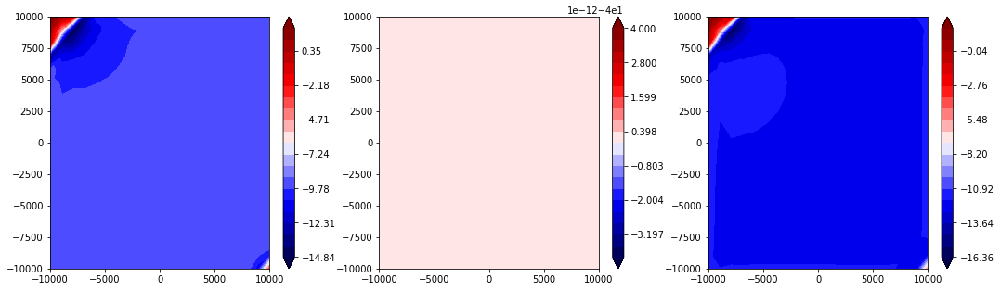

traction


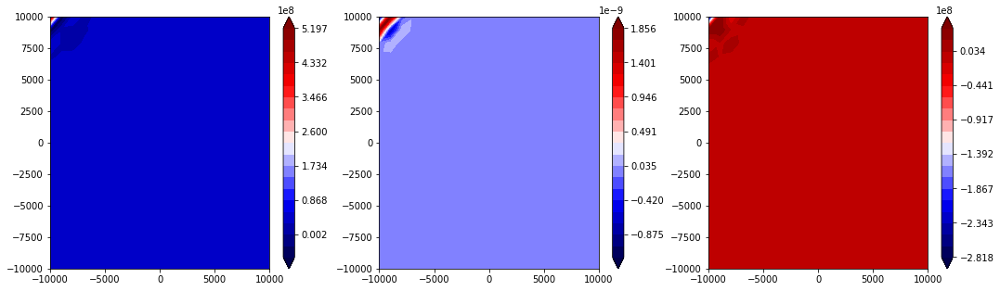

state


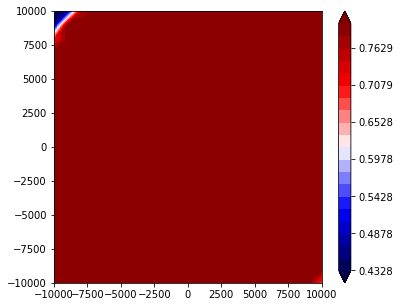

2131 37.1545159719
2132 37.1545159719
2133 37.154515972
2134 37.154515972
2135 37.1545159721
2136 37.1545159721
2137 37.1545159722
2138 37.1545159722
2139 37.1545159723
2140 37.1545159723
V


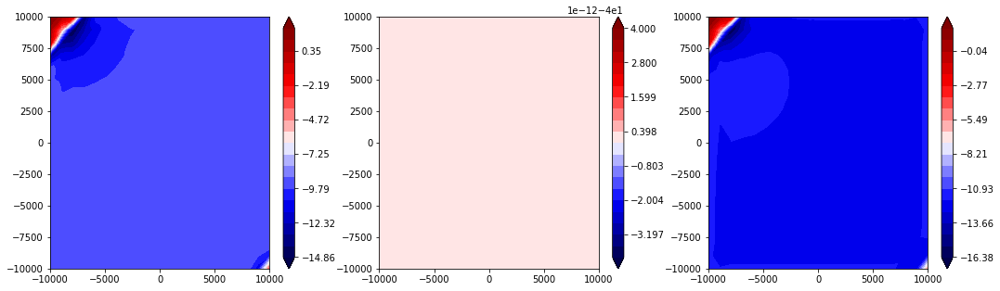

traction


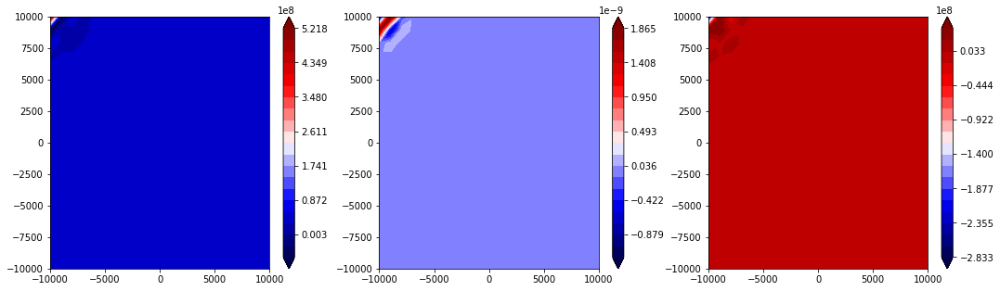

state


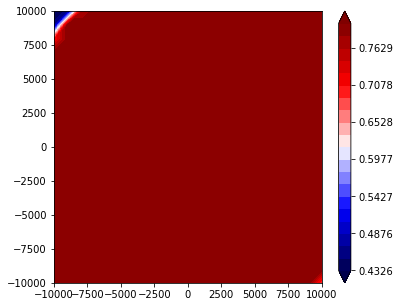

2141 37.1545159724
2142 37.1545159725
2143 37.1545159725
2144 37.1545159725
2145 37.1545159726
2146 37.1545159726
2147 37.1545159727
2148 37.1545159727
2149 37.1545159728
2150 37.1545159729
V


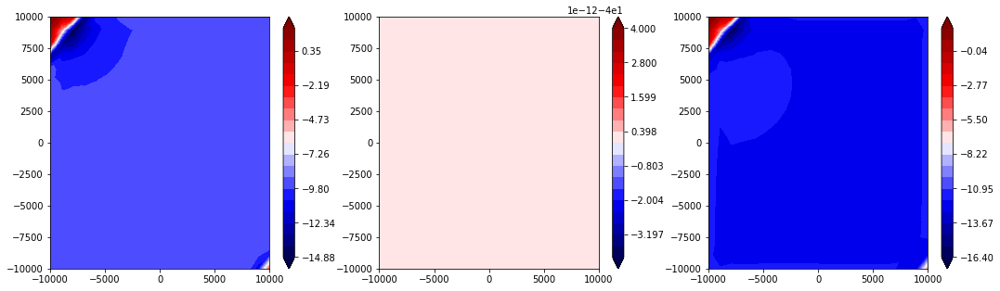

traction


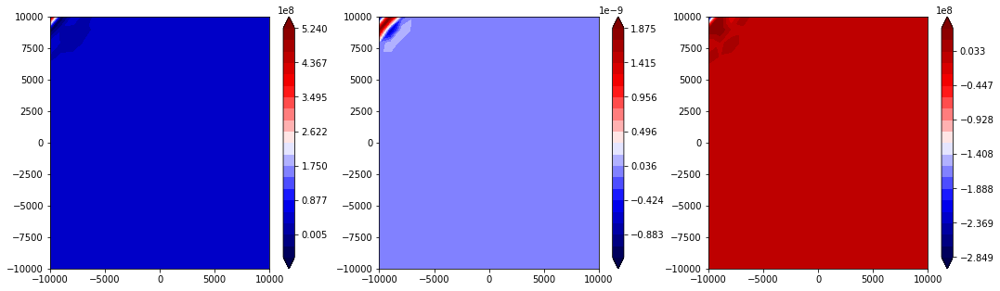

state


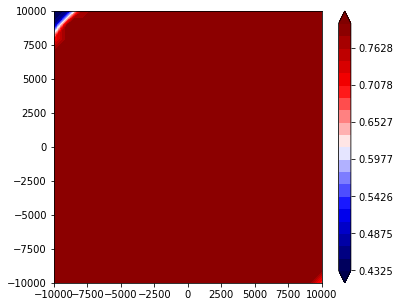

2151 37.1545159729
2152 37.154515973
2153 37.154515973
2154 37.1545159731
2155 37.1545159731
2156 37.1545159732
2157 37.1545159732
2158 37.1545159733
2159 37.1545159733
2160 37.1545159734
V


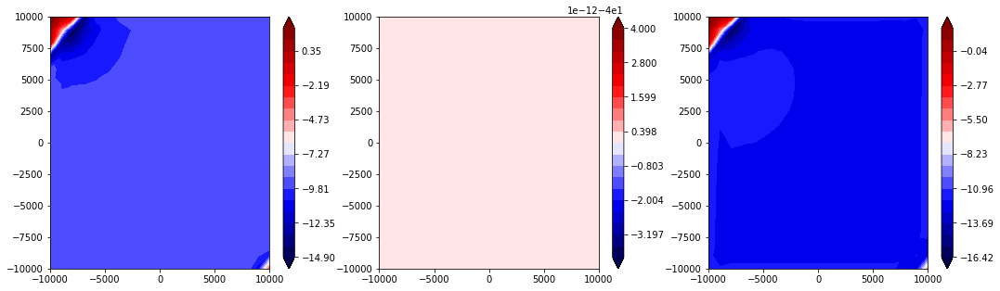

traction


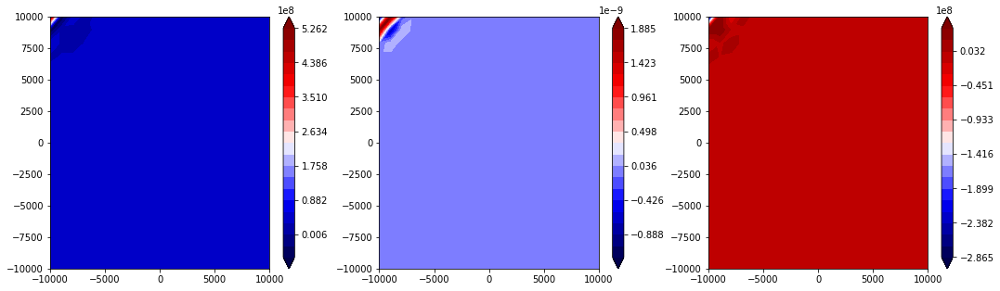

state


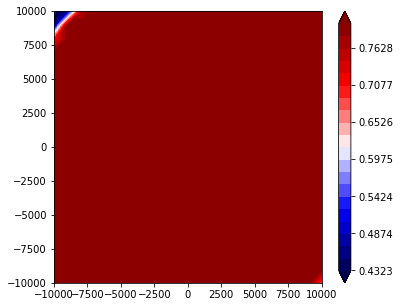

2161 37.1545159735
2162 37.1545159735
2163 37.1545159735
2164 37.1545159736
2165 37.1545159736
2166 37.1545159737
2167 37.1545159738
2168 37.1545159738
2169 37.1545159738
2170 37.1545159739
V


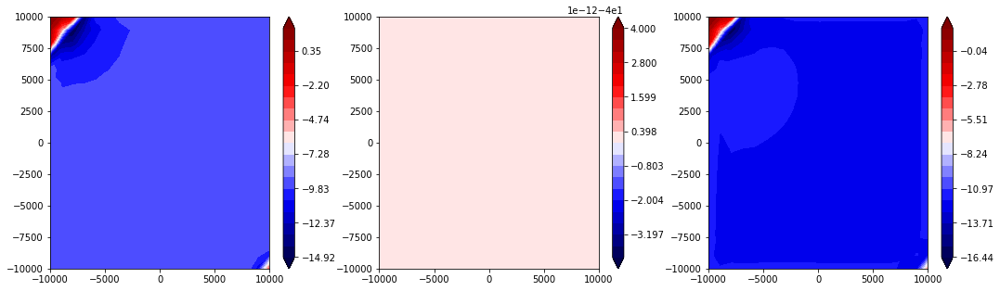

traction


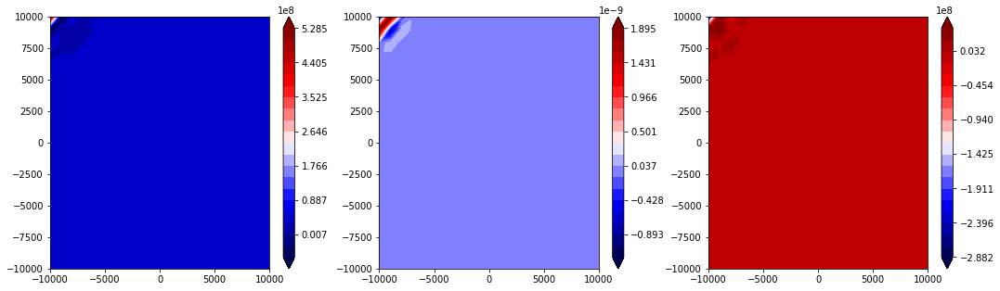

state


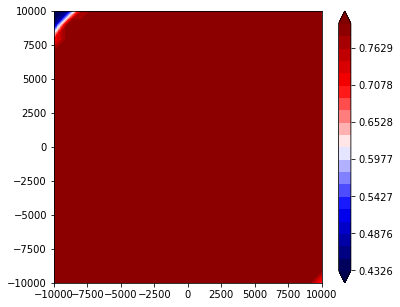

2171 37.1545159739
2172 37.154515974
2173 37.1545159741
2174 37.1545159741
2175 37.1545159742
2176 37.1545159742
2177 37.1545159743
2178 37.1545159743
2179 37.1545159744
2180 37.1545159745
V


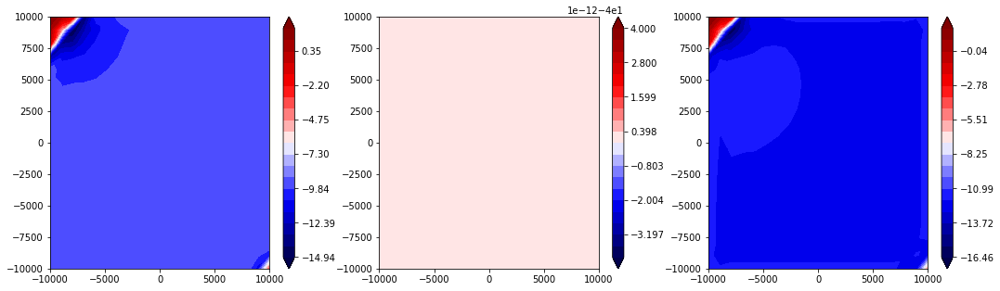

traction


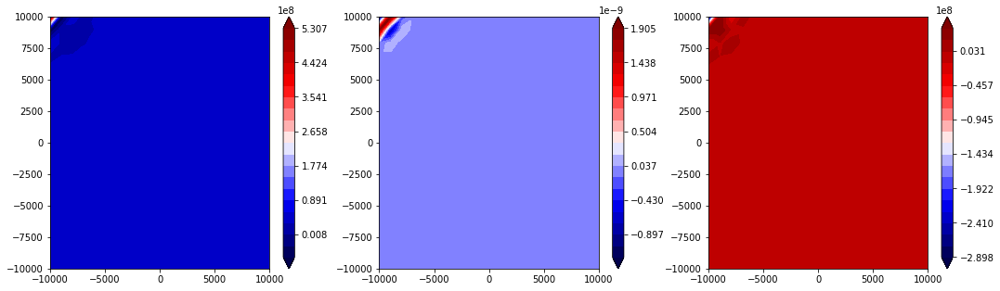

state


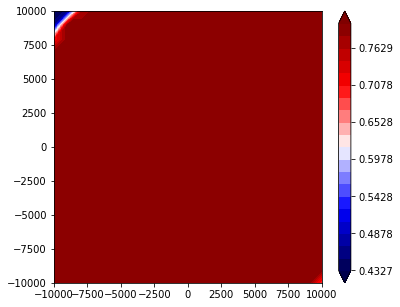

2181 37.1545159745
2182 37.1545159745
2183 37.1545159746
2184 37.1545159746
2185 37.1545159747
2186 37.1545159748
2187 37.1545159748
2188 37.1545159748
2189 37.1545159749
2190 37.1545159749
V


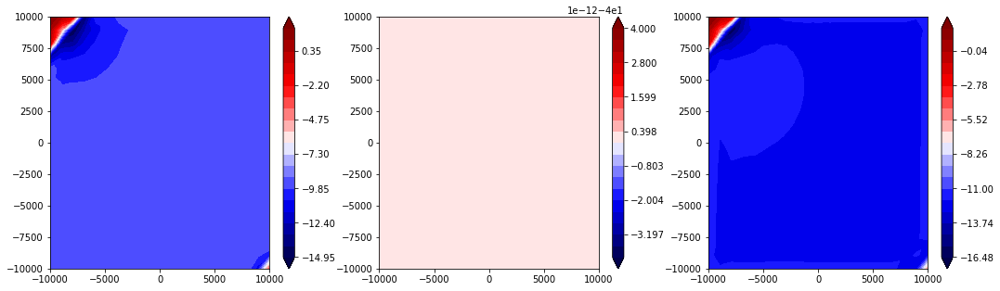

traction


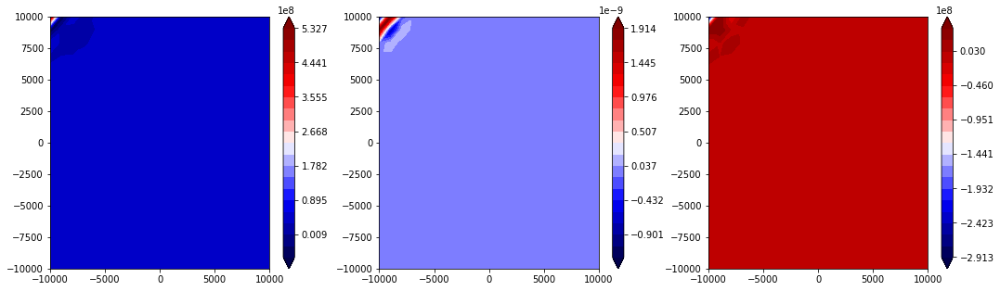

state


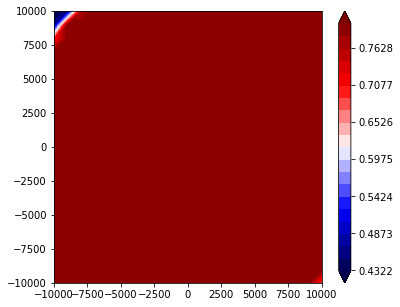

2191 37.154515975
2192 37.1545159751
2193 37.1545159751
2194 37.1545159751
2195 37.1545159752
2196 37.1545159752
2197 37.1545159753
2198 37.1545159754
2199 37.1545159754
2200 37.1545159754
V


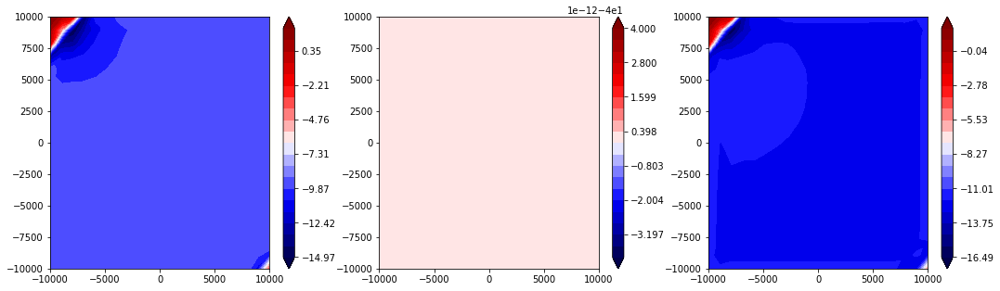

traction


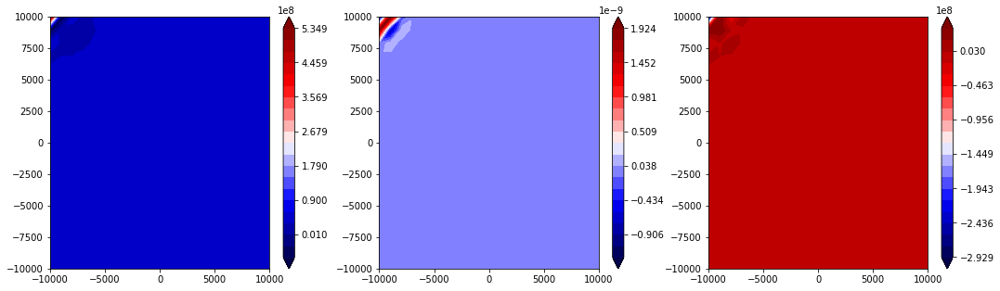

state


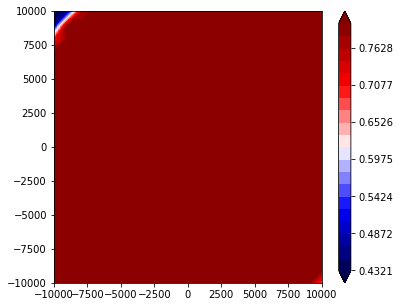

2201 37.1545159755
2202 37.1545159755
2203 37.1545159756
2204 37.1545159756
2205 37.1545159757
2206 37.1545159757
2207 37.1545159757
2208 37.1545159758
2209 37.1545159758
2210 37.1545159758
V


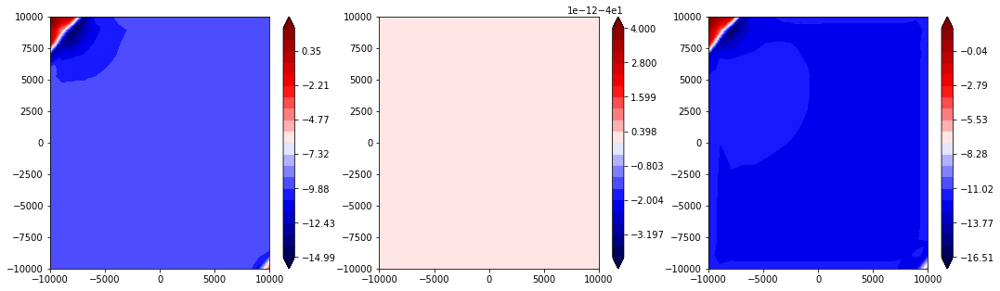

traction


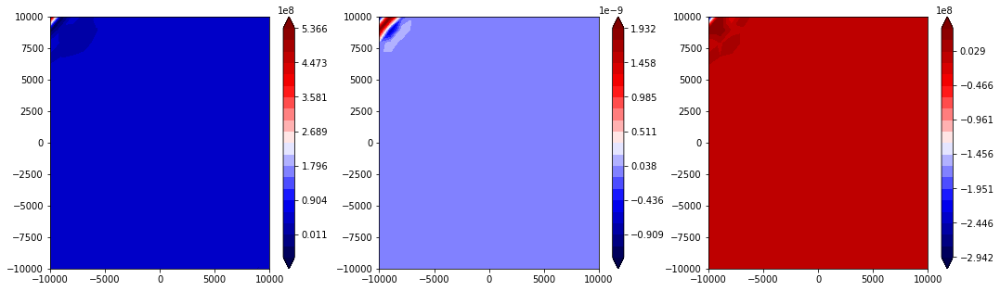

state


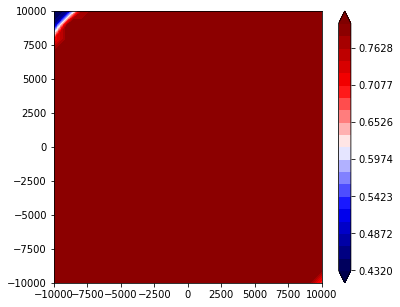

2211 37.1545159759
2212 37.1545159759
2213 37.154515976
2214 37.1545159761
2215 37.1545159761
2216 37.1545159761
2217 37.1545159762
2218 37.1545159762
2219 37.1545159763
2220 37.1545159764
V


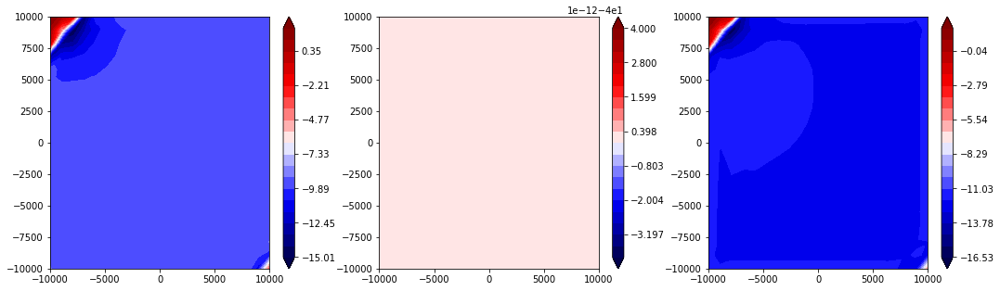

traction


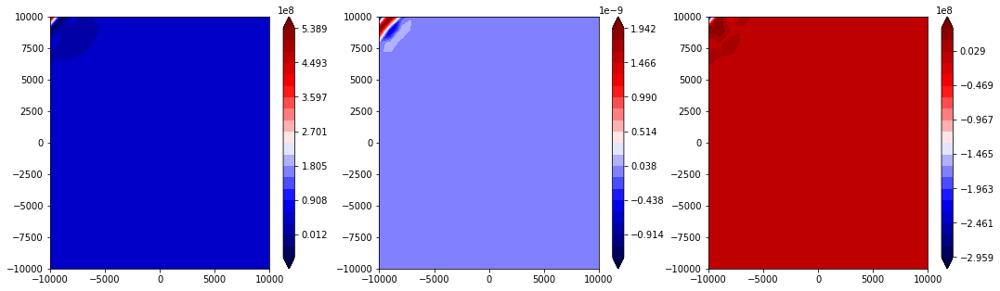

state


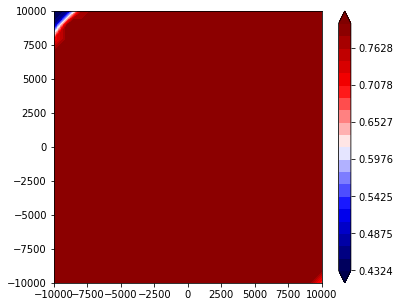

2221 37.1545159764
2222 37.1545159764
2223 37.1545159765
2224 37.1545159765
2225 37.1545159766
2226 37.1545159767
2227 37.1545159767
2228 37.1545159767
2229 37.1545159768
2230 37.1545159768
V


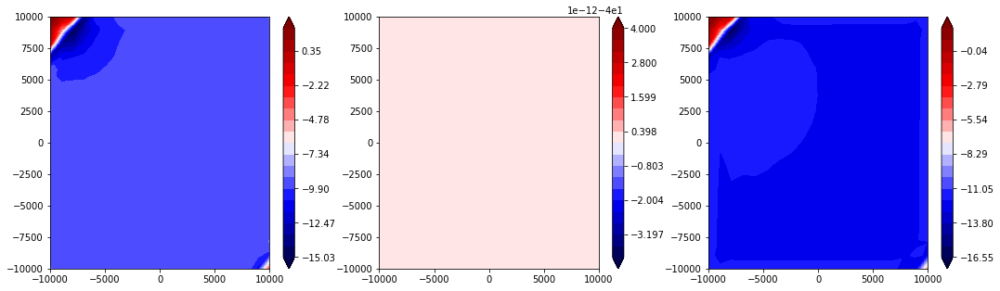

traction


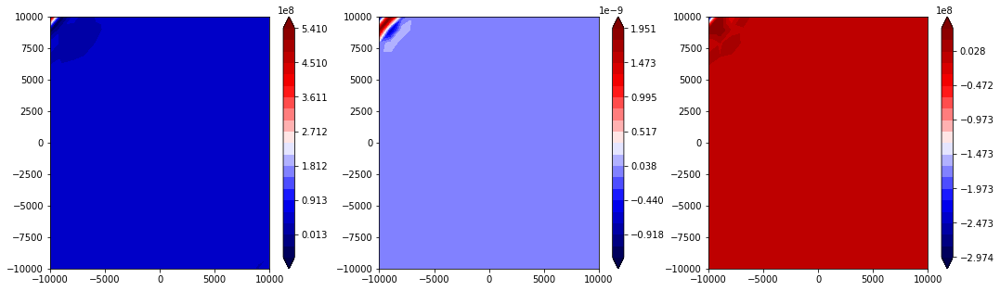

state


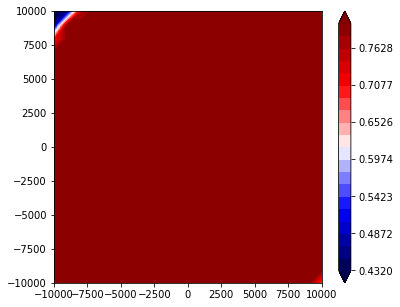

2231 37.1545159769
2232 37.1545159769
2233 37.154515977
2234 37.1545159771
2235 37.1545159771
2236 37.1545159772
2237 37.1545159772
2238 37.1545159773
2239 37.1545159773
2240 37.1545159774
V


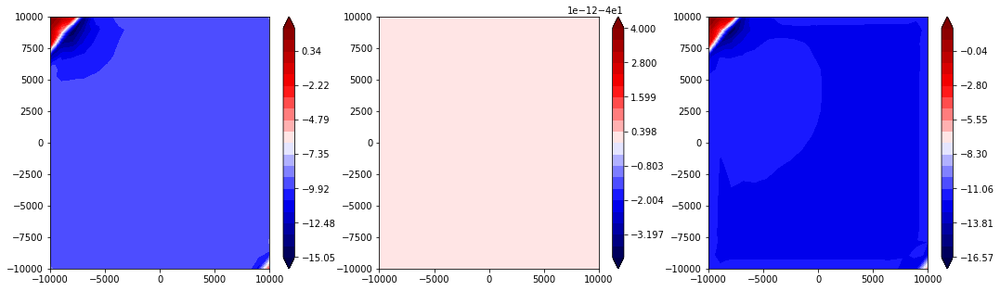

traction


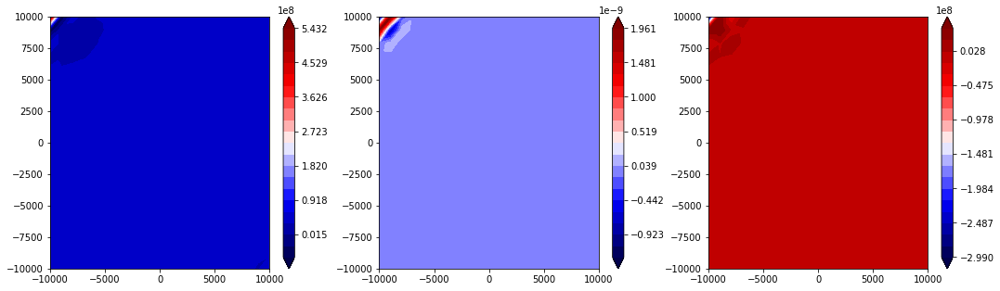

state


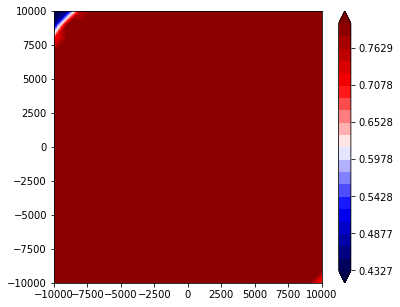

2241 37.1545159774
2242 37.1545159774
2243 37.1545159775
2244 37.1545159775
2245 37.1545159776
2246 37.1545159777
2247 37.1545159777
2248 37.1545159777
2249 37.1545159778
2250 37.1545159778
V


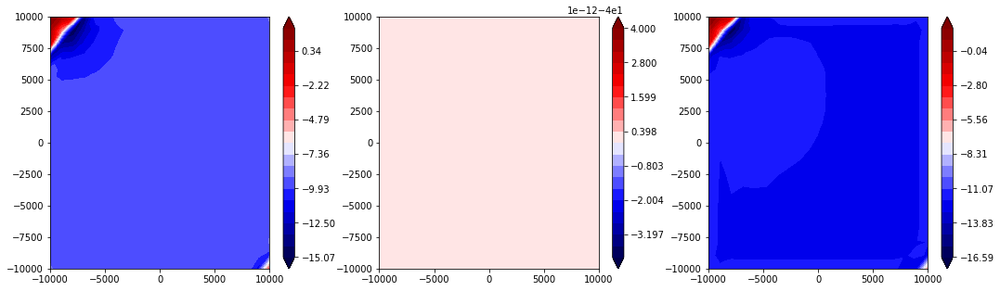

traction


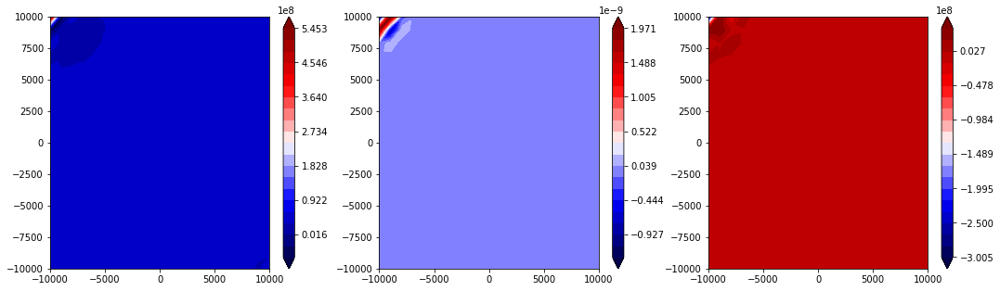

state


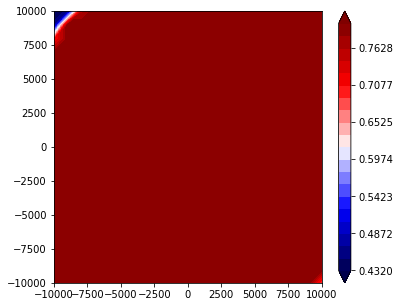

2251 37.1545159779
2252 37.154515978
2253 37.154515978
2254 37.154515978
2255 37.1545159781
2256 37.1545159781
2257 37.1545159782
2258 37.1545159782
2259 37.1545159783
2260 37.1545159783
V


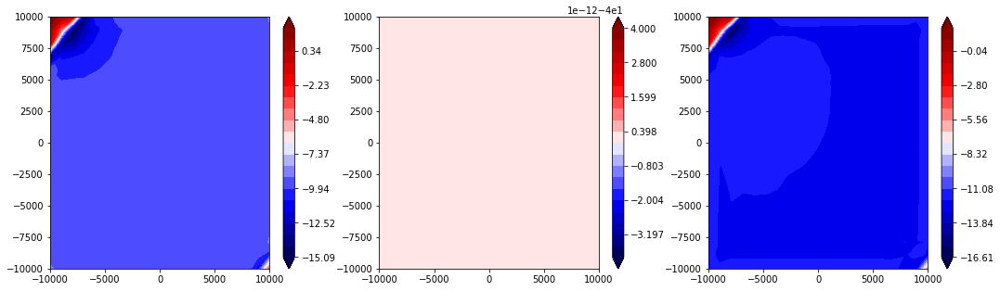

traction


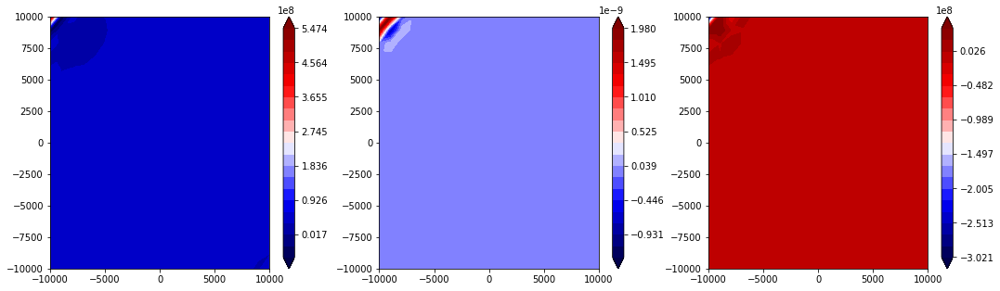

state


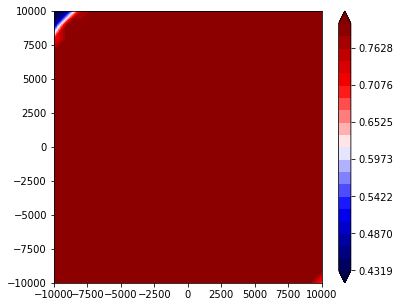

2261 37.1545159784
2262 37.1545159784
2263 37.1545159784
2264 37.1545159785
2265 37.1545159786
2266 37.1545159786
2267 37.1545159787
2268 37.1545159787
2269 37.1545159787
2270 37.1545159788
V


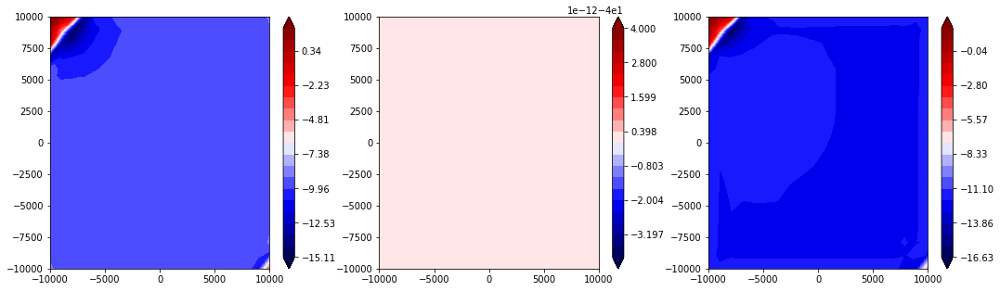

traction


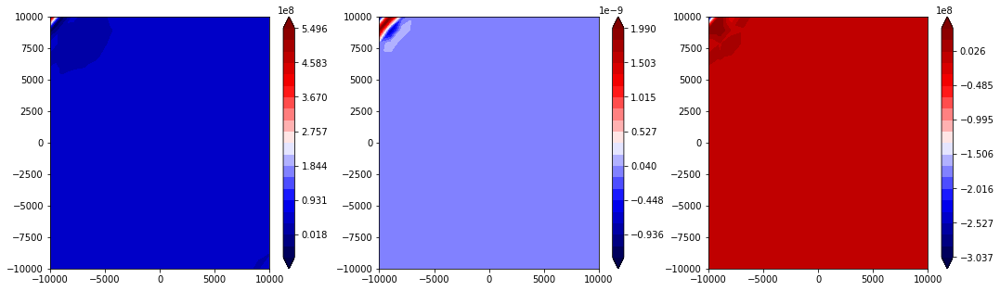

state


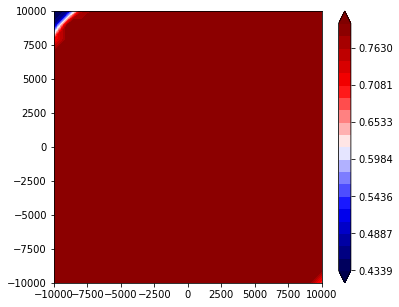

2271 37.1545159788
2272 37.1545159788
2273 37.1545159789
2274 37.1545159789
2275 37.154515979
2276 37.154515979
2277 37.1545159791
2278 37.1545159791
2279 37.1545159792
2280 37.1545159792
V


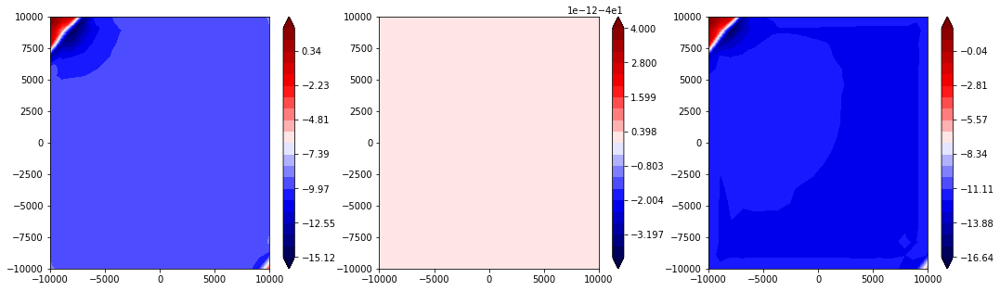

traction


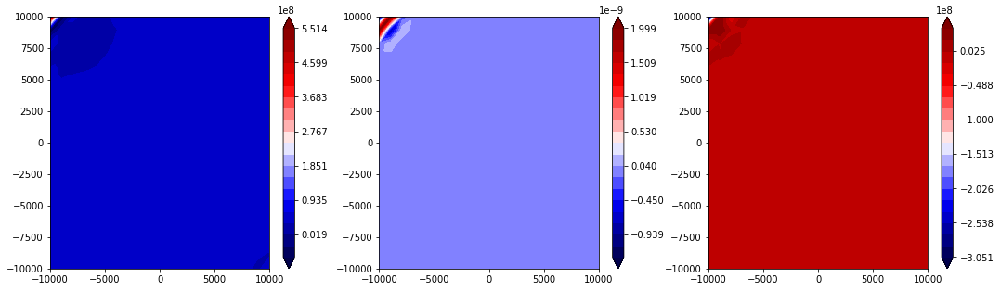

state


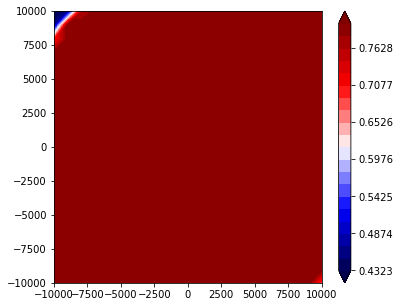

2281 37.1545159793
2282 37.1545159793
2283 37.1545159794
2284 37.1545159794
2285 37.1545159795
2286 37.1545159795
2287 37.1545159795
2288 37.1545159796
2289 37.1545159797
2290 37.1545159797
V


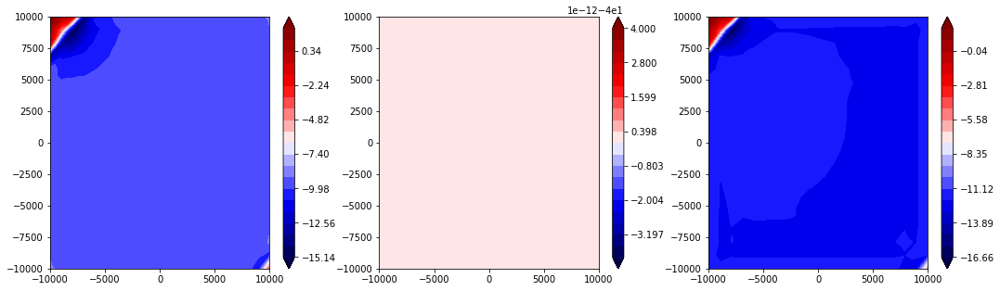

traction


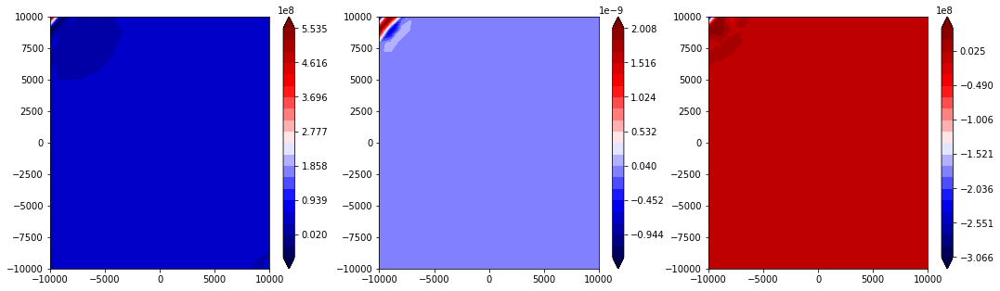

state


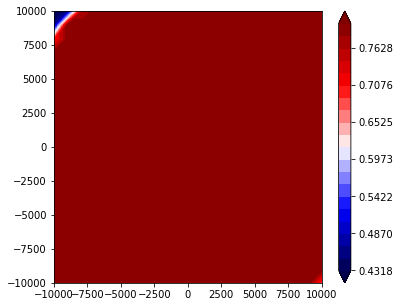

2291 37.1545159797
2292 37.1545159798
2293 37.1545159798
2294 37.1545159799
2295 37.15451598
2296 37.15451598
2297 37.15451598
2298 37.1545159801
2299 37.1545159801
2300 37.1545159802
V


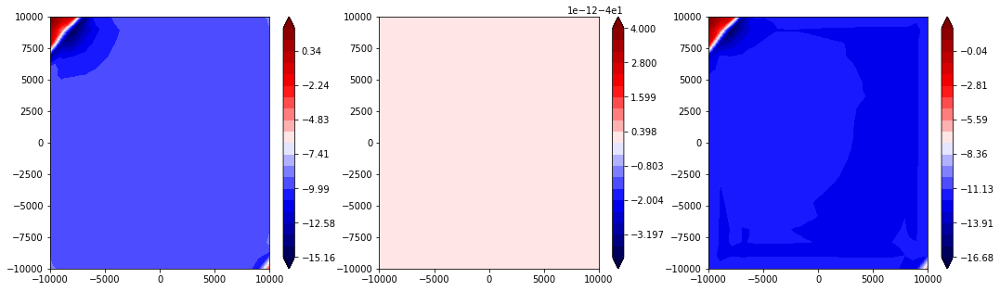

traction


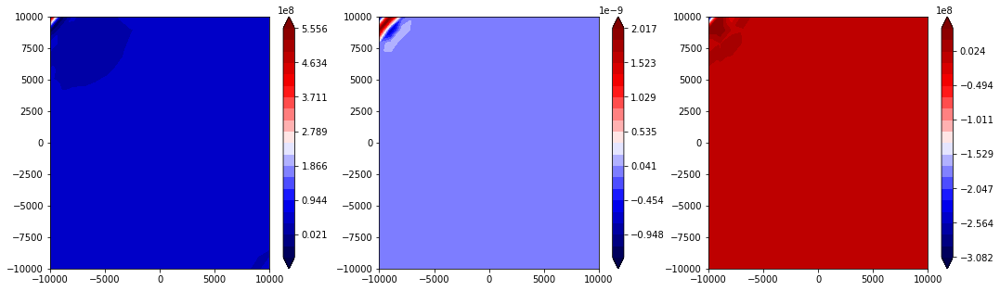

state


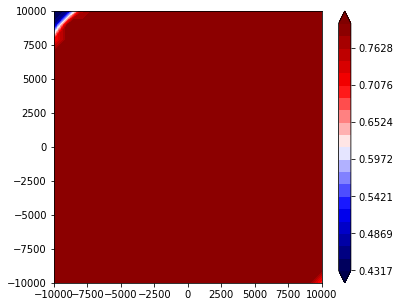

2301 37.1545159803
2302 37.1545159803
2303 37.1545159803
2304 37.1545159804
2305 37.1545159804
2306 37.1545159805
2307 37.1545159805
2308 37.1545159806
2309 37.1545159806
2310 37.1545159807
V


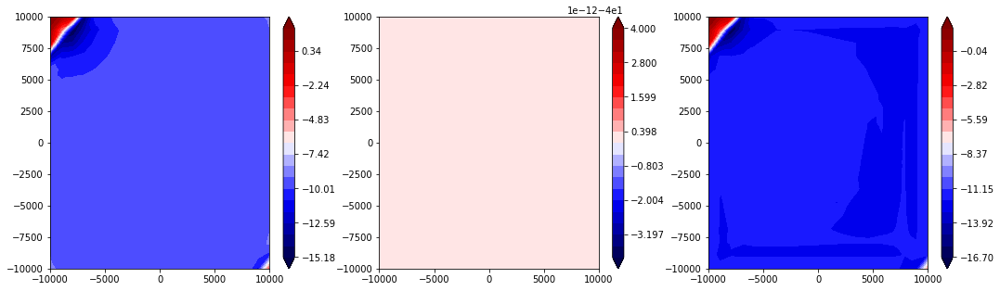

traction


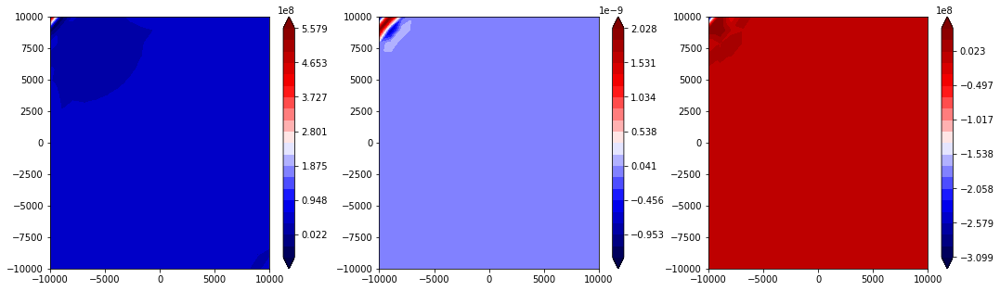

state


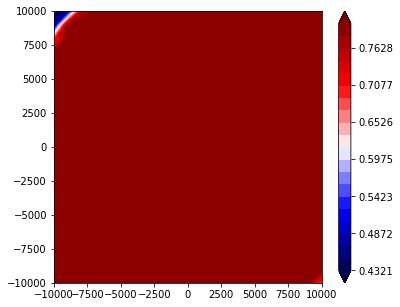

2311 37.1545159807
2312 37.1545159808
2313 37.1545159808
2314 37.1545159809
2315 37.1545159809
2316 37.154515981
2317 37.154515981
2318 37.154515981
2319 37.1545159811
2320 37.1545159811
V


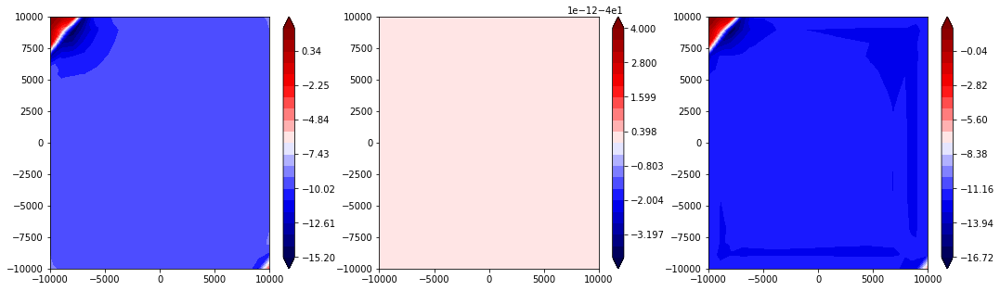

traction


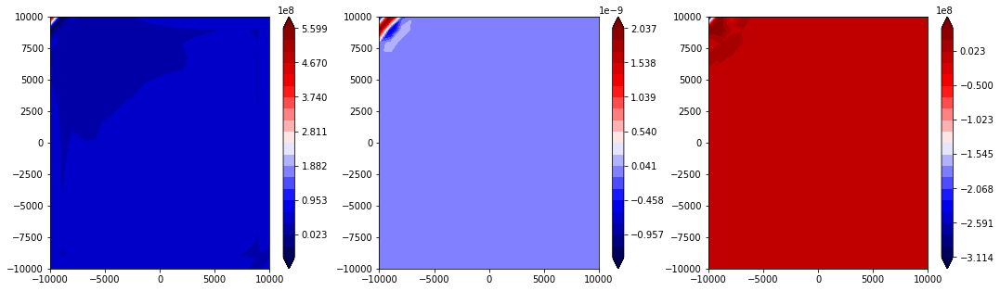

state


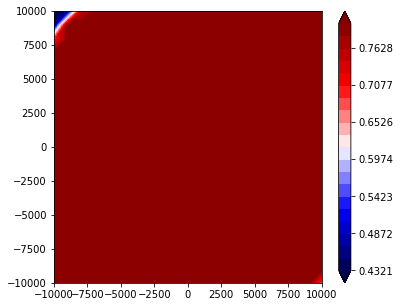

2321 37.1545159812
2322 37.1545159812
2323 37.1545159812
2324 37.1545159813
2325 37.1545159814
2326 37.1545159814
2327 37.1545159814
2328 37.1545159815
2329 37.1545159815
2330 37.1545159816
V


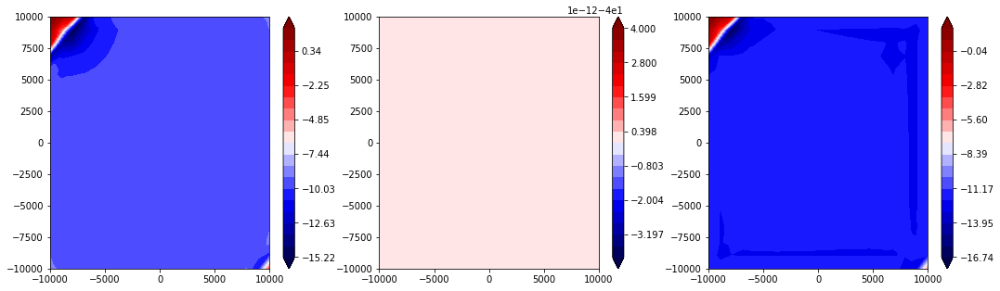

traction


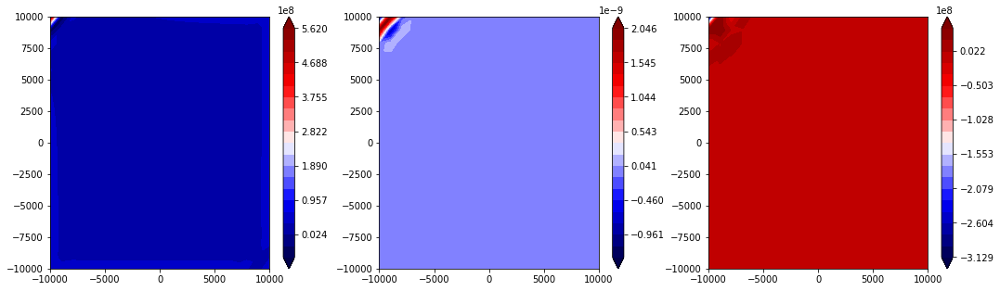

state


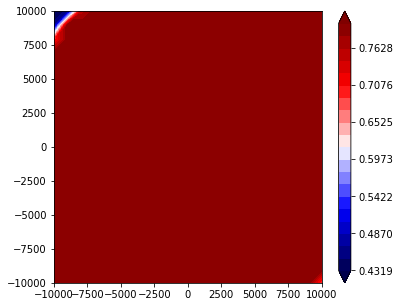

2331 37.1545159816
2332 37.1545159817
2333 37.1545159817
2334 37.1545159818
2335 37.1545159818
2336 37.1545159818
2337 37.1545159819
2338 37.154515982
2339 37.154515982
2340 37.154515982
V


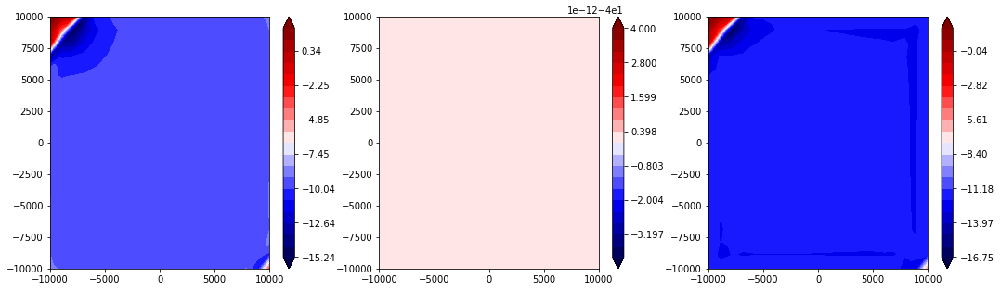

traction


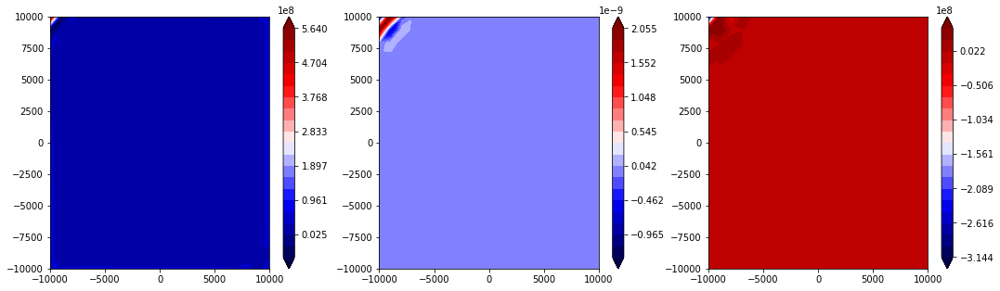

state


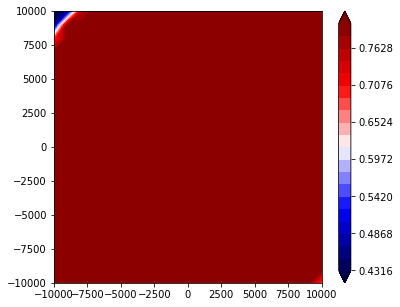

2341 37.1545159821
2342 37.1545159821
2343 37.1545159822
2344 37.1545159822
2345 37.1545159823
2346 37.1545159823
2347 37.1545159824
2348 37.1545159824
2349 37.1545159824
2350 37.1545159825
V


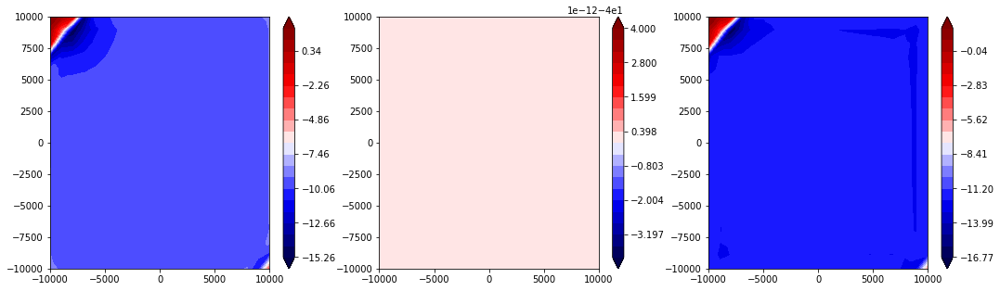

traction


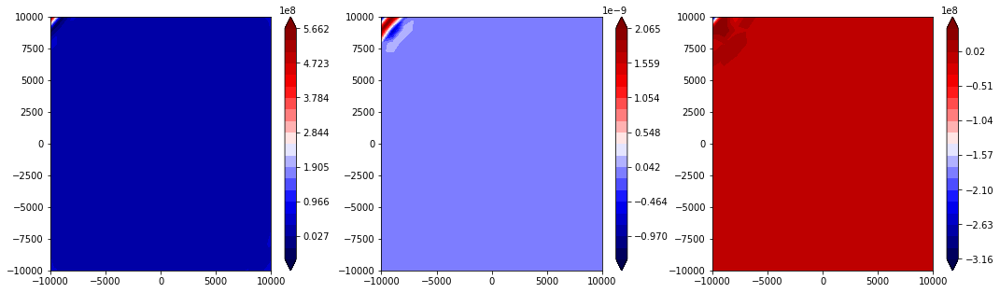

state


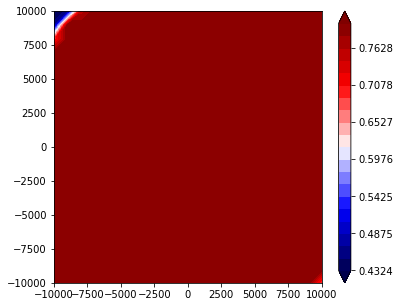

2351 37.1545159825
2352 37.1545159826
2353 37.1545159826
2354 37.1545159827
2355 37.1545159827
2356 37.1545159828
2357 37.1545159828
2358 37.1545159828
2359 37.1545159829
2360 37.1545159829
V


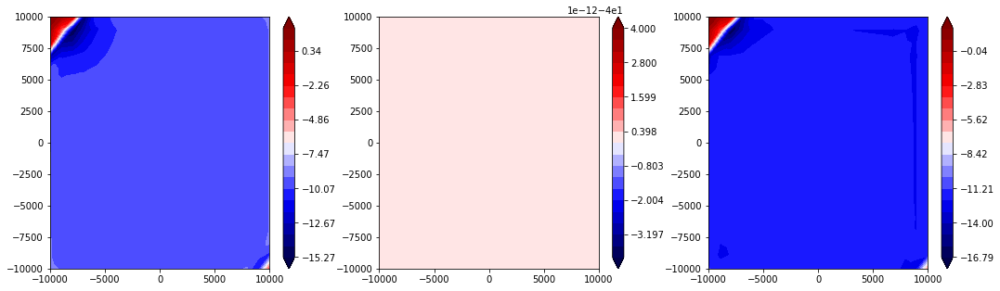

traction


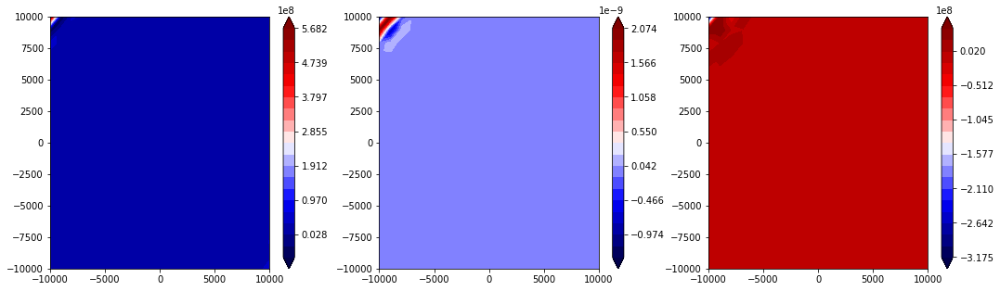

state


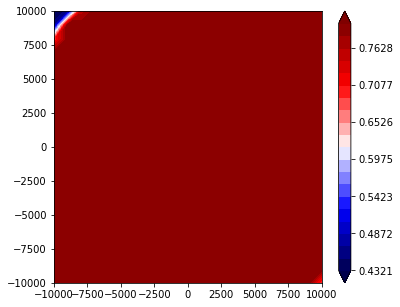

2361 37.154515983
2362 37.154515983
2363 37.1545159831
2364 37.1545159831
2365 37.1545159832
2366 37.1545159832
2367 37.1545159833
2368 37.1545159834
2369 37.1545159834
2370 37.1545159834
V


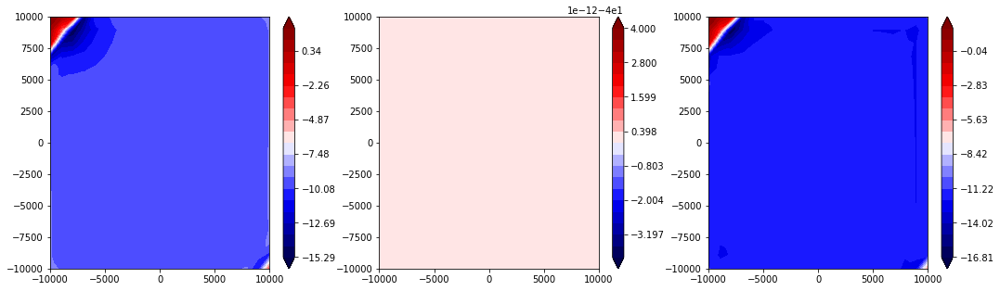

traction


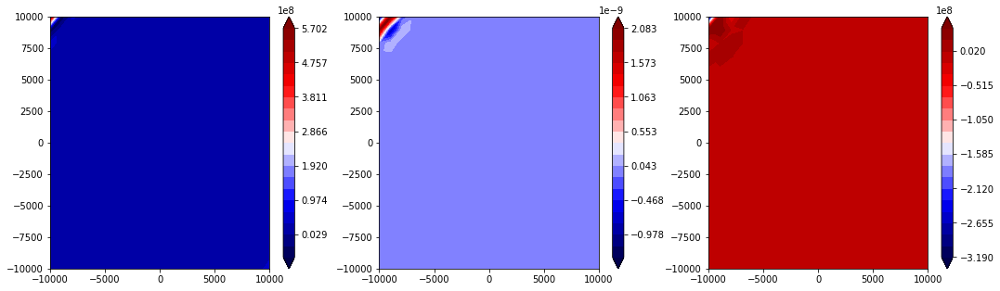

state


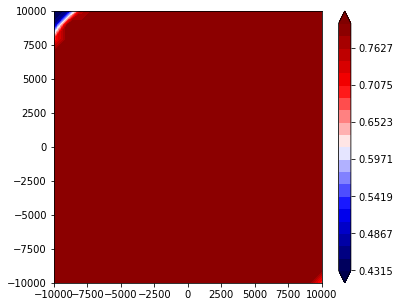

2371 37.1545159835
2372 37.1545159835
2373 37.1545159835
2374 37.1545159836
2375 37.1545159836
2376 37.1545159836
2377 37.1545159837
2378 37.1545159837
2379 37.1545159838
2380 37.1545159838
V


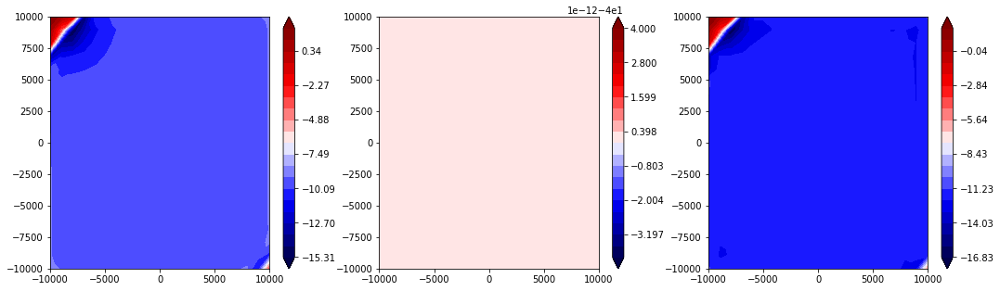

traction


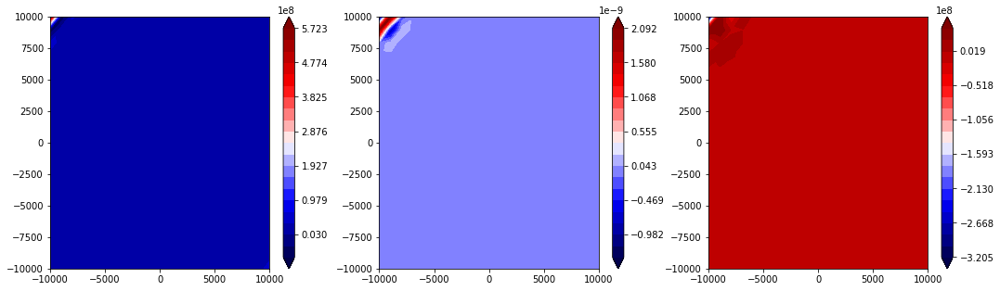

state


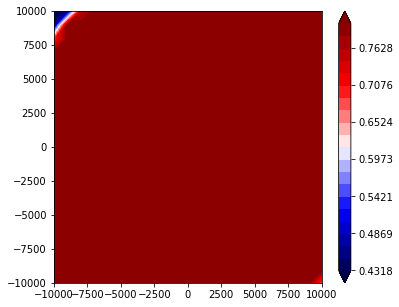

2381 37.1545159839
2382 37.1545159839
2383 37.154515984
2384 37.154515984
2385 37.1545159841
2386 37.1545159841
2387 37.1545159841
2388 37.1545159842
2389 37.1545159842
2390 37.1545159842
V


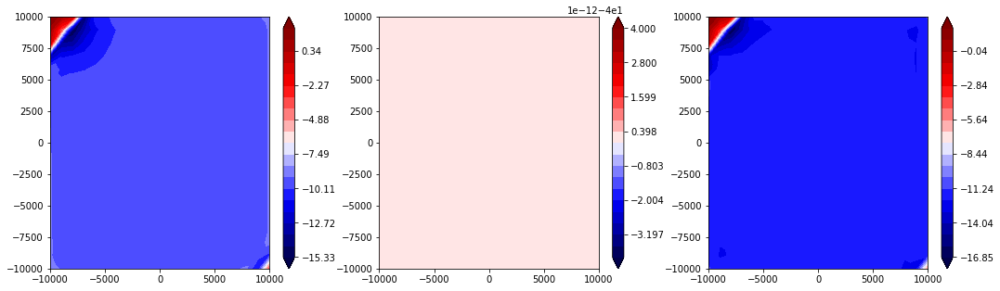

traction


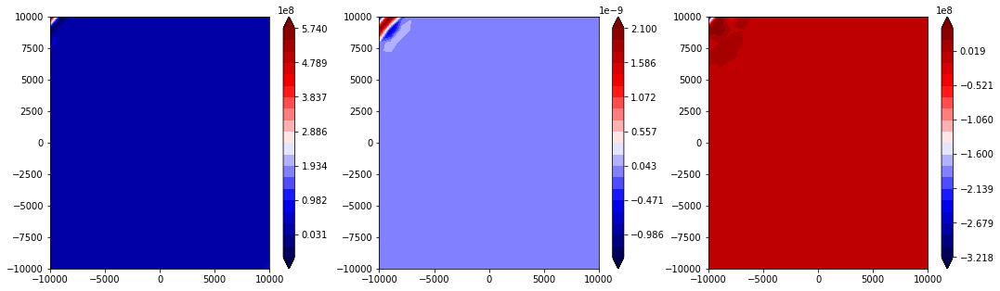

state


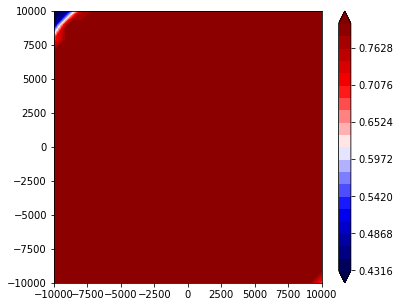

2391 37.1545159843
2392 37.1545159843
2393 37.1545159844
2394 37.1545159844
2395 37.1545159845
2396 37.1545159845
2397 37.1545159845
2398 37.1545159846
2399 37.1545159846
2400 37.1545159846
V


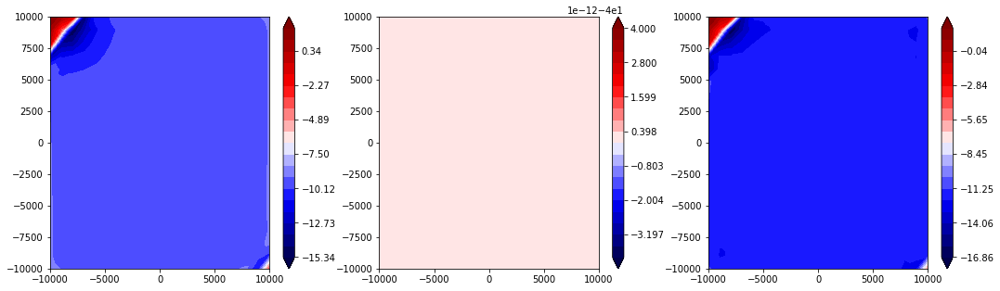

traction


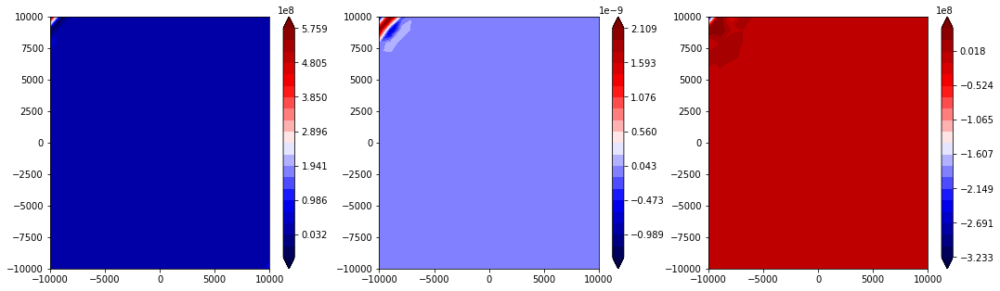

state


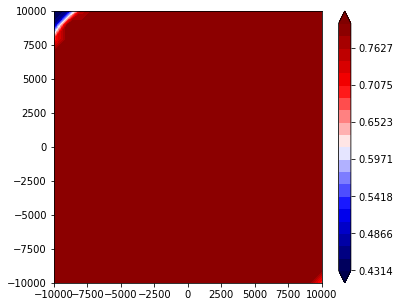

2401 37.1545159847
2402 37.1545159847
2403 37.1545159847
2404 37.1545159848
2405 37.1545159849
2406 37.1545159849
2407 37.1545159849
2408 37.154515985
2409 37.154515985
2410 37.1545159851
V


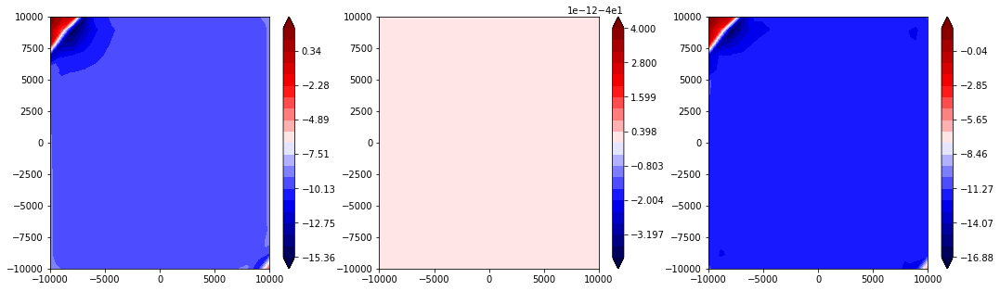

traction


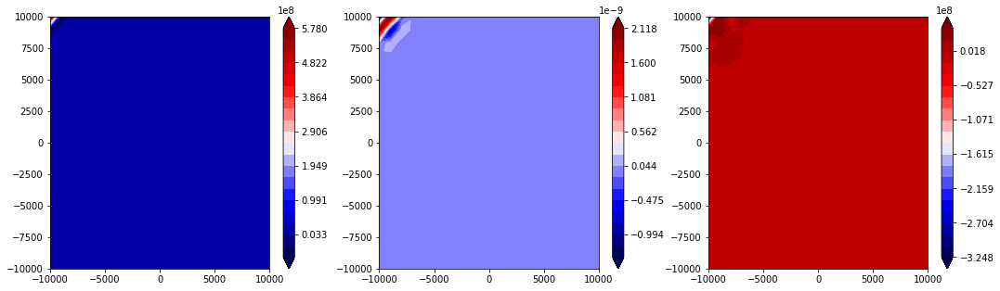

state


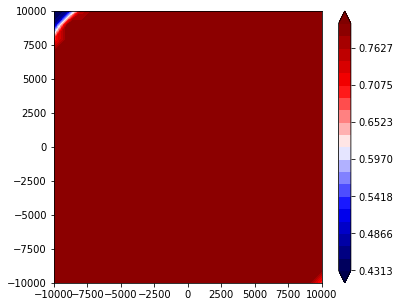

2411 37.1545159851
2412 37.1545159852
2413 37.1545159852
2414 37.1545159853
2415 37.1545159853
2416 37.1545159854
2417 37.1545159854
2418 37.1545159854
2419 37.1545159855
2420 37.1545159855
V


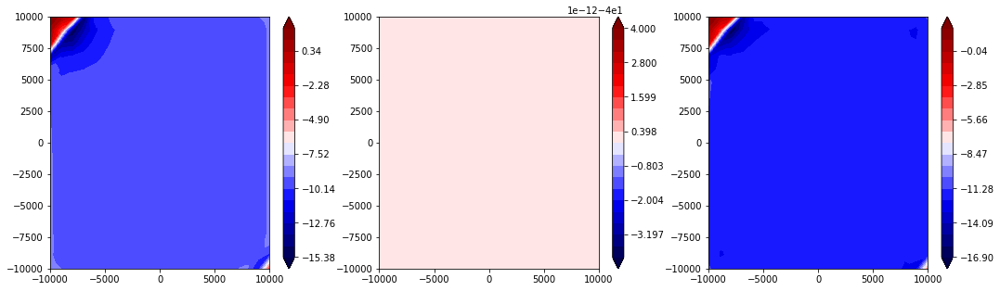

traction


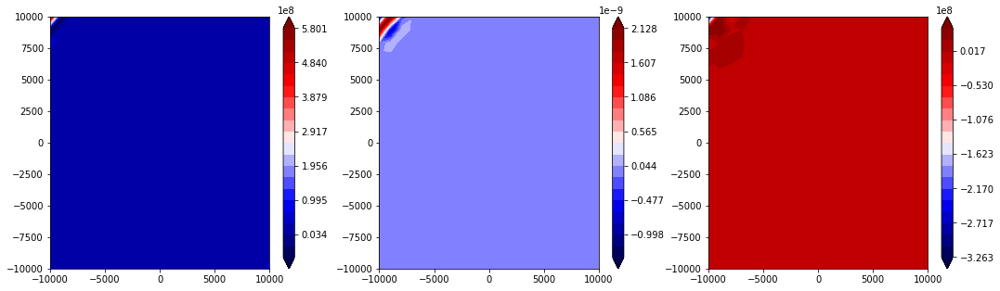

state


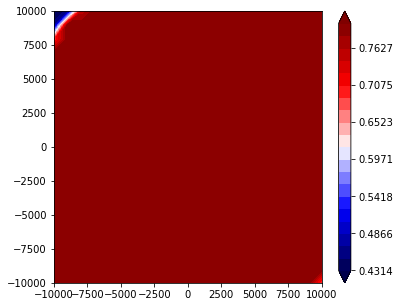

2421 37.1545159856
2422 37.1545159856
2423 37.1545159857
2424 37.1545159857
2425 37.1545159857
2426 37.1545159858
2427 37.1545159858
2428 37.1545159859
2429 37.1545159859
2430 37.154515986
V


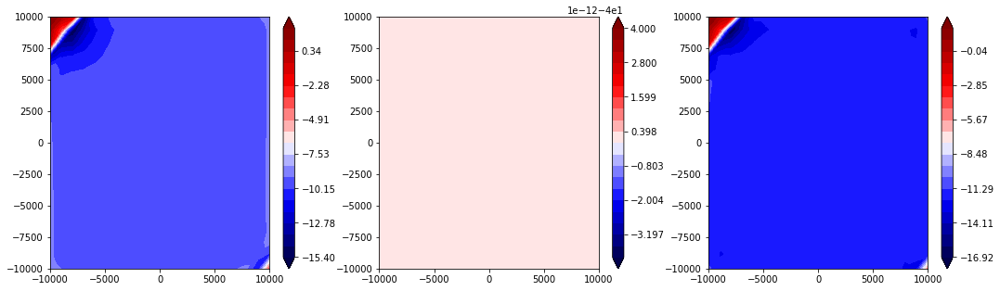

traction


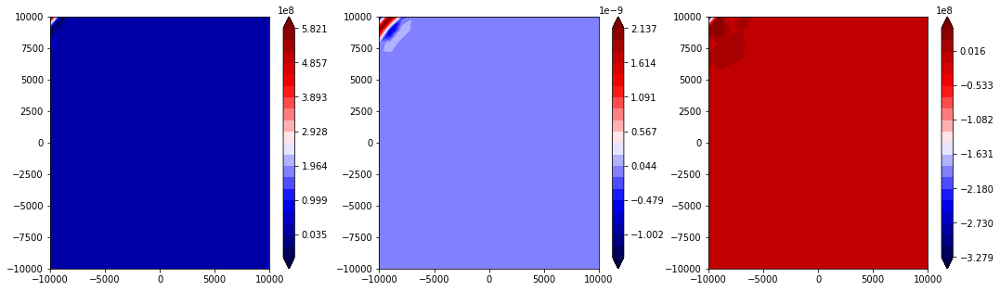

state


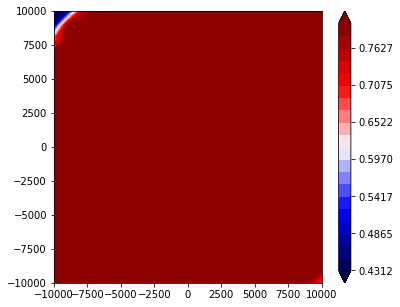

2431 37.154515986
2432 37.1545159861
2433 37.1545159861
2434 37.1545159862
2435 37.1545159862
2436 37.1545159862
2437 37.1545159863
2438 37.1545159863
2439 37.1545159864
2440 37.1545159864
V


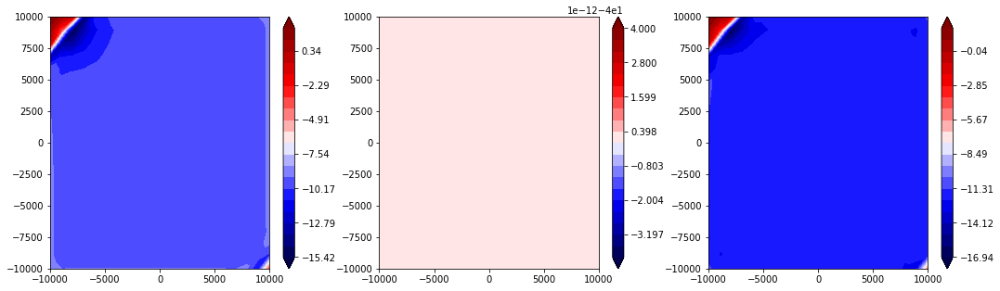

traction


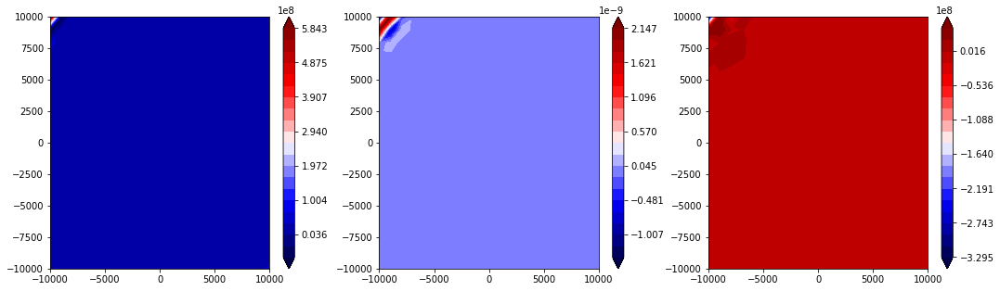

state


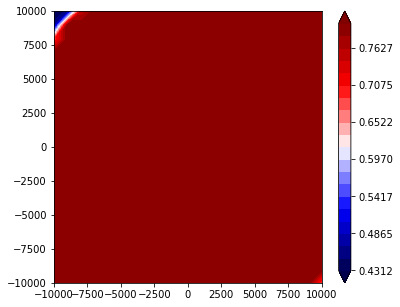

2441 37.1545159865
2442 37.1545159865
2443 37.1545159865
2444 37.1545159866
2445 37.1545159866
2446 37.1545159867
2447 37.1545159867
2448 37.1545159868
2449 37.1545159869
2450 37.1545159869
V


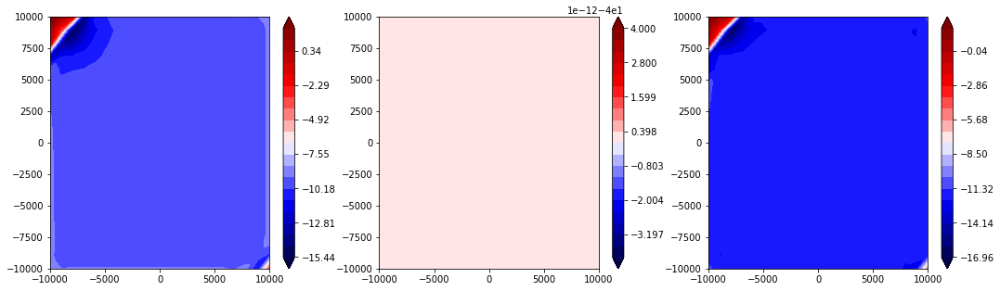

traction


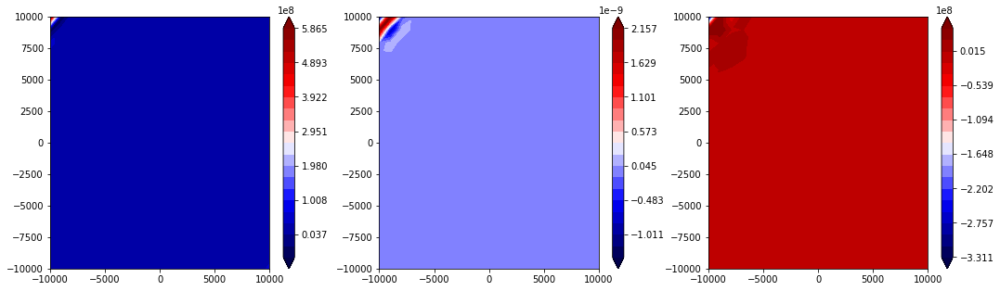

state


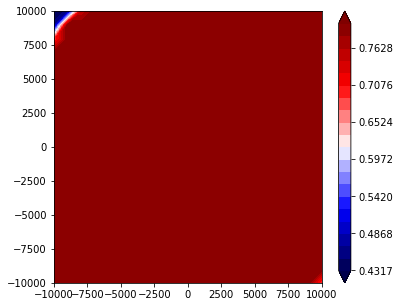

2451 37.1545159869
2452 37.154515987
2453 37.154515987
2454 37.154515987
2455 37.1545159871
2456 37.1545159872
2457 37.1545159872
2458 37.1545159872
2459 37.1545159873
2460 37.1545159873
V


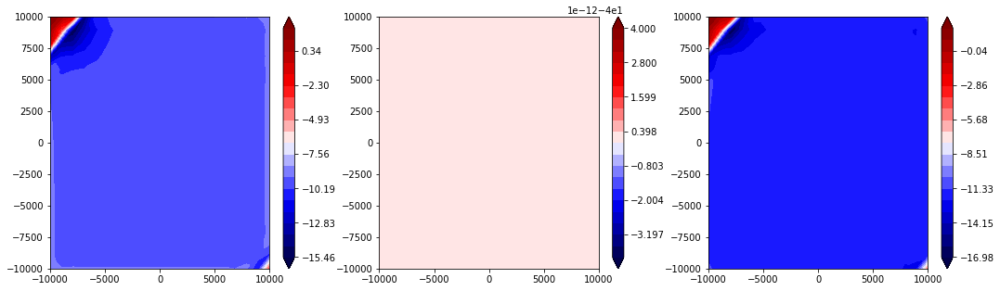

traction


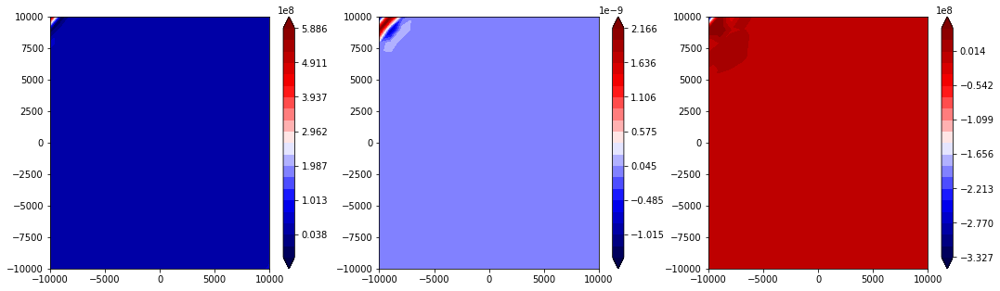

state


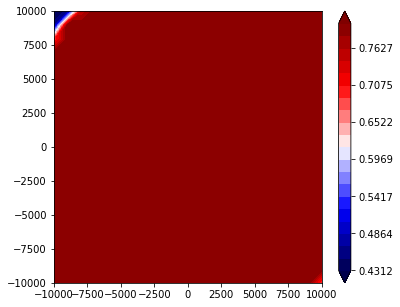

2461 37.1545159874
2462 37.1545159874
2463 37.1545159875
2464 37.1545159875
2465 37.1545159875
2466 37.1545159876
2467 37.1545159876
2468 37.1545159877
2469 37.1545159877
2470 37.1545159878
V


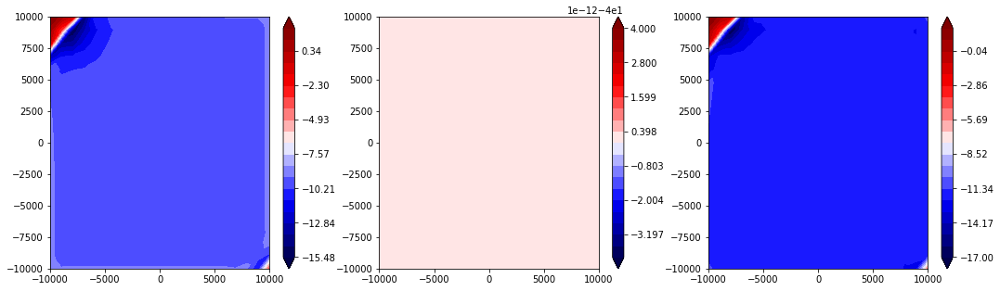

traction


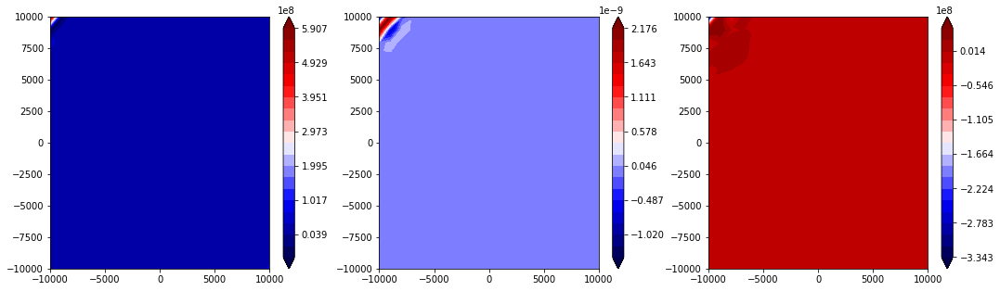

state


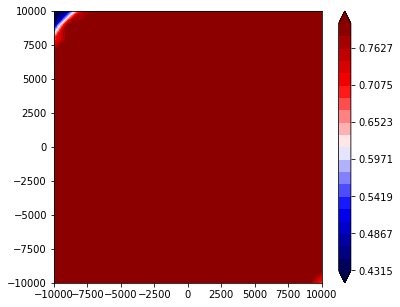

2471 37.1545159878
2472 37.1545159878
2473 37.1545159879
2474 37.1545159879
2475 37.154515988
2476 37.154515988
2477 37.1545159881
2478 37.1545159881
2479 37.1545159882
2480 37.1545159882
V


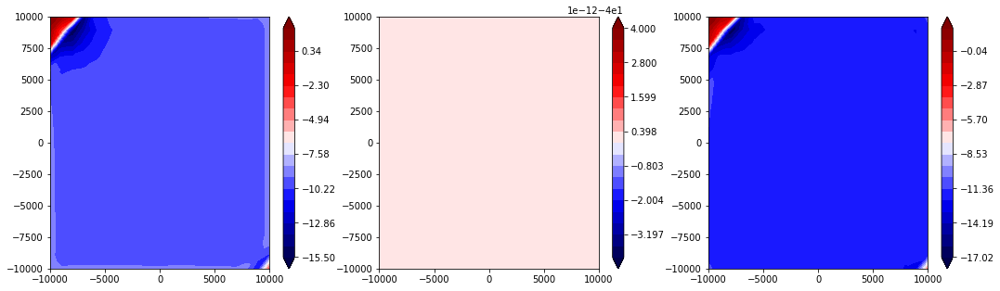

traction


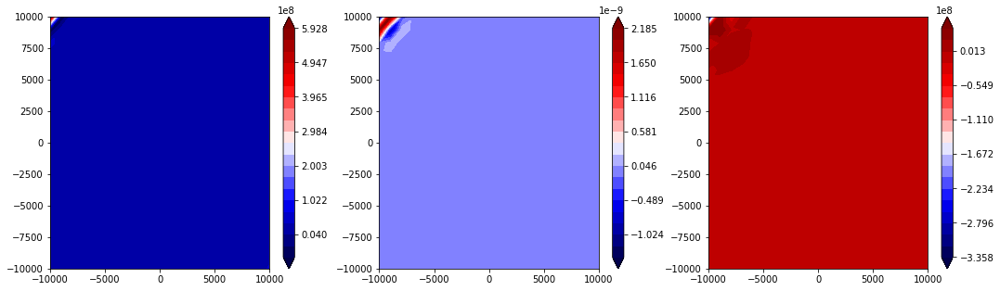

state


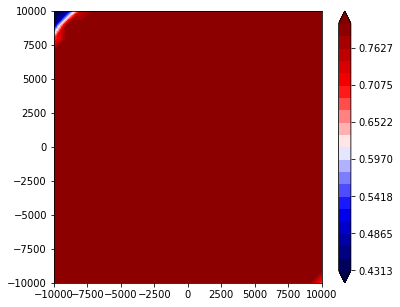

2481 37.1545159882
2482 37.1545159883
2483 37.1545159883
2484 37.1545159884
2485 37.1545159884
2486 37.1545159885
2487 37.1545159885
2488 37.1545159886
2489 37.1545159886
2490 37.1545159886
V


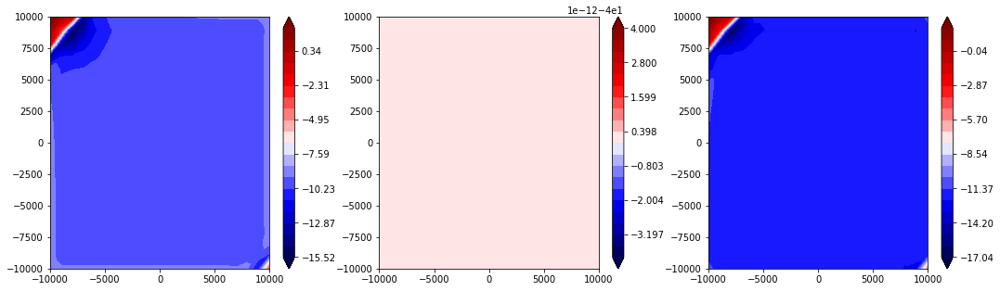

traction


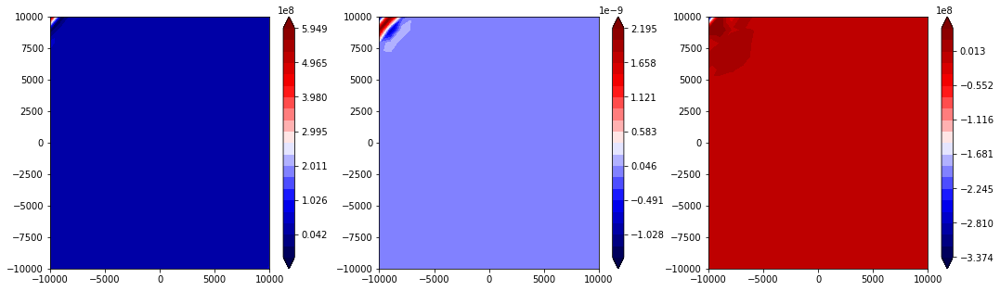

state


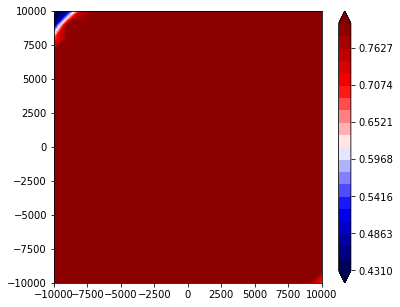

2491 37.1545159887
2492 37.1545159887
2493 37.1545159888
2494 37.1545159889
2495 37.1545159889
2496 37.1545159889
2497 37.154515989
2498 37.154515989
2499 37.1545159891
2500 37.1545159891
V


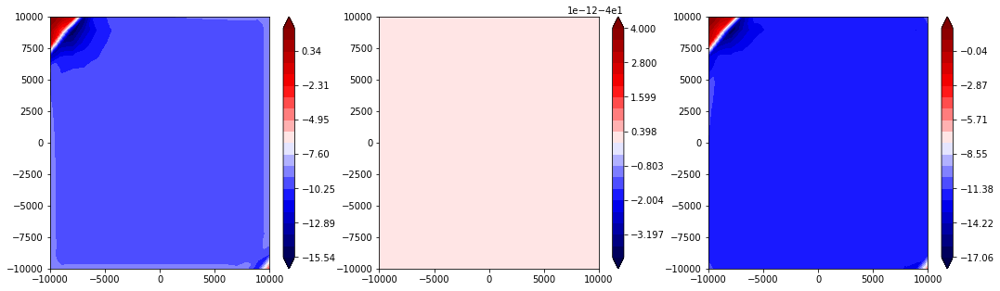

traction


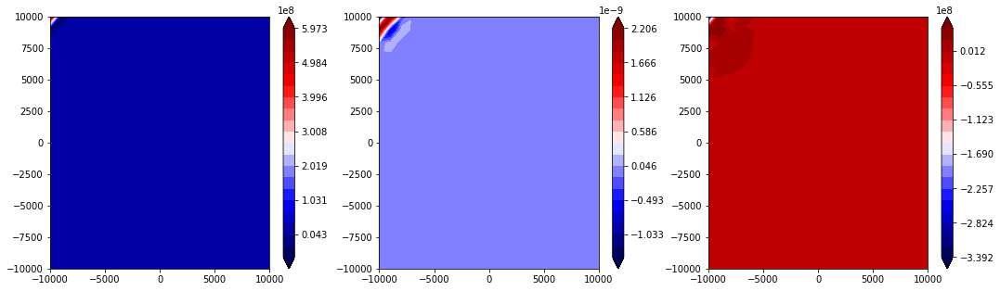

state


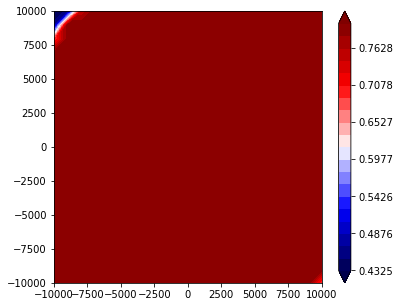

2501 37.1545159891
2502 37.1545159892
2503 37.1545159892
2504 37.1545159893
2505 37.1545159893
2506 37.1545159893
2507 37.1545159894
2508 37.1545159894
2509 37.1545159895
2510 37.1545159895
V


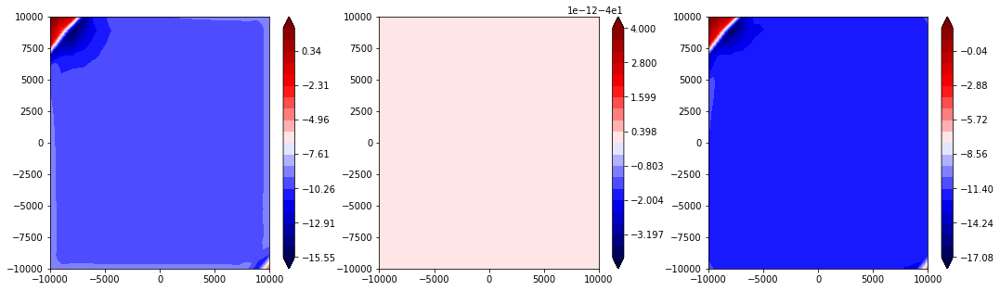

traction


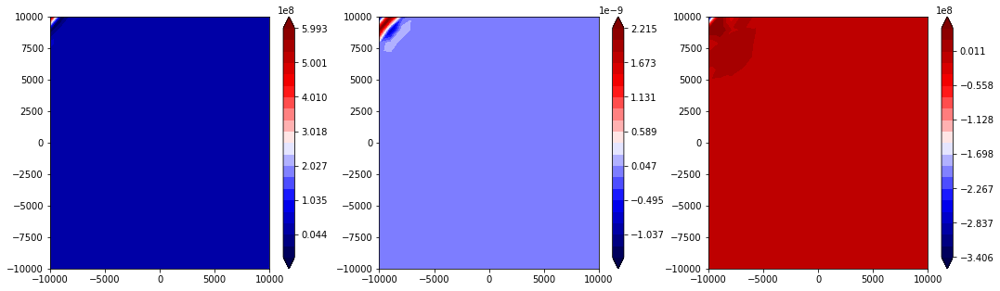

state


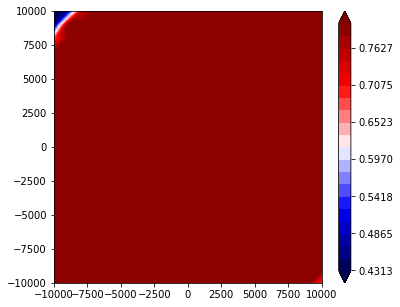

2511 37.1545159896
2512 37.1545159896
2513 37.1545159897
2514 37.1545159897
2515 37.1545159897
2516 37.1545159898
2517 37.1545159899
2518 37.1545159899
2519 37.1545159899
2520 37.15451599
V


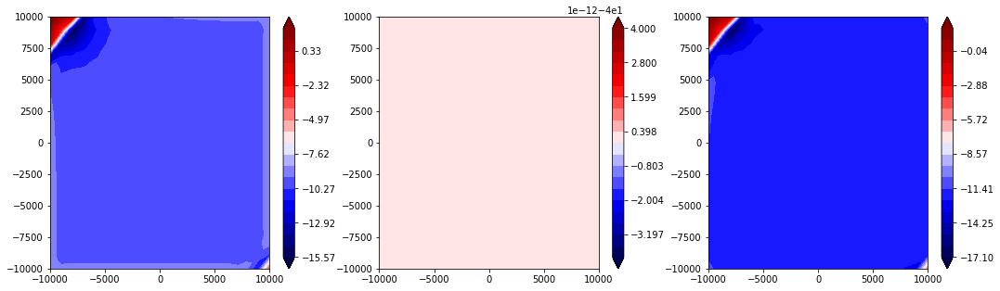

traction


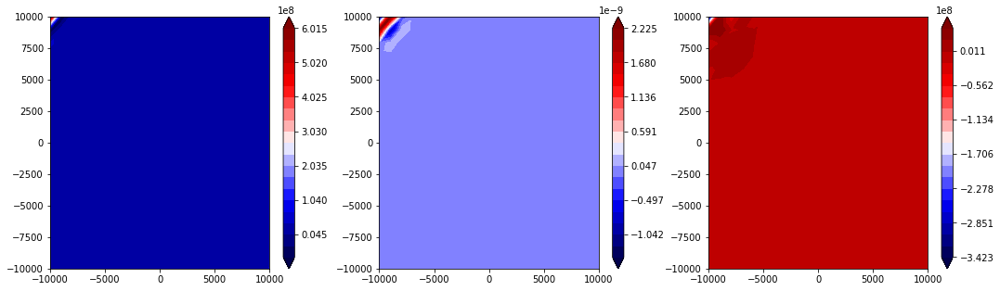

state


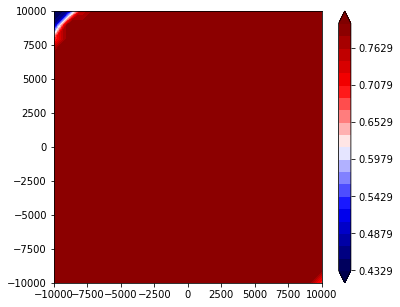

2521 37.15451599
2522 37.15451599
2523 37.1545159901
2524 37.1545159901
2525 37.1545159901
2526 37.1545159902
2527 37.1545159902
2528 37.1545159903
2529 37.1545159903
2530 37.1545159903
V


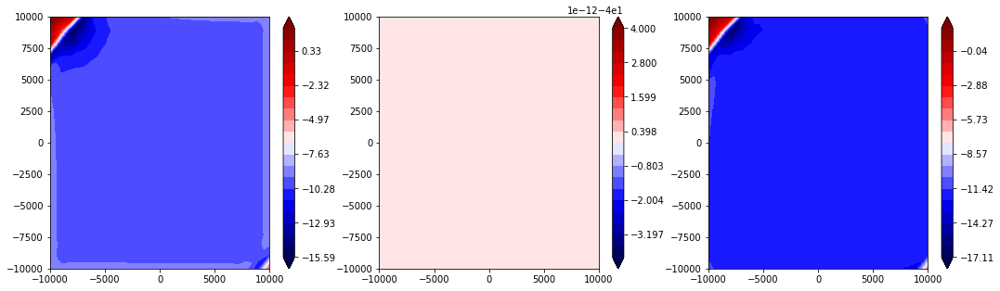

traction


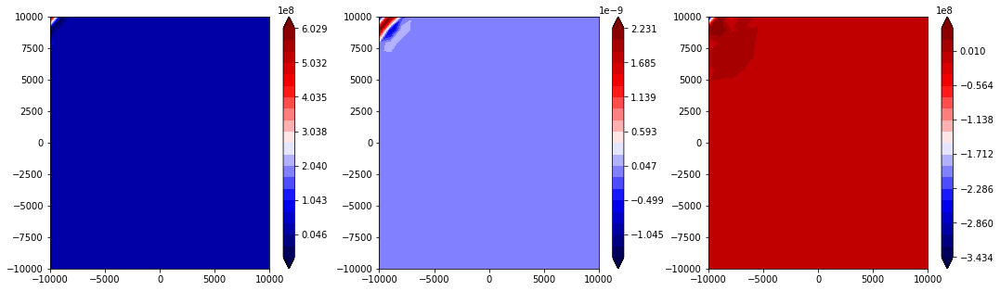

state


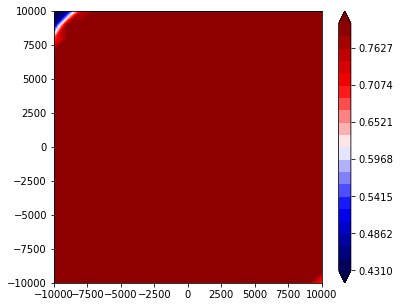

2531 37.1545159904
2532 37.1545159904
2533 37.1545159905
2534 37.1545159905
2535 37.1545159905
2536 37.1545159906
2537 37.1545159906
2538 37.1545159906
2539 37.1545159906
2540 37.1545159907
V


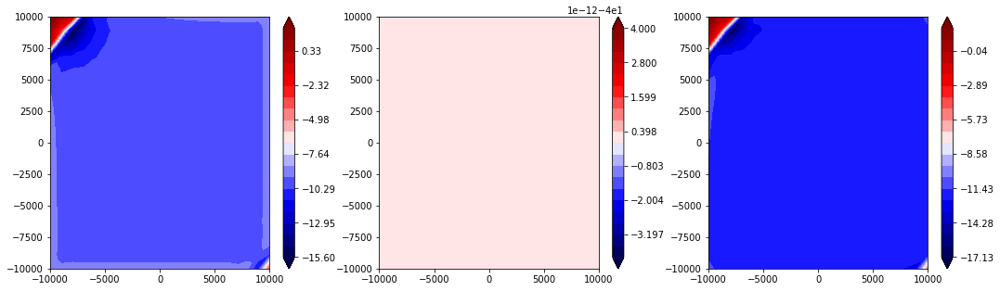

traction


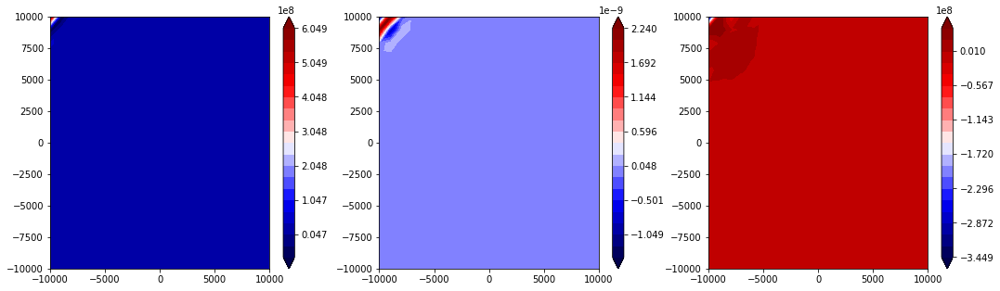

state


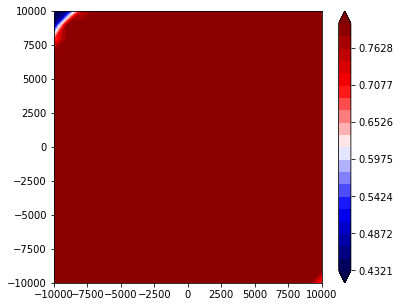

2541 37.1545159907
2542 37.1545159907
2543 37.1545159908
2544 37.1545159908
2545 37.1545159909
2546 37.1545159909
2547 37.154515991
2548 37.154515991
2549 37.154515991
2550 37.1545159911
V


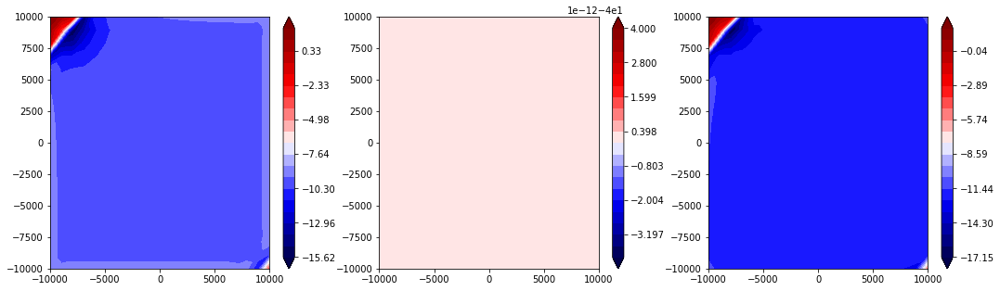

traction


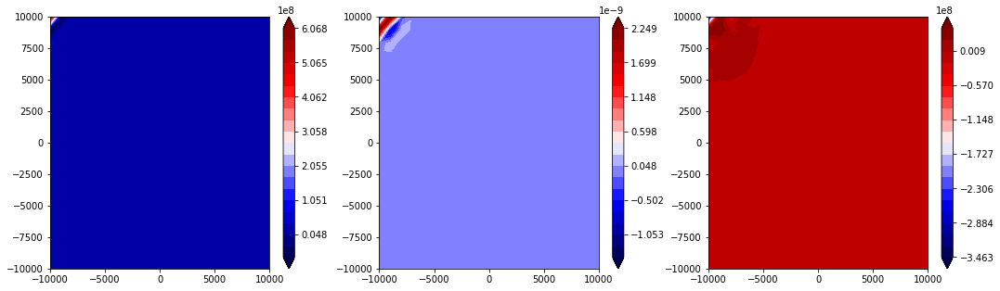

state


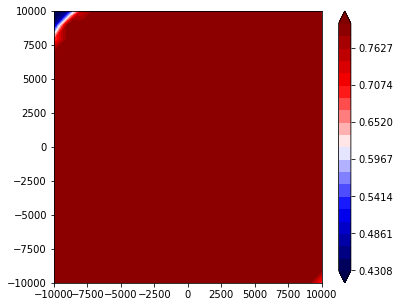

2551 37.1545159912
2552 37.1545159912
2553 37.1545159912
2554 37.1545159913
2555 37.1545159913
2556 37.1545159913
2557 37.1545159914
2558 37.1545159915
2559 37.1545159915
2560 37.1545159915
V


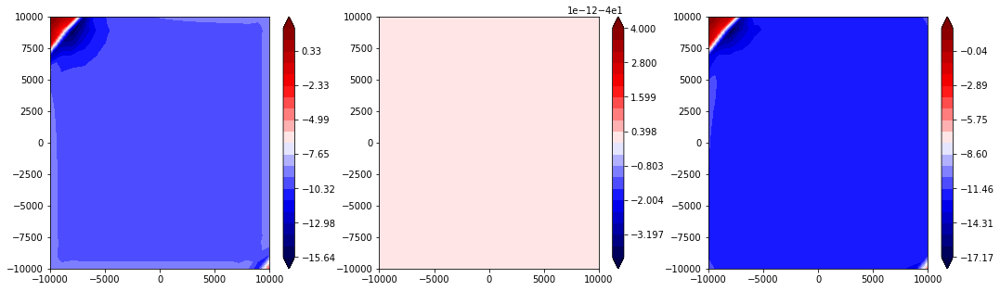

traction


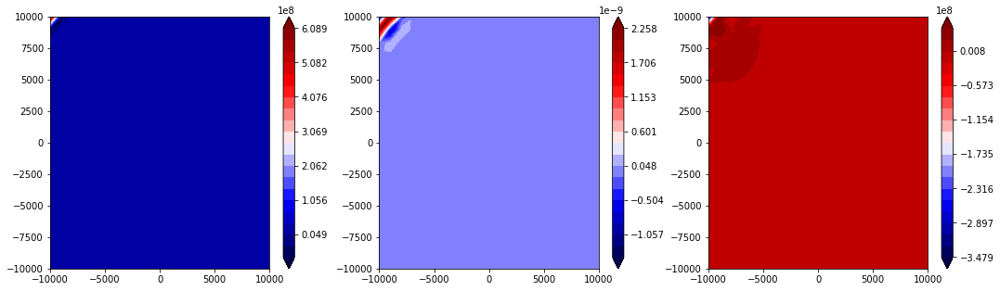

state


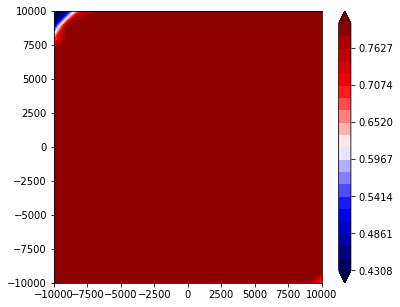

2561 37.1545159916
2562 37.1545159916
2563 37.1545159916
2564 37.1545159917
2565 37.1545159917
2566 37.1545159918
2567 37.1545159918
2568 37.1545159919
2569 37.1545159919
2570 37.154515992
V


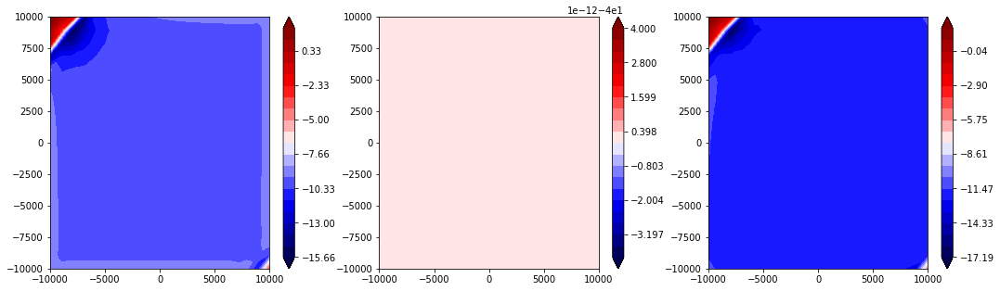

traction


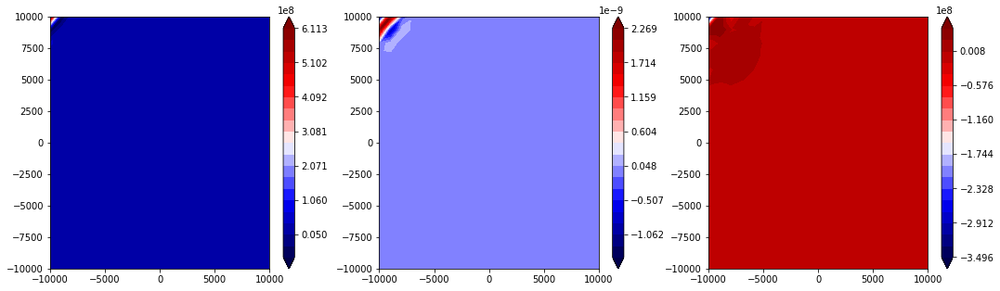

state


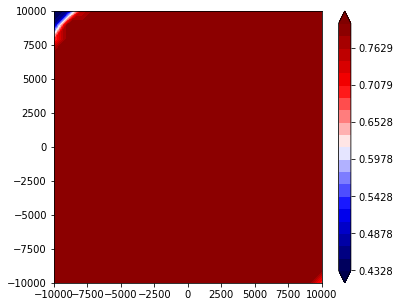

2571 37.154515992
2572 37.154515992
2573 37.154515992
2574 37.1545159921
2575 37.1545159921
2576 37.1545159921
2577 37.1545159922
2578 37.1545159922
2579 37.1545159922
2580 37.1545159923
V


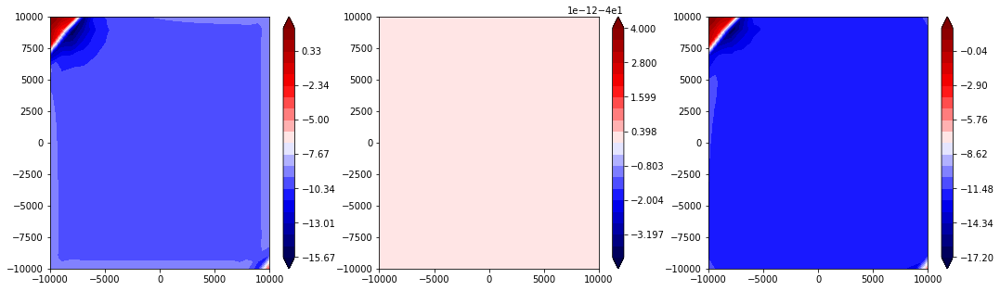

traction


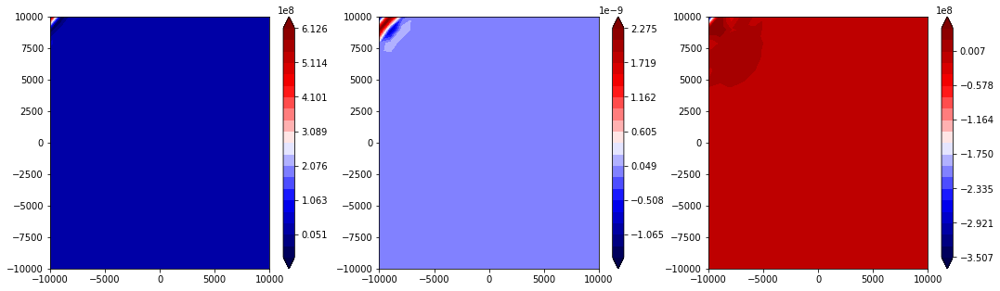

state


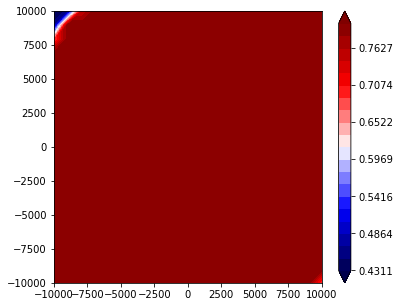

2581 37.1545159923
2582 37.1545159924
2583 37.1545159924
2584 37.1545159924
2585 37.1545159924
2586 37.1545159925
2587 37.1545159925
2588 37.1545159925
2589 37.1545159926
2590 37.1545159926
V


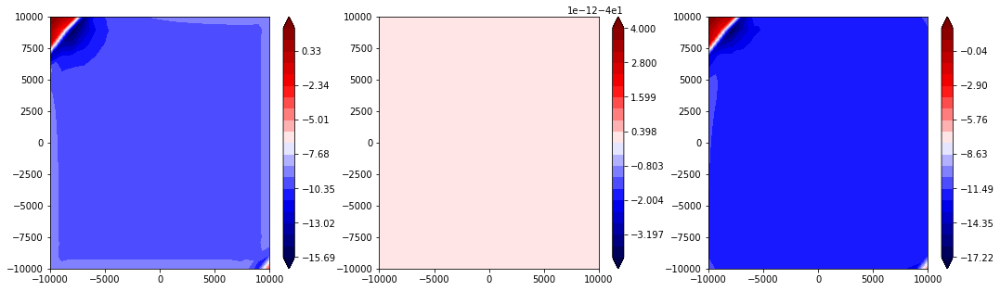

traction


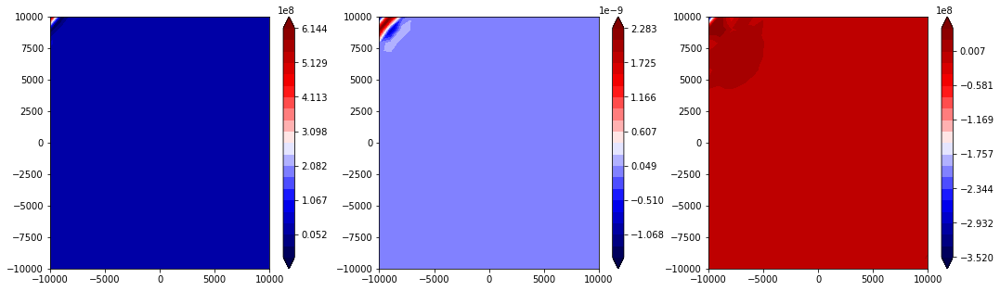

state


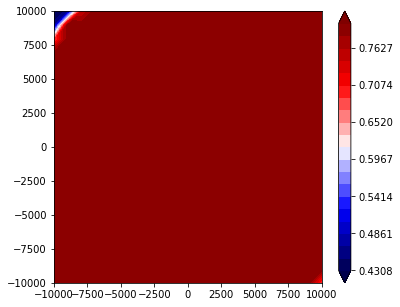

2591 37.1545159927
2592 37.1545159927
2593 37.1545159927
2594 37.1545159928
2595 37.1545159928
2596 37.1545159929
2597 37.1545159929
2598 37.154515993
2599 37.154515993
2600 37.1545159931
V


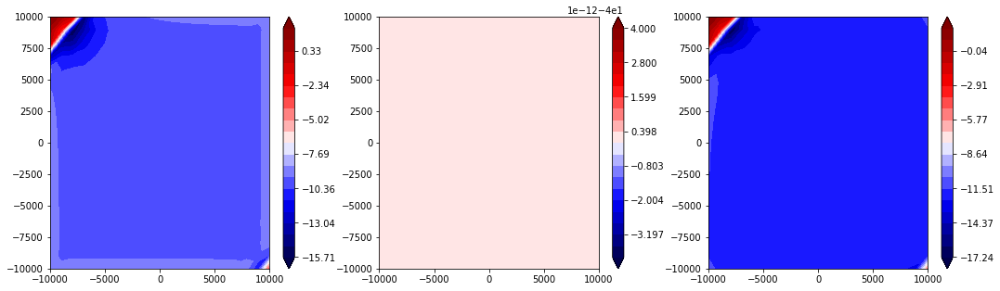

traction


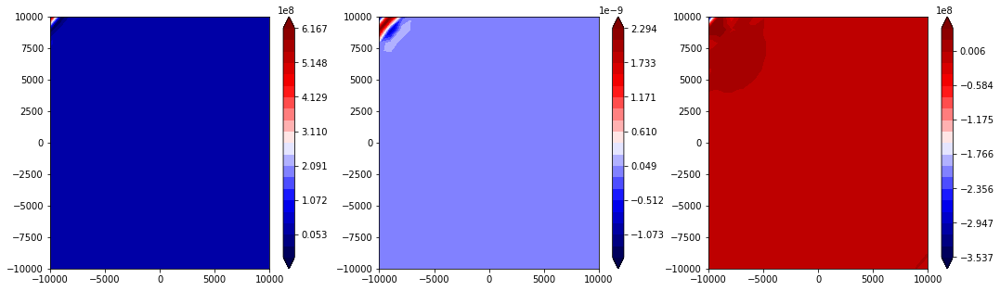

state


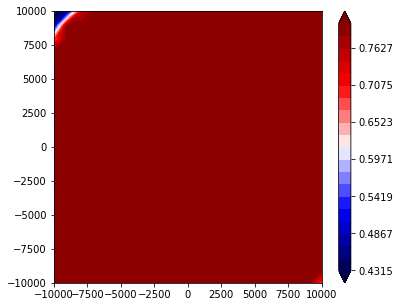

2601 37.1545159931
2602 37.1545159931
2603 37.1545159932
2604 37.1545159932
2605 37.1545159933
2606 37.1545159933
2607 37.1545159933
2608 37.1545159934
2609 37.1545159934
2610 37.1545159935
V


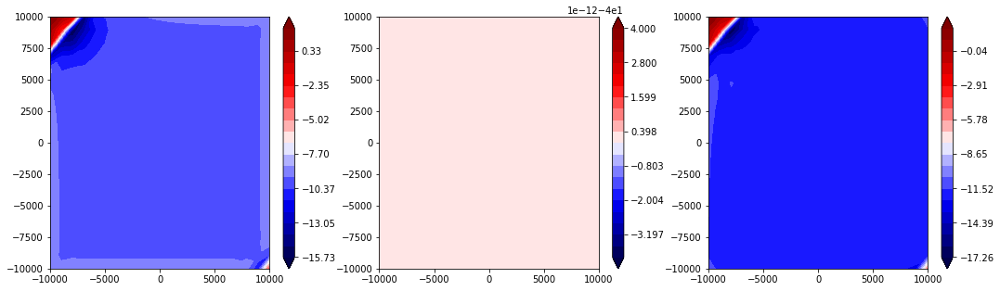

traction


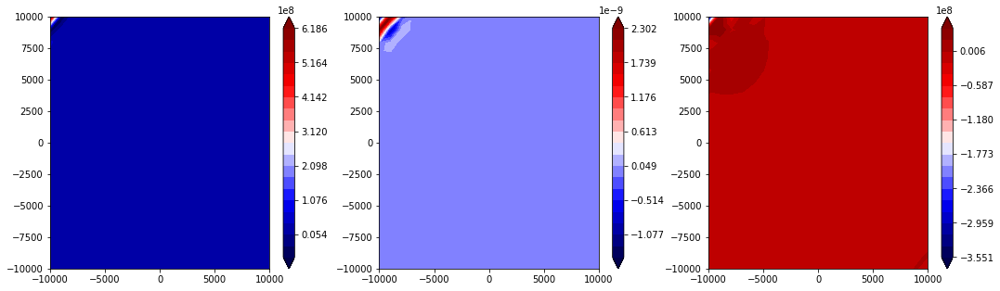

state


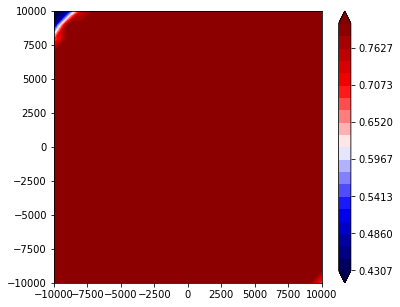

2611 37.1545159935
2612 37.1545159935
2613 37.1545159936
2614 37.1545159936
2615 37.1545159937
2616 37.1545159937
2617 37.1545159938
2618 37.1545159938
2619 37.1545159939
2620 37.1545159939
V


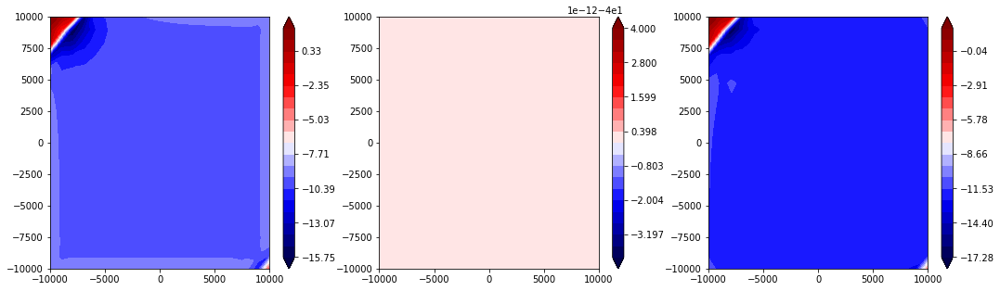

traction


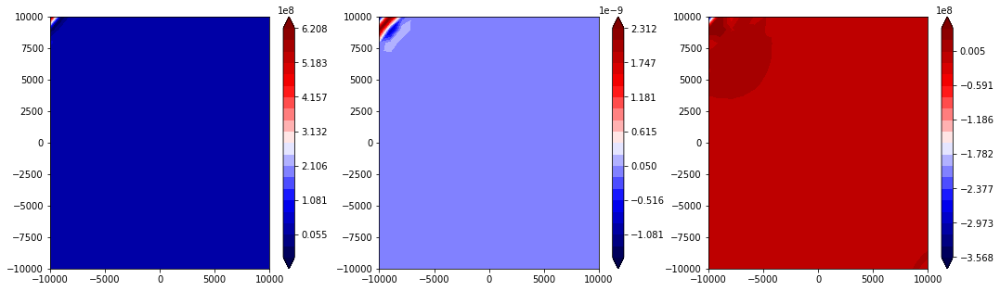

state


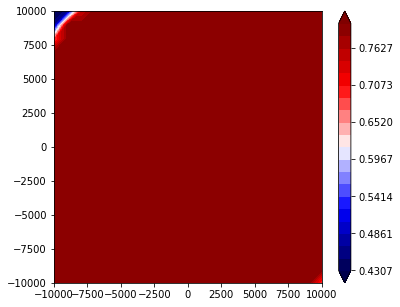

2621 37.1545159939
2622 37.154515994
2623 37.154515994
2624 37.1545159941
2625 37.1545159941
2626 37.1545159941
2627 37.1545159942
2628 37.1545159943
2629 37.1545159943
2630 37.1545159943
V


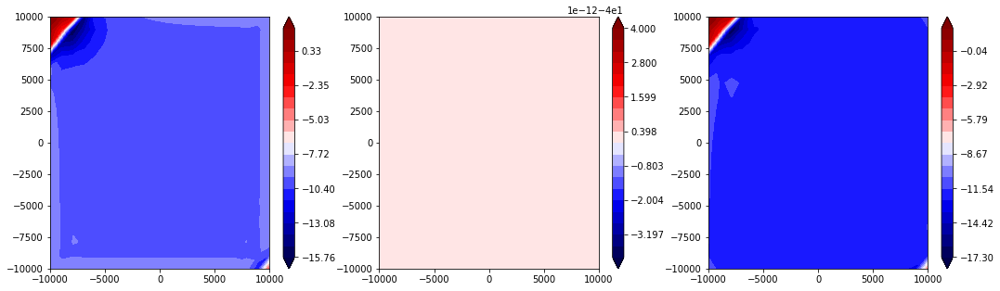

traction


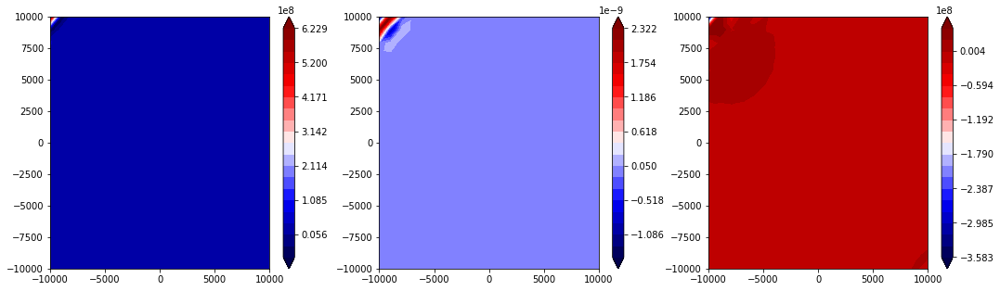

state


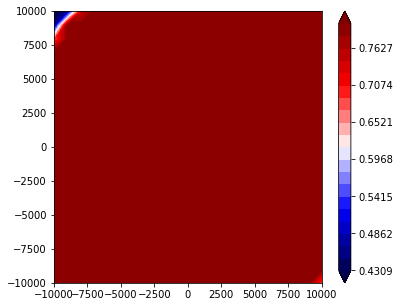

2631 37.1545159943
2632 37.1545159944
2633 37.1545159944
2634 37.1545159944
2635 37.1545159945
2636 37.1545159945
2637 37.1545159946
2638 37.1545159946
2639 37.1545159947
2640 37.1545159947
V


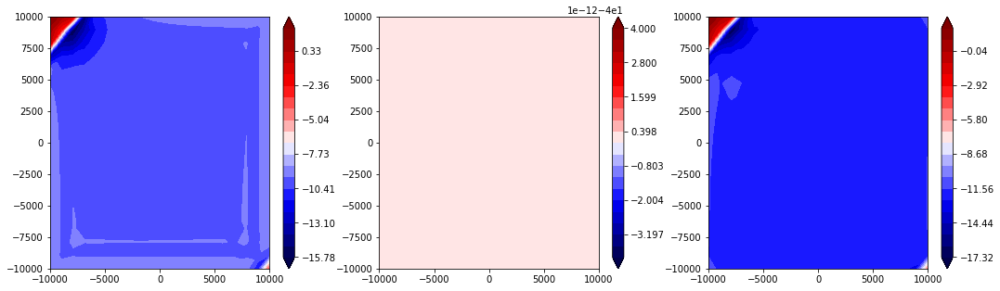

traction


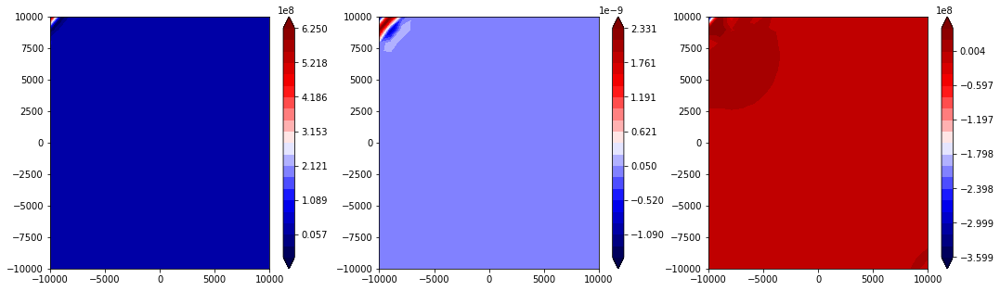

state


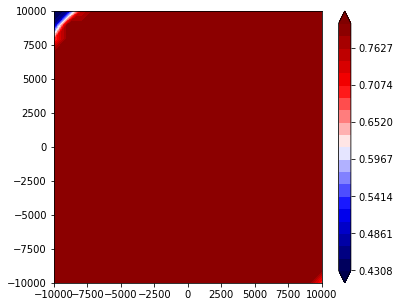

2641 37.1545159947
2642 37.1545159948
2643 37.1545159948
2644 37.1545159948
2645 37.1545159949
2646 37.1545159949
2647 37.154515995
2648 37.154515995
2649 37.154515995
2650 37.1545159951
V


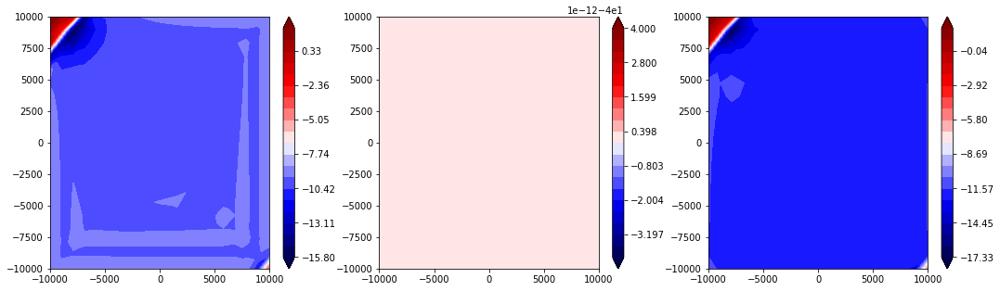

traction


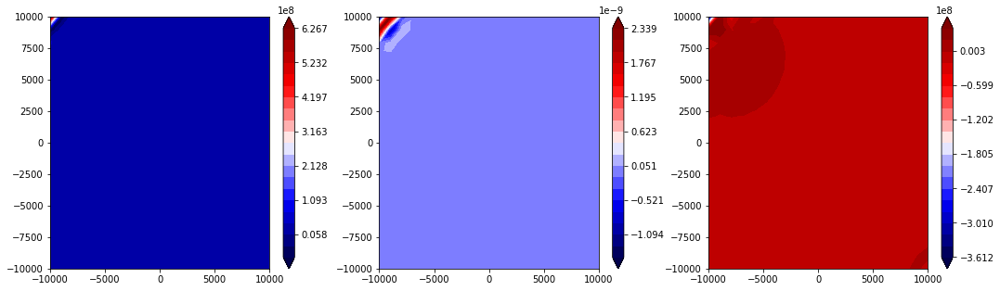

state


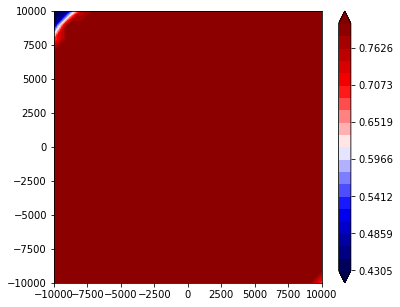

2651 37.1545159951
2652 37.1545159951
2653 37.1545159951
2654 37.1545159952
2655 37.1545159952
2656 37.1545159953
2657 37.1545159953
2658 37.1545159953
2659 37.1545159954
2660 37.1545159954
V


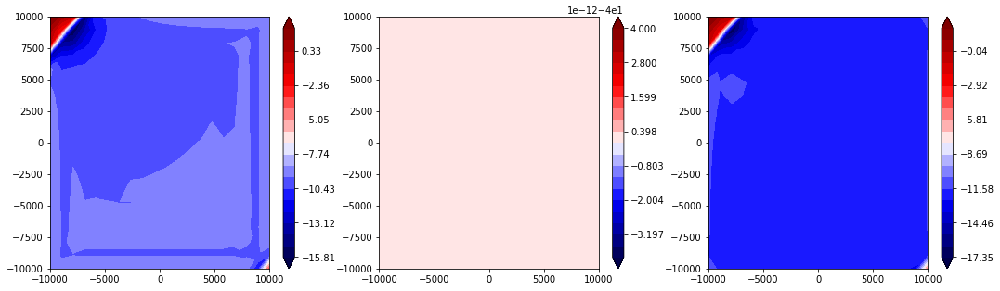

traction


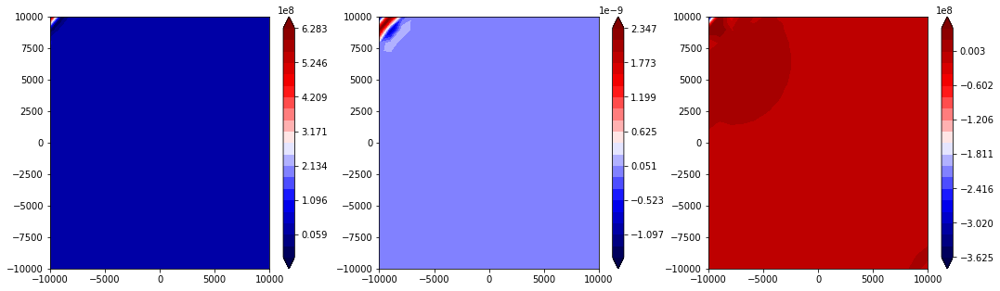

state


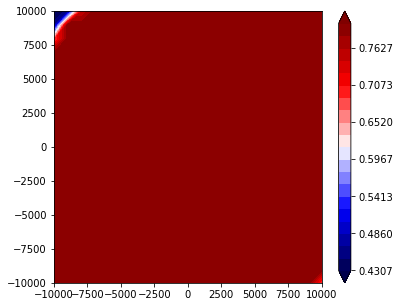

2661 37.1545159954
2662 37.1545159955
2663 37.1545159955
2664 37.1545159955
2665 37.1545159956
2666 37.1545159956
2667 37.1545159957
2668 37.1545159957
2669 37.1545159957
2670 37.1545159958
V


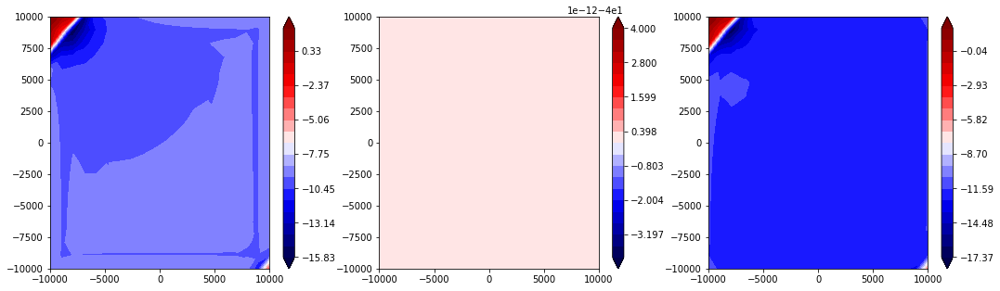

traction


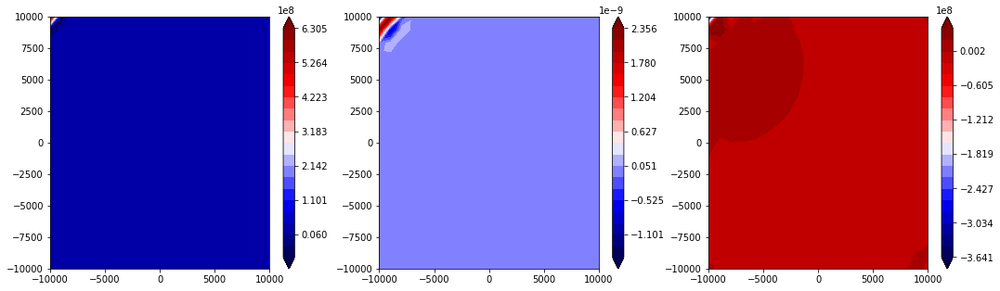

state


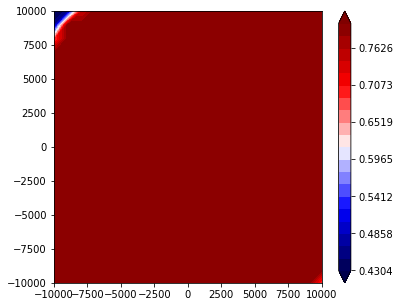

2671 37.1545159959
2672 37.1545159959
2673 37.1545159959
2674 37.154515996
2675 37.154515996
2676 37.154515996
2677 37.1545159961
2678 37.1545159961
2679 37.1545159961
2680 37.1545159962
V


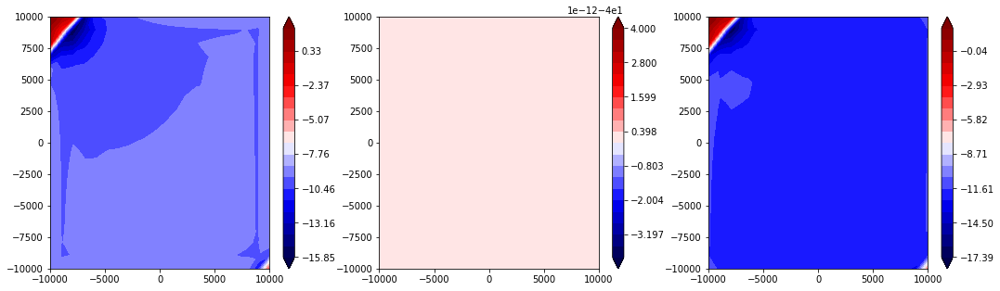

traction


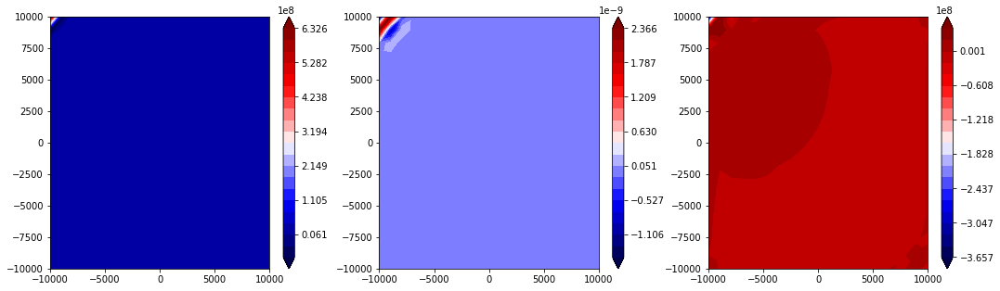

state


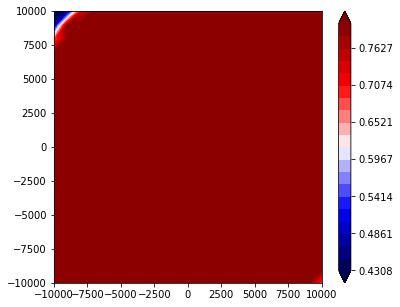

2681 37.1545159962
2682 37.1545159963
2683 37.1545159963
2684 37.1545159963
2685 37.1545159964
2686 37.1545159964
2687 37.1545159965
2688 37.1545159965
2689 37.1545159965
2690 37.1545159966
V


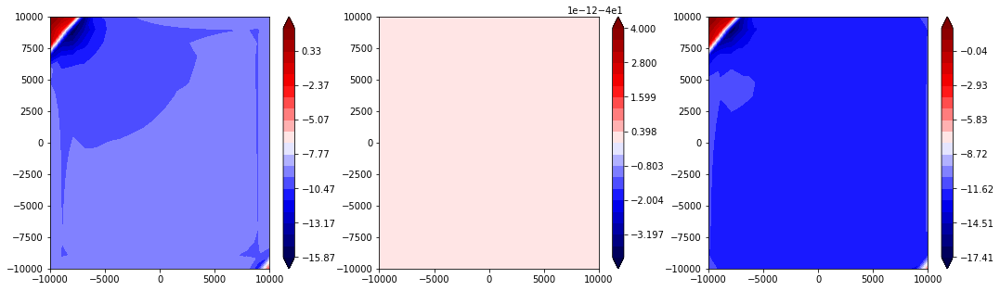

traction


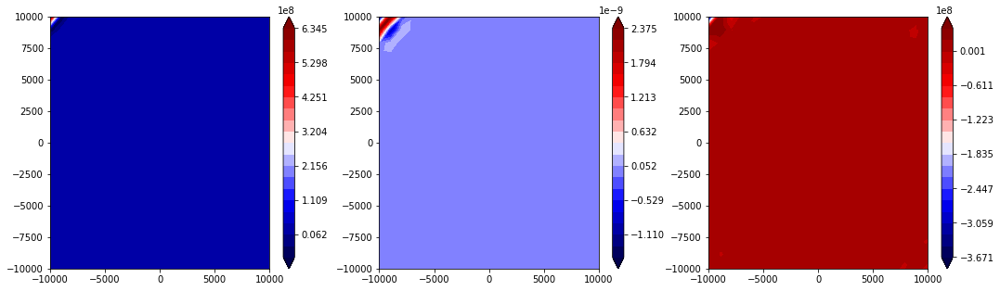

state


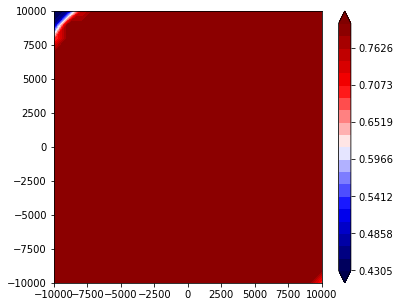

2691 37.1545159966
2692 37.1545159967
2693 37.1545159967
2694 37.1545159968
2695 37.1545159968
2696 37.1545159968
2697 37.1545159969
2698 37.1545159969
2699 37.154515997
2700 37.154515997
V


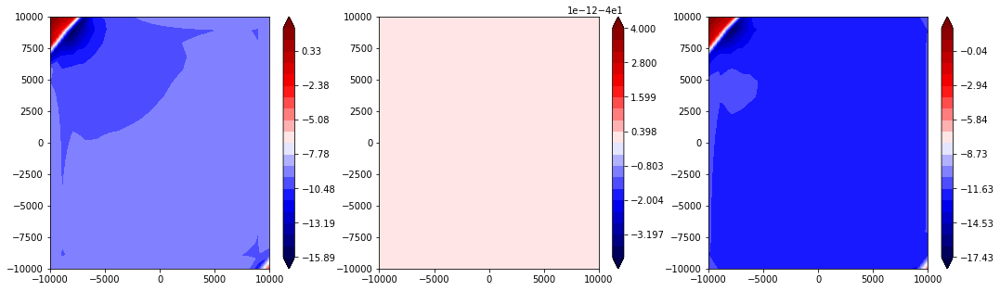

traction


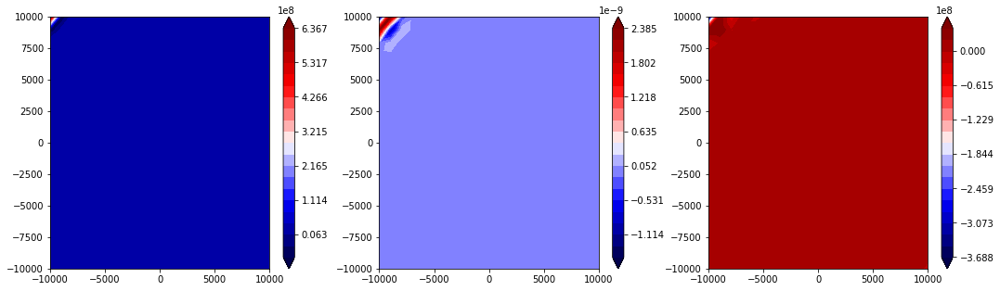

state


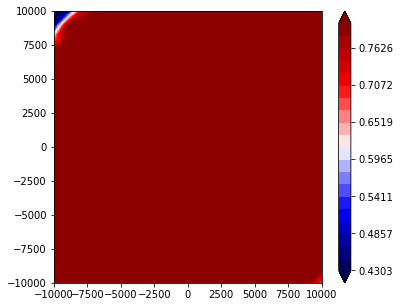

2701 37.1545159971
2702 37.1545159971
2703 37.1545159971
2704 37.1545159972
2705 37.1545159972
2706 37.1545159972
2707 37.1545159973
2708 37.1545159973
2709 37.1545159974
2710 37.1545159974
V


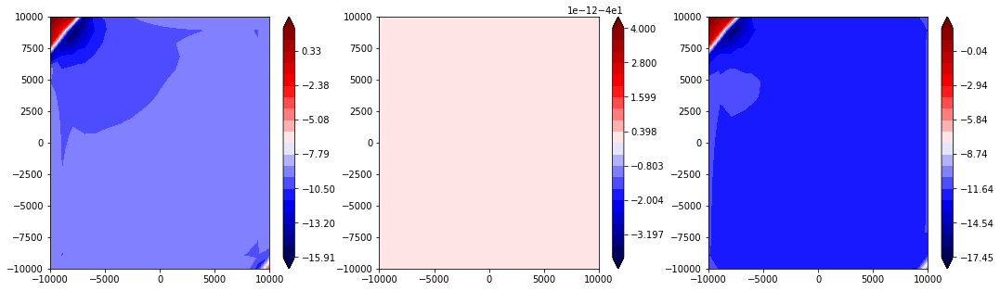

traction


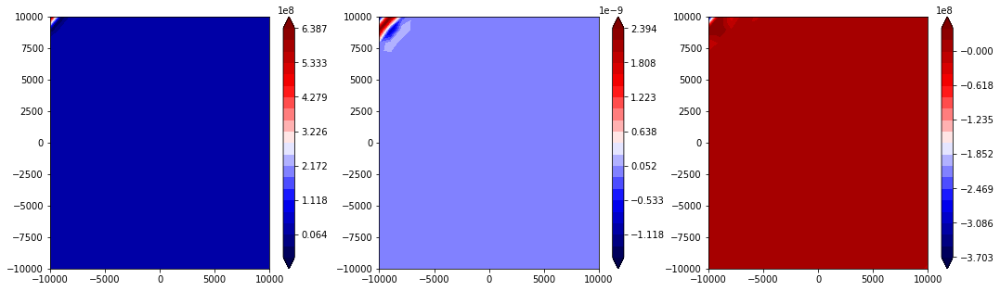

state


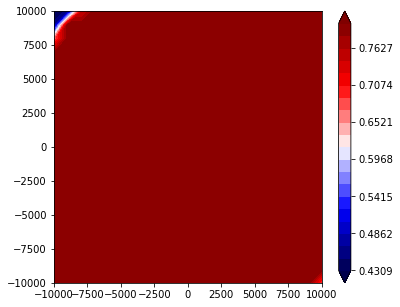

2711 37.1545159974
2712 37.1545159974
2713 37.1545159975
2714 37.1545159975
2715 37.1545159976
2716 37.1545159976
2717 37.1545159977
2718 37.1545159977
2719 37.1545159977
2720 37.1545159978
V


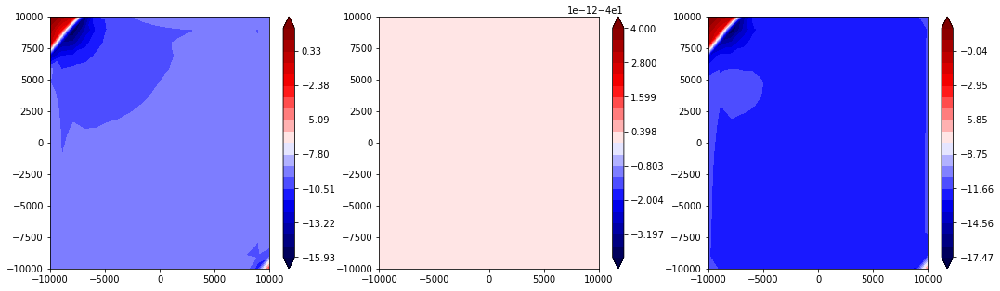

traction


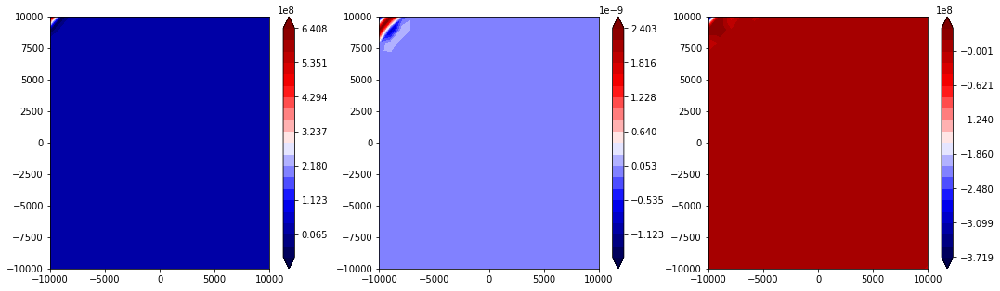

state


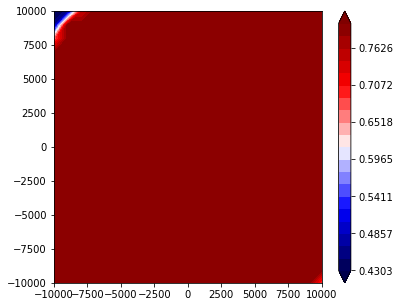

2721 37.1545159978
2722 37.1545159979
2723 37.1545159979
2724 37.1545159979
2725 37.154515998
2726 37.154515998
2727 37.1545159981
2728 37.1545159981
2729 37.1545159982
2730 37.1545159982
V


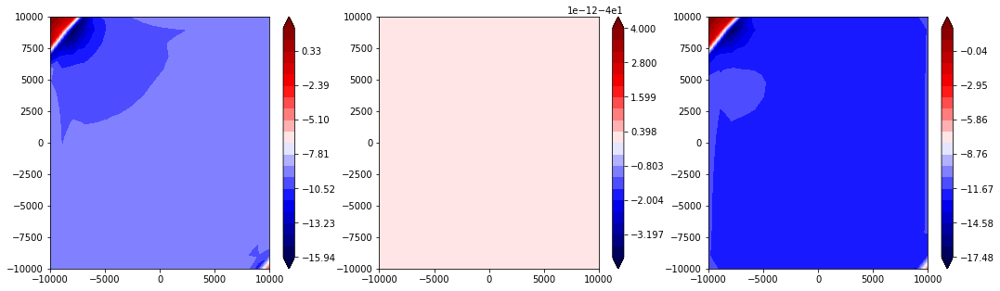

traction


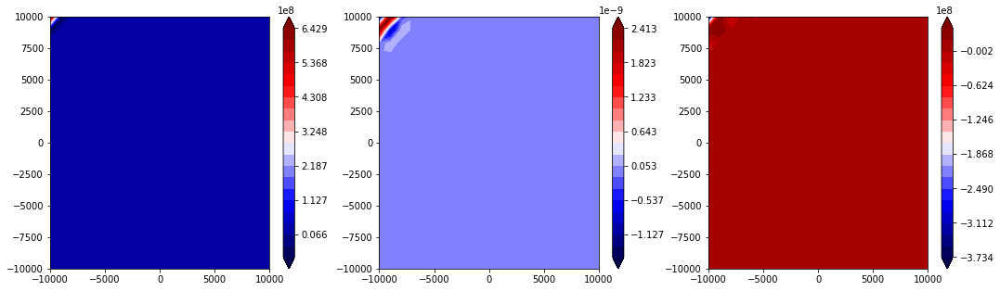

state


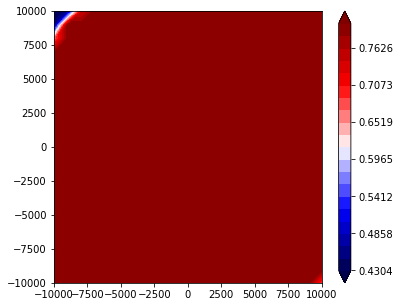

2731 37.1545159982
2732 37.1545159983
2733 37.1545159983
2734 37.1545159983
2735 37.1545159984
2736 37.1545159984
2737 37.1545159985
2738 37.1545159985
2739 37.1545159985
2740 37.1545159986
V


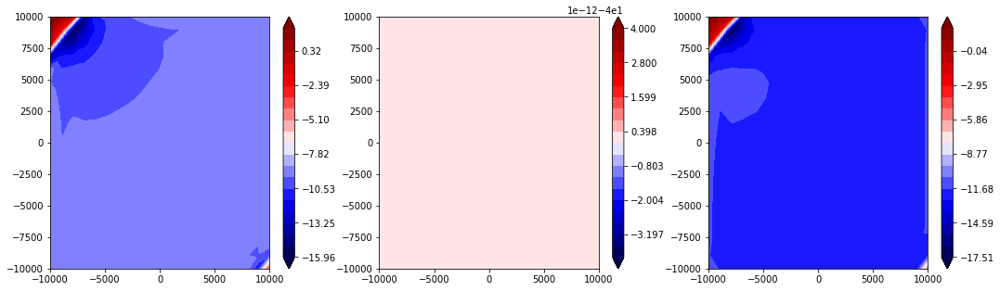

traction


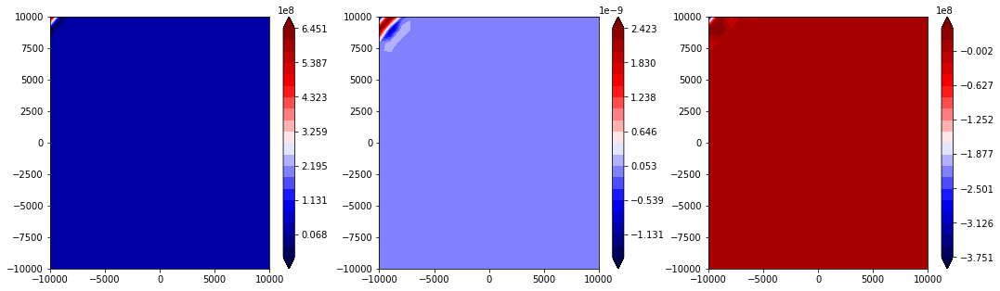

state


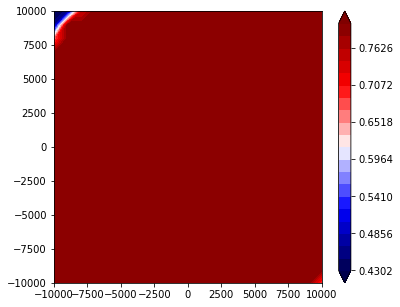

2741 37.1545159986
2742 37.1545159987
2743 37.1545159987
2744 37.1545159988
2745 37.1545159988
2746 37.1545159988
2747 37.1545159989
2748 37.1545159989
2749 37.154515999
2750 37.154515999
V


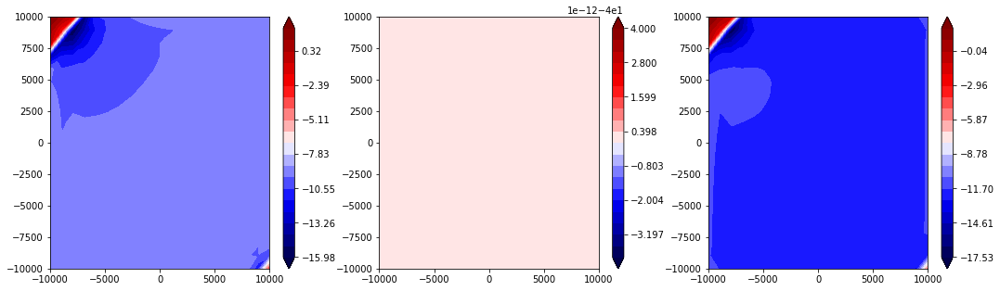

traction


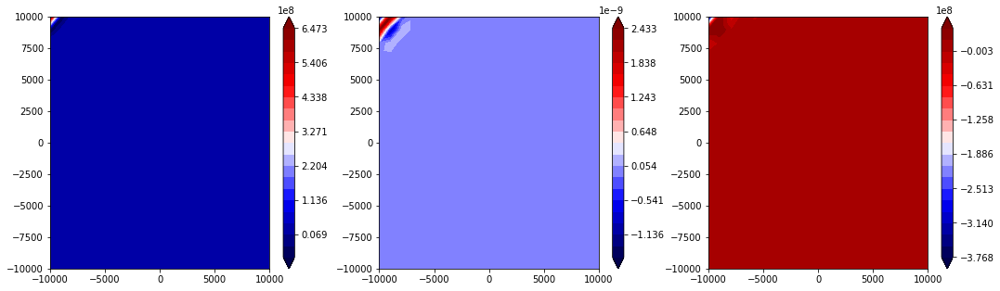

state


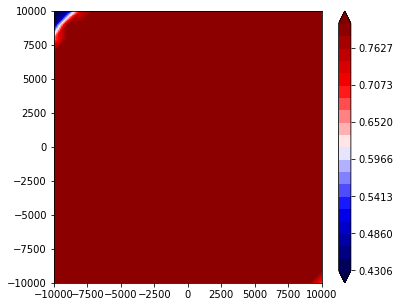

2751 37.154515999
2752 37.1545159991
2753 37.1545159991
2754 37.1545159992
2755 37.1545159992
2756 37.1545159993
2757 37.1545159993
2758 37.1545159993
2759 37.1545159993
2760 37.1545159994
V


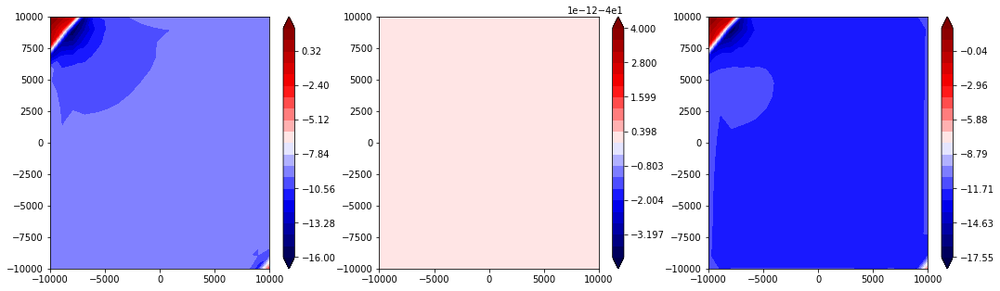

traction


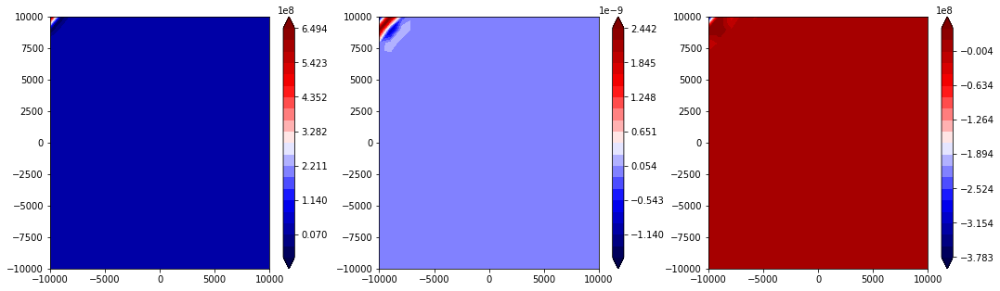

state


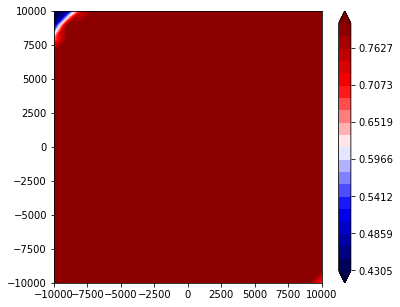

2761 37.1545159994
2762 37.1545159995
2763 37.1545159995
2764 37.1545159995
2765 37.1545159996
2766 37.1545159996
2767 37.1545159997
2768 37.1545159997
2769 37.1545159998
2770 37.1545159998
V


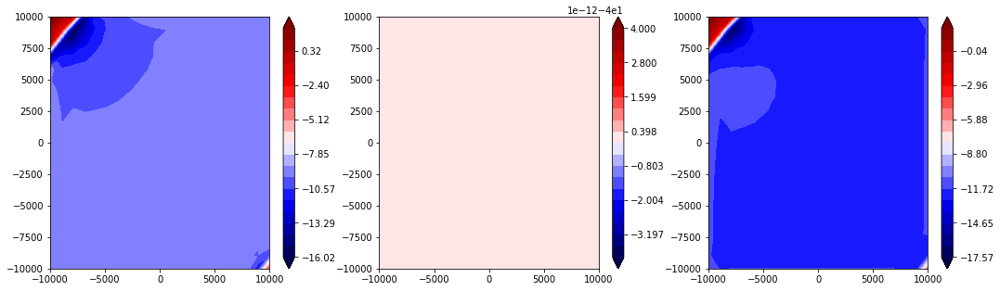

traction


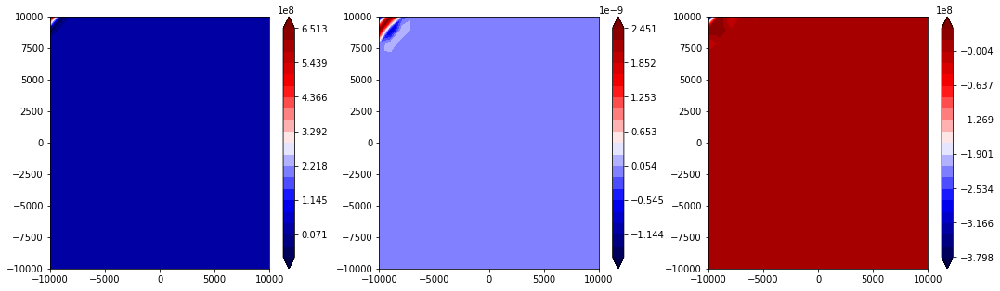

state


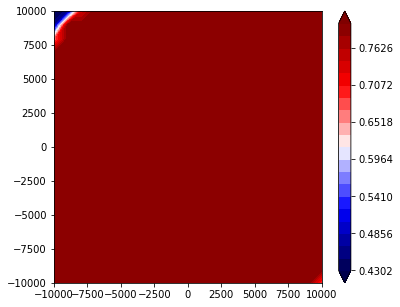

2771 37.1545159998
2772 37.1545159999
2773 37.1545159999
2774 37.1545159999
2775 37.154516
2776 37.154516
2777 37.1545160001
2778 37.1545160001
2779 37.1545160001
2780 37.1545160002
V


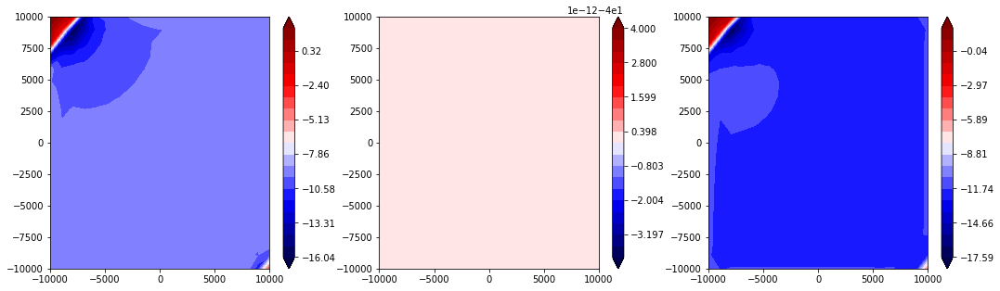

traction


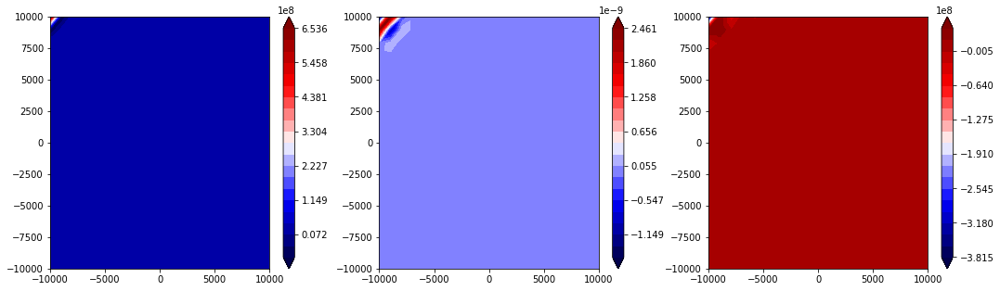

state


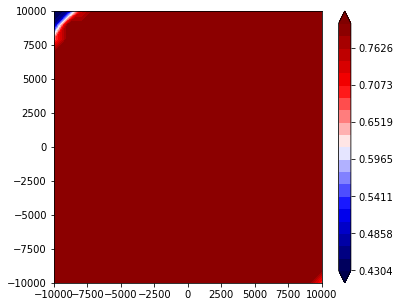

2781 37.1545160002
2782 37.1545160003
2783 37.1545160003
2784 37.1545160004
2785 37.1545160004
2786 37.1545160004
2787 37.1545160005
2788 37.1545160005
2789 37.1545160005
2790 37.1545160006
V


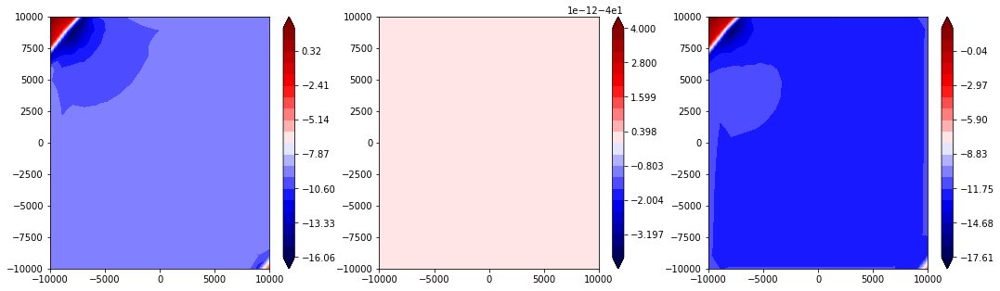

traction


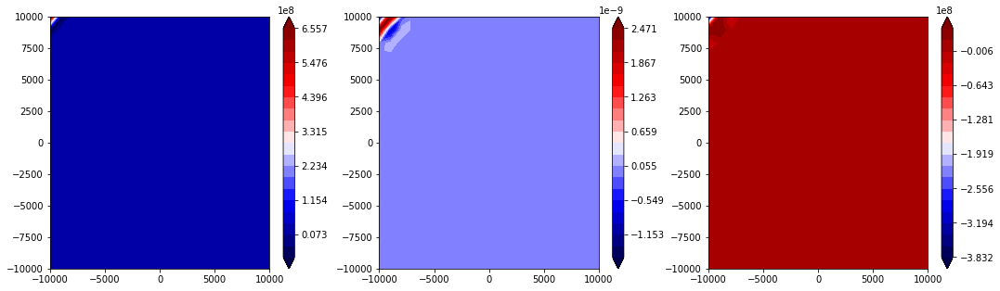

state


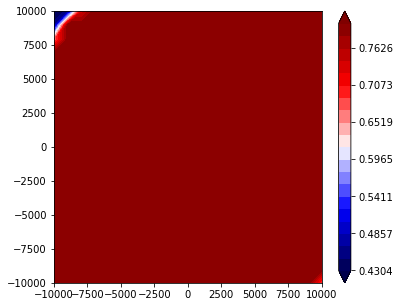

2791 37.1545160006
2792 37.1545160007
2793 37.1545160007
2794 37.1545160007
2795 37.1545160008
2796 37.1545160008
2797 37.1545160009
2798 37.1545160009
2799 37.1545160009
2800 37.154516001
V


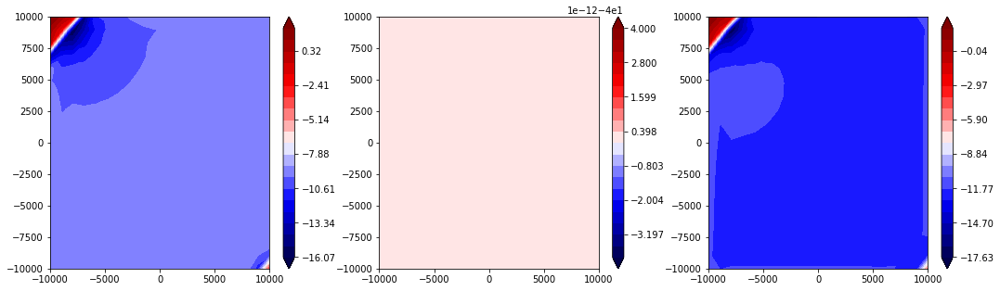

traction


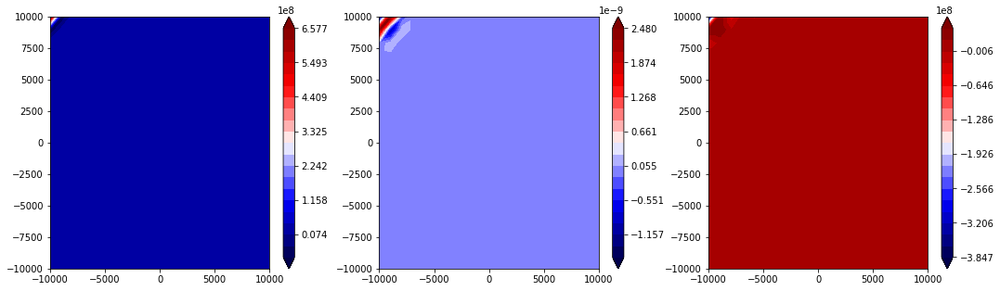

state


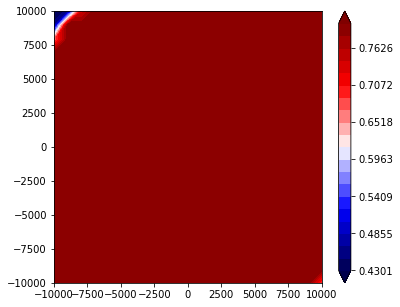

2801 37.154516001
2802 37.154516001
2803 37.1545160011
2804 37.1545160011
2805 37.1545160012
2806 37.1545160012
2807 37.1545160012
2808 37.1545160013
2809 37.1545160013
2810 37.1545160014
V


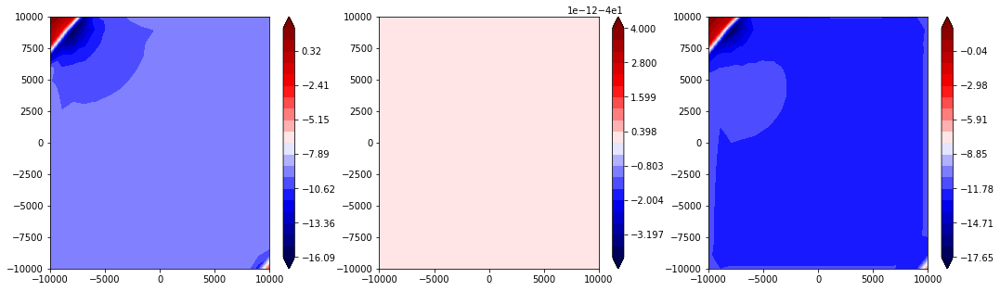

traction


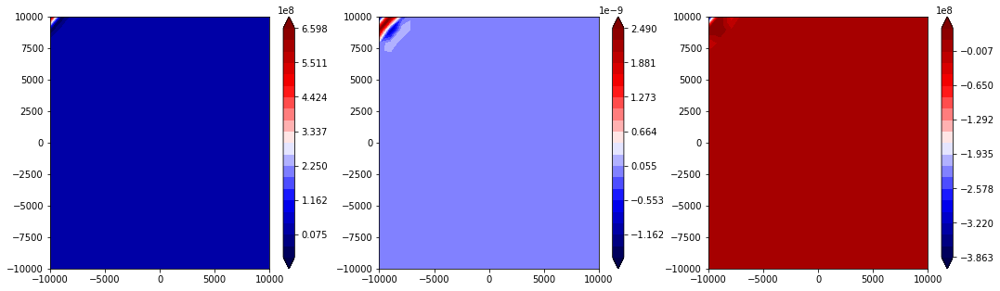

state


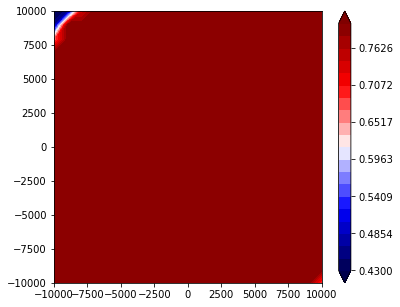

2811 37.1545160014
2812 37.1545160014
2813 37.1545160015
2814 37.1545160015
2815 37.1545160016
2816 37.1545160016
2817 37.1545160017
2818 37.1545160017
2819 37.1545160017
2820 37.1545160018
V


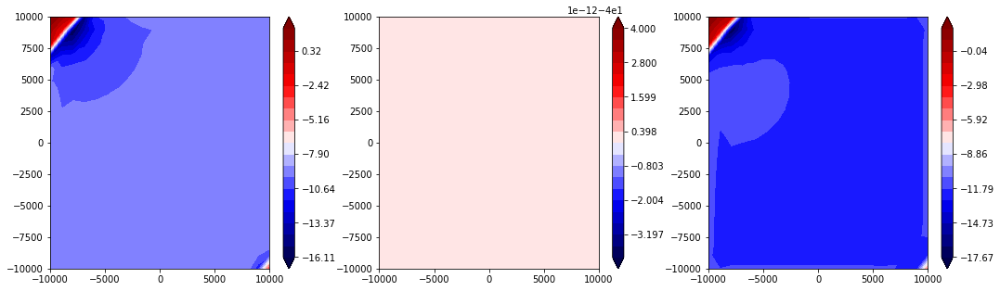

traction


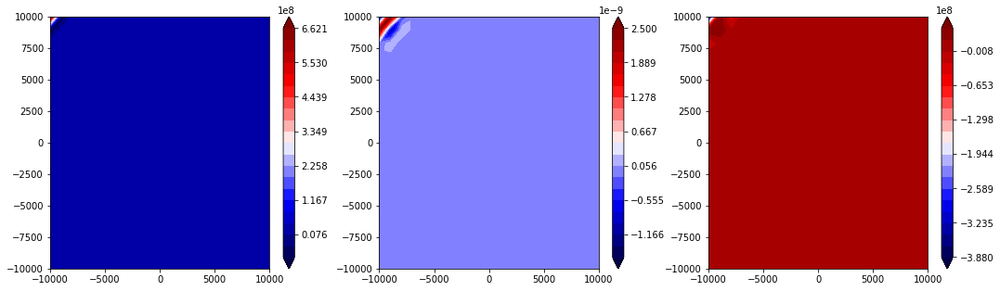

state


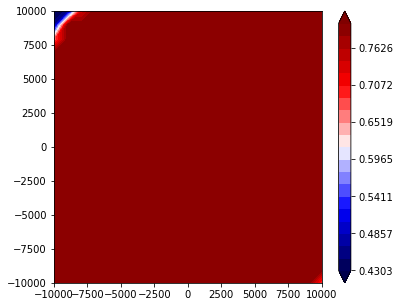

2821 37.1545160018
2822 37.1545160018
2823 37.1545160019
2824 37.1545160019
2825 37.1545160019
2826 37.154516002
2827 37.154516002
2828 37.154516002
2829 37.1545160021
2830 37.1545160021
V


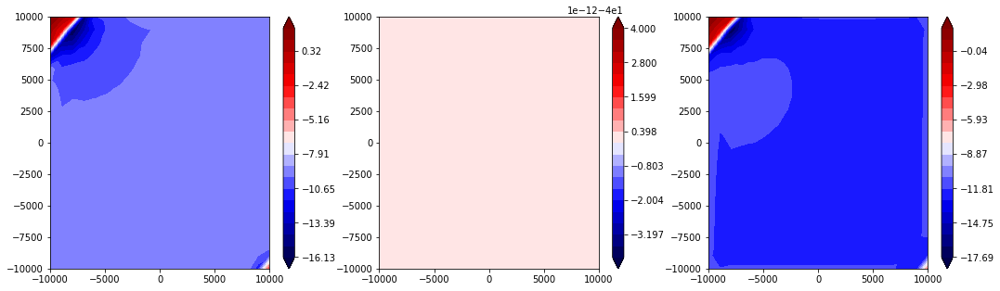

traction


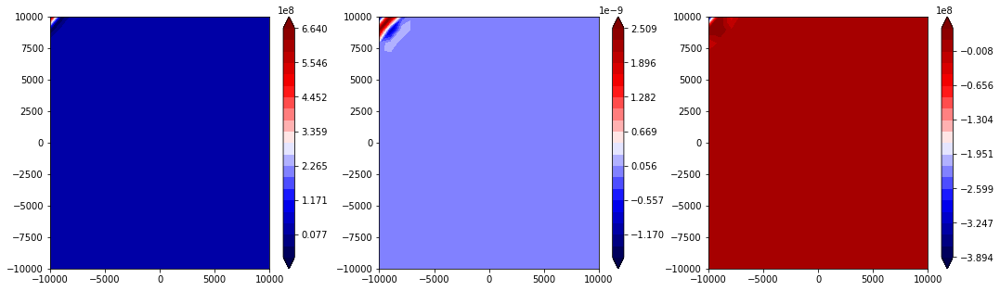

state


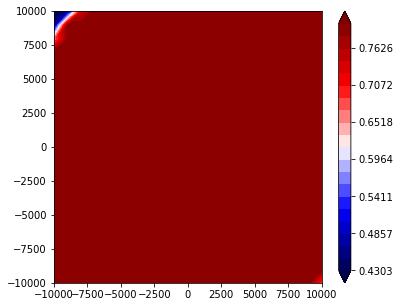

2831 37.1545160021
2832 37.1545160022
2833 37.1545160022
2834 37.1545160023
2835 37.1545160023
2836 37.1545160024
2837 37.1545160024
2838 37.1545160024
2839 37.1545160025
2840 37.1545160025
V


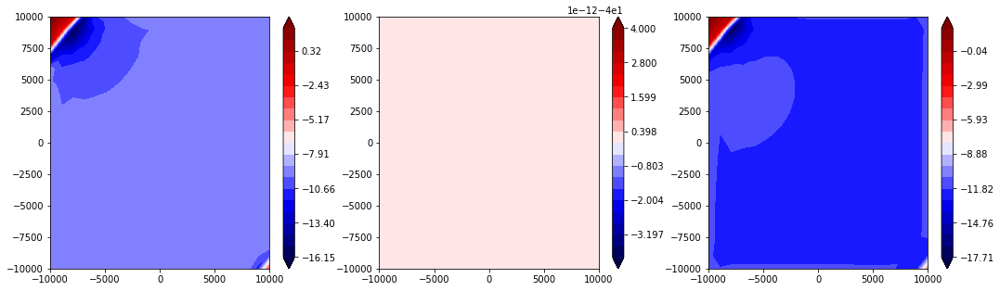

traction


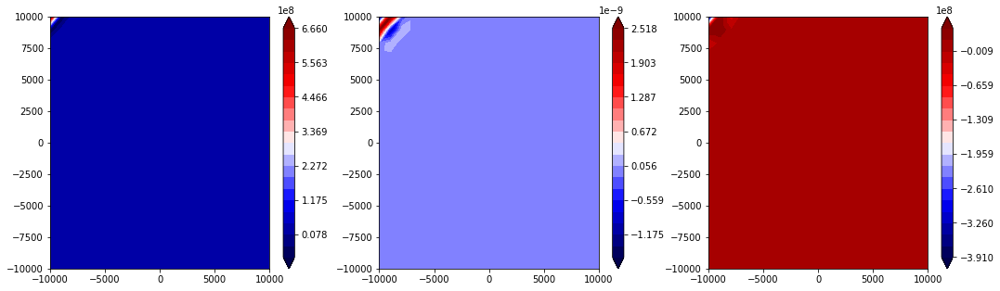

state


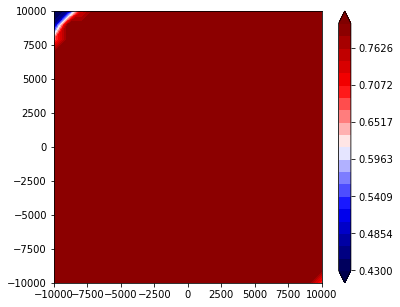

2841 37.1545160025
2842 37.1545160026
2843 37.1545160026
2844 37.1545160026
2845 37.1545160027
2846 37.1545160027
2847 37.1545160027
2848 37.1545160028
2849 37.1545160028
2850 37.1545160029
V


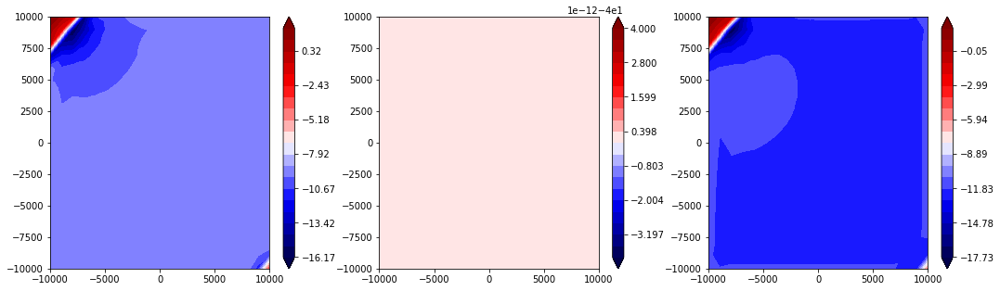

traction


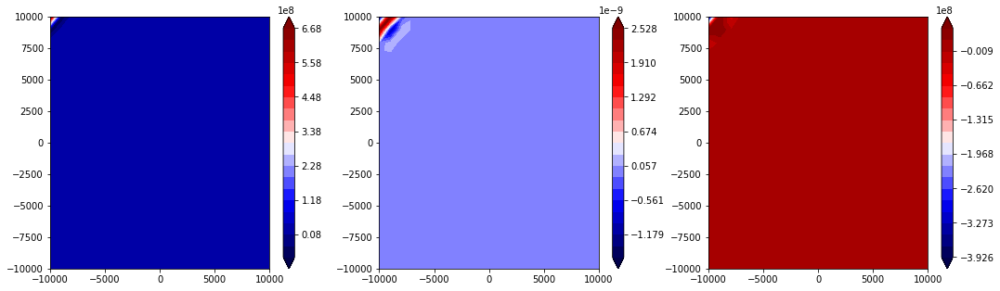

state


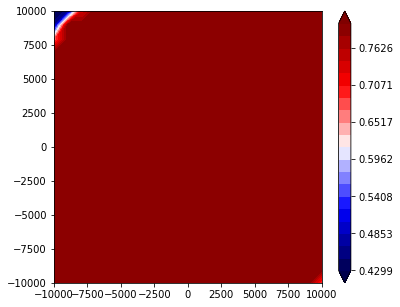

2851 37.1545160029
2852 37.154516003
2853 37.154516003
2854 37.154516003
2855 37.1545160031
2856 37.1545160031
2857 37.1545160031
2858 37.1545160032
2859 37.1545160032
2860 37.1545160033
V


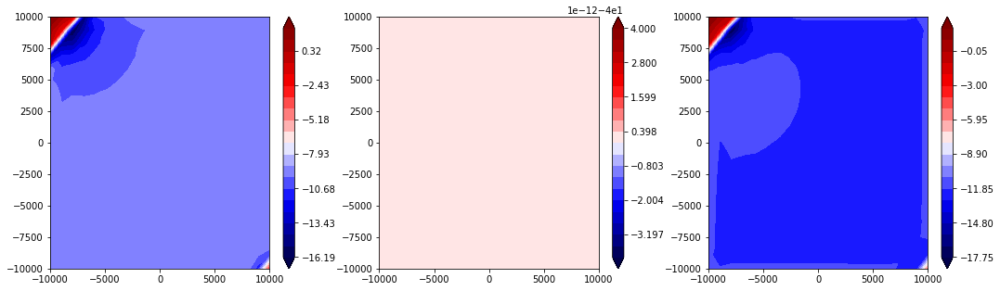

traction


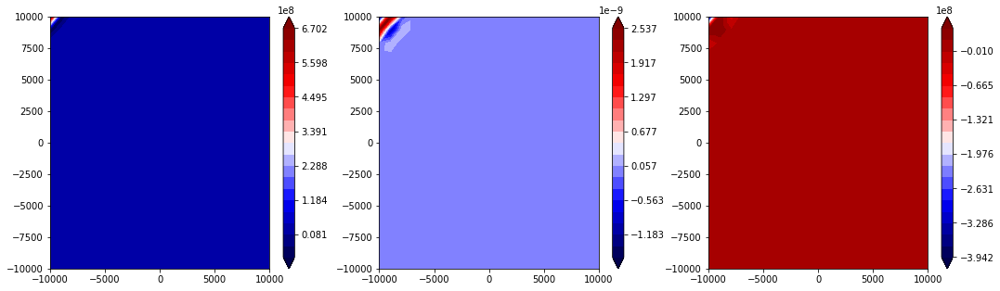

state


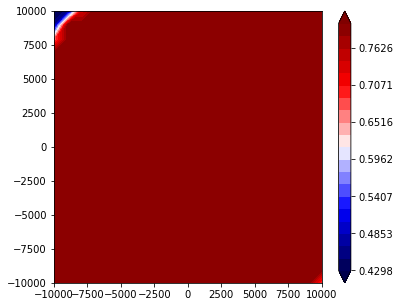

2861 37.1545160033
2862 37.1545160033
2863 37.1545160034
2864 37.1545160034
2865 37.1545160035
2866 37.1545160035
2867 37.1545160036
2868 37.1545160036
2869 37.1545160036
2870 37.1545160037
V


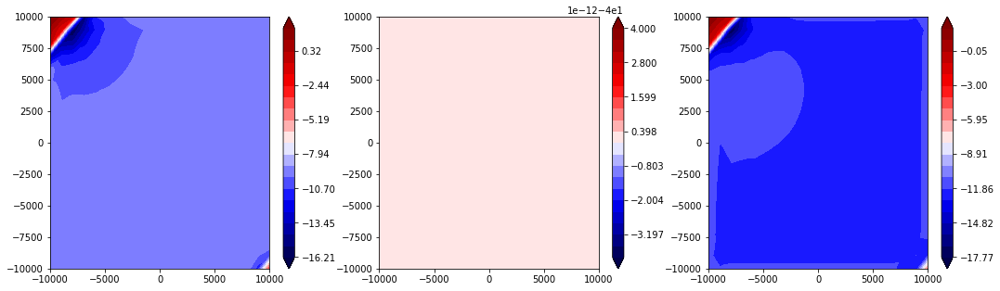

traction


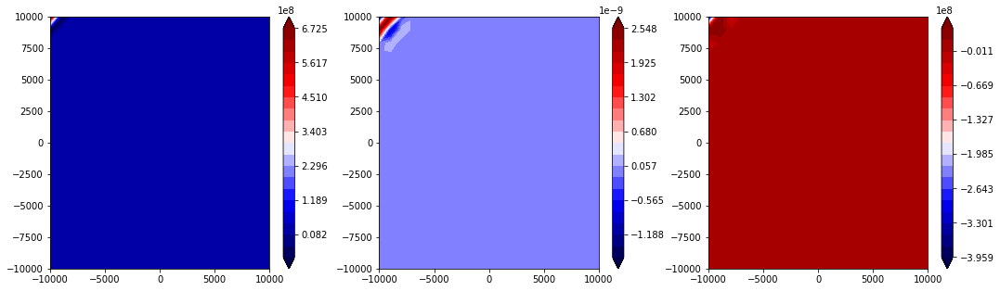

state


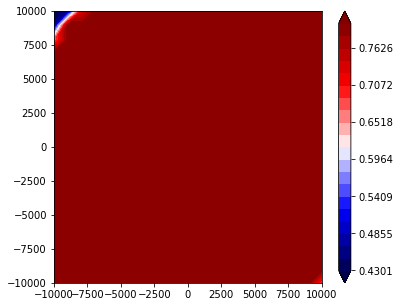

2871 37.1545160037
2872 37.1545160037
2873 37.1545160038
2874 37.1545160038
2875 37.1545160039
2876 37.1545160039
2877 37.1545160039
2878 37.154516004
2879 37.154516004
2880 37.154516004
V


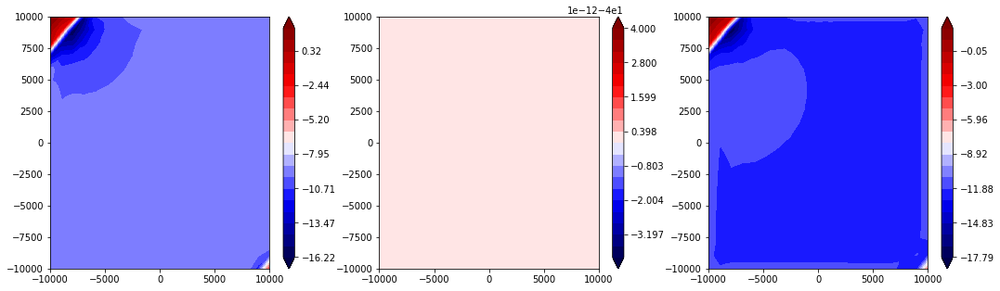

traction


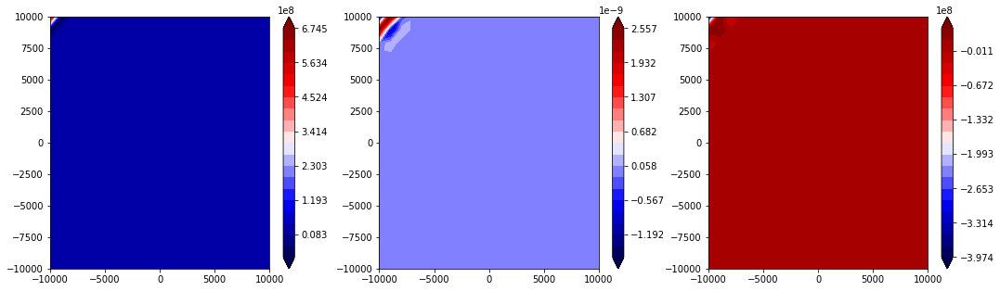

state


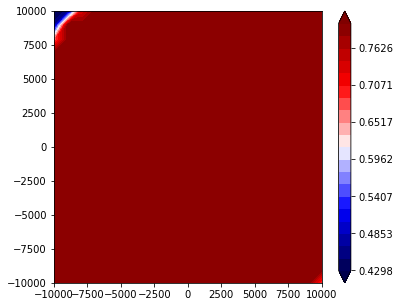

2881 37.1545160041
2882 37.1545160041
2883 37.1545160042
2884 37.1545160042
2885 37.1545160042
2886 37.1545160043
2887 37.1545160043
2888 37.1545160043
2889 37.1545160044
2890 37.1545160044
V


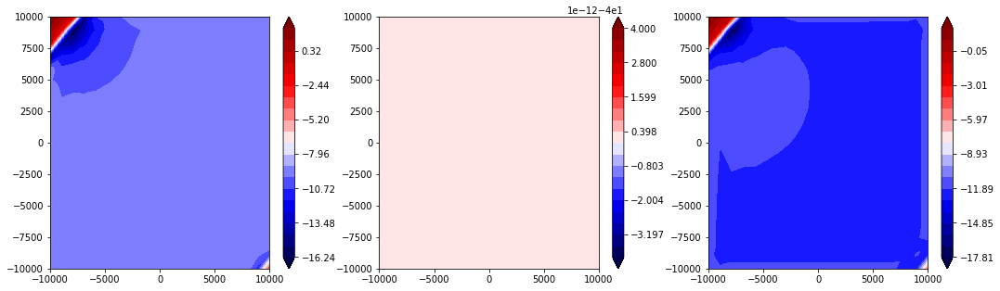

traction


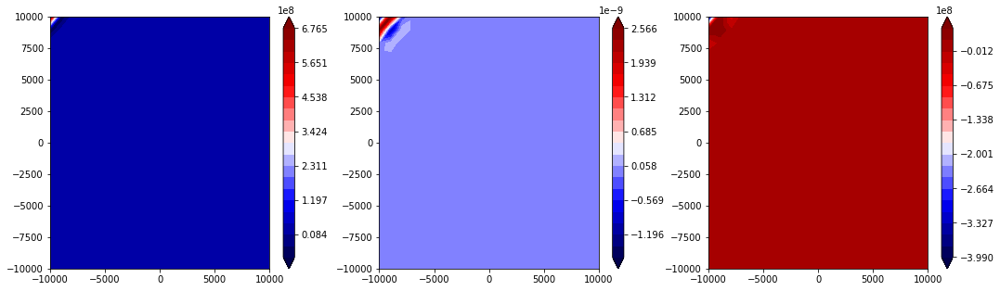

state


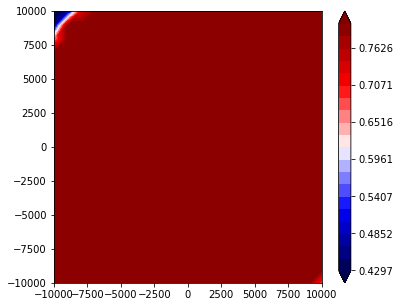

2891 37.1545160045
2892 37.1545160045
2893 37.1545160045
2894 37.1545160046
2895 37.1545160046
2896 37.1545160046
2897 37.1545160047
2898 37.1545160047
2899 37.1545160048
2900 37.1545160048
V


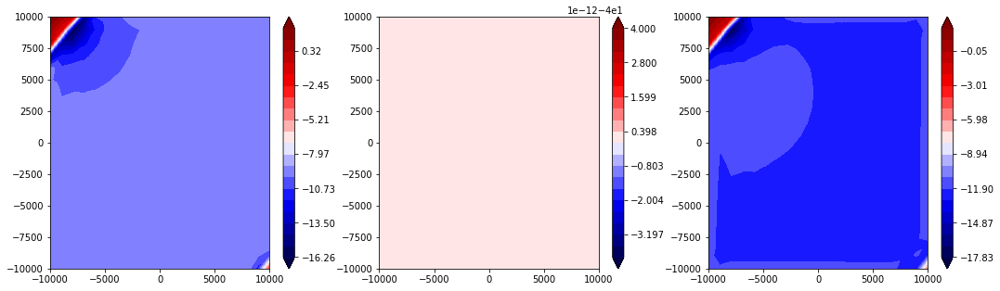

traction


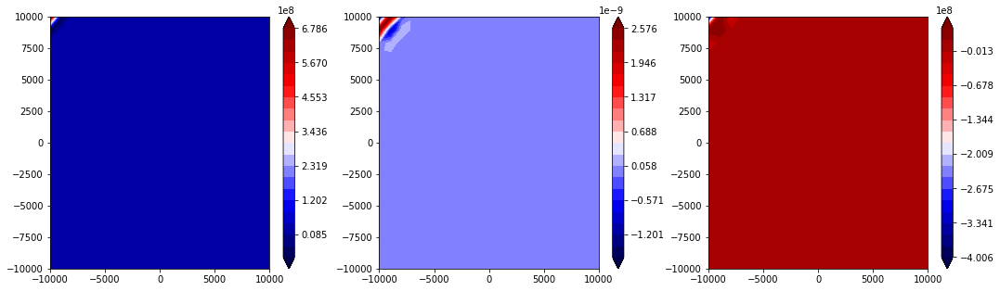

state


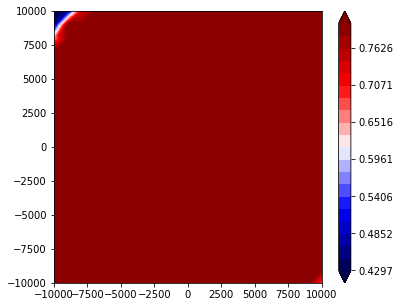

2901 37.1545160049
2902 37.1545160049
2903 37.1545160049
2904 37.1545160049
2905 37.154516005
2906 37.154516005
2907 37.154516005
2908 37.154516005
2909 37.1545160051
2910 37.1545160051
V


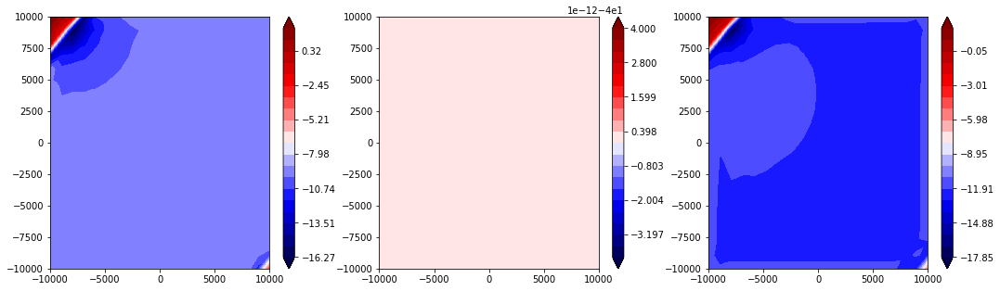

traction


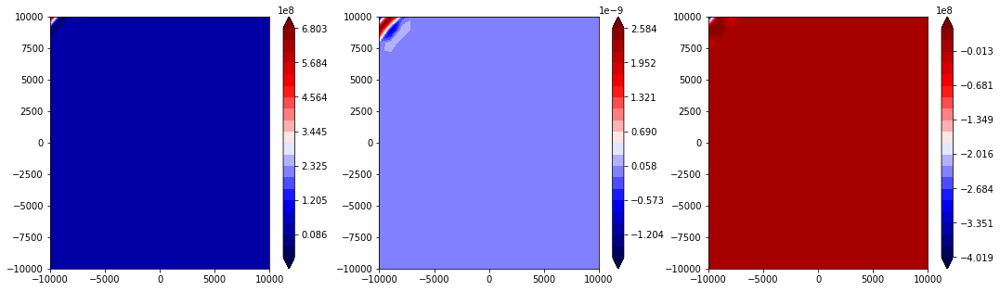

state


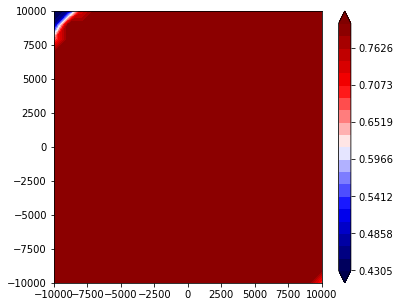

2911 37.1545160051
2912 37.1545160051
2913 37.1545160052
2914 37.1545160052
2915 37.1545160052
2916 37.1545160053
2917 37.1545160053
2918 37.1545160053
2919 37.1545160053
2920 37.1545160054
V


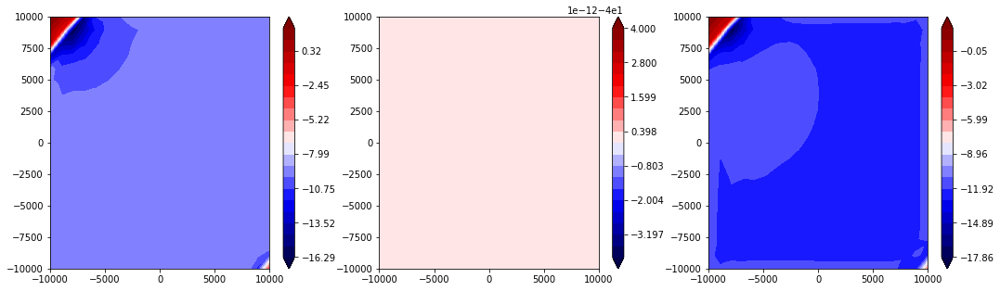

traction


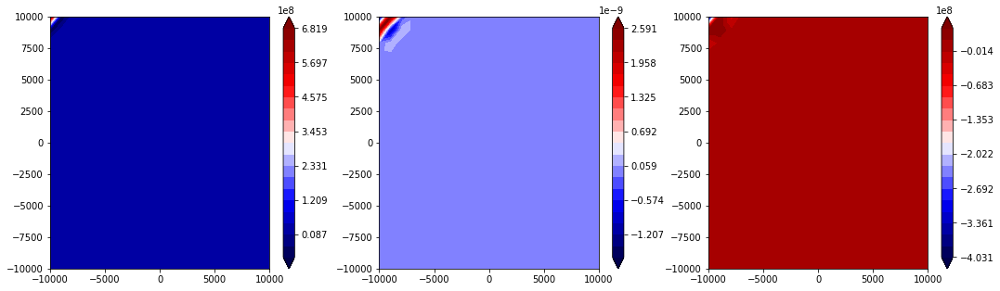

state


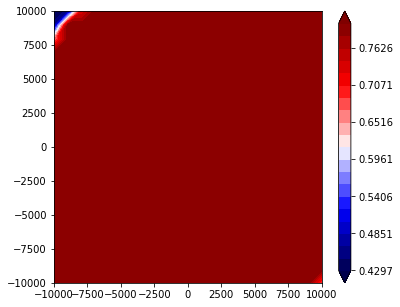

2921 37.1545160054
2922 37.1545160054
2923 37.1545160055
2924 37.1545160055
2925 37.1545160056
2926 37.1545160056
2927 37.1545160057
2928 37.1545160057
2929 37.1545160057
2930 37.1545160058
V


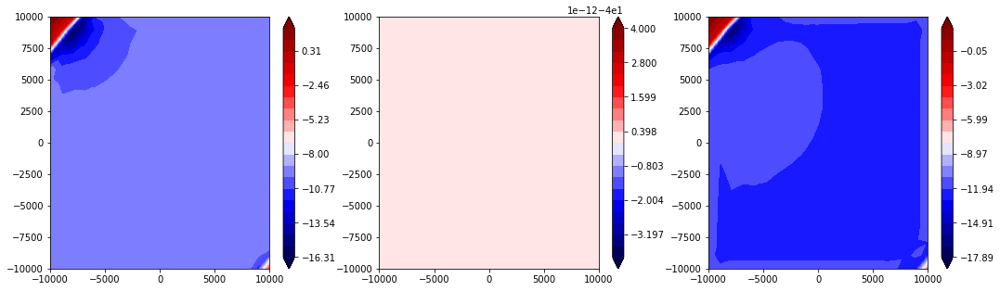

traction


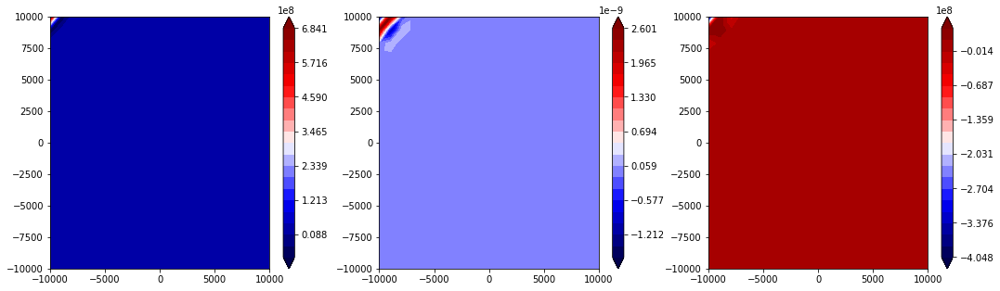

state


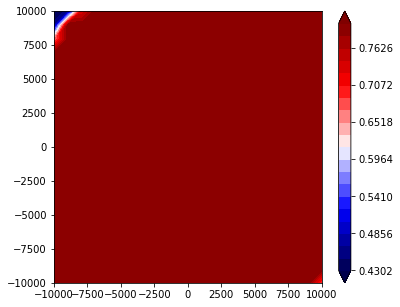

2931 37.1545160058
2932 37.1545160058
2933 37.1545160059
2934 37.1545160059
2935 37.1545160059
2936 37.154516006
2937 37.154516006
2938 37.154516006
2939 37.1545160061
2940 37.1545160061
V


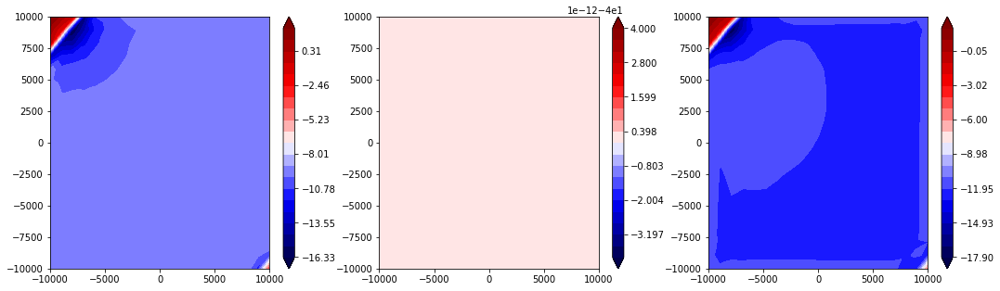

traction


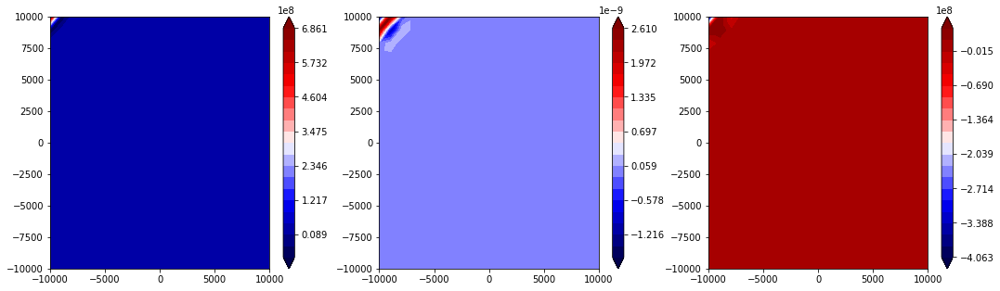

state


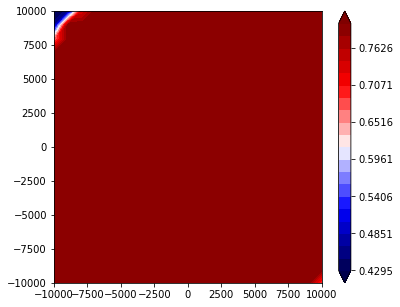

2941 37.1545160062
2942 37.1545160062
2943 37.1545160062
2944 37.1545160063
2945 37.1545160063
2946 37.1545160063
2947 37.1545160064
2948 37.1545160064
2949 37.1545160065
2950 37.1545160065
V


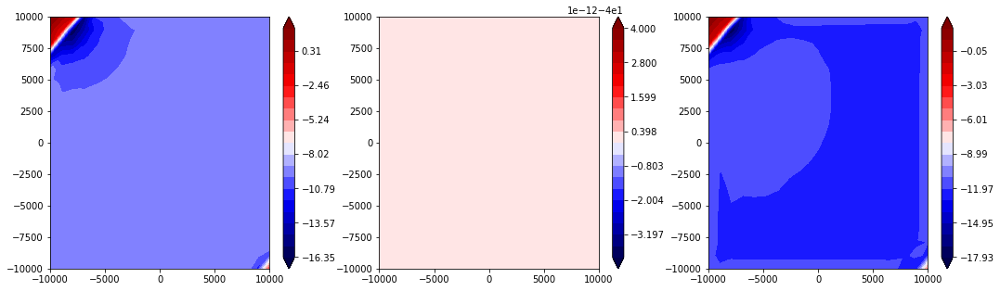

traction


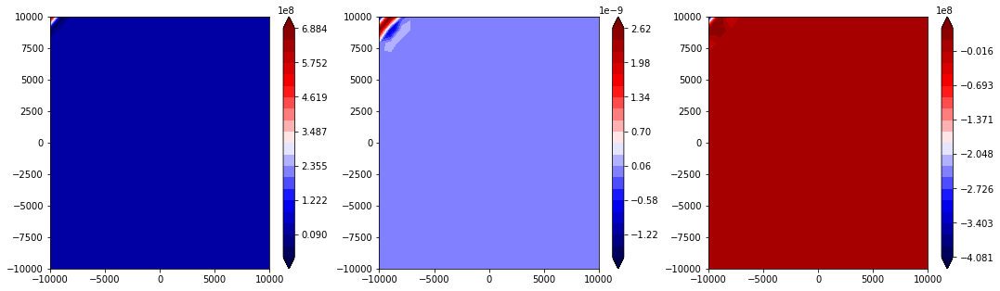

state


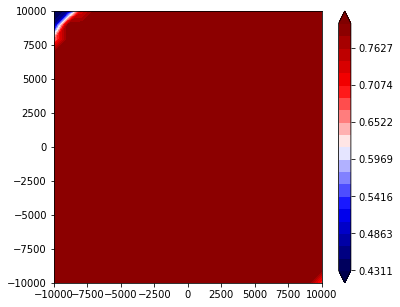

2951 37.1545160065
2952 37.1545160066
2953 37.1545160066
2954 37.1545160067
2955 37.1545160067
2956 37.1545160067
2957 37.1545160068
2958 37.1545160068
2959 37.1545160068
2960 37.1545160069
V


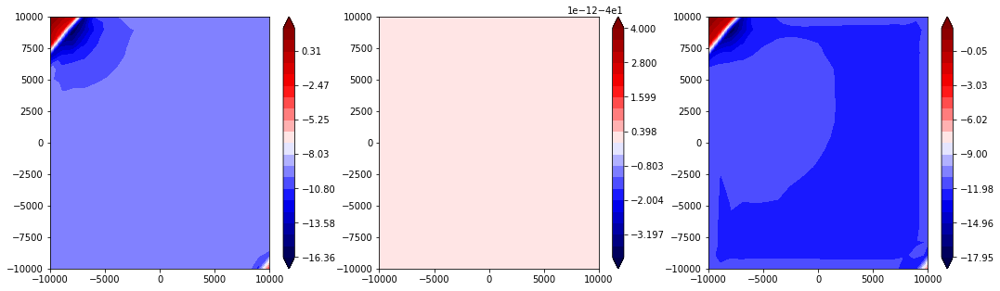

traction


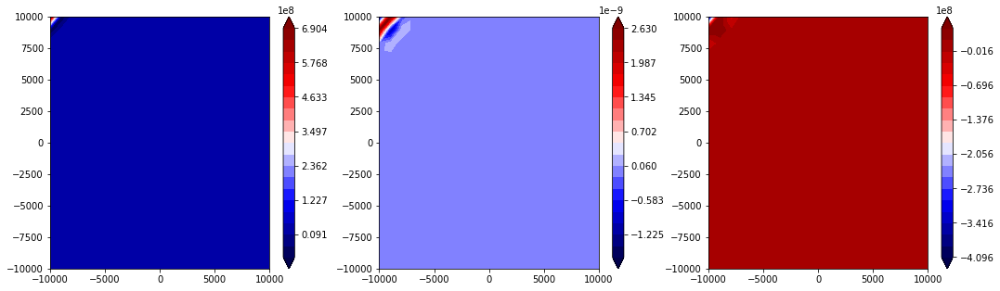

state


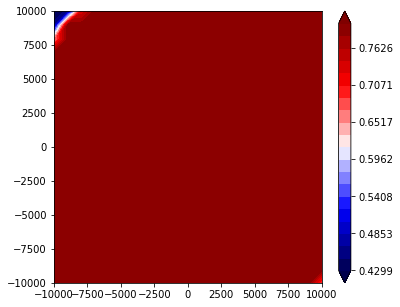

2961 37.1545160069
2962 37.1545160069
2963 37.154516007
2964 37.154516007
2965 37.154516007
2966 37.1545160071
2967 37.1545160071
2968 37.1545160072
2969 37.1545160072
2970 37.1545160072
V


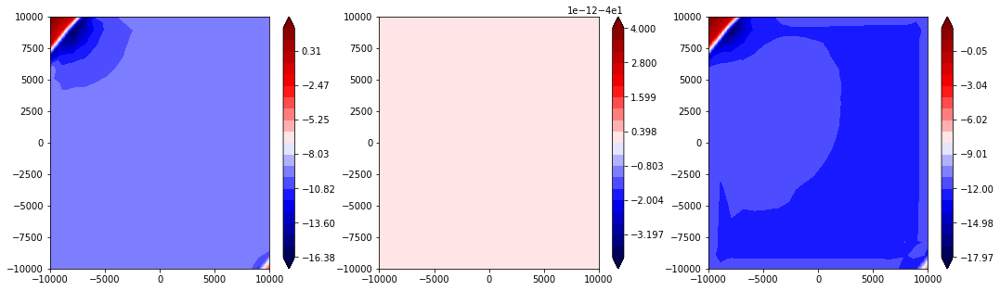

traction


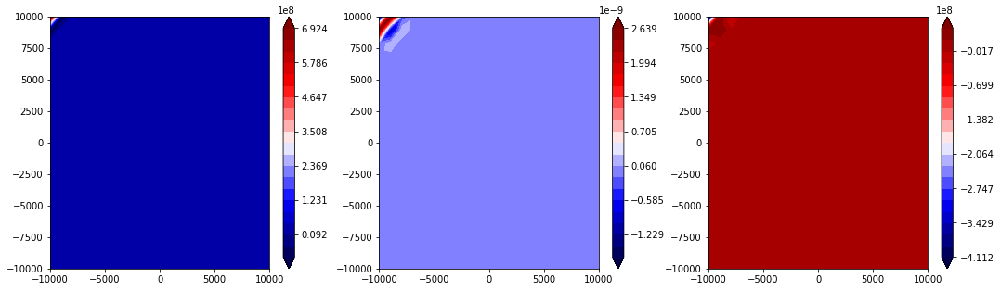

state


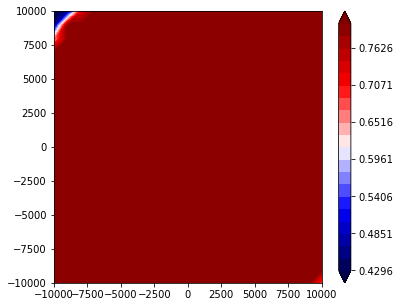

2971 37.1545160073
2972 37.1545160073
2973 37.1545160074
2974 37.1545160074
2975 37.1545160074
2976 37.1545160075
2977 37.1545160075
2978 37.1545160076
2979 37.1545160076
2980 37.1545160076
V


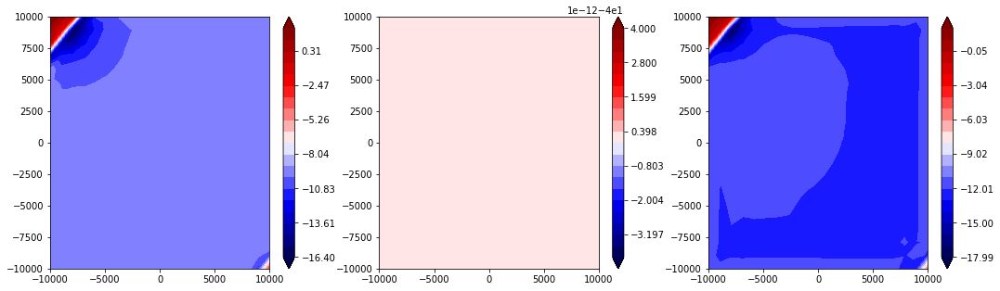

traction


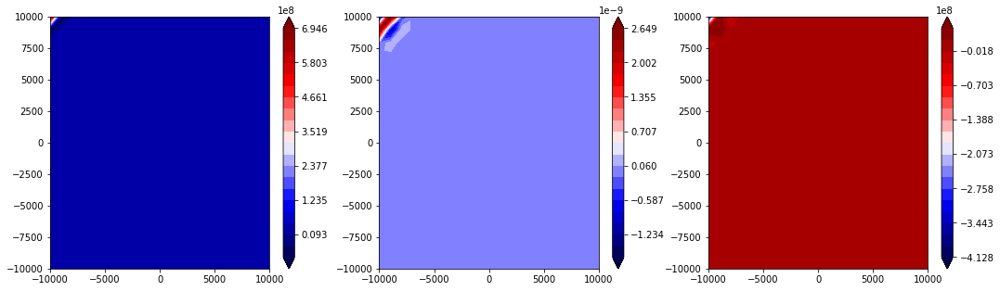

state


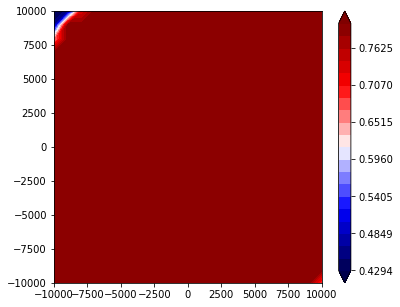

2981 37.1545160077
2982 37.1545160077
2983 37.1545160077
2984 37.1545160078
2985 37.1545160078
2986 37.1545160078
2987 37.1545160079
2988 37.1545160079
2989 37.1545160079
2990 37.154516008
V


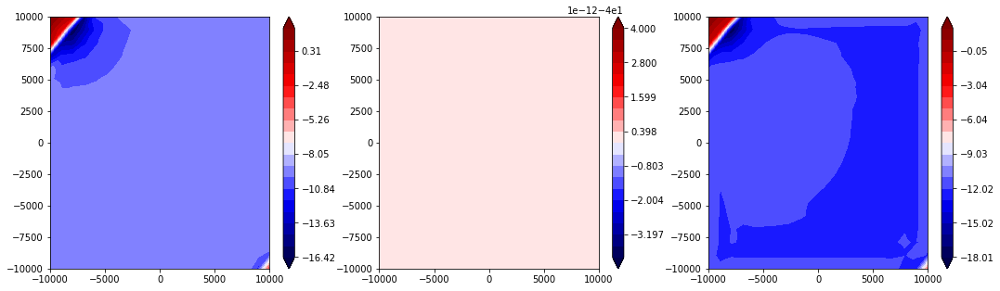

traction


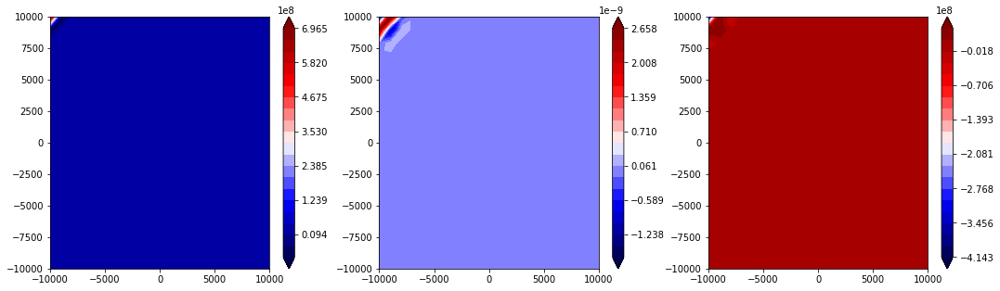

state


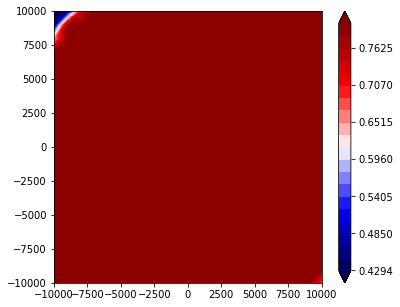

2991 37.154516008
2992 37.154516008
2993 37.154516008
2994 37.1545160081
2995 37.1545160082
2996 37.1545160082
2997 37.1545160082
2998 37.1545160082
2999 37.1545160083
3000 37.1545160083
V


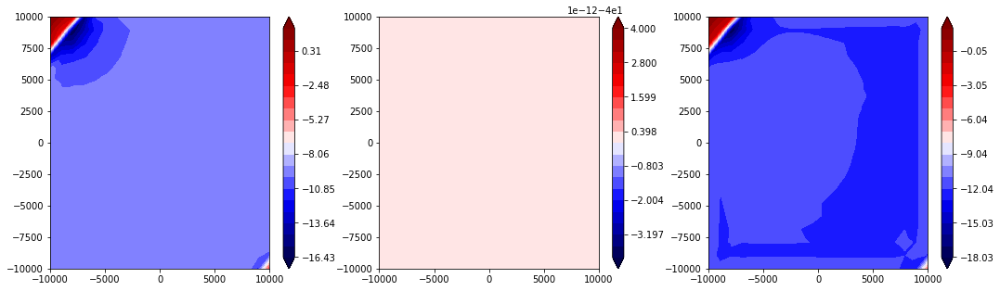

traction


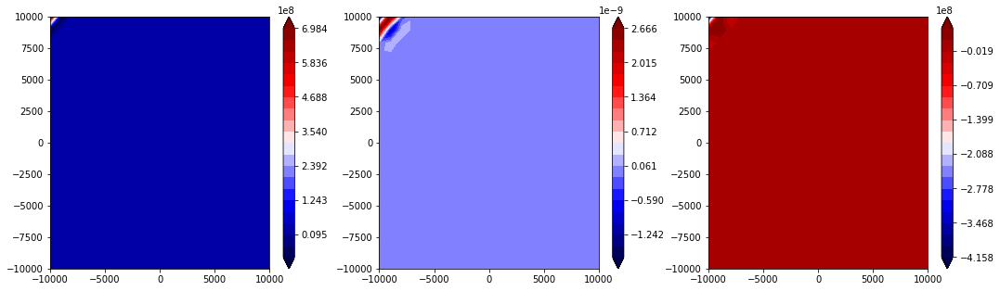

state


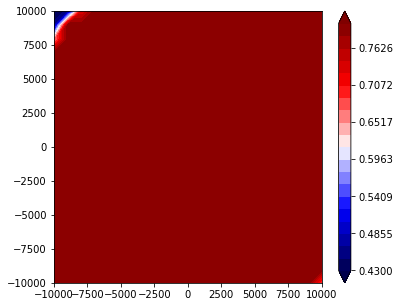

3001 37.1545160083
3002 37.1545160083
3003 37.1545160084
3004 37.1545160084
3005 37.1545160084
3006 37.1545160085
3007 37.1545160085
3008 37.1545160085
3009 37.1545160086
3010 37.1545160086
V


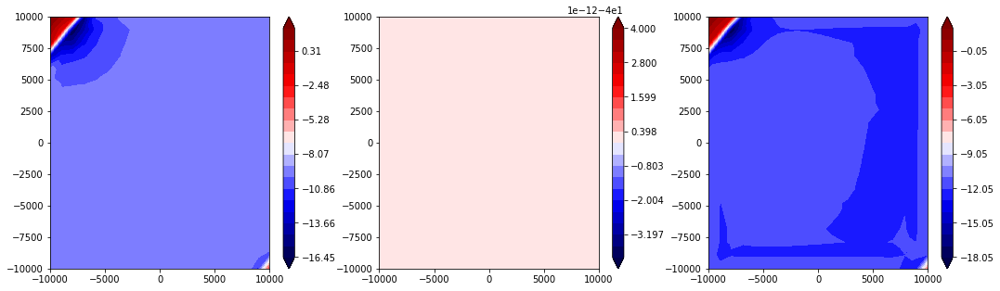

traction


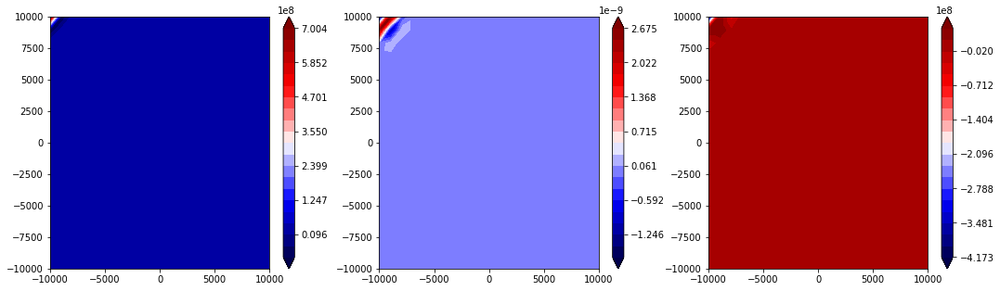

state


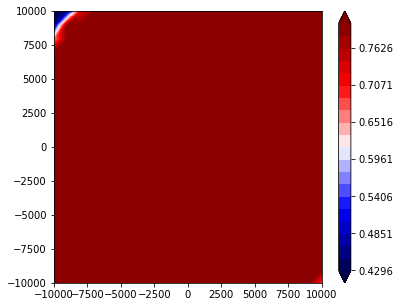

3011 37.1545160087
3012 37.1545160087
3013 37.1545160087
3014 37.1545160088
3015 37.1545160088
3016 37.1545160088
3017 37.1545160089
3018 37.1545160089
3019 37.154516009
3020 37.154516009
V


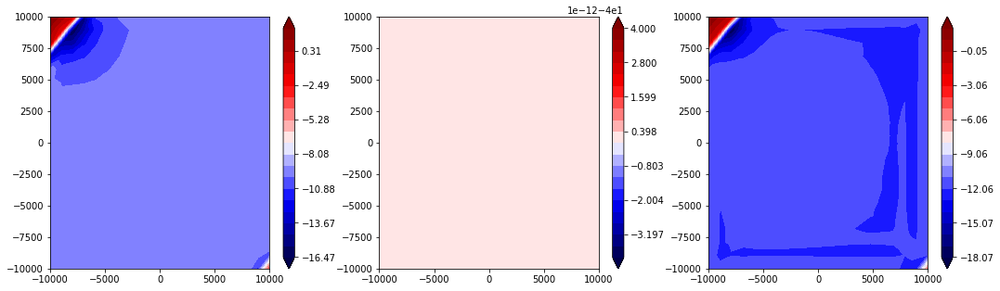

traction


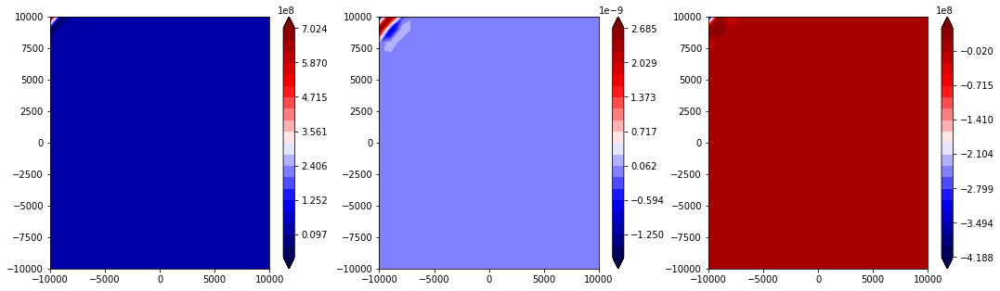

state


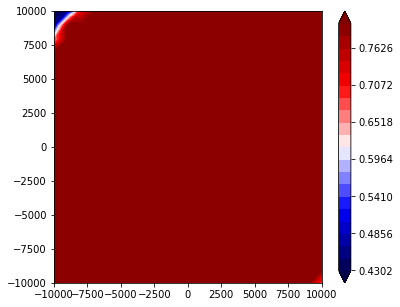

3021 37.154516009
3022 37.154516009
3023 37.1545160091
3024 37.1545160091
3025 37.1545160091
3026 37.1545160091
3027 37.1545160092
3028 37.1545160092
3029 37.1545160092
3030 37.1545160092
V


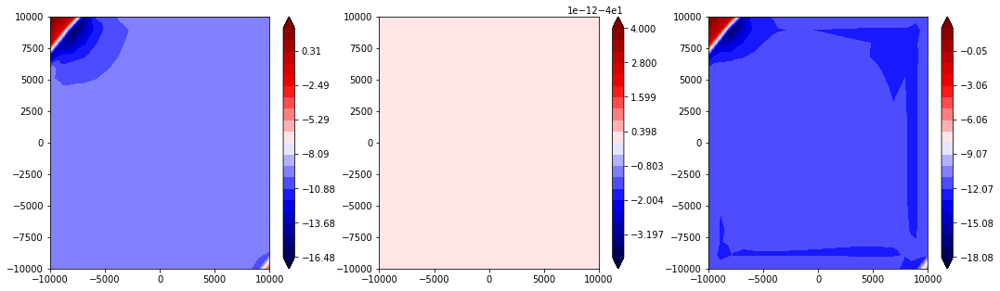

traction


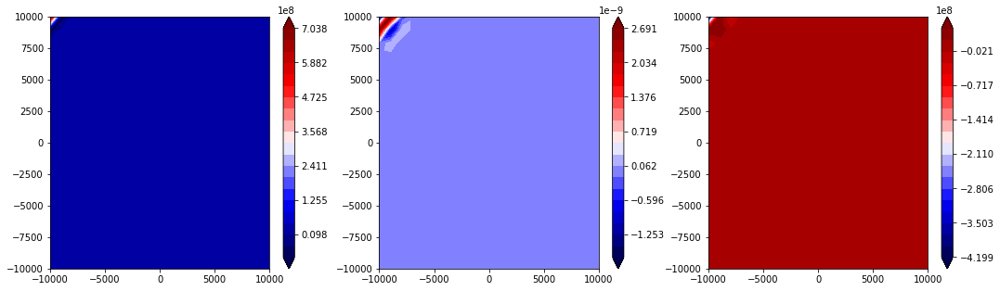

state


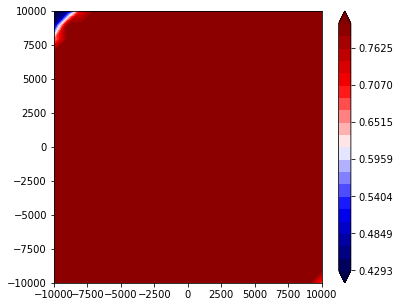

3031 37.1545160093
3032 37.1545160093
3033 37.1545160093
3034 37.1545160094
3035 37.1545160094
3036 37.1545160094
3037 37.1545160095
3038 37.1545160095
3039 37.1545160095
3040 37.1545160096
V


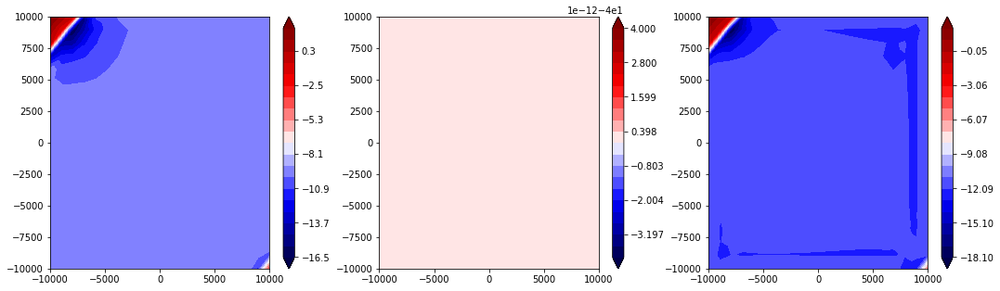

traction


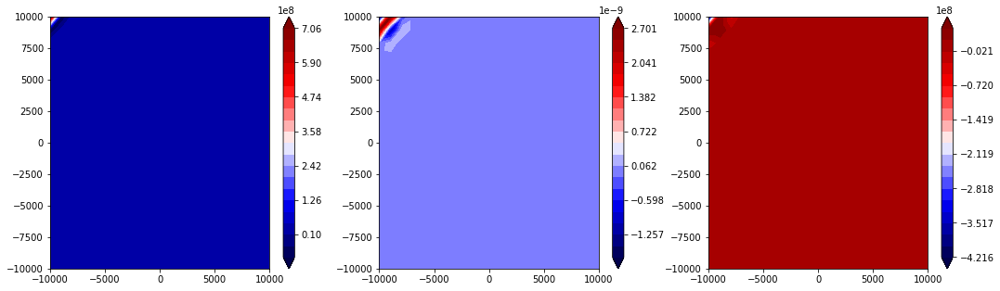

state


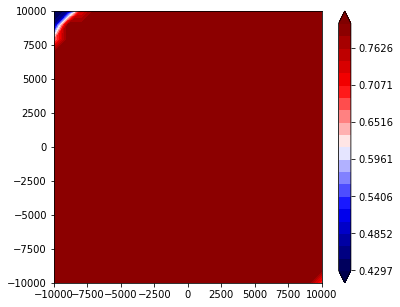

3041 37.1545160096
3042 37.1545160097
3043 37.1545160097
3044 37.1545160097
3045 37.1545160098
3046 37.1545160098
3047 37.1545160098
3048 37.1545160099
3049 37.1545160099
3050 37.1545160099
V


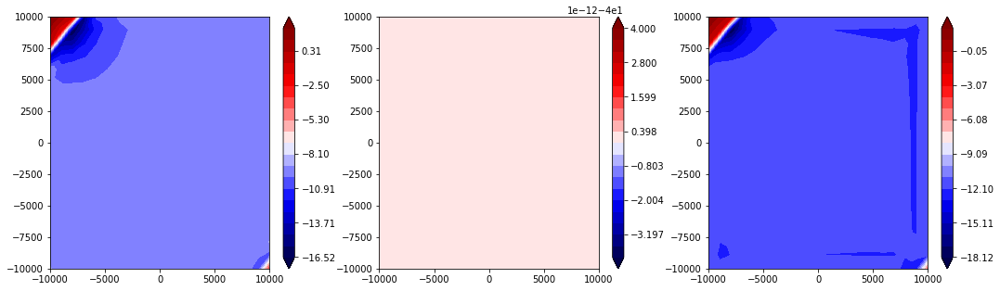

traction


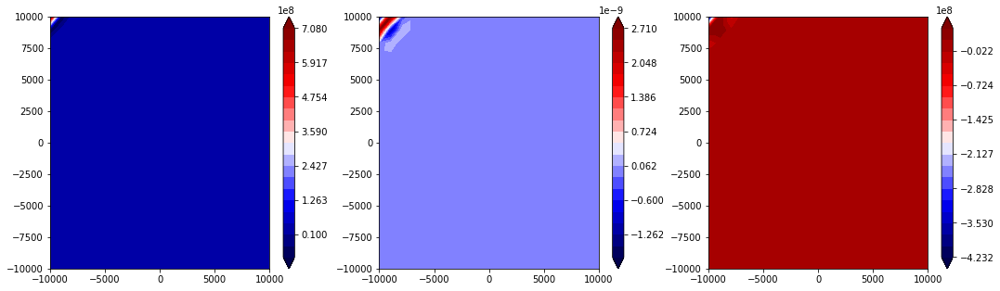

state


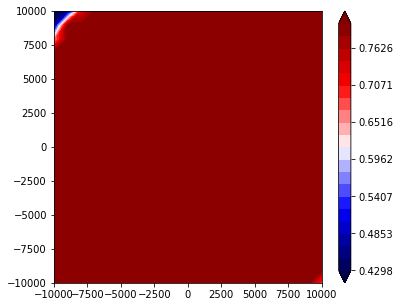

3051 37.15451601
3052 37.15451601
3053 37.15451601
3054 37.1545160101
3055 37.1545160101
3056 37.1545160102
3057 37.1545160102
3058 37.1545160102
3059 37.1545160103
3060 37.1545160103
V


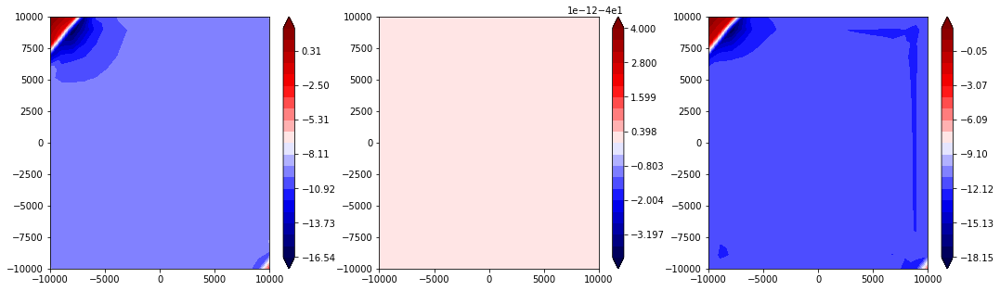

traction


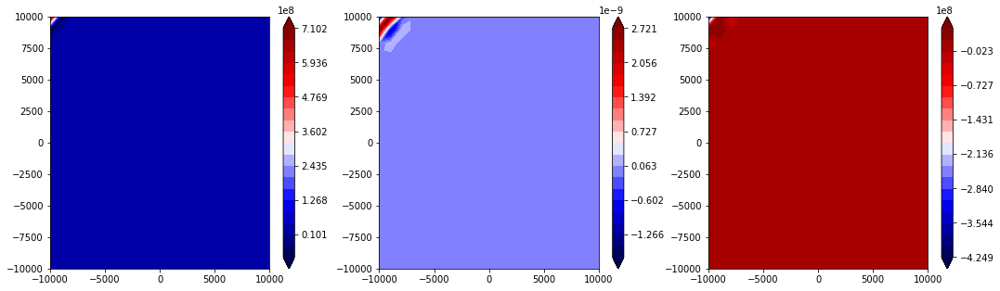

state


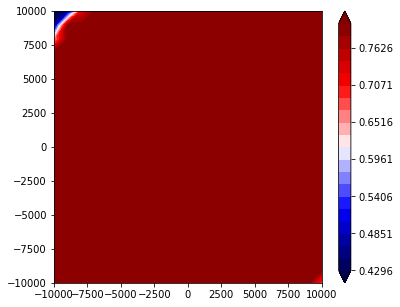

3061 37.1545160103
3062 37.1545160104
3063 37.1545160104
3064 37.1545160105
3065 37.1545160105
3066 37.1545160105
3067 37.1545160106
3068 37.1545160106
3069 37.1545160106
3070 37.1545160106
V


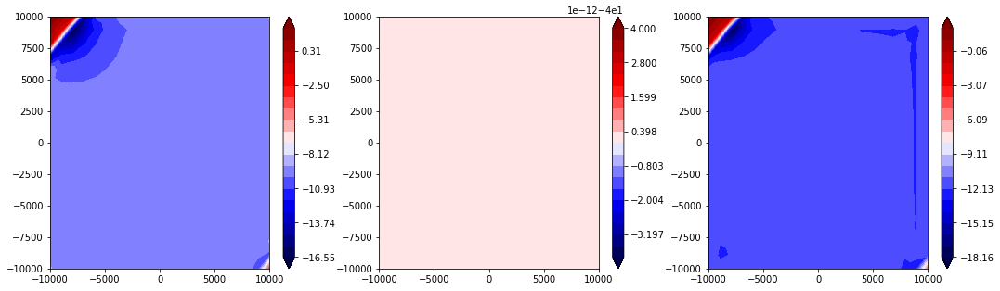

traction


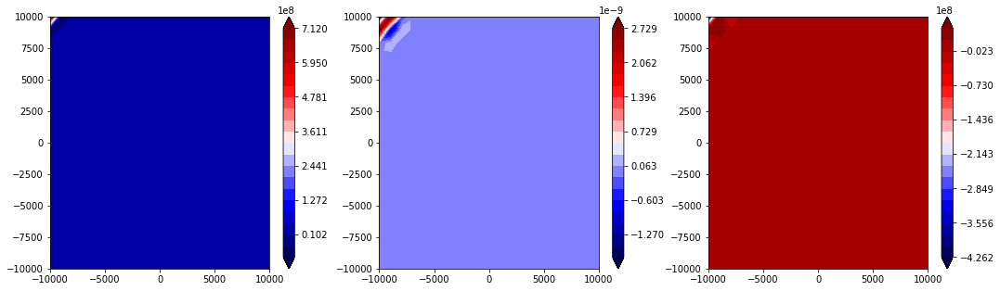

state


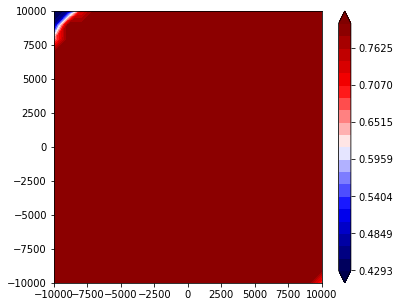

3071 37.1545160107
3072 37.1545160107
3073 37.1545160107
3074 37.1545160108
3075 37.1545160108
3076 37.1545160109
3077 37.1545160109
3078 37.1545160109
3079 37.154516011
3080 37.154516011
V


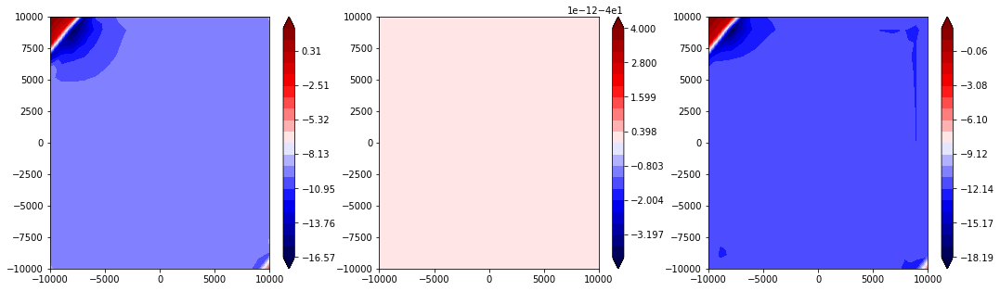

traction


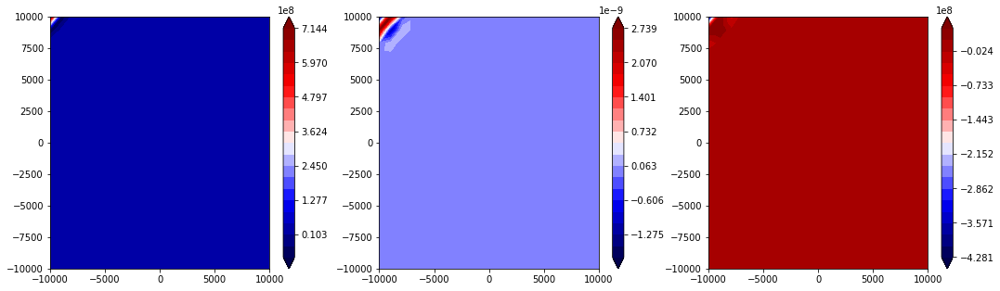

state


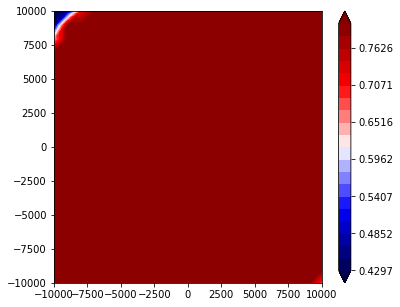

3081 37.154516011
3082 37.1545160111
3083 37.1545160111
3084 37.1545160112
3085 37.1545160112
3086 37.1545160113
3087 37.1545160113
3088 37.1545160113
3089 37.1545160114
3090 37.1545160114
V


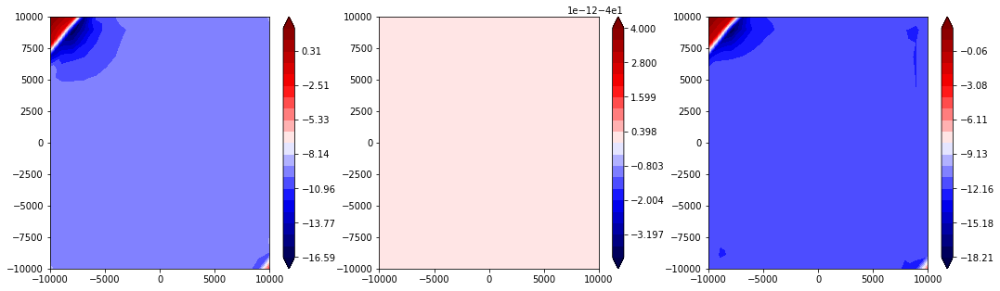

traction


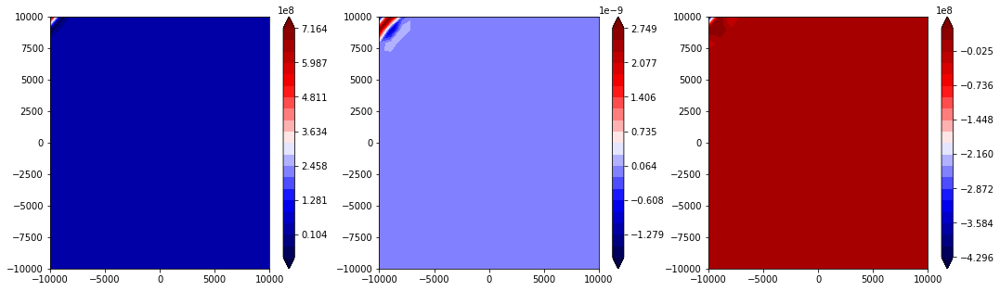

state


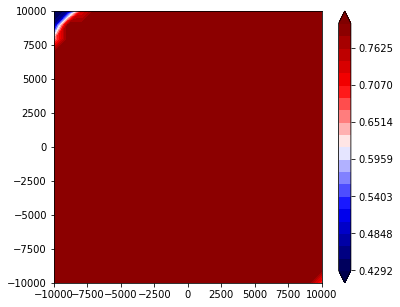

3091 37.1545160114
3092 37.1545160115
3093 37.1545160115
3094 37.1545160115
3095 37.1545160116
3096 37.1545160116
3097 37.1545160116
3098 37.1545160117
3099 37.1545160117
3100 37.1545160117
V


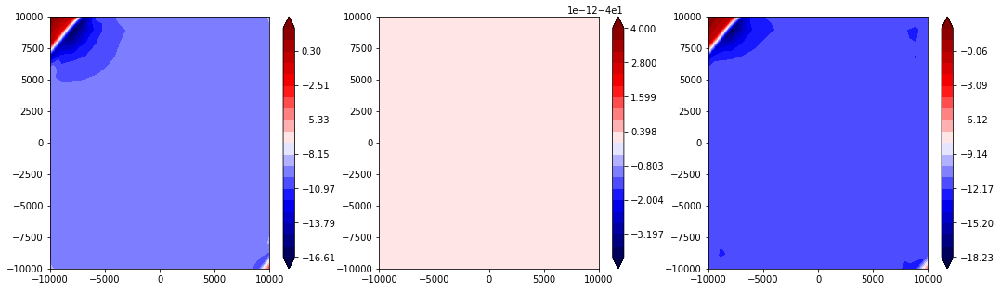

traction


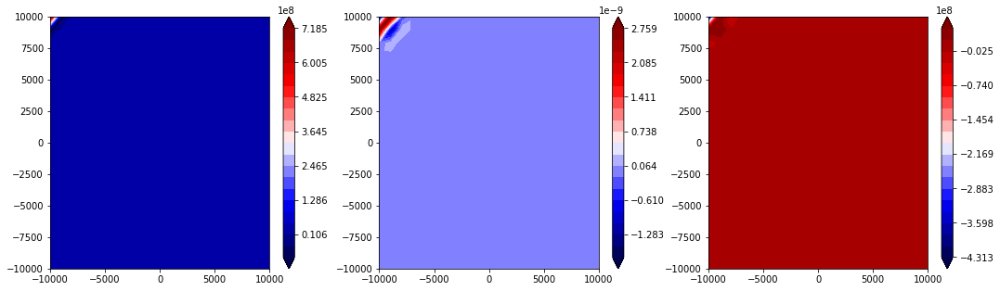

state


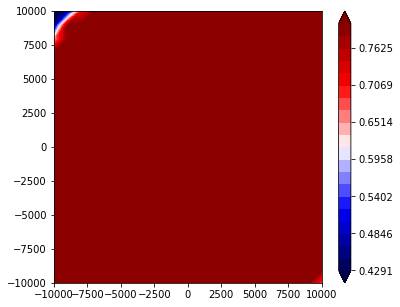

3101 37.1545160118
3102 37.1545160118
3103 37.1545160118
3104 37.1545160119
3105 37.1545160119
3106 37.1545160119
3107 37.154516012
3108 37.154516012
3109 37.154516012
3110 37.1545160121
V


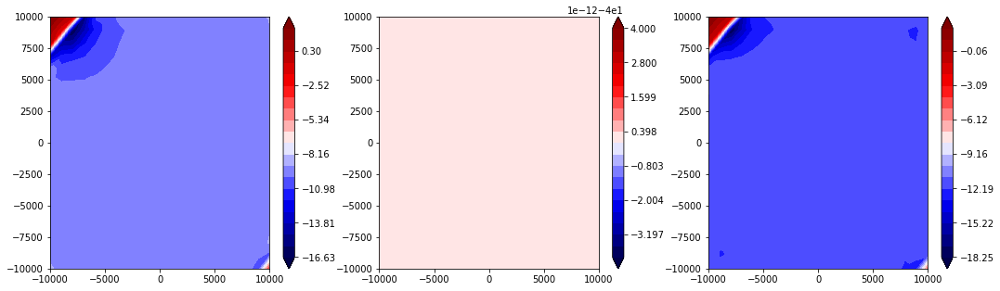

traction


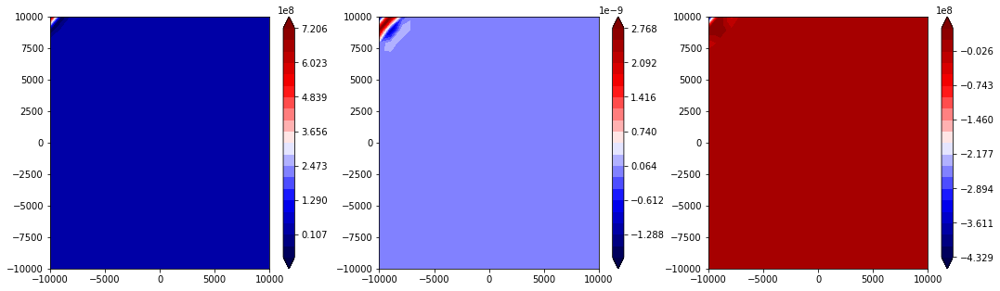

state


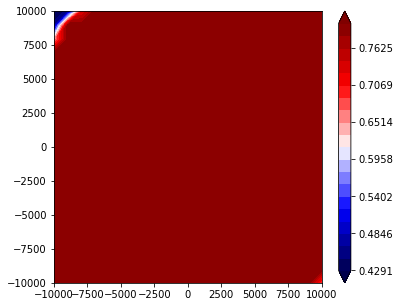

3111 37.1545160121
3112 37.1545160122
3113 37.1545160122
3114 37.1545160122
3115 37.1545160123
3116 37.1545160123
3117 37.1545160124
3118 37.1545160124
3119 37.1545160124
3120 37.1545160124
V


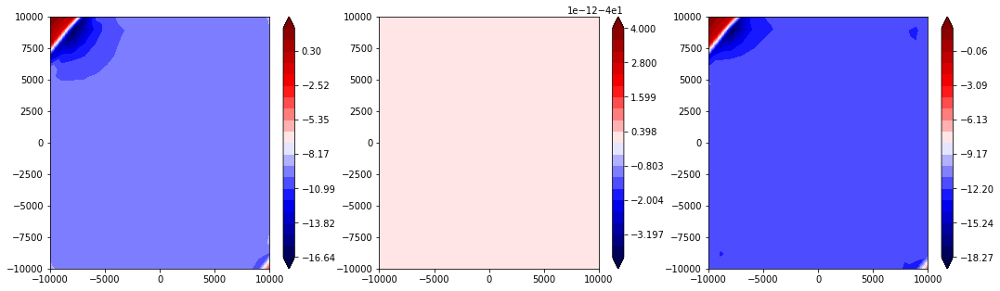

traction


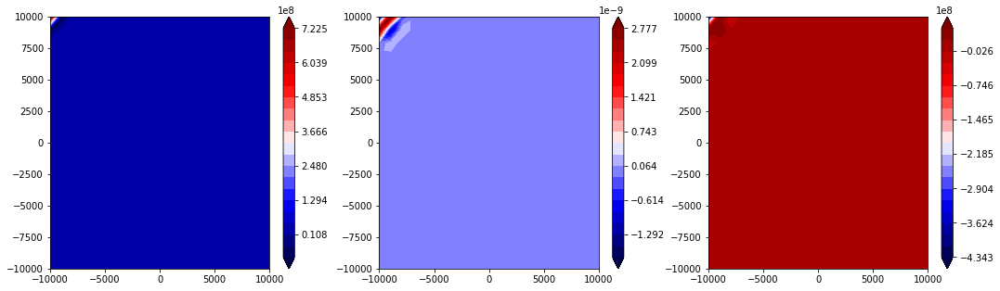

state


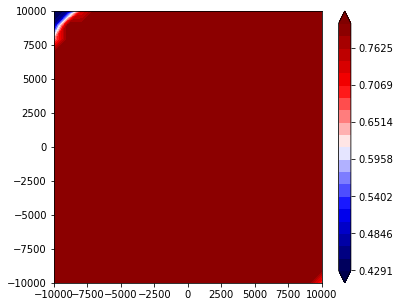

3121 37.1545160125
3122 37.1545160125
3123 37.1545160125
3124 37.1545160125
3125 37.1545160126
3126 37.1545160126
3127 37.1545160126
3128 37.1545160127
3129 37.1545160127
3130 37.1545160127
V


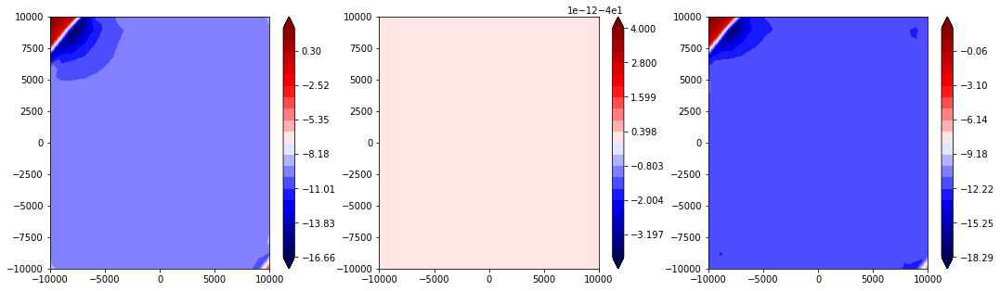

traction


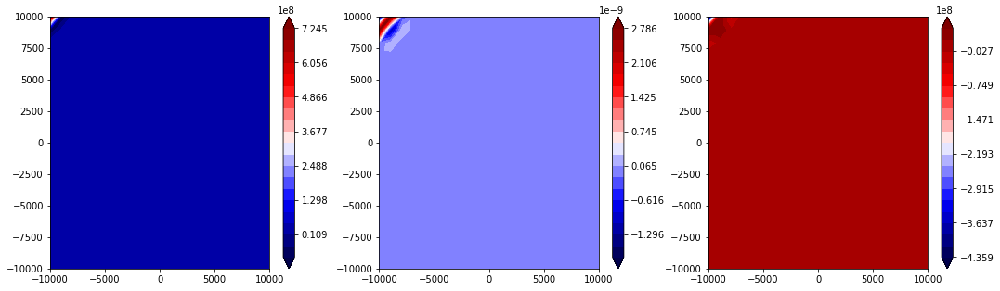

state


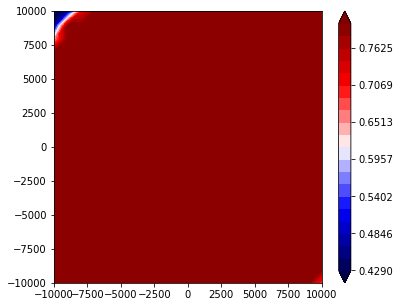

3131 37.1545160128
3132 37.1545160128
3133 37.1545160129
3134 37.1545160129
3135 37.1545160129
3136 37.1545160129
3137 37.154516013
3138 37.154516013
3139 37.1545160131
3140 37.1545160131
V


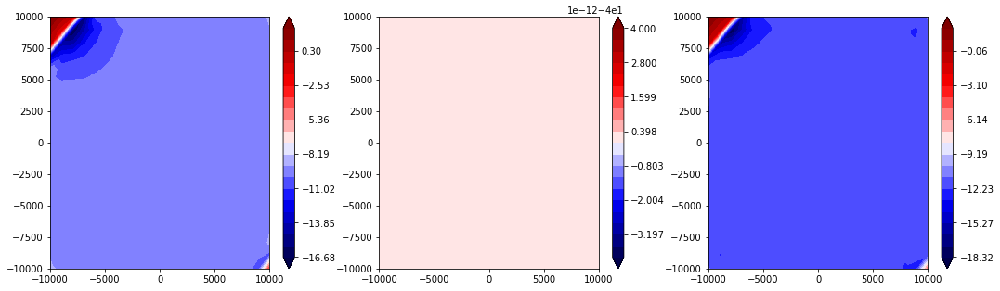

traction


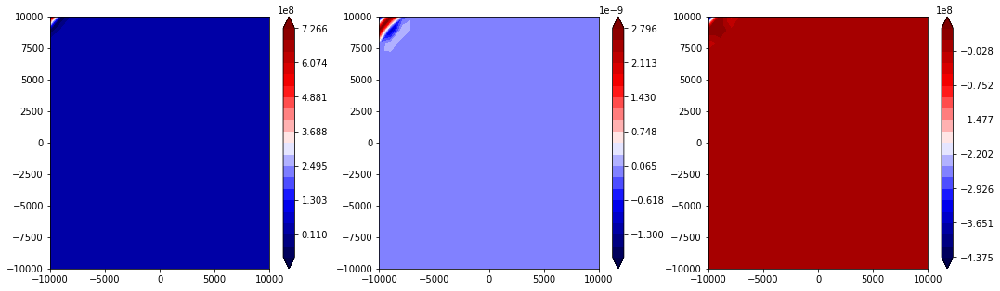

state


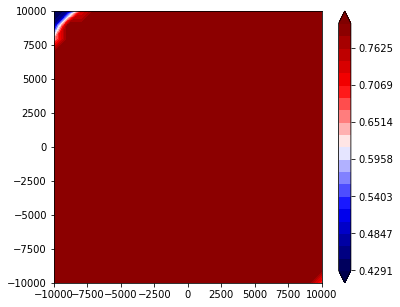

3141 37.1545160131
3142 37.1545160132
3143 37.1545160132
3144 37.1545160132
3145 37.1545160133
3146 37.1545160133
3147 37.1545160133
3148 37.1545160134
3149 37.1545160134
3150 37.1545160134
V


In [ ]:
from tectosaur.util.timer import Timer
h_t = []
h_y = []
siay = 60 * 60 * 24 * 365.25
for i in range(10000):
    assert(integrator.step() == None)
    h_t.append(integrator.t)
    h_y.append(integrator.y.copy())
    print(i, integrator.t / siay)
    if i % 10 == 0:
        plot_setting(integrator.t, integrator.y, qdm, qd_cfg, slip_to_traction)
    if i % 200 == 0:
        np.save('results.npy', np.array([qdm.m, qd_cfg, h_t, h_y], dtype = np.object))